<a href="https://colab.research.google.com/github/dolmani38/concept_drift/blob/main/Generative-CDTL_part2_1127.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Concept drift tolerant machine learning method

In [1]:
import numpy as np
import pandas as pd
import torch
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

In [3]:
import random
import os
def seed_everything(seed: int = 46):
    random.seed(seed)
    np.random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    #tf.random.set_seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)

In [4]:
!pip install deepspeed

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 12.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.0/54.0 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 kB 16.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 7.0 MB/s eta 0:00:00
  Created wheel for deepspeed: filename=deepspeed-0.12.3-py3-none-any.whl size=1279166 sha256=3149d8e10b7cc749c1312cc0e095df6f029e0bcdef43e108382e1a010b9e5ca3
  Stored in directory: /root/.cache/pip/wheels/ee/2b/c5/892ceee06964ce8aa2a98d4260848d0d9a3f1e743862e4b45a
Successfully built deepspeed


In [5]:
if True:
    from google.colab import drive
    drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
temp_discriminator_flops = 0
temp_G_CDTL_flops = 0

# 실험을 위한 기본적인 function 들...

In [7]:
import sys, os
import math

from torch.autograd import Variable
from argparse import Namespace
#from FRTrain_arch import Generator, DiscriminatorF, DiscriminatorR, weights_init_normal, test_model
#from FRTrain_arch import weights_init_normal, test_model
import warnings
warnings.filterwarnings("ignore")

plt.style.use('bmh')
plt.rcParams['axes.facecolor'] = 'white'

In [8]:
main_figsize=(15,3)

plt.rc('font', size=10)        # 기본 폰트 크기
plt.rc('axes', labelsize=10)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=10)  # x축 눈금 폰트 크기
plt.rc('ytick', labelsize=10)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=10)  # 범례 폰트 크기
plt.rc('figure', titlesize=10) # figure title 폰트 크기


In [9]:
def weights_init_normal(m):
    """Initializes the weight and bias of the model.

    Args:
        m: A torch model to initialize.

    Returns:
        None.
    """

    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)
    elif classname.find('Linear') != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.2)
        torch.nn.init.constant_(m.bias.data, 0)


In [10]:
# Define the Generator
# bucket에 대해 x를 전처리
class Generator(nn.Module):
    #__flops__ = 0

    def __init__(self,input_dim):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        self.fc1 = nn.ModuleList()
        #self.fc1.__setattr__('__flops__',torch.tensor(0))
        #self.fc2 = nn.ModuleList()
        self.fc3 = nn.ModuleList()
        #self.fc3.__setattr__('__flops__',torch.tensor(0))

        for i in range(self.input_dim):
            self.fc1.append(nn.Linear(2, 50))
            #self.fc2.append(nn.BatchNorm1d(num_features=50))
            self.fc3.append(nn.Linear(50, 1))

        #self.fc = nn.Linear(input_dim, input_dim)

    def forward(self,x,b):
        pxy = []
        for i in range(self.input_dim):
            h0 = self.fc1[i](torch.cat((x[:,i].reshape(-1,1),b), 1))
            #h1 = F.relu(self.fc2[i](h0))
            #h2 = self.fc3[i](h1)
            h2 = self.fc3[i](F.relu(h0))
            pxy.append(h2)

        #return self.fc(torch.tensor(torch.cat(pxy, dim=1), requires_grad = True))
        return torch.cat(pxy, dim=1)


In [11]:
# Define the Discriminator
# 비즈니스에 해당하는 모델
class Discriminator(nn.Module):

    def __init__(self, input_dim=5):
        """Initializes Discriminator with torch components."""
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(input_dim, input_dim*4),
            nn.ReLU(),
            nn.Linear(input_dim*4, input_dim),
            nn.ReLU(),
            nn.Linear(input_dim, 1),
            nn.Sigmoid()
        )
        self.input_dim = input_dim
        self.inference_flops = 0

    def forward(self, input_data):
        """Defines a forward operation of the model.

        Args:
            input_data: The input data.

        Returns:
            The predicted label (y_hat) for the given input data.
        """
        self.inference_flops = self.inference_flops + 435*input_data.shape[0]
        output = self.model(input_data[:,0:self.input_dim])
        return output

    def predict(self, input_data):
        return self.forward(input_data), input_data[:,0:self.input_dim]

In [12]:
from deepspeed.profiling.flops_profiler import get_model_profile

"""
discriminator inference flops for 1 batch (9000,5)= 3,915,000
discriminator inference flops for 1 data (1,5)= 435
G-CDTL inference flops for 1 batch (9000,5)= 19,665,000
G-CDTL inference flops for 1 data (1,5)= 2,185

"""

def test_all_data(model,X_train, X_live, Y_live, train_size, test_size, avaible_range, columns, ShowChart = False,bucket_size_array=[200]):

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

    print('X_live.shape',X_live.shape)
    b_dim = X_live.shape[1]-1
    X_live_set = []
    Y_live_set = []
    truncate_count = 0
    for i in range(int(X_live.shape[0]/test_size)):
        xl = X_live[i*test_size:i*test_size+train_size]
        yl = Y_live[i*test_size:i*test_size+train_size]
        if len(xl) ==  train_size:
            X_live_set.append(xl)
            Y_live_set.append(yl)
        else:
            truncate_count = xl.shape[0] #truncate_count + len(xl)
            break


    print(f'Truncate {truncate_count} rows from live_set {X_live.shape}')
    X_live_set = torch.tensor(np.asarray(X_live_set),dtype=torch.float32).to(device)
    Y_live_set = np.asarray(Y_live_set)

    f1s = []
    MISS = {}
    DRF = {}
    for col in columns:
        MISS[col] = []
        DRF[col] = []

    sp = X_live_set.cpu().data.numpy().shape

    print('Search MI & Drift...for X_live_set',sp)

    """
    batch_size = sp[0]
    flops, macs, params = get_model_profile(model=model, # model
                                    input_shape=(sp[1],sp[2]), # input shape to the model. If specified, the model takes a tensor with this shape as the only positional argument.
                                    args=None, # list of positional arguments to the model.
                                    kwargs=None, # dictionary of keyword arguments to the model.
                                    print_profile=False, # prints the model graph with the measured profile attached to each module
                                    detailed=False, # print the detailed profile
                                    as_string=False, # print raw numbers (e.g. 1000) or as human-readable strings (e.g. 1k)
                                    output_file=None, # path to the output file. If None, the profiler prints to stdout.
                                    ignore_modules=None) # the list of modules to ignore in the profiling

    print('Profile - Inference flops:',flops*batch_size)
    """

    inference_flops = 0
    for X_live_unit,Y_live_unit in zip(tqdm(X_live_set),Y_live_set):

        # Inference flops 계산!!!!!!!!!!!!!!
        if isinstance(model, G_CDTL):
            inference_flops = inference_flops + 2185*X_live_unit.shape[0]
        elif isinstance(model, Discriminator):
            inference_flops = inference_flops + 435*X_live_unit.shape[0]

        predicted_y,xs = model.predict(X_live_unit)
        predicted_y = (predicted_y.cpu().data.numpy()> 0.5).astype(float)
        f1_ = f1_score(Y_live_unit,predicted_y)
        #r2 = r2_score(yT[bk*bucket_count:bk*bucket_count+bucket_count],predicted_y.detach().numpy())
        f1s.append(f1_)

        cpu_xs = xs.cpu().data.numpy()
        mi_scores = make_mi_scores(pd.DataFrame(cpu_xs,columns=columns), Y_live_unit, discrete_features="auto")
        ks = __ks_drift(X_train.values,cpu_xs)
        for ix,col in enumerate(columns):
            MISS[col].append(mi_scores[col])
            DRF[col].append(ks[:,0][ix])

    df_mis = pd.DataFrame(MISS)
    df_drf = pd.DataFrame(DRF)

    if ShowChart:
        plt.figure(figsize=main_figsize)
        plt.plot(f1s,linewidth=1)
        plt.ylabel('F1 Score')
        plt.xlabel(f'bucket ({test_size})')
        plt.show()

        df_mis.plot(figsize=main_figsize,linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',fontsize=15)
        plt.legend(loc=1)
        plt.show()

        df_drf.plot(figsize=main_figsize,linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})',fontsize=15)
        plt.legend(loc=1)
        plt.show()

    print(f'mean of drift:\n{df_drf.mean()}')
    print('Mean F1 for all data:',np.mean(f1s))

    return f1s, df_mis, df_drf,inference_flops

[2023-11-27 12:06:59,615] [INFO] [real_accelerator.py:158:get_accelerator] Setting ds_accelerator to cuda (auto detect)


In [13]:

from sklearn.metrics import r2_score,precision_recall_fscore_support,f1_score
import scipy

#https://www.deepspeed.ai/tutorials/flops-profiler/
from deepspeed.profiling.flops_profiler import FlopsProfiler

"""
discriminator train flops (4000 epoch) : 15660000000
generator train flops (4000 epoch) : 63000000000

discriminator train flops / epoch for (9000,5) = 3,915,000
discriminator train flops / epoch for (1,5) = 435
generator train flops / epoch for (9000,5) = 15,750,000
generator train flops / epoch for (1,5) = 1,750
"""
def train_model(train_tensors, test_tensors, train_opt, lambda_f, avaible_range, alpha, columns,ShowChart = False, do_mine=True):
    #seed_everything()

    global temp_discriminator_flops
    global temp_G_CDTL_flops

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    print(device)

    lambda_f = torch.tensor([lambda_f],dtype=torch.float32).to(device)

    XS_train = train_tensors.XS_train.to(device)
    y_train = train_tensors.y_train.to(device)
    #s1_train = train_tensors.s1_train.to(device)

    XS_test = test_tensors.XS_test.to(device)
    y_test = test_tensors.y_test.to(device)
    #s1_test = test_tensors.s1_test.to(device)

    # Saves return values here
    #test_result = []

    val = train_opt.val # Number of data points in validation set
    k = train_opt.k     # Update ratio of generator and discriminator (1:k training).
    n_epochs = train_opt.n_epochs  # Number of training epoch

    b_dim = XS_train.shape[1]-1

    model = None
    g_losses =[]
    a_losses = []
    if lambda_f < 0.0:
        discriminator = Discriminator(b_dim).to(device)
        discriminator.apply(weights_init_normal)

        optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=train_opt.lr_g)
        bce_loss = nn.BCELoss()

        discriminator_prof = FlopsProfiler(discriminator,None)
        discriminator_prof.start_profile()
        temp_loss = 10000
        m_flops = 0
        for epoch in tqdm(range(n_epochs)):
            a_loss = torch.tensor(0.0)
            gen_y = discriminator(XS_train[:,0:b_dim]).reshape(-1,1)
            g_loss = bce_loss(gen_y, y_train.reshape(-1,1)) #+ torch.log(mine_loss.mean()+1)*0.001

            optimizer_D.zero_grad()

            loss = g_loss #(alpha*g_loss + (1-alpha)*a_loss) * 2
            loss.backward()

            optimizer_D.step()

            a_losses.append(a_loss.cpu().data.numpy())
            g_losses.append(g_loss.cpu().data.numpy())

            m_flops = m_flops + 435*XS_train.shape[0]

            if temp_loss < loss:
                break

            temp_loss = loss

        print('Early stop:',epoch)
        model = discriminator

        discriminator_prof.stop_profile()
        total_flops = discriminator_prof.get_total_flops()
        flops = total_flops - temp_discriminator_flops
        temp_discriminator_flops = total_flops
        discriminator_prof.end_profile()

        print('Normal discriminator train flops :',m_flops)

    else:
        # Initializes generator and discriminator
        discriminator = Discriminator(b_dim).to(device)
        discriminator.apply(weights_init_normal)
        generator = Generator(b_dim).to(device)
        if train_opt.weight_init:
            generator.apply(weights_init_normal)

        g_cdtl = G_CDTL(generator,discriminator)

        a_losses,g_losses,epoch, g_flops, d_flops = g_cdtl.train(XS_train,y_train,train_opt,avaible_range,alpha,do_early_stop=False)
        #flops = total_flops - temp_G_CDTL_flops
        #temp_G_CDTL_flops = total_flops
        m_flops = g_flops+d_flops
        model = g_cdtl

    model.eval()
    y_hat, xs = model.predict(XS_test)
    y_hat = (y_hat.cpu().data.numpy()> 0.5).astype(float)
    ty_ = y_test.cpu().data.numpy()
    prf = precision_recall_fscore_support(ty_,y_hat)
    print('precision_recall_fscore:',prf)
    f1 = prf[2][1]
    print('Test f1 score:',f1)
    df_loss = pd.DataFrame({'Generator loss':a_losses,'Predictor loss':g_losses})

    if ShowChart:
        #display(df_loss)
        #df_loss.plot(figsize=main_figsize,linewidth=1,ylabel='loss',xlabel=f'bucket ({XS_train.shape[0]})',fontsize=15)
        df_loss.astype(np.float32).plot(figsize=main_figsize,linewidth=1,ylabel='loss',xlabel='bucket')
        plt.legend(loc=1)
        plt.show()

    return f1,model,df_loss,m_flops

In [14]:
plt.style.use('bmh')

def __ks_2samp2(sample1, sample2):
    # Gets all observations
    sample1 = np.sort(sample1)
    sample2 = np.sort(sample2)
    n1 = sample1.shape[0]
    n2 = sample2.shape[0]
    data_all = np.concatenate([sample1, sample2])
    cdf1 = np.searchsorted(sample1, data_all, side='right') / n1
    cdf2 = np.searchsorted(sample2, data_all, side='right') / n2
    # Evaluates the KS statistic
    cddiffs = cdf1 - cdf2
    minS = -np.min(cddiffs)
    maxS = np.max(cddiffs)
    ks_stat =  max(minS, maxS)

    #if ks_stat == minS:
    #    ks_stat = -ks_stat

    # Calculates the P-Value based on the two-sided test
    # The P-Value comes from the KS Distribution Survival Function (SF = 1-CDF)
    m, n = float(n1), float(n2)
    en = m * n / (m + n)
    p_value = 0.0 #stats.kstwobign.sf(math.sqrt(en) * abs(ks_stat))
    #p_value = stats.kstwobign.sf(en * abs(ks_stat))
    return ks_stat,p_value

def __ks_drift(ref_x,inf_x):
    x_drift = np.zeros((ref_x.shape[1],2))
    for i in range(ref_x.shape[1]):
        #s, p = ks_2samp(ref_x[:,i],inf_x[:,i],mode='asymp')
        s, p = __ks_2samp2(ref_x[:,i],inf_x[:,i])
        x_drift[i,0] = s
        x_drift[i,1] = p
    return x_drift

In [15]:
from sklearn.feature_selection import mutual_info_regression, mutual_info_classif

def make_mi_scores(X, y, discrete_features):
    mi_scores = mutual_info_classif(X, y, discrete_features=discrete_features)
    mi_scores = pd.Series(mi_scores, name="MI Scores", index=X.columns)
    mi_scores = mi_scores.sort_values(ascending=False)
    return mi_scores

In [16]:
from tqdm import tqdm
from sklearn.preprocessing import MinMaxScaler, StandardScaler

plt.style.use('bmh')
plt.rcParams['axes.facecolor'] = 'white'

def check_mi_drift(X:pd.DataFrame,Y:np.array,train_size:int,test_size:int):

    mi_scores = make_mi_scores(X, Y, discrete_features="auto")
    #print(mi_scores)
    print(f'MI Analysis MI Max {np.max(mi_scores):.5f}, Min {np.min(mi_scores):.5f}, Mean {np.mean(mi_scores):.5f}, Std {np.std(mi_scores):.5f}')

    columns = X.columns
    scaler_c1 = MinMaxScaler()
    # trainset을 가지고 Scaler를 fit하고, testset을 포함한 그 이후의 Data를 모두 transform 한다.
    X = pd.DataFrame(np.concatenate((scaler_c1.fit_transform(X[0:train_size]), scaler_c1.transform(X[train_size:])),axis=0), columns=columns)

    X_train = X[:train_size]
    Y_train = Y[:train_size]

    X_test = X[test_size:train_size+test_size]
    Y_test = Y[test_size:train_size+test_size]

    X_live = X[test_size:]
    Y_live = Y[test_size:]

    print('Dataset structure X_train,',X_train.shape,'X_test,',X_test.shape,'X_live',X_live.shape)
    X_live_set = []
    Y_live_set = []
    truncate_count = 0
    for i in range(int(X_live.shape[0]/test_size)):
        xl = X_live[i*test_size:i*test_size+train_size]
        yl = Y_live[i*test_size:i*test_size+train_size]

        if len(xl) ==  train_size:
            X_live_set.append(xl)
            Y_live_set.append(yl)
        else:
            #print(xl.shape)
            truncate_count = xl.shape[0] #truncate_count + len(xl)
            break

    print(f'Truncate {truncate_count} rows from live_set {X_live.shape}')
    X_live_set = np.asarray(X_live_set)
    Y_live_set = np.asarray(Y_live_set)

    MIS = {}
    DRF = {}
    for col in columns:
        MIS[col] = []
        DRF[col] = []

    print('Search MI & Drift...for X_live_set',X_live_set.shape)
    for X_live_unit,Y_live_unit in zip(tqdm(X_live_set),Y_live_set):
        X_live_unit = pd.DataFrame(X_live_unit,columns = columns)
        mi_scores = make_mi_scores(X_live_unit, Y_live_unit, discrete_features="auto")
        ks = __ks_drift(X_train.values,X_live_unit.values)
        for ix,col in enumerate(columns):
            MIS[col].append(mi_scores[col])
            DRF[col].append(ks[:,0][ix])

    df_mis = pd.DataFrame(MIS)
    df_drf = pd.DataFrame(DRF)

    for c_name in df_mis.columns:
        fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
        df_mis[c_name].plot(ax=ax[0],linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',legend=None)
        ax[0].set_title(f'Mutual Information of {c_name}',fontdict={'fontsize':10})

        df_drf[c_name].plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})')
        ax[1].set_title(f'Drift (KS-test) of {c_name}',fontdict={'fontsize':10})
        ax[1].legend(bbox_to_anchor=(1.0, 1.0))
        plt.show()

    fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
    df_mis.plot(ax=ax[0],linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',legend=None)
    ax[0].set_title(f'Mutual Information',fontdict={'fontsize':10})

    df_drf.plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})')
    ax[1].set_title(f'Drift (KS-test)',fontdict={'fontsize':10})
    ax[1].legend(bbox_to_anchor=(1.0, 1.0))
    plt.show()

    return X,Y

In [17]:

def draw_chart(axis,legends,title, df,color,showfliers=True):
    if legends == None:
        legends = []

    legends.append((title,color))

    axis.set_xticks([])
    flierprops = dict(marker='.', markerfacecolor=color, markeredgecolor='none')
    if showfliers:
        df.T.plot.box(ax=axis, flierprops=flierprops,ylabel='F1 Score',fontsize=10,color=color)
    else:
        df.T.plot.box(ax=axis, showfliers=False,ylabel='F1 Score',fontsize=10,color=color)
    med_df = pd.concat([pd.DataFrame({'med':None},index=[0]), pd.DataFrame({'med':df.T.median().values})],axis=0).reset_index(drop=True)
    med_df.plot(ax = axis,linestyle='--',linewidth=1,ylabel='F1 Score',fontsize=10,color=color)
    return legends

def set_legend(axis,legends,title):
    axis.set_title(title,fontdict={'fontsize':10})
    #axis.legend([v for v,c in legends],ncol=len(legends),bbox_to_anchor=(1.05, 1.0), loc='upper left')
    axis.legend([v for v,c in legends],bbox_to_anchor=(1.05, 1.0), loc='upper left')
    leg = axis.get_legend()
    for i,(v,c) in enumerate(legends):
        leg.legendHandles[i].set_color(c)

def prepare_result_data():
    result_data = {} # Original
    train_data = {}
    result_table = {}
    result_table['Trial']=[]
    result_table['Testset F1']=[]
    result_table['Initial F1']=[]
    result_table['Mean F1']=[]
    result_table['Last F1']=[]
    result_table['Elapsed time']=[]
    result_table['Train flops']=[]
    result_table['Inference flops']=[]
    result_table['flops']=[]

    return result_data,train_data,result_table

def set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,result_data,train_data,result_table,trn_flops,inf_flops):
    result_data[f'T{idx}'] = tad
    result_table['Trial'].append(idx)
    train_data[f'T{idx}'] = (df_loss,df_mis,df_drf)
    result_table['Testset F1'].append(tad[0])
    result_table['Initial F1'].append(tad[1])
    result_table['Mean F1'].append(np.mean(tad))
    result_table['Last F1'].append(tad[-1])
    result_table['Elapsed time'].append(et)
    result_table['Train flops'].append(np.sum(trn_flops))
    result_table['Inference flops'].append(inf_flops)
    result_table['flops'].append(np.sum(trn_flops) + inf_flops)

def set_mean_sem(df):
    df.loc[len(df)] = df.median()
    df.loc[len(df)] = df[0:len(df)-1].std()
    df.at[len(df)-2,'Trial'] = 'median'
    df.at[len(df)-1,'Trial'] = 'std'

In [18]:

def draw_chart2(axis,legends,title, df,color,showfliers=True):
    if legends == None:
        legends = []

    legends.append((title,color))

    axis.set_xticks([])
    flierprops = dict(marker='.', markerfacecolor=color, markeredgecolor='none')
    if showfliers:
        df[0:df.shape[0]-2].plot.box(ax=axis, flierprops=flierprops,ylabel='F1 Score',fontsize=10,color=color)
    else:
        df[0:df.shape[0]-2].plot.box(ax=axis, showfliers=False,ylabel='F1 Score',fontsize=10,color=color)
    med_df = pd.concat([pd.DataFrame({'med':None},index=[0]), pd.DataFrame({'med':df[0:df.shape[0]-1].median().values})],axis=0).reset_index(drop=True)
    med_df.plot(ax = axis,linestyle='--',linewidth=1,ylabel='F1 Score',fontsize=10,color=color)
    return legends

def draw_chart3(axis,legends,title, df,color,showfliers=True):
    if legends == None:
        legends = []

    legends.append((title,color))

    axis.set_xticks([])
    flierprops = dict(marker='.', markerfacecolor=color, markeredgecolor='none')
    if showfliers:
        df[0:df.shape[0]-2].plot.box(ax=axis, flierprops=flierprops,ylabel='flops',fontsize=10,color=color)
    else:
        df[0:df.shape[0]-2].plot.box(ax=axis, showfliers=False,ylabel='flops',fontsize=10,color=color)
    med_df = pd.concat([pd.DataFrame({'med':None},index=[0]), pd.DataFrame({'med':df[0:df.shape[0]-1].median().values})],axis=0).reset_index(drop=True)
    med_df.plot(ax = axis,linestyle='--',linewidth=1,ylabel='flops',fontsize=10,color=color)
    return legends

def set_legend2(axis,legends,title):
    axis.set_title(title,fontdict={'fontsize':10})
    #axis.legend([v for v,c in legends],ncol=len(legends),bbox_to_anchor=(1.05, 1.0), loc='upper left')
    axis.legend([v for v,c in legends],bbox_to_anchor=(1.05, 1.0), loc='upper left')
    leg = axis.get_legend()
    for i,(v,c) in enumerate(legends):
        leg.legendHandles[i].set_color(c)

## G_CDTL

In [39]:
class G_CDTL(nn.Module):
    def __init__(self,generator,discriminator,early_stop_count = 3):
        super(G_CDTL, self).__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.generator_prof = FlopsProfiler(self.generator)
        self.discriminator_prof = FlopsProfiler(self.discriminator)
        self.inference_flops = 0
        self.min_bucket_num = 0
        self.early_stop_count = early_stop_count

    def train(self,data,target,train_opt, avaible_range, alpha, do_early_stop=True):
        self.inference_flops = 0

        # flops counter...
        print('G-CDTL Train:',data.shape)
        self.generator_prof.start_profile()
        self.discriminator_prof.start_profile()

        b_dim = data.shape[1]-1

        self.avaible_range = avaible_range
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

        bce_loss = nn.BCELoss()
        p_flops = 0
        """
        optimizer = torch.optim.Adam(self.discriminator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000

        # flops counter...
        #prof.start_profile()
        for itr in range(train_opt.n_epochs):
            predicted_y = self.discriminator(data[:,0:b_dim]).reshape(-1,1)
            #print('predicted_y',predicted_y.shape)
            #print('target',target.shape)

            loss = bce_loss(predicted_y, target.reshape(-1,1))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 31,500,000
            p_flops = p_flops + 435*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break
            temp_loss = loss
        """

        mse_loss = nn.MSELoss(reduce=False)  # mean square error

        optimizer = torch.optim.Adam(self.generator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000
        #p_flops = 0
        # flops counter...
        #prof.start_profile()
        for itr in range(train_opt.n_epochs):
            xs = self.generator(data[:,0:b_dim],(data[:,b_dim].reshape(-1,1)-self.min_bucket_num)/avaible_range) # z0, b
            ml = torch.mean(mse_loss(xs, data[:,0:b_dim]),dim=0)
            loss =  torch.sum(ml) # + torch.std(ml)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 31,500,000
            p_flops = p_flops + 1750*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break
            temp_loss = loss


        optimizer_G = torch.optim.Adam(self.generator.parameters(), lr=train_opt.lr_g)
        optimizer_D = torch.optim.Adam(self.discriminator.parameters(), lr=train_opt.lr_g)

        g_losses =[]
        a_losses = []

        temp_loss = 10000

        esc = 0
        self.min_bucket_num = 0.0 #np.min(data[:,b_dim].reshape(-1,1).cpu().data.numpy())

        print('min_bucket_num:',self.min_bucket_num)

        g_flops = 0
        d_flops = 0

        if do_early_stop:
            iter = range(train_opt.n_epochs)
        else:
            iter = tqdm(range(train_opt.n_epochs))


        for epoch in iter:
            xs = self.generator(data[:,0:b_dim],(data[:,b_dim].reshape(-1,1)-self.min_bucket_num)/avaible_range) # z0, b
            ml = torch.mean(mse_loss(xs, data[:,0:b_dim]),dim=0)
            a_loss =  torch.sum(ml) # + torch.std(ml)

            gen_y = self.discriminator(xs).reshape(-1,1)
            g_loss = bce_loss(gen_y, target.reshape(-1,1)) #+ torch.log(mine_loss.mean()+1)*0.001

            optimizer_G.zero_grad()
            optimizer_D.zero_grad()

            loss =  (alpha*g_loss + (1-alpha)*a_loss) * 2
            loss.backward()

            optimizer_G.step()
            optimizer_D.step()

            a_losses.append(a_loss.cpu().data.numpy())
            g_losses.append(g_loss.cpu().data.numpy())

            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 5,040,000

            g_flops = g_flops + 1750*data.shape[0]
            d_flops = d_flops + 435*data.shape[0]
            #if do_early_stop:
            # Early stop condition...
            if loss >= temp_loss:
                if esc > self.early_stop_count:
                    break
                esc = esc + 1
            else:
                esc = 0
            temp_loss = loss

        self.generator_prof.stop_profile()
        self.discriminator_prof.stop_profile()
        #g_flops = self.generator_prof.get_total_flops()
        #d_flops = self.discriminator_prof.get_total_flops()
        #print('g_flops:',g_flops,'d_flops',d_flops)
        #train_flops =  g_flops + d_flops

        self.generator_prof.end_profile()
        self.discriminator_prof.end_profile()

        print('G-CDTL train flops:',p_flops,g_flops,d_flops,p_flops+g_flops+d_flops)
        return a_losses,g_losses,epoch,g_flops,p_flops+d_flops

    def eval(self):
        self.generator.eval()
        self.discriminator.eval()

    def predict(self, data):

        # Inference flops 계산!!!!!!!!!!!!!!
        self.inference_flops = self.inference_flops + 995*data.shape[0]

        b_dim = data.shape[1]-1
        ax = self.generator(data[:,0:b_dim],(data[:,b_dim].reshape(-1,1)-self.min_bucket_num)/self.avaible_range)
        y_hat = self.discriminator(ax)

        return y_hat, ax

    def forward(self, data):
        b_dim = data.shape[1]-1
        ax = self.generator(data[:,0:b_dim],(data[:,b_dim].reshape(-1,1)-self.min_bucket_num)/self.avaible_range)
        y_hat = self.discriminator(ax)
        return y_hat

##G-CDTL+AUE2

In [20]:
import copy

class G_CDTL_AUE2():

    def __init__(self, size,retrain_interval,avaible_range, alpha,do_early_stop=True):
        self.length = size
        self.retrain_interval = retrain_interval
        self.models = None #[]
        self.data = None
        self.target = None
        self.current_retrain_count = 0
        self.early_stop_at = []
        self.train_flops = {}
        self.train_flops = []

        self.avaible_range = avaible_range
        self.alpha = alpha
        self.do_early_stop = do_early_stop

    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):

        global temp_ensemble_aue2_flops

        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = f_data
            self.target = f_target
            return None

        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

        # Initializes generator and discriminator
        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)
        generator = Generator(input_dim).to(device)
        if train_opt.weight_init:
            generator.apply(weights_init_normal)

        g_cdtl = G_CDTL(generator,discriminator)
        #train_opt = Namespace(val=0, n_epochs=4000, k=5, lr_g=0.001, lr_f=0.001, lr_r=0.001)
        a_losses,g_losses,epoch,g_flops, d_flops = g_cdtl.train(data,target,train_opt,self.avaible_range, self.alpha, self.do_early_stop)

        self.train_flops.append(g_flops+d_flops)
        self.early_stop_at.append(epoch)
        self.data = data
        self.target = target

        return g_cdtl

    def add_model(self,model,data,target):
        # model = (model,loss)
        # 여기서 m은 실제 model 이고, loss는 weight를 계산하기 위해서...
        # model[0] -> model
        # model[1] -> loss
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return
        """
        if len(self.models) >= self.length:
            # Full of ensemble
            raise Exception('Full of ensemble')
        else:
            #self.models.append(model)
            self.models = model
        """
        self.models = model


    def predict(self,data):
        #b_dim = data.shape[1]-1
        #data = data[:,0:b_dim]
        """
        weights = np.asarray([1/w for w in self.weights])
        normalized_weights = weights / np.linalg.norm(weights)
        """
        """
        # 마지막 model (가장 최신 모델에...) 무조건 0.5의 weight를 부여한다.!
        if len(self.models) > 1:
            aaa = [i for i in range(1,len(self.models))]
            ass = np.sum(aaa) * 2
            normalized_weights = np.append(aaa/ass,0.5)
        else:
            normalized_weights = [1.0]

        aaa = [i for i in range(1,len(self.models)+1)]
        normalized_weights = aaa/np.sum(aaa)

        return np.sum(np.asarray([normalized_weights[i]*m.predict(data)[0].cpu().data.numpy() for i,m in enumerate(self.models)]),axis=0)
        """
        return self.models.predict(data)[0].cpu().data.numpy()

    def get_inference_flops(self):
        #return np.sum([m.inference_flops for m in self.models])
        return self.models.inference_flops

In [21]:
import copy

class G_CDTL_AUE3():

    def __init__(self, size,retrain_interval,avaible_range, alpha,do_early_stop=True):
        self.length = size
        self.retrain_interval = retrain_interval
        self.transfered_model = None
        self.current_model = None
        self.current_retrain_count = 0
        self.epoch = 400
        self.data = None
        self.target = None
        self.train_flops = []
        self.early_stop_at = []

        self.avaible_range = avaible_range
        self.alpha = alpha
        self.do_early_stop = do_early_stop

    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):
        global temp_ensemble_dtel
        self.train_opt = train_opt

        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = data
            self.target = target
            return None

        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

        # Initializes generator and discriminator
        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)
        generator = Generator(input_dim).to(device)
        if train_opt.weight_init:
            generator.apply(weights_init_normal)

        g_cdtl = G_CDTL(generator,discriminator)
        #train_opt = Namespace(val=0, n_epochs=4000, k=5, lr_g=0.001, lr_f=0.001, lr_r=0.001)
        a_losses,g_losses,epoch,g_flops, d_flops = g_cdtl.train(self.data,self.target,train_opt,self.avaible_range, self.alpha, self.do_early_stop)

        self.train_flops.append(g_flops+d_flops)
        self.early_stop_at.append(epoch)


        return g_cdtl

    def add_model(self,model,data,target):
        global temp_ensemble_dtel
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return

        if self.transfered_model == None:
            self.transfered_model = model
        else:
            self.current_model = model

            #prof = FlopsProfiler(self.transfered_model,None)


            a_losses,g_losses,epoch,g_flops, d_flops = self.transfered_model.train(self.data,self.target,self.train_opt,self.avaible_range, self.alpha, self.do_early_stop)

            self.train_flops.append(g_flops+d_flops)
            self.early_stop_at.append(epoch)

            print('G_CDTL_AUE2 train flops:',g_flops+d_flops)
            #temp_ensemble_dtel = total_flops
            #prof.end_profile()

        self.data = data
        self.target = target


    def predict(self,data):
        # weight 를 적용하지 않고 mean을 반환
        #b_dim = data.shape[1]-1
        #data = data[:,0:b_dim]
        if self.current_model == None:
            return self.transfered_model(data).cpu().data.numpy()

        return np.mean(np.asarray([self.transfered_model(data).cpu().data.numpy(), self.current_model(data).cpu().data.numpy()]),axis=0)

    def get_inference_flops(self):
        return np.sum([self.transfered_model.inference_flops,self.current_model.inference_flops])

## SEA

In [22]:
temp_ensemble_sea_flops = 0

class Ensemble_SEA():

    def __init__(self, size,retrain_interval=5):
        self.length = size
        self.retrain_interval = retrain_interval
        self.models = []
        self.data = None
        self.target = None
        self.current_retrain_count = 0
        self.train_flops = []
        self.early_stop_at = []

    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):

        global temp_ensemble_sea_flops
        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = data
            self.target = target

            return None

        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        bce_loss = nn.BCELoss()
        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)

        #prof = FlopsProfiler(discriminator)

        optimizer = torch.optim.Adam(discriminator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000
        m_flops = 0
        # flops counter...
        #prof.start_profile()
        for itr in range(epoch):
            predicted_y = discriminator(self.data).reshape(-1,1)
            #print('predicted_y',predicted_y.shape)
            #print('target',target.shape)

            loss = bce_loss(predicted_y, self.target.reshape(-1,1))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 31,500,000
            m_flops = m_flops + 435*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break

            temp_loss = loss
        self.early_stop_at.append(itr)
        #prof.stop_profile()
        #total_flops = prof.get_total_flops()
        #flops = total_flops - temp_ensemble_sea_flops
        print('Ensemble_SEA train flops:',m_flops)
        #temp_ensemble_sea_flops = total_flops
        self.train_flops.append(m_flops)

        #prof.end_profile()
        self.data = data
        self.target = target
        return discriminator

    def add_model(self,model,data,target):
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return

        if len(self.models) >= self.length:
            # Full of ensemble
            raise Exception('Full of ensemble')

        else:
            self.models.append(model)

    def predict(self,data):
        # weight 를 적용하지 않고 mean을 반환
        return np.mean(np.asarray([m(data).cpu().data.numpy() for m in self.models]),axis=0)

    def get_inference_flops(self):
        return np.sum([m.inference_flops for m in self.models])

## AUE2

In [23]:
temp_ensemble_aue2_flops = 0

class Ensemble_AUE2():


    def __init__(self, size,retrain_interval=5):
        self.length = size
        self.retrain_interval = retrain_interval
        self.models = []
        self.data = None
        self.target = None
        self.current_retrain_count = 0
        self.train_flops = []
        self.early_stop_at = []

    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):

        global temp_ensemble_sea_flops
        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = data
            self.target = target

            return None

        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        bce_loss = nn.BCELoss()
        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)

        #prof = FlopsProfiler(discriminator)

        optimizer = torch.optim.Adam(discriminator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000
        m_flops = 0
        # flops counter...
        #prof.start_profile()
        for itr in range(epoch):
            predicted_y = discriminator(self.data).reshape(-1,1)
            #print('predicted_y',predicted_y.shape)
            #print('target',target.shape)

            loss = bce_loss(predicted_y, self.target.reshape(-1,1))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 31,500,000
            m_flops = m_flops + 435*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break

            temp_loss = loss
        self.early_stop_at.append(itr)
        #prof.stop_profile()
        #total_flops = prof.get_total_flops()
        #flops = total_flops - temp_ensemble_sea_flops
        print('Ensemble_SEA train flops:',m_flops)
        #temp_ensemble_sea_flops = total_flops
        self.train_flops.append(m_flops)

        #prof.end_profile()
        self.data = data
        self.target = target
        return discriminator

    def add_model(self,model,data,target):
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return

        if len(self.models) >= self.length:
            # Full of ensemble
            raise Exception('Full of ensemble')

        else:
            self.models.append(model)

    def predict(self,data):
        aaa = [i for i in range(1,len(self.models)+1)]
        ass = np.sum(aaa)
        normalized_weights = aaa/ass

        return np.sum(np.asarray([normalized_weights[i]*m(data).cpu().data.numpy() for i,m in enumerate(self.models)]),axis=0)


    def get_inference_flops(self):
        return np.sum([m.inference_flops for m in self.models])


## DTEL

In [24]:
import copy

temp_ensemble_dtel = 0

class Ensemble_DTEL():

    def __init__(self, size,retrain_interval=5):
        self.length = size
        self.retrain_interval = retrain_interval
        self.transfered_model = None
        self.current_model = None
        self.current_retrain_count = 0
        self.epoch = 400
        self.data = None
        self.target = None
        self.train_flops = []
        self.early_stop_at = []


    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):
        global temp_ensemble_dtel
        self.train_opt = train_opt

        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = data
            self.target = target
            return None

        self.epoch = epoch
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        bce_loss = nn.BCELoss()

        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)
        #prof = FlopsProfiler(discriminator,None)

        #discriminator = copy.deepcopy(self.transfered_model)

        optimizer = torch.optim.Adam(discriminator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000
        # flops counter...
        #prof.start_profile()
        m_flops = 0
        for itr in range(epoch):
            predicted_y = discriminator(self.data).reshape(-1,1)
            #print('predicted_y',predicted_y.shape)
            #print('target',target.shape)

            loss = bce_loss(predicted_y, self.target.reshape(-1,1))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            m_flops = m_flops + 435*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break

            temp_loss = loss

        self.early_stop_at.append(itr)
        #prof.stop_profile()
        #total_flops = prof.get_total_flops()
        #flops = total_flops - temp_ensemble_dtel
        print('Ensemble_DTEL train flops:',m_flops)
        #temp_ensemble_dtel = total_flops
        self.train_flops.append(m_flops)
        #prof.end_profile()

        #self.data = data
        #self.target = target

        return discriminator

    def add_model(self,model,data,target):
        global temp_ensemble_dtel
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return

        if self.transfered_model == None:
            self.transfered_model = model
        else:
            self.current_model = model

            #prof = FlopsProfiler(self.transfered_model,None)

            device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
            bce_loss = nn.BCELoss()
            optimizer = torch.optim.Adam(self.transfered_model.parameters(), lr=self.train_opt.lr_g)
            temp_loss = 10000
            # flops counter...
            #prof.start_profile()
            m_flops = 0
            for itr in range(self.epoch):
                #predicted_y = self.transfered_model(self.data[0:len(data)]).reshape(-1,1)
                #loss = bce_loss(predicted_y, self.target[0:len(data)].reshape(-1,1))
                predicted_y = self.transfered_model(self.data).reshape(-1,1)
                loss = bce_loss(predicted_y, self.target.reshape(-1,1))
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()
                m_flops = m_flops + 435*self.data.shape[0]
                # Early stop condition...
                if loss > temp_loss:
                    break

                temp_loss = loss

            self.early_stop_at.append(itr)
            #prof.stop_profile()
            #total_flops = prof.get_total_flops()
            #flops = total_flops - temp_ensemble_dtel
            print('Ensemble_DTEL train flops:',m_flops)
            #temp_ensemble_dtel = total_flops
            self.train_flops.append(m_flops)
            #prof.end_profile()

        self.data = data
        self.target = target


    def predict(self,data):
        # weight 를 적용하지 않고 mean을 반환
        b_dim = data.shape[1]-1
        data = data[:,0:b_dim]
        if self.current_model == None:
            return self.transfered_model(data).cpu().data.numpy()

        #return np.mean(np.asarray([self.transfered_model(data).cpu().data.numpy()*2/3, self.current_model(data).cpu().data.numpy()*1/3]),axis=0)
        return self.transfered_model(data).cpu().data.numpy() #*2/3 + self.current_model(data).cpu().data.numpy()*1/3
        #return np.mean(np.asarray([self.transfered_model(data).cpu().data.numpy(), self.current_model(data).cpu().data.numpy()]),axis=0)


    def get_inference_flops(self):
        return np.sum([self.transfered_model.inference_flops,self.current_model.inference_flops])


In [25]:

def compare_algorithm(train_opt,ensemble,X_train, X_live, Y_live, train_size, test_size, avaible_range, columns, ShowChart = False,bucket_size_array=[200]):

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

    print('X_live.shape',X_live.shape)
    b_dim = X_live.shape[1]-1
    X_live_set = []
    Y_live_set = []
    truncate_count = 0
    '''
    for i in range(int(X_live[(train_size-test_size):].shape[0]/test_size)):
        xl = X_live[train_size+i*test_size - test_size:train_size+i*test_size]
        yl = Y_live[train_size+i*test_size - test_size:train_size+i*test_size]
        if len(xl) ==  test_size:
            X_live_set.append(xl)
            Y_live_set.append(yl)
        else:
            truncate_count = xl.shape[0] #truncate_count + len(xl)
            break
    '''
    for i in range(int(X_live.shape[0]/test_size)):
        xl = X_live[i*test_size:i*test_size+train_size]
        yl = Y_live[i*test_size:i*test_size+train_size]
        if len(xl) ==  train_size:
            X_live_set.append(xl)
            Y_live_set.append(yl)
        else:
            truncate_count = xl.shape[0] #truncate_count + len(xl)
            break

    print(f'Truncate {truncate_count} rows from live_set {X_live.shape}')
    X_live_set = torch.tensor(np.asarray(X_live_set),dtype=torch.float32).to(device)
    Y_live_set = np.asarray(Y_live_set)

    f1s = []
    MISS = {}
    DRF = {}
    for col in columns:
        MISS[col] = []
        DRF[col] = []

    print('Search MI & Drift...for X_live_set',X_live_set.shape)
    for X_live_unit,Y_live_unit in zip(tqdm(X_live_set),Y_live_set):
        #X_live_unit = X_live_unit[:,0:b_dim]
        predicted_y = (ensemble.predict(X_live_unit) > 0.5).astype(float)
        #predicted_y = (predicted_y.cpu().data.numpy()

        f1_ = f1_score(Y_live_unit,predicted_y)
        #r2 = r2_score(yT[bk*bucket_count:bk*bucket_count+bucket_count],predicted_y.detach().numpy())
        f1s.append(f1_)

        X_live_unit2 = X_live_unit[:,0:b_dim]
        cpu_xs = X_live_unit2.cpu().data.numpy()
        mi_scores = make_mi_scores(pd.DataFrame(cpu_xs,columns=columns), Y_live_unit, discrete_features="auto")
        ks = __ks_drift(X_train.values,cpu_xs)
        for ix,col in enumerate(columns):
            MISS[col].append(mi_scores[col])
            DRF[col].append(ks[:,0][ix])

        # 여기서 새로운 liveset으로 새로운 모델 하나를 학습한다.
        Y_live_unit = torch.tensor(np.asarray(Y_live_unit),dtype=torch.float32).to(device)
        #new_model = ensemble.train_new_model(b_dim,train_opt.n_epochs,X_live_unit[-test_size:],Y_live_unit[-test_size:],X_live_unit,Y_live_unit,train_opt)
        new_model = ensemble.train_new_model(b_dim,train_opt.n_epochs,X_live_unit[-test_size:],Y_live_unit[-test_size:],X_live_unit,Y_live_unit,train_opt)
        ensemble.add_model(new_model,X_live_unit[-test_size:],Y_live_unit[-test_size:])

    print('Early stop at ',ensemble.early_stop_at)
    print('Train flops ',ensemble.train_flops)

    df_mis = pd.DataFrame(MISS)
    df_drf = pd.DataFrame(DRF)

    if ShowChart:
        plt.figure(figsize=main_figsize)
        plt.plot(f1s,linewidth=1)
        plt.ylabel('F1 Score')
        plt.xlabel(f'bucket ({test_size})')
        plt.show()

        df_mis.plot(figsize=main_figsize,linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',fontsize=15)
        plt.legend(loc=1)
        plt.show()

        df_drf.plot(figsize=main_figsize,linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})',fontsize=15)
        plt.legend(loc=1)
        plt.show()

    print(f'Mean of drift:\n{df_drf.mean()}')
    print('Mean F1 for all data:',np.mean(f1s))

    return f1s, df_mis, df_drf, ensemble.train_flops, ensemble.get_inference_flops()

In [26]:
# importing the modules
from IPython.display import display
import time

def drift_tolerant2(m_epochs,experiment_title,X, Y,train_size, test_size,avaible_range = 400,lambda_f2 = 1.0,trial_count=20,lr_g=0.001,retrain_count=1, weight_init = False,isTest = False):

    seed_everything()

    print('trial_count:',trial_count)
    columns = X.columns[:-1]
    X_train = X[:train_size]
    Y_train = Y[:train_size]

    X_test = X[test_size:train_size+test_size]
    Y_test = Y[test_size:train_size+test_size]

    X_live = X[test_size:]
    Y_live = Y[test_size:]

    train_tensors = Namespace(XS_train = torch.tensor(X_train.values, dtype=torch.float32),
                            y_train = torch.tensor(Y_train, dtype=torch.float32))
    test_tensors = Namespace(XS_test = torch.tensor(X_test.values, dtype=torch.float32),
                            y_test = torch.tensor(Y_test, dtype=torch.float32))

    train_opt = Namespace(val=0, n_epochs=m_epochs, k=5, lr_g=lr_g, lr_f=0.001, lr_r=0.001,weight_init=weight_init)

    lambda_f_set = np.asarray([[-0.1,0.0] for v in range(trial_count)]).reshape(-1,) # np.concatenate([[-0.1 for v in range(trial_count)],[0.0 for v in range(trial_count)]])
    lambda_a2 = 0.0

    print('Lambda : ',lambda_f2)
    # Normal model
    nor_result_data,nor_train_data,nor_result_table = prepare_result_data()
    #G-CDTL
    gcd_result_data,gcd_train_data,gcd_result_table = prepare_result_data()

    #G-CDTL+SEA
    gea_result_data,gea_train_data,gea_result_table = prepare_result_data()
    #SEA
    sea_result_data,sea_train_data,sea_result_table = prepare_result_data()
    #AUE
    aue_result_data,aue_train_data,aue_result_table = prepare_result_data()
    #DTEL
    dte_result_data,dte_train_data,dte_result_table = prepare_result_data()

    org_g_cdtls = []
    org_discriminators = []

    for idx,lambda_f in enumerate(lambda_f_set):
        if lambda_f < 0.0:
            idx = len(nor_result_table['Testset F1'])
            print(f'######################### Retrain {retrain_count} Trial {idx} for Normal model ###########################')
        else:
            idx = len(gcd_result_table['Testset F1']) #idx-int(len(lambda_f_set)/2)
            print(f'######################### Retrain {retrain_count} Trial {idx} for G-CDTL ###########################')


        f1,model, df_loss, train_flops = train_model(train_tensors, test_tensors, train_opt, lambda_f = lambda_f, avaible_range = avaible_range, alpha= lambda_f2,columns = columns,ShowChart=False)# 0.00057)

        start = time.time()
        tad,df_mis,df_drf, inference_flops = test_all_data(model,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
        inference_time = time.time() - start
        print('inference_flops:',inference_flops)
        if lambda_f < 0.0:
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,inference_time,nor_result_data,nor_train_data,nor_result_table,[train_flops],inference_flops)
            org_discriminators.append((model,df_loss['Predictor loss'][-1:].values[0]))
            org_flops = train_flops
        else:
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,inference_time,gcd_result_data,gcd_train_data,gcd_result_table,[train_flops],inference_flops)
            org_g_cdtls.append((model,df_loss['Predictor loss'][-1:].values[0]))
            gdc_flops = train_flops

            print('Normal model median        :',np.median(nor_result_table['Mean F1']))
            print('Drift tolerant model median:',np.median(gcd_result_table['Mean F1']))



    if isTest:
        original_statistics_df = pd.DataFrame(nor_result_table)
        drift_statistics_df = pd.DataFrame(gcd_result_table)
        return original_statistics_df,drift_statistics_df

    for idx,lambda_f in enumerate(lambda_f_set):
        if lambda_f < 0.0:
            idx = len(sea_result_table['Testset F1'])
            print(f'######################### Retrain {retrain_count} Trial {idx} for Normal model ###########################')
            retrain_interval = int(len(tad)/(retrain_count+1)) + 1
            # 중간에 1회 retrain 하도록 함.
            print('retrain_interval:',retrain_interval)

            ensemble_gcdtl = G_CDTL_AUE2(10,retrain_interval,avaible_range,lambda_f2,do_early_stop=True)
            ensemble_gcdtl.add_model(org_g_cdtls[idx][0],None,None)

            ensemble_sea = Ensemble_SEA(10,retrain_interval)
            ensemble_sea.add_model(org_discriminators[idx][0],None,None)

            ensemble_aue = Ensemble_AUE2(10,retrain_interval)
            ensemble_aue.add_model(org_discriminators[idx][0],None,None)

            ensemble_dte = Ensemble_DTEL(10,retrain_interval)
            ensemble_dte.add_model(org_discriminators[idx][0],None,None)

        else:

            # f1 은 normal model과 같다.

            idx = len(sea_result_table['Testset F1']) #idx-int(len(lambda_f_set)/2)

            print(f'######################### Retrain {retrain_count} Trial {idx} for G_CDTL+AUE ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(train_opt,ensemble_gcdtl,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,gea_result_data,gea_train_data,gea_result_table,train_flops+[gdc_flops],inference_flops)
            print('G_CDTL+AUE median:',np.median(gea_result_table['Mean F1']))

            print(f'######################### Retrain {retrain_count} Trial {idx} for SEA ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(train_opt,ensemble_sea,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,sea_result_data,sea_train_data,sea_result_table,train_flops+[org_flops],inference_flops)
            print('SEA median:',np.median(sea_result_table['Mean F1']))

            print(f'######################### Retrain {retrain_count} Trial {idx} for AUE ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(train_opt,ensemble_aue,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,aue_result_data,aue_train_data,aue_result_table,train_flops+[org_flops],inference_flops)
            print('AUE median:',np.median(aue_result_table['Mean F1']))

            print(f'######################### Retrain {retrain_count} Trial {idx} for DTEL ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(train_opt,ensemble_dte,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,dte_result_data,dte_train_data,dte_result_table,train_flops+[org_flops],inference_flops)
            print('DTEL median:',np.median(dte_result_table['Mean F1']))


    Orginal_df = pd.DataFrame(nor_result_data)
    Driftto_df = pd.DataFrame(gcd_result_data)

    GEA_df = pd.DataFrame(gea_result_data)
    SEA_df = pd.DataFrame(sea_result_data)
    AUE_df = pd.DataFrame(aue_result_data)
    DTEL_df = pd.DataFrame(dte_result_data)

    original_statistics_df = pd.DataFrame(nor_result_table)
    drift_statistics_df = pd.DataFrame(gcd_result_table)

    gea_statistics_df = pd.DataFrame(gea_result_table)
    sea_statistics_df = pd.DataFrame(sea_result_table)
    aue_statistics_df = pd.DataFrame(aue_result_table)
    dte_statistics_df = pd.DataFrame(dte_result_table)

    set_mean_sem(original_statistics_df)
    set_mean_sem(drift_statistics_df)

    set_mean_sem(gea_statistics_df)
    set_mean_sem(sea_statistics_df)
    set_mean_sem(aue_statistics_df)
    set_mean_sem(dte_statistics_df)

    if retrain_count == 1:

        #G-CDTL 과 Normal model 의 plot
        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=True)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=True)
        set_legend(ax,lg,'Comparison of F1 trends of Normal model and G-CDTL')
        plt.tight_layout()
        plt.show()
        #G-CDTL 과 Normal model 의 plot, outlier 제거
        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=False)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)
        set_legend(ax,lg,'Comparison of F1 trends of Normal model and G-CDTL without outlier')
        plt.tight_layout()
        plt.show()
        # Best case를 찾는다.
        max_mean_trial = int(drift_statistics_df[drift_statistics_df['Mean F1']==np.max(drift_statistics_df['Mean F1'])]['Trial'].values[0])
        print('max_mean_trial=',max_mean_trial)

        # Best case에 대한 G-CDTL
        fig, ax = plt.subplots(figsize=main_figsize)
        Driftto_df[[f'T{max_mean_trial}']].plot(ax=ax,linewidth=1,ylabel='F1 Score',xlabel='bucket',color='green',label=f'Drift tolerant model (T{max_mean_trial})')
        Orginal_df.T.median().plot(ax=ax,linewidth=1,ylabel='F1 Score',xlabel='bucket',color='blue',label='Normal model')
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        ax.set_title('Max F1 score of G-CDTL with normal model median',fontdict={'fontsize':10})
        plt.tight_layout()
        plt.show()

        # Best case에 대한 G-CDTL의 loss
        og_loss,og_mis,og_drf = nor_train_data['T0']
        df_loss,df_mis,df_drf = gcd_train_data[f'T{max_mean_trial}']

        ax = df_loss.astype(np.float32).plot(figsize=main_figsize,linewidth=1,ylabel='loss',xlabel='bucket')
        ax.set_title(f'Training loss at trial {max_mean_trial}',fontdict={'fontsize':10})
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        plt.tight_layout()
        plt.show()

        # Best case에서 Generator 이전, 이후의 MI
        fig, ax = plt.subplots(figsize=main_figsize, nrows=1, ncols=2)
        og_mis.astype(np.float32).plot(ax = ax[0],linewidth=1,ylabel='MI',xlabel='bucket',legend=None)
        ax[0].set_title(f'MI of original feature',fontdict={'fontsize':10})
        df_mis.astype(np.float32).plot(ax = ax[1],linewidth=1,ylabel='MI',xlabel='bucket')
        ax[1].set_title(f'MI of generated feature at trial {max_mean_trial}',fontdict={'fontsize':10})
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        plt.tight_layout()
        plt.show()
        # Best case에서 Generator 이전, 이후의 Drift
        fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
        og_drf.astype(np.float32).plot(ax=ax[0],linewidth=1,ylabel='Drift (KS-test)',xlabel='bucket',legend=None)
        ax[0].set_title(f'Drift of original feature',fontdict={'fontsize':10})
        df_drf.astype(np.float32).plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel='bucket')
        ax[1].set_title(f'Drift of generated feature at trial {max_mean_trial}',fontdict={'fontsize':10})
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        plt.tight_layout()
        plt.show()

        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=True)
        lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=True)
        lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=True)
        lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=True)
        #lg = draw_chart(ax,lg,'G-CDTL+Retrain',GEA_df,'green',showfliers=True)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=True)
        set_legend(ax,lg,'F1 score trend for each retrain based algorithm')
        plt.tight_layout()
        plt.show()

        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=False)
        lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=False)
        lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=False)
        lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=False)
        #lg = draw_chart(ax,lg,'G-CDTL+Retrain',GEA_df,'green',showfliers=False)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)
        set_legend(ax,lg,'F1 score trend without outlier for each retrain based algorithm')
        plt.tight_layout()
        plt.show()


    if retrain_count == 1:
        fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=3)
        # mean f1
        box = ax[0].boxplot(
                    [original_statistics_df['Mean F1'][0:trial_count].values,
                    sea_statistics_df['Mean F1'][0:trial_count].values,
                    aue_statistics_df['Mean F1'][0:trial_count].values,
                    dte_statistics_df['Mean F1'][0:trial_count].values,
                    [i for i in drift_statistics_df['Mean F1'][0:trial_count].values if i != 0]] ,
                    showmeans=True,showfliers=False,
                    labels= ['Normal model','SEA','AUE2','DTEL','G-CDTL'], patch_artist=True)

        #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
        for patch, color in zip(box['boxes'], [c for t,c in lg]):
            patch.set_color(color)

        # specifying horizontal line type
        ax[0].axhline(y = np.median(drift_statistics_df['Mean F1'][0:trial_count].values), color = lg[4][1], linewidth=1, linestyle = ':')
        ax[0].set_title('Boxplot of f1 score for each algorithm',fontdict={'fontsize':10})

        # Elapsed time
        median_time = np.median(original_statistics_df['Elapsed time'][0:trial_count].values)
        print('Base elapsed time (inference elapsed time of normal model, median (ms)):',median_time)
        box = ax[1].boxplot([original_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    sea_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    aue_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    dte_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    drift_statistics_df['Elapsed time'][0:trial_count].values/median_time] ,
                    showmeans=True,showfliers=False,
                    labels= ['Normal model','SEA','AUE2','DTEL','G-CDTL'], patch_artist=True)

        #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
        for patch, color in zip(box['boxes'], [c for t,c in lg]):
            patch.set_color(color)

        # specifying horizontal line type
        ax[1].axhline(y = np.median(drift_statistics_df['Elapsed time'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
        ax[1].set_title('Boxplot of elapsed time for each algorithm',fontdict={'fontsize':10})

        # flops
        median_time = np.median(original_statistics_df['Inference flops'][0:trial_count].values)
        print('Base flops (inference flops of normal model, median):',median_time)
        box = ax[2].boxplot([original_statistics_df['Inference flops'][0:trial_count].values/median_time,
                    sea_statistics_df['flops'][0:trial_count].values/median_time,
                    aue_statistics_df['flops'][0:trial_count].values/median_time,
                    dte_statistics_df['flops'][0:trial_count].values/median_time,
                    drift_statistics_df['Inference flops'][0:trial_count].values/median_time] ,
                    showmeans=True,showfliers=False,
                    labels= ['Normal model','SEA','AUE2','DTEL','G-CDTL'], patch_artist=True)

        #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
        for patch, color in zip(box['boxes'], [c for t,c in lg]):
            patch.set_color(color)

        # specifying horizontal line type
        ax[2].axhline(y = np.median(drift_statistics_df['Inference flops'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
        ax[2].set_title('Boxplot of flops for each algorithm',fontdict={'fontsize':10})

        plt.show()

    fig, ax = plt.subplots(figsize=main_figsize)
    lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=True)
    lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=True)
    lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=True)
    lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=True)
    lg = draw_chart(ax,lg,'G-CDTL(Retrain)',GEA_df,'green',showfliers=True)
    #lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=True)
    set_legend(ax,lg,'F1 score trend for each retrain based algorithm')
    plt.tight_layout()
    plt.show()

    fig, ax = plt.subplots(figsize=main_figsize)
    lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=False)
    lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=False)
    lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=False)
    lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=False)
    lg = draw_chart(ax,lg,'G-CDTL(Retrain)',GEA_df,'green',showfliers=False)
    #lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)
    set_legend(ax,lg,'F1 score trend without outlier for each retrain based algorithm')
    plt.tight_layout()
    plt.show()

    fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=3)
    # mean f1
    box = ax[0].boxplot(
                [original_statistics_df['Mean F1'][0:trial_count].values,
                 sea_statistics_df['Mean F1'][0:trial_count].values,
                 aue_statistics_df['Mean F1'][0:trial_count].values,
                 dte_statistics_df['Mean F1'][0:trial_count].values,
                 gea_statistics_df['Mean F1'][0:trial_count].values],
                 #[i for i in drift_statistics_df['Mean F1'][0:trial_count].values if i != 0]] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[0].axhline(y = np.median(gea_statistics_df['Mean F1'][0:trial_count].values), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[0].set_title('Boxplot of f1 score for each algorithm',fontdict={'fontsize':10})

    # Elapsed time
    median_time = np.median(original_statistics_df['Elapsed time'][0:trial_count].values)
    print('Base elapsed time (inference elapsed time of normal model, median (ms)):',median_time)
    box = ax[1].boxplot([original_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 sea_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 aue_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 dte_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 gea_statistics_df['Elapsed time'][0:trial_count].values/median_time] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[1].axhline(y = np.median(gea_statistics_df['Elapsed time'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[1].set_title('Boxplot of elapsed time for each algorithm',fontdict={'fontsize':10})

    # flops
    median_time = np.median(original_statistics_df['flops'][0:trial_count].values)
    print('Base flops (train + inference flops of normal model, median):',median_time)
    box = ax[2].boxplot([original_statistics_df['flops'][0:trial_count].values/median_time,
                 sea_statistics_df['flops'][0:trial_count].values/median_time,
                 aue_statistics_df['flops'][0:trial_count].values/median_time,
                 dte_statistics_df['flops'][0:trial_count].values/median_time,
                 gea_statistics_df['flops'][0:trial_count].values/median_time] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[2].axhline(y = np.median(gea_statistics_df['flops'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[2].set_title('Boxplot of flops for each algorithm',fontdict={'fontsize':10})

    plt.show()

    ############################################################################
    fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
    # mean f1
    box = ax[0].boxplot(
                [original_statistics_df['Mean F1'][0:trial_count].values,
                 sea_statistics_df['Mean F1'][0:trial_count].values,
                 aue_statistics_df['Mean F1'][0:trial_count].values,
                 dte_statistics_df['Mean F1'][0:trial_count].values,
                 gea_statistics_df['Mean F1'][0:trial_count].values],
                 #[i for i in drift_statistics_df['Mean F1'][0:trial_count].values if i != 0]] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[0].axhline(y = np.median(gea_statistics_df['Mean F1'][0:trial_count].values), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[0].set_title('Boxplot of f1 score for each algorithm',fontdict={'fontsize':10})

    # Elapsed time
    median_time = np.median(original_statistics_df['Elapsed time'][0:trial_count].values)
    print('Base elapsed time (inference elapsed time of normal model, median (ms)):',median_time)
    box = ax[1].boxplot([original_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 sea_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 aue_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 dte_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 gea_statistics_df['Elapsed time'][0:trial_count].values/median_time] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[1].axhline(y = np.median(gea_statistics_df['Elapsed time'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[1].set_title('Boxplot of elapsed time for each algorithm',fontdict={'fontsize':10})
    plt.show()
    ############################################################################

    print('@ Normal model')
    display(original_statistics_df)
    original_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_NM.csv",index=False)
    print('@ G-CDTL')
    display(drift_statistics_df)
    drift_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_G-CDTL.csv",index=False)
    print('@ SEA')
    display(sea_statistics_df)
    sea_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_SEA.csv",index=False)
    print('@ AUE2')
    display(aue_statistics_df)
    aue_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_AUE2.csv",index=False)
    print('@ DTEL')
    display(dte_statistics_df)
    dte_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_DTEL.csv",index=False)
    print('@ G-CDTL+Retrain')
    display(gea_statistics_df)
    gea_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_GEA.csv",index=False)


    del X_train
    del Y_train
    del X_test
    del Y_test
    del X_live
    del Y_live
    del train_tensors
    del test_tensors
    del train_opt

    del nor_result_data
    del nor_train_data
    del nor_result_table

    del gcd_result_data
    del gcd_train_data
    del gcd_result_table

    del gea_result_data
    del gea_train_data
    del gea_result_table

    del sea_result_data
    del sea_train_data
    del sea_result_table

    del aue_result_data
    del aue_train_data
    del aue_result_table

    del dte_result_data
    del dte_train_data
    del dte_result_table

    del ensemble_gcdtl
    del ensemble_sea
    del ensemble_aue
    del ensemble_dte

    del Orginal_df
    del Driftto_df
    del GEA_df
    del SEA_df
    del AUE_df
    del DTEL_df

    return original_statistics_df, drift_statistics_df, sea_statistics_df, aue_statistics_df, dte_statistics_df, gea_statistics_df

# synthetic data 실험
+ synthetic data를 만든다.
+ 해당 data는 data drift가 시간에 따라 변화 된다.
+ 이때, 성능의 감소를 정량적으로 측정하고
+ Bucket을 고려한 몇개의 모델을 적용한다.

## synthetic data의 생성 (Case #1 MI의 감소, Drift의 증가 )

+ $P_t(y,X) \ne P_{t+w}(y,X) $ 이고 $P_t(y|X) \ne P_{t+w}(y|X) $
+ Real concept drift
+ 즉, P(y|X)와 P(X)의 변화가 연관되어 나타남.
+ 이때 대상 feature z에 대해서 MI 감소, ks-test 통계량 증가



+ 5개의 feature
+ 각각 importance를 부여
+ 그 중, 1개의 feature는 가변 data drift

### Dataset 준비

In [27]:
data_size = 40000
cor = [1.5, 1.2, 0.9 , 0.7, 0.5]

In [28]:
seed_everything()
#y= np.random.normal(1,2,data_size)
y= (np.random.normal(0.5,0.5,data_size) > 0.5).astype(int)
x = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    x[:,ix] = y + np.random.normal(1,cor_,data_size)
    #sns.scatterplot(x=x[:,ix],y=y)

In [29]:
seed_everything(100)

for i in range(400):
    s = i*100
    #x[s:s+100,3] = y[s:s+100] + np.random.normal(1,5-(i/100),100)
    x[s:s+100,4] = y[s:s+100] + np.random.normal(1,0.5+(i/100),100)
    #x[s:s+100,5] = i
#sns.scatterplot(x=x[0:200,4],y=y[0:200])
#sns.scatterplot(x=x[39800:40000,4],y=y[39800:40000])

### 실험

MI Analysis MI Max 0.20278, Min 0.02707, Mean 0.09885, Std 0.06305
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (39000, 5)
Truncate 8000 rows from live_set (39000, 5)
Search MI & Drift...for X_live_set (31, 9000, 5)


100%|██████████| 31/31 [00:06<00:00,  4.53it/s]


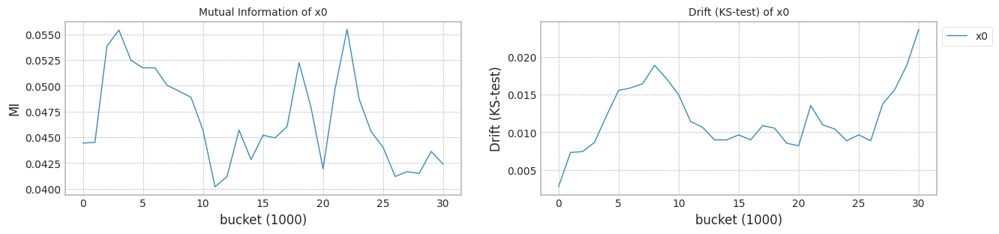

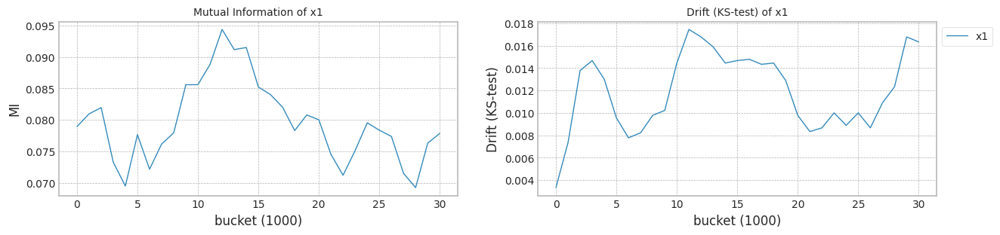

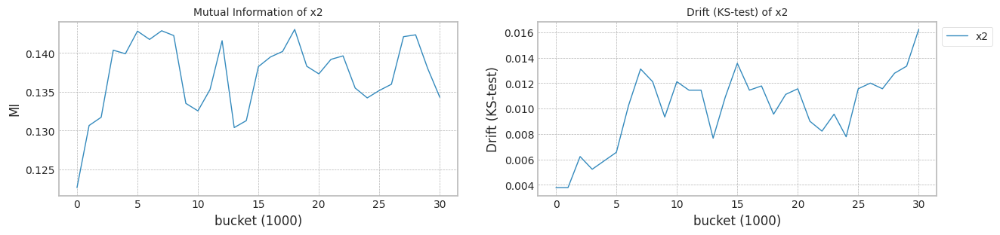

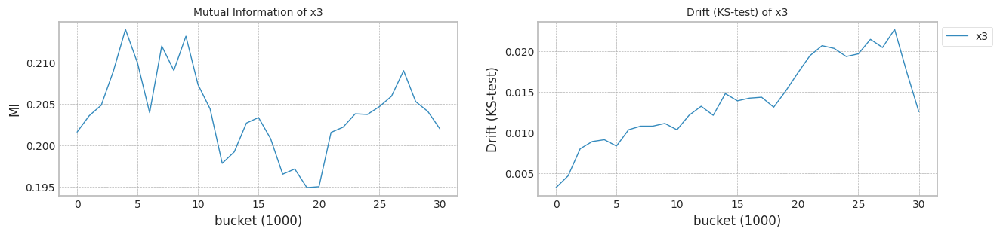

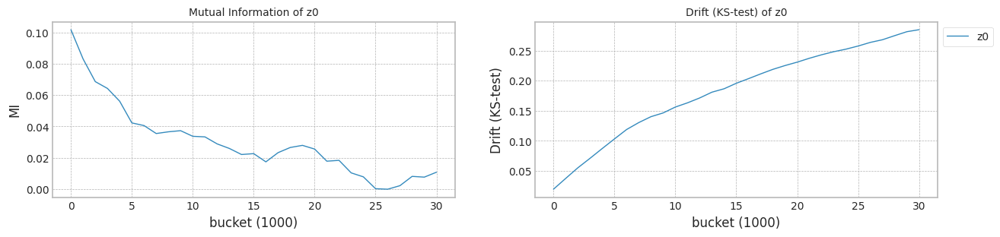

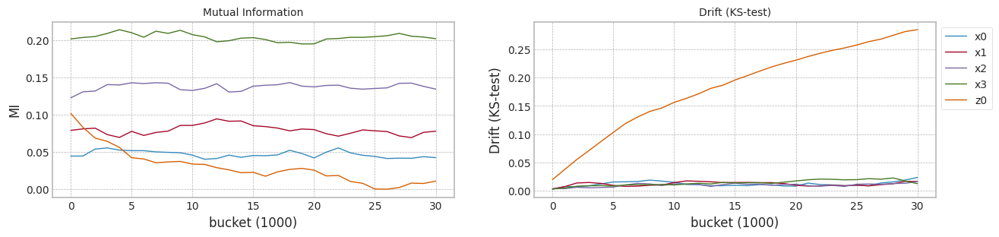

In [30]:
columns=['x0','x1','x2','x3','z0']
X = pd.DataFrame(x,columns=columns)
Y = y

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X, Y,train_size, test_size)
#model,df = train_classificaion_model(X1,Y1,train_size, test_size)

In [31]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.520974,0.392205,0.600995,0.478669,0.421766,0
1,0.447230,0.556479,0.629077,0.735705,0.529014,0
2,0.489501,0.704159,0.760582,0.582973,0.570549,0
3,0.581446,0.301839,0.443337,0.515173,0.396001,0
4,0.571642,0.639275,0.524701,0.583380,0.561748,0
...,...,...,...,...,...,...
39995,0.346158,0.267147,0.513105,0.599663,0.185740,39
39996,0.426322,0.302644,0.484909,0.587518,0.721101,39
39997,0.374186,0.587769,0.624447,0.598315,0.489479,39
39998,0.470439,0.265430,0.218971,0.645349,1.258888,39


### Main 실험

trial_count: 2
Lambda :  0.9
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-27 12:16:03,578] [INFO] [profiler.py:80:start_profile] Flops profiler started


 36%|███▌      | 712/2000 [00:01<00:02, 477.31it/s]

Early stop: 712
[2023-11-27 12:16:05,075] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2791395000
precision_recall_fscore: (array([0.87869222, 0.8720701 ]), array([0.86967195, 0.88094711]), array([0.87415882, 0.87648613]), array([4481, 4519]))
Test f1 score: 0.8764861294583884
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.16it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.794983046014775
inference_flops: 121365000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-27 12:16:11,124] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:16:11,126] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 19%|█▉        | 380/2000 [00:02<00:10, 157.05it/s]

[2023-11-27 12:16:22,264] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:16:22,265] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6000750000 1491615000 38992365000
precision_recall_fscore: (array([0.88963288, 0.86549582]), array([0.85985271, 0.89422439]), array([0.87448933, 0.8796256 ]), array([4481, 4519]))
Test f1 score: 0.8796255986068786
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.95it/s]


mean of drift:
x0    0.165380
x1    0.098602
x2    0.143211
x3    0.155839
z0    0.223373
dtype: float64
Mean F1 for all data: 0.8239327060702275
inference_flops: 609615000
Normal model median        : 0.794983046014775
Drift tolerant model median: 0.8239327060702275
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-27 12:16:28,566] [INFO] [profiler.py:80:start_profile] Flops profiler started


 30%|███       | 604/2000 [00:01<00:02, 471.88it/s]

Early stop: 604
[2023-11-27 12:16:29,852] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2368575000
precision_recall_fscore: (array([0.87809267, 0.8732982 ]), array([0.8712341 , 0.88006196]), array([0.87464994, 0.87666703]), array([4481, 4519]))
Test f1 score: 0.8766670340570925
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.14it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.7947399839253698
inference_flops: 121365000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-27 12:16:35,921] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:16:35,923] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 22%|██▏       | 448/2000 [00:02<00:09, 156.06it/s]

[2023-11-27 12:16:47,550] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:16:47,551] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7071750000 1757835000 40329585000
precision_recall_fscore: (array([0.88436929, 0.86786332]), array([0.86364651, 0.88802832]), array([0.87388506, 0.87783003]), array([4481, 4519]))
Test f1 score: 0.8778300339057202
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.78it/s]


mean of drift:
x0    0.261728
x1    0.139082
x2    0.131147
x3    0.153455
z0    0.286011
dtype: float64
Mean F1 for all data: 0.8200223312085968
inference_flops: 609615000
Normal model median        : 0.7948615149700724
Drift tolerant model median: 0.8219775186394122
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.94it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-27 12:16:57,373] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:16:57,376] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 12:16:59,960] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:16:59,962] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:05<00:14,  1.02it/s]

G-CDTL train flops: 70000000 686000000 170520000 926520000


100%|██████████| 31/31 [00:08<00:00,  3.49it/s]


Early stop at  [391]
Train flops  [926520000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8491383663930777
G_CDTL+AUE median: 0.8491383663930777
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:06<00:11,  1.23it/s]

Ensemble_SEA train flops: 753855000


100%|██████████| 31/31 [00:09<00:00,  3.43it/s]


Early stop at  [1732]
Train flops  [753855000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8213580414630952
SEA median: 0.8213580414630952
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:03,  3.60it/s]

Ensemble_SEA train flops: 113535000


100%|██████████| 31/31 [00:06<00:00,  4.82it/s]


Early stop at  [260]
Train flops  [113535000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8354850553863213
AUE median: 0.8354850553863213
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  5.04it/s]

Ensemble_DTEL train flops: 463710000


 55%|█████▍    | 17/31 [00:07<00:15,  1.11s/it]

Ensemble_DTEL train flops: 652065000


100%|██████████| 31/31 [00:10<00:00,  2.95it/s]


Early stop at  [1065, 1498]
Train flops  [463710000, 652065000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8435571844311421
DTEL median: 0.8435571844311421
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.94it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-27 12:17:32,260] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:17:32,262] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 12:17:43,262] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:17:43,263] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 17/31 [00:14<00:35,  2.52s/it]

G-CDTL train flops: 3500000000 764750000 190095000 4454845000


100%|██████████| 31/31 [00:17<00:00,  1.80it/s]


Early stop at  [436]
Train flops  [4454845000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8473517178717932
G_CDTL+AUE median: 0.8482450421324355
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:04,  3.02it/s]

Ensemble_SEA train flops: 184005000


100%|██████████| 31/31 [00:06<00:00,  4.65it/s]


Early stop at  [422]
Train flops  [184005000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8208706443810264
SEA median: 0.8211143429220609
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:05<00:09,  1.46it/s]

Ensemble_SEA train flops: 582030000


100%|██████████| 31/31 [00:08<00:00,  3.66it/s]


Early stop at  [1337]
Train flops  [582030000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8364169970717854
AUE median: 0.8359510262290534
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  5.13it/s]

Ensemble_DTEL train flops: 307545000


 55%|█████▍    | 17/31 [00:05<00:09,  1.41it/s]

Ensemble_DTEL train flops: 387150000


100%|██████████| 31/31 [00:08<00:00,  3.60it/s]


Early stop at  [706, 889]
Train flops  [307545000, 387150000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8435412411372872
DTEL median: 0.8435492127842147


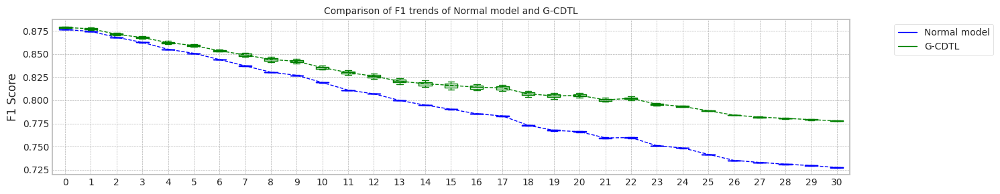

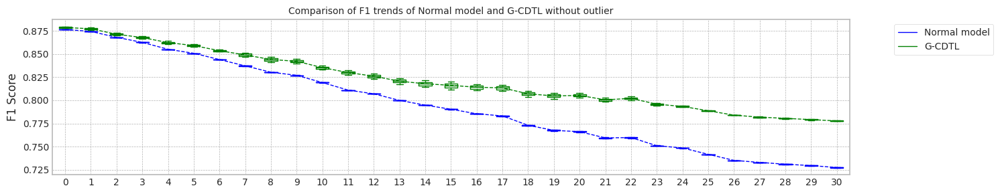

max_mean_trial= 0


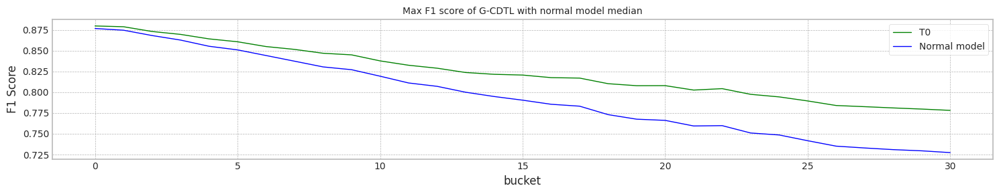

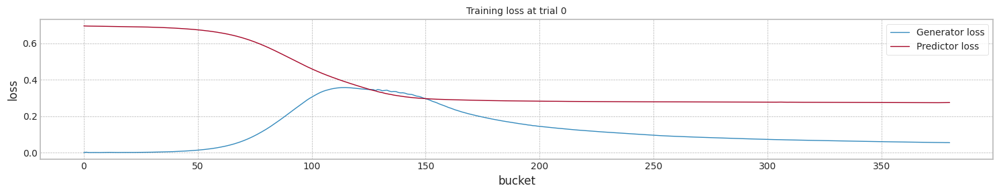

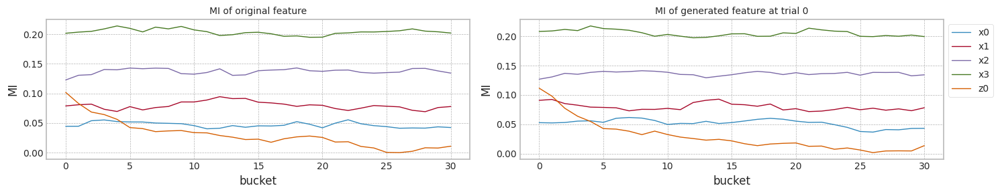

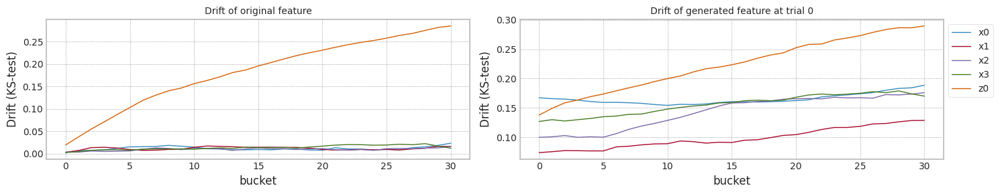

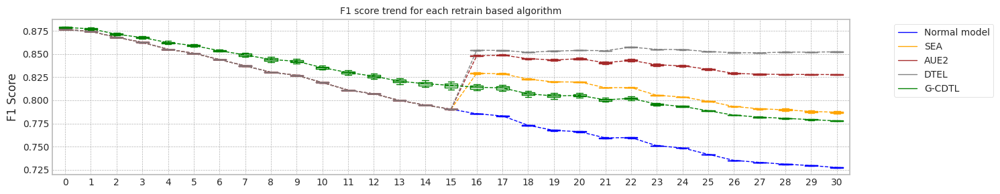

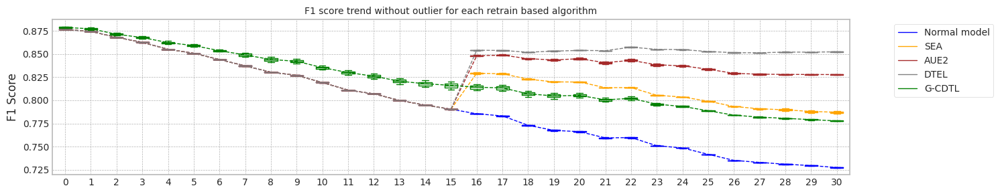

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.041712641716003
Base flops (inference flops of normal model, median): 121365000.0


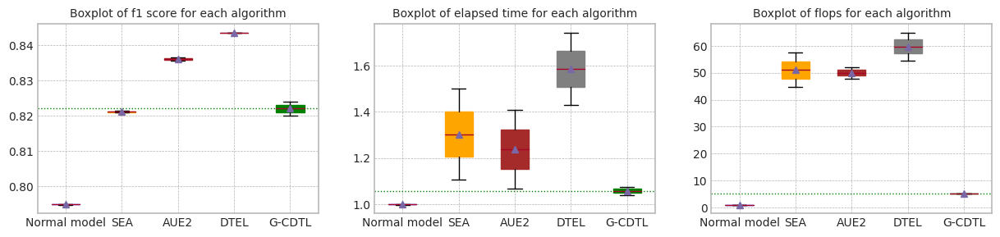

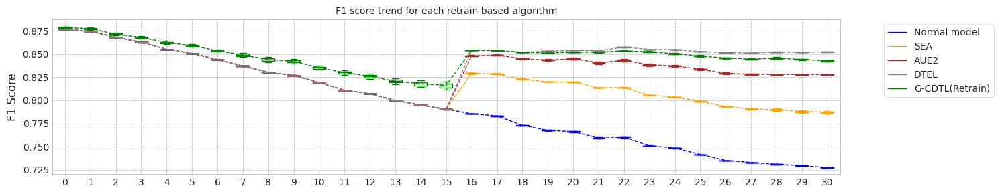

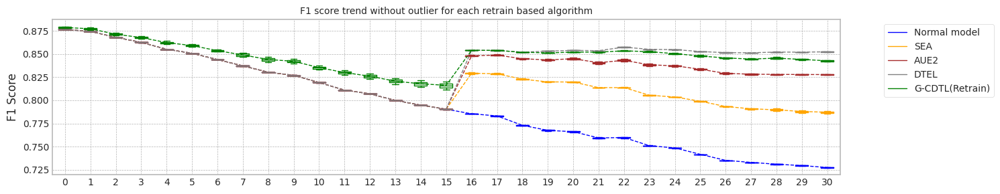

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.041712641716003
Base flops (train + inference flops of normal model, median): 2701350000.0


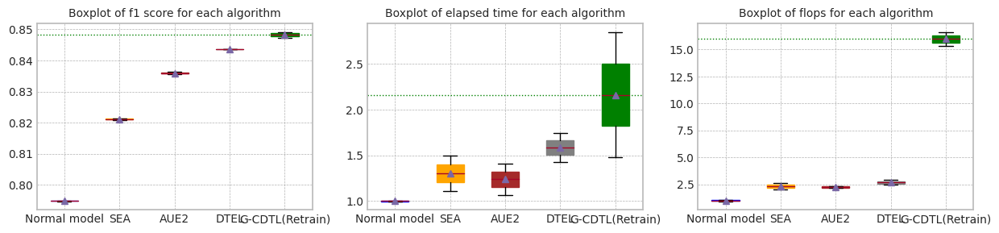

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.041712641716003


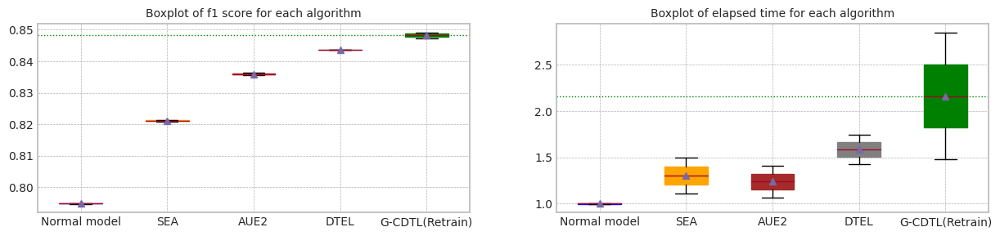

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876486,0.874420,0.794983,0.727253,6.032604,2.791395e+09,121365000.0,2.912760e+09
1,1.0,0.876667,0.874599,0.794740,0.727474,6.050821,2.368575e+09,121365000.0,2.489940e+09
2,median,0.876577,0.874509,0.794862,0.727363,6.041713,2.579985e+09,121365000.0,2.701350e+09
3,std,0.000128,0.000127,0.000172,0.000156,0.012881,2.989789e+08,0.0,2.989789e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.879626,0.878689,0.823933,0.778139,6.283300,3.899236e+10,609615000.0,3.960198e+10
1,1.0,0.877830,0.876044,0.820022,0.777473,6.506120,4.032958e+10,609615000.0,4.093920e+10
2,median,0.878728,0.877366,0.821978,0.777806,6.394710,3.966098e+10,609615000.0,4.027059e+10
3,std,0.001270,0.001870,0.002765,0.000471,0.157557,9.455573e+08,0.0,9.455573e+08


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876486,0.874420,0.821358,0.788767,9.054273,3.122430e+09,3.850620e+09,6.973050e+09
1,1.0,0.876667,0.874599,0.820871,0.785495,6.685684,2.552580e+09,2.857950e+09,5.410530e+09
2,median,0.876577,0.874509,0.821114,0.787131,7.869979,2.837505e+09,3.354285e+09,6.191790e+09
3,std,0.000128,0.000127,0.000345,0.002314,1.674845,4.029448e+08,7.019237e+08,1.104868e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876486,0.874420,0.835485,0.827586,6.461599,2.482110e+09,3.331665e+09,5.813775e+09
1,1.0,0.876667,0.874599,0.836417,0.828115,8.499070,2.950605e+09,3.377340e+09,6.327945e+09
2,median,0.876577,0.874509,0.835951,0.827850,7.480335,2.716358e+09,3.354502e+09,6.070860e+09
3,std,0.000128,0.000127,0.000659,0.000374,1.440710,3.312760e+08,3.229710e+07,3.635731e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876486,0.874420,0.843557,0.852838,10.528309,3.484350e+09,4.396545e+09,7.880895e+09
1,1.0,0.876667,0.874599,0.843541,0.852100,8.642614,3.063270e+09,3.552645e+09,6.615915e+09
2,median,0.876577,0.874509,0.843549,0.852469,9.585461,3.273810e+09,3.974595e+09,7.248405e+09
3,std,0.000128,0.000127,0.000011,0.000522,1.333388,2.977485e+08,5.967274e+08,8.944759e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.879626,0.878689,0.849138,0.841749,8.915519,4.125610e+10,134325000.0,4.139043e+10
1,1.0,0.877830,0.876044,0.847352,0.843676,17.201915,4.478443e+10,134325000.0,4.491876e+10
2,median,0.878728,0.877366,0.848245,0.842712,13.058717,4.302027e+10,134325000.0,4.315459e+10
3,std,0.001270,0.001870,0.001263,0.001363,5.859367,2.494903e+09,0.0,2.494903e+09


In [40]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case1',X1, Y1,train_size, test_size,avaible_range = 300,
                                                            lambda_f2=0.9,trial_count=2,lr_g=0.002,
                                                            retrain_count=1,weight_init=True)

trial_count: 2
Lambda :  0.9
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-26 12:06:41,465] [INFO] [profiler.py:80:start_profile] Flops profiler started


 11%|█▏        | 227/2000 [00:00<00:04, 377.86it/s]

Early stop: 227
[2023-11-26 12:06:42,076] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 892620000
precision_recall_fscore: (array([0.87878104, 0.87133479]), array([0.86877929, 0.8811684 ]), array([0.87375154, 0.87622401]), array([4481, 4519]))
Test f1 score: 0.8762240070414787
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.91it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.793844292419275
inference_flops: 121365000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 12:06:48,429] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:06:48,431] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 161.06it/s]

[2023-11-26 12:07:00,857] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:07:00,859] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.88372093, 0.86887733]), array([0.86498549, 0.88714317]), array([0.87425285, 0.87791525]), array([4481, 4519]))
Test f1 score: 0.8779152523814737
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.11it/s]

mean of drift:
x0    0.328362
x1    0.176735
x2    0.082961
x3    0.099258
z0    0.417477
dtype: float64
Mean F1 for all data: 0.8286959262310046
inference_flops: 609615000
Normal model median        : 0.793844292419275
Drift tolerant model median: 0.8286959262310046
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-26 12:07:06,966] [INFO] [profiler.py:80:start_profile] Flops profiler started



 14%|█▎        | 271/2000 [00:00<00:03, 473.68it/s]

Early stop: 271
[2023-11-26 12:07:07,545] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1064880000
precision_recall_fscore: (array([0.87989143, 0.87093252]), array([0.8681098 , 0.88249613]), array([0.87396091, 0.87667619]), array([4481, 4519]))
Test f1 score: 0.8766761925697956
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.06it/s]

mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.7942263404081991
inference_flops: 121365000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 12:07:13,719] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:07:13,722] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 159.71it/s]

[2023-11-26 12:07:26,252] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:07:26,255] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.8781362 , 0.87632275]), array([0.87480473, 0.87961938]), array([0.8764673 , 0.87796797]), array([4481, 4519]))
Test f1 score: 0.8779679734953065
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.02it/s]


mean of drift:
x0    0.315333
x1    0.329308
x2    0.191297
x3    0.197401
z0    0.523606
dtype: float64
Mean F1 for all data: 0.6513471798026521
inference_flops: 609615000
Normal model median        : 0.794035316413737
Drift tolerant model median: 0.7400215530168284
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  5.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:07:35,693] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:07:35,695] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:07:46,504] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:07:46,507] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:14<00:51,  3.46s/it]

G-CDTL train flops: 3064250000 761685000 3825935000


100%|██████████| 31/31 [00:17<00:00,  1.82it/s]


Early stop at  [1750]
Train flops  [3825935000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.845809238861372
G_CDTL+AUE median: 0.845809238861372
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:04<00:06,  2.09it/s]

Ensemble_SEA train flops: 394545000


100%|██████████| 31/31 [00:07<00:00,  4.09it/s]


Early stop at  [906]
Train flops  [394545000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8208805431549198
SEA median: 0.8208805431549198
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:03,  3.85it/s]

Ensemble_SEA train flops: 92220000


100%|██████████| 31/31 [00:06<00:00,  4.86it/s]


Early stop at  [211]
Train flops  [92220000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.836367981387885
AUE median: 0.836367981387885
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.07it/s]

Ensemble_DTEL train flops: 100920000


 52%|█████▏    | 16/31 [00:03<00:06,  2.31it/s]

Ensemble_DTEL train flops: 131805000


100%|██████████| 31/31 [00:07<00:00,  4.39it/s]


Early stop at  [231, 302]
Train flops  [100920000, 131805000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.843480927310786
DTEL median: 0.843480927310786
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.89it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:08:14,040] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:08:14,044] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:08:25,605] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:08:25,609] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:14<00:55,  3.70s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


100%|██████████| 31/31 [00:17<00:00,  1.72it/s]


Early stop at  [1999]
Train flops  [4370000000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8210469799725577
G_CDTL+AUE median: 0.8334281094169649
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:03,  3.54it/s]

Ensemble_SEA train flops: 121800000


100%|██████████| 31/31 [00:06<00:00,  4.73it/s]


Early stop at  [279]
Train flops  [121800000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8203773884763704
SEA median: 0.8206289658156452
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:04,  3.26it/s]

Ensemble_SEA train flops: 147900000


100%|██████████| 31/31 [00:06<00:00,  4.64it/s]


Early stop at  [339]
Train flops  [147900000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8358761629977424
AUE median: 0.8361220721928138
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.15it/s]

Ensemble_DTEL train flops: 142245000


 55%|█████▍    | 17/31 [00:04<00:05,  2.36it/s]

Ensemble_DTEL train flops: 185745000


100%|██████████| 31/31 [00:07<00:00,  4.31it/s]


Early stop at  [326, 426]
Train flops  [142245000, 185745000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8434586977429983
DTEL median: 0.8434698125268922


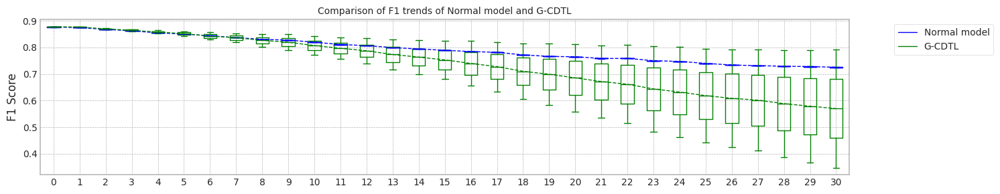

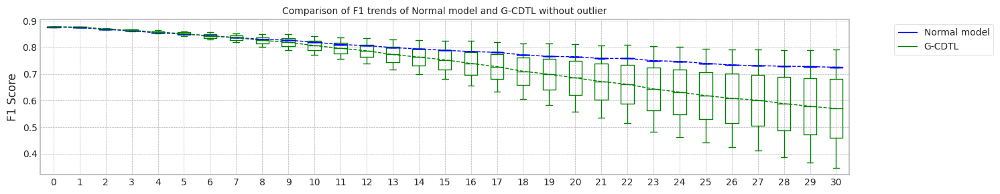

max_mean_trial= 0


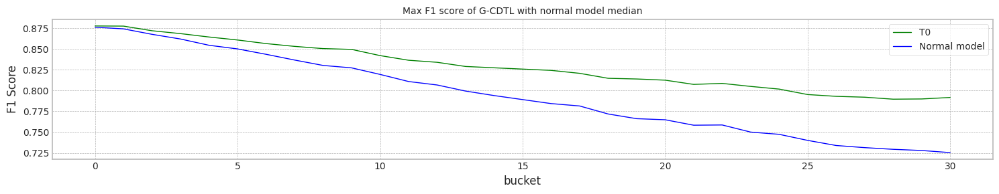

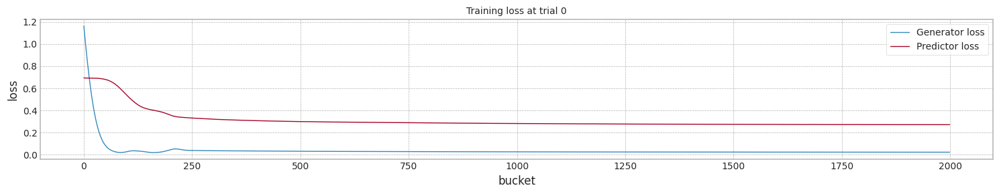

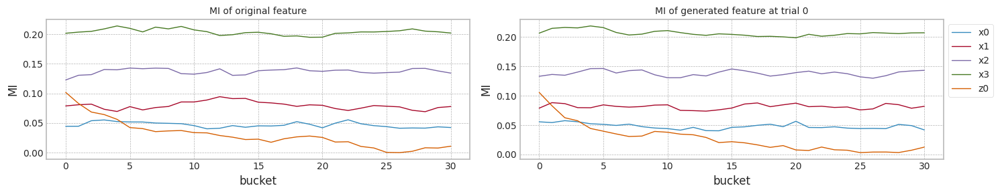

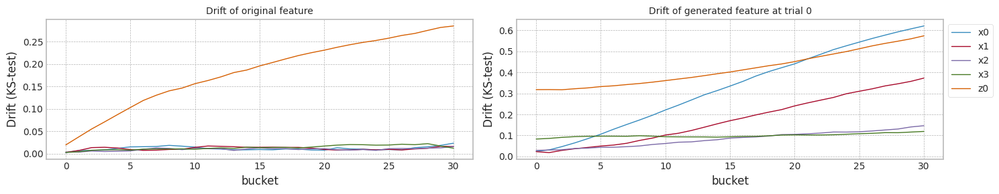

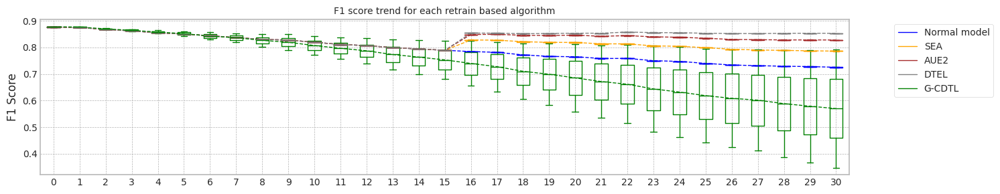

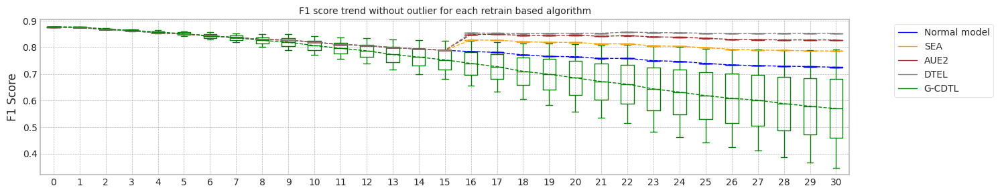

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.2462685108184814
Base flops (inference flops of normal model, median): 121365000.0


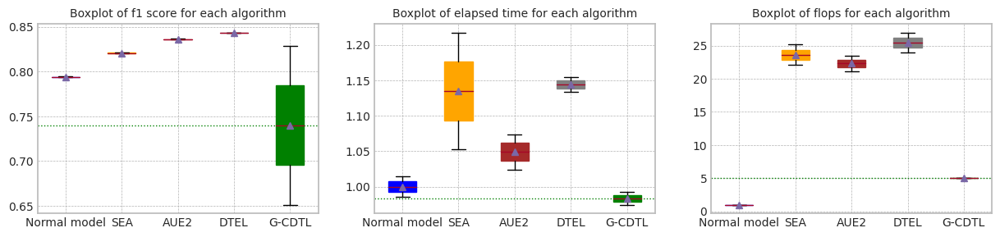

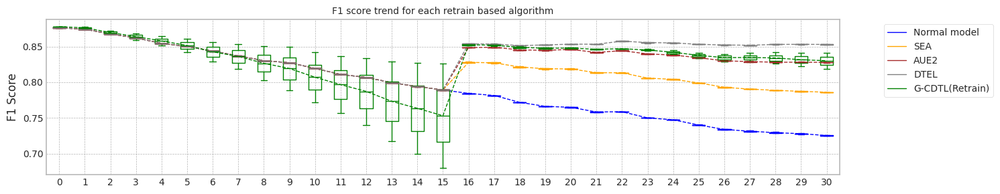

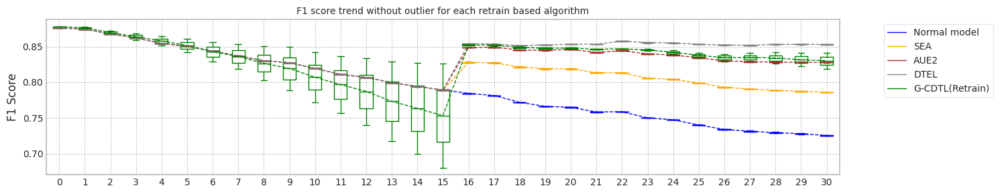

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.2462685108184814
Base flops (train + inference flops of normal model, median): 1100115000.0


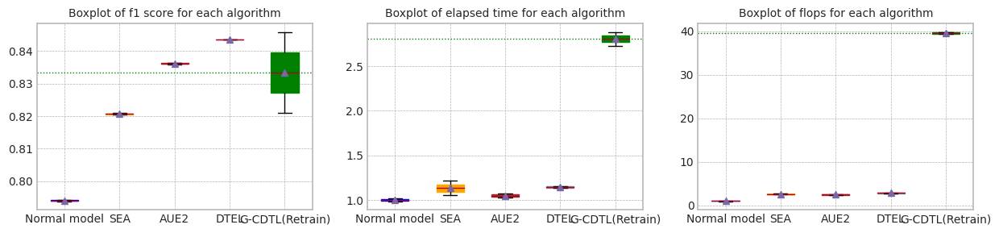

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.2462685108184814


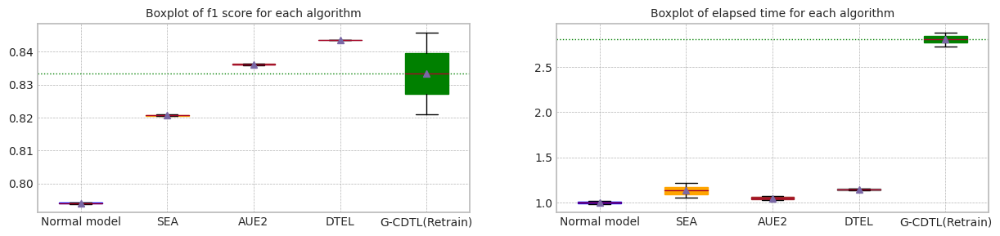

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.793844,0.724863,6.336978,8.926200e+08,121365000.0,1.013985e+09
1,1.0,0.876676,0.874448,0.794226,0.725792,6.155559,1.064880e+09,121365000.0,1.186245e+09
2,median,0.876450,0.874379,0.794035,0.725328,6.246269,9.787500e+08,121365000.0,1.100115e+09
3,std,0.000320,0.000098,0.000270,0.000657,0.128282,1.218062e+08,0.0,1.218062e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.877915,0.877728,0.828696,0.791767,6.088198,3.933000e+10,609615000.0,3.993962e+10
1,1.0,0.877968,0.875111,0.651347,0.347888,6.197638,3.933000e+10,609615000.0,3.993962e+10
2,median,0.877942,0.876420,0.740022,0.569828,6.142918,3.933000e+10,609615000.0,3.993962e+10
3,std,0.000037,0.001850,0.125405,0.313870,0.077385,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.820881,0.786276,7.604040,1.459425e+09,1.592535e+09,3.051960e+09
1,1.0,0.876676,0.874448,0.820377,0.785785,6.573437,1.186680e+09,1.492050e+09,2.678730e+09
2,median,0.876450,0.874379,0.820629,0.786030,7.088738,1.323052e+09,1.542292e+09,2.865345e+09
3,std,0.000320,0.000098,0.000356,0.000348,0.728746,1.928598e+08,7.105362e+07,2.639135e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.836368,0.828353,6.398938,1.157100e+09,1.411575e+09,2.568675e+09
1,1.0,0.876676,0.874448,0.835876,0.827428,6.709893,1.212780e+09,1.639515e+09,2.852295e+09
2,median,0.876450,0.874379,0.836122,0.827891,6.554416,1.184940e+09,1.525545e+09,2.710485e+09
3,std,0.000320,0.000098,0.000348,0.000654,0.219879,3.937171e+07,1.611779e+08,2.005496e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.843481,0.852612,7.079407,1.297605e+09,1.614720e+09,2.912325e+09
1,1.0,0.876676,0.874448,0.843459,0.853443,7.213258,1.392870e+09,1.882245e+09,3.275115e+09
2,median,0.876450,0.874379,0.843470,0.853027,7.146333,1.345238e+09,1.748482e+09,3.093720e+09
3,std,0.000320,0.000098,0.000016,0.000587,0.094647,6.736253e+07,1.891687e+08,2.565313e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.877915,0.877728,0.845809,0.819179,17.056053,4.315594e+10,134325000.0,4.329026e+10
1,1.0,0.877968,0.875111,0.821047,0.841191,18.013058,4.370000e+10,134325000.0,4.383432e+10
2,median,0.877942,0.876420,0.833428,0.830185,17.534555,4.342797e+10,134325000.0,4.356229e+10
3,std,0.000037,0.001850,0.017510,0.015565,0.676705,3.847121e+08,0.0,3.847121e+08


trial_count: 2
Lambda :  0.9
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-11-26 12:09:01,676] [INFO] [profiler.py:80:start_profile] Flops profiler started


 11%|█▏        | 227/2000 [00:00<00:03, 476.96it/s]

Early stop: 227
[2023-11-26 12:09:02,158] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 892620000
precision_recall_fscore: (array([0.87878104, 0.87133479]), array([0.86877929, 0.8811684 ]), array([0.87375154, 0.87622401]), array([4481, 4519]))
Test f1 score: 0.8762240070414787
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.71it/s]

mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.793844292419275
inference_flops: 121365000
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 12:09:08,788] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:09:08,790] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 154.34it/s]

[2023-11-26 12:09:21,757] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:09:21,758] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.88372093, 0.86887733]), array([0.86498549, 0.88714317]), array([0.87425285, 0.87791525]), array([4481, 4519]))
Test f1 score: 0.8779152523814737
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.05it/s]


mean of drift:
x0    0.328362
x1    0.176735
x2    0.082961
x3    0.099258
z0    0.417477
dtype: float64
Mean F1 for all data: 0.8286959262310046
inference_flops: 609615000
Normal model median        : 0.793844292419275
Drift tolerant model median: 0.8286959262310046
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-11-26 12:09:27,944] [INFO] [profiler.py:80:start_profile] Flops profiler started


 14%|█▎        | 271/2000 [00:00<00:03, 471.23it/s]

Early stop: 271
[2023-11-26 12:09:28,524] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1064880000
precision_recall_fscore: (array([0.87989143, 0.87093252]), array([0.8681098 , 0.88249613]), array([0.87396091, 0.87667619]), array([4481, 4519]))
Test f1 score: 0.8766761925697956
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.01it/s]

mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.7942263404081991
inference_flops: 121365000
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 12:09:34,751] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:09:34,754] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 159.16it/s]

[2023-11-26 12:09:47,329] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:09:47,330] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.8781362 , 0.87632275]), array([0.87480473, 0.87961938]), array([0.8764673 , 0.87796797]), array([4481, 4519]))
Test f1 score: 0.8779679734953065
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.06it/s]


mean of drift:
x0    0.315333
x1    0.329308
x2    0.191297
x3    0.197401
z0    0.523606
dtype: float64
Mean F1 for all data: 0.6513471798026521
inference_flops: 609615000
Normal model median        : 0.794035316413737
Drift tolerant model median: 0.7400215530168284
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:01<00:04,  4.96it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:09:55,695] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:09:55,698] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:09:58,487] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:09:58,488] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:04<00:21,  1.06s/it]

G-CDTL train flops: 829500000 206190000 1035690000


 68%|██████▊   | 21/31 [00:06<00:02,  4.42it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:10:00,718] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:10:00,721] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:10:12,545] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:10:12,547] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 74%|███████▍  | 23/31 [00:19<00:21,  2.70s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


100%|██████████| 31/31 [00:20<00:00,  1.49it/s]


Early stop at  [473, 1999]
Train flops  [1035690000, 4370000000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8518449234471854
G_CDTL+AUE median: 0.8518449234471854
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 35%|███▌      | 11/31 [00:02<00:06,  3.30it/s]

Ensemble_SEA train flops: 92655000


 74%|███████▍  | 23/31 [00:05<00:02,  3.40it/s]

Ensemble_SEA train flops: 130065000


100%|██████████| 31/31 [00:06<00:00,  4.43it/s]


Early stop at  [212, 298]
Train flops  [92655000, 130065000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8323452923868279
SEA median: 0.8323452923868279
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:02<00:05,  3.58it/s]

Ensemble_SEA train flops: 113535000


 74%|███████▍  | 23/31 [00:05<00:02,  3.86it/s]

Ensemble_SEA train flops: 92655000


100%|██████████| 31/31 [00:06<00:00,  4.56it/s]


Early stop at  [260, 212]
Train flops  [113535000, 92655000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8433570293245638
AUE median: 0.8433570293245638
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:02<00:04,  5.00it/s]

Ensemble_DTEL train flops: 150075000


 35%|███▌      | 11/31 [00:03<00:09,  2.14it/s]

Ensemble_DTEL train flops: 94830000


 71%|███████   | 22/31 [00:05<00:02,  3.05it/s]

Ensemble_DTEL train flops: 114405000
Ensemble_DTEL train flops: 10005000


100%|██████████| 31/31 [00:07<00:00,  4.11it/s]


Early stop at  [344, 217, 262, 22]
Train flops  [150075000, 94830000, 114405000, 10005000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8517399604509824
DTEL median: 0.8517399604509824
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:02<00:04,  4.85it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:10:38,056] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:10:38,060] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:10:49,922] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:10:49,924] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:14<01:16,  3.84s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


 68%|██████▊   | 21/31 [00:16<00:03,  3.33it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:10:52,131] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:10:52,134] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:10:58,353] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:10:58,355] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 74%|███████▍  | 23/31 [00:22<00:12,  1.56s/it]

G-CDTL train flops: 1795500000 446310000 2241810000


100%|██████████| 31/31 [00:24<00:00,  1.27it/s]


Early stop at  [1999, 1025]
Train flops  [4370000000, 2241810000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8405917289736785
G_CDTL+AUE median: 0.8462183262104319
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:02<00:05,  3.41it/s]

Ensemble_SEA train flops: 136155000


 71%|███████   | 22/31 [00:05<00:02,  3.24it/s]

Ensemble_SEA train flops: 104835000


100%|██████████| 31/31 [00:06<00:00,  4.49it/s]


Early stop at  [312, 240]
Train flops  [136155000, 104835000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8322210004049748
SEA median: 0.8322831463959013
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:02<00:05,  3.35it/s]

Ensemble_SEA train flops: 139635000


 71%|███████   | 22/31 [00:05<00:02,  3.17it/s]

Ensemble_SEA train flops: 106140000


100%|██████████| 31/31 [00:07<00:00,  4.37it/s]


Early stop at  [320, 243]
Train flops  [139635000, 106140000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8428321110882352
AUE median: 0.8430945702063994
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:01<00:04,  5.15it/s]

Ensemble_DTEL train flops: 90045000


 35%|███▌      | 11/31 [00:03<00:09,  2.01it/s]

Ensemble_DTEL train flops: 207930000


 74%|███████▍  | 23/31 [00:05<00:02,  3.73it/s]

Ensemble_DTEL train flops: 93525000
Ensemble_DTEL train flops: 870000


100%|██████████| 31/31 [00:07<00:00,  4.20it/s]


Early stop at  [206, 477, 214, 1]
Train flops  [90045000, 207930000, 93525000, 870000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8465417255390174
DTEL median: 0.8491408429949999


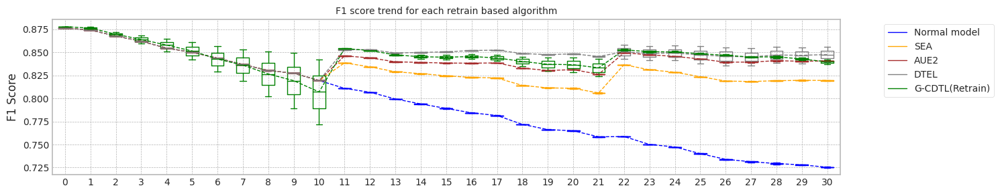

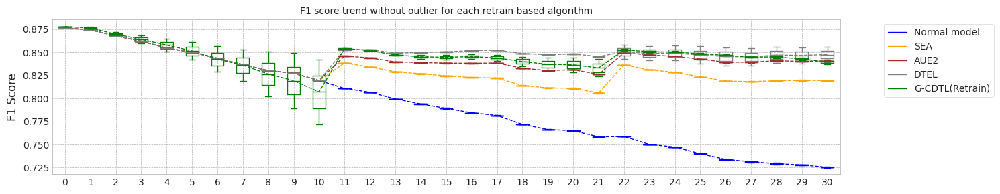

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.4113065004348755
Base flops (train + inference flops of normal model, median): 1100115000.0


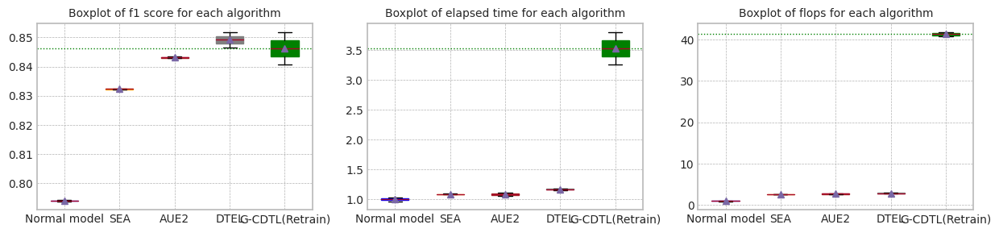

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.4113065004348755


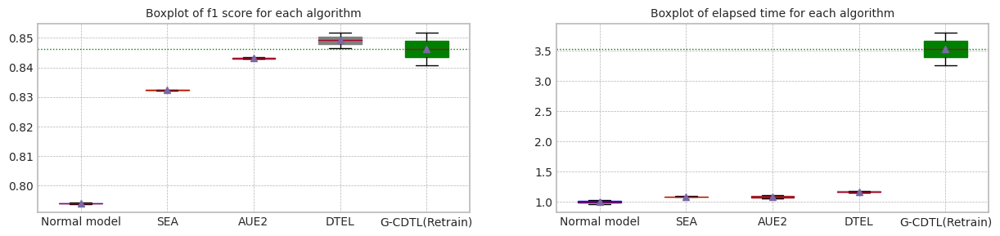

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.793844,0.724863,6.613060,8.926200e+08,121365000.0,1.013985e+09
1,1.0,0.876676,0.874448,0.794226,0.725792,6.209553,1.064880e+09,121365000.0,1.186245e+09
2,median,0.876450,0.874379,0.794035,0.725328,6.411307,9.787500e+08,121365000.0,1.100115e+09
3,std,0.000320,0.000098,0.000270,0.000657,0.285323,1.218062e+08,0.0,1.218062e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.877915,0.877728,0.828696,0.791767,6.166366,3.933000e+10,609615000.0,3.993962e+10
1,1.0,0.877968,0.875111,0.651347,0.347888,6.145385,3.933000e+10,609615000.0,3.993962e+10
2,median,0.877942,0.876420,0.740022,0.569828,6.155875,3.933000e+10,609615000.0,3.993962e+10
3,std,0.000037,0.001850,0.125405,0.313870,0.014836,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.832345,0.819043,7.019217,1.287600e+09,1.475520e+09,2.763120e+09
1,1.0,0.876676,0.874448,0.832221,0.820106,6.928119,1.305870e+09,1.666050e+09,2.971920e+09
2,median,0.876450,0.874379,0.832283,0.819575,6.973668,1.296735e+09,1.570785e+09,2.867520e+09
3,std,0.000320,0.000098,0.000088,0.000751,0.064416,1.291884e+07,1.347251e+08,1.476439e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.843357,0.841501,6.818850,1.271070e+09,1.580355e+09,2.851425e+09
1,1.0,0.876676,0.874448,0.842832,0.840186,7.123312,1.310655e+09,1.792200e+09,3.102855e+09
2,median,0.876450,0.874379,0.843095,0.840843,6.971081,1.290862e+09,1.686278e+09,2.977140e+09
3,std,0.000320,0.000098,0.000371,0.000930,0.215287,2.799082e+07,1.497970e+08,1.777879e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.851740,0.855797,7.562108,1.434195e+09,1.601235e+09,3.035430e+09
1,1.0,0.876676,0.874448,0.846542,0.839608,7.410666,1.457250e+09,1.856580e+09,3.313830e+09
2,median,0.876450,0.874379,0.849141,0.847702,7.486387,1.445722e+09,1.728908e+09,3.174630e+09
3,std,0.000320,0.000098,0.003676,0.011447,0.107086,1.630235e+07,1.805562e+08,1.968585e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.877915,0.877728,0.851845,0.837023,20.873800,4.473569e+10,80595000.0,4.481628e+10
1,1.0,0.877968,0.875111,0.840592,0.842456,24.388858,4.594181e+10,80595000.0,4.602240e+10
2,median,0.877942,0.876420,0.846218,0.839739,22.631329,4.533875e+10,80595000.0,4.541934e+10
3,std,0.000037,0.001850,0.007957,0.003842,2.485521,8.528556e+08,0.0,8.528556e+08


trial_count: 2
Lambda :  0.9
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-11-26 12:11:26,126] [INFO] [profiler.py:80:start_profile] Flops profiler started


 11%|█▏        | 227/2000 [00:00<00:03, 456.54it/s]

Early stop: 227
[2023-11-26 12:11:26,629] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 892620000
precision_recall_fscore: (array([0.87878104, 0.87133479]), array([0.86877929, 0.8811684 ]), array([0.87375154, 0.87622401]), array([4481, 4519]))
Test f1 score: 0.8762240070414787
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.00it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.793844292419275
inference_flops: 121365000
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 12:11:32,872] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:11:32,874] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 150.63it/s]

[2023-11-26 12:11:46,158] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:11:46,160] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.88372093, 0.86887733]), array([0.86498549, 0.88714317]), array([0.87425285, 0.87791525]), array([4481, 4519]))
Test f1 score: 0.8779152523814737
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.97it/s]

mean of drift:
x0    0.328362
x1    0.176735
x2    0.082961
x3    0.099258
z0    0.417477
dtype: float64
Mean F1 for all data: 0.8286959262310046
inference_flops: 609615000
Normal model median        : 0.793844292419275
Drift tolerant model median: 0.8286959262310046
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-11-26 12:11:52,435] [INFO] [profiler.py:80:start_profile] Flops profiler started



 14%|█▎        | 271/2000 [00:00<00:03, 436.33it/s]

Early stop: 271
[2023-11-26 12:11:53,063] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1064880000
precision_recall_fscore: (array([0.87989143, 0.87093252]), array([0.8681098 , 0.88249613]), array([0.87396091, 0.87667619]), array([4481, 4519]))
Test f1 score: 0.8766761925697956
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.96it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.7942263404081991
inference_flops: 121365000
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 12:11:59,355] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:11:59,357] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 151.63it/s]

[2023-11-26 12:12:12,554] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:12:12,555] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.8781362 , 0.87632275]), array([0.87480473, 0.87961938]), array([0.8764673 , 0.87796797]), array([4481, 4519]))
Test f1 score: 0.8779679734953065
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.99it/s]


mean of drift:
x0    0.315333
x1    0.329308
x2    0.191297
x3    0.197401
z0    0.523606
dtype: float64
Mean F1 for all data: 0.6513471798026521
inference_flops: 609615000
Normal model median        : 0.794035316413737
Drift tolerant model median: 0.7400215530168284
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:12:20,425] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:12:20,428] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:12:29,294] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:12:29,295] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:10<01:09,  3.02s/it]

G-CDTL train flops: 2374750000 590295000 2965045000


 48%|████▊     | 15/31 [00:12<00:07,  2.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:12:31,094] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:12:31,097] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:12:36,144] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:12:36,146] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:17<00:28,  1.90s/it]

G-CDTL train flops: 1396500000 347130000 1743630000


 74%|███████▍  | 23/31 [00:18<00:02,  2.89it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:12:37,823] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:12:37,825] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:12:50,245] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:12:50,246] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:31<00:28,  4.03s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


100%|██████████| 31/31 [00:32<00:00,  1.06s/it]


Early stop at  [1356, 797, 1999]
Train flops  [2965045000, 1743630000, 4370000000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8550558499747231
G_CDTL+AUE median: 0.8550558499747231
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:05,  4.03it/s]

Ensemble_SEA train flops: 62640000


 55%|█████▍    | 17/31 [00:04<00:04,  3.40it/s]

Ensemble_SEA train flops: 131370000


 77%|███████▋  | 24/31 [00:06<00:03,  2.08it/s]

Ensemble_SEA train flops: 262740000


100%|██████████| 31/31 [00:07<00:00,  3.97it/s]


Early stop at  [143, 301, 603]
Train flops  [62640000, 131370000, 262740000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8426605308426766
SEA median: 0.8426605308426766
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:05,  3.78it/s]

Ensemble_SEA train flops: 100485000


 52%|█████▏    | 16/31 [00:04<00:07,  2.11it/s]

Ensemble_SEA train flops: 266220000


 77%|███████▋  | 24/31 [00:06<00:02,  2.55it/s]

Ensemble_SEA train flops: 165300000


100%|██████████| 31/31 [00:07<00:00,  3.92it/s]


Early stop at  [230, 611, 379]
Train flops  [100485000, 266220000, 165300000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8525811476738328
AUE median: 0.8525811476738328
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:01<00:07,  3.13it/s]

Ensemble_DTEL train flops: 65685000
Ensemble_DTEL train flops: 50895000


 55%|█████▍    | 17/31 [00:04<00:03,  3.69it/s]

Ensemble_DTEL train flops: 103530000
Ensemble_DTEL train flops: 870000


 74%|███████▍  | 23/31 [00:05<00:01,  4.99it/s]

Ensemble_DTEL train flops: 105705000


 77%|███████▋  | 24/31 [00:06<00:02,  2.33it/s]

Ensemble_DTEL train flops: 120495000


100%|██████████| 31/31 [00:07<00:00,  3.98it/s]


Early stop at  [150, 116, 237, 1, 242, 276]
Train flops  [65685000, 50895000, 103530000, 870000, 105705000, 120495000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.855068274733176
DTEL median: 0.855068274733176
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:13:16,926] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:13:16,929] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:13:29,021] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:13:29,023] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:13<01:33,  4.05s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


 48%|████▊     | 15/31 [00:15<00:07,  2.01it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:13:30,613] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:13:30,615] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:13:42,768] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:13:42,770] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:27<01:01,  4.07s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


 74%|███████▍  | 23/31 [00:28<00:04,  1.93it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:13:44,384] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:13:44,388] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:13:56,751] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:13:56,753] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:41<00:28,  4.14s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


100%|██████████| 31/31 [00:42<00:00,  1.38s/it]


Early stop at  [1999, 1999, 1999]
Train flops  [4370000000, 4370000000, 4370000000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8512374783158237
G_CDTL+AUE median: 0.8531466641452734
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:05,  3.73it/s]

Ensemble_SEA train flops: 90915000


 52%|█████▏    | 16/31 [00:04<00:05,  2.60it/s]

Ensemble_SEA train flops: 155730000


 81%|████████  | 25/31 [00:06<00:01,  3.52it/s]

Ensemble_SEA train flops: 107010000


100%|██████████| 31/31 [00:07<00:00,  4.14it/s]


Early stop at  [208, 357, 245]
Train flops  [90915000, 155730000, 107010000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8431217002033498
SEA median: 0.8428911155230132
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:06,  3.46it/s]

Ensemble_SEA train flops: 112230000


 52%|█████▏    | 16/31 [00:04<00:05,  2.86it/s]

Ensemble_SEA train flops: 139200000


 77%|███████▋  | 24/31 [00:06<00:02,  3.02it/s]

Ensemble_SEA train flops: 123105000


100%|██████████| 31/31 [00:07<00:00,  4.14it/s]


Early stop at  [257, 319, 282]
Train flops  [112230000, 139200000, 123105000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8521527313003632
AUE median: 0.852366939487098
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.09it/s]

Ensemble_DTEL train flops: 93960000


 29%|██▉       | 9/31 [00:02<00:07,  2.76it/s]

Ensemble_DTEL train flops: 123105000


 55%|█████▍    | 17/31 [00:04<00:05,  2.77it/s]

Ensemble_DTEL train flops: 224895000
Ensemble_DTEL train flops: 870000


 77%|███████▋  | 24/31 [00:06<00:02,  3.07it/s]

Ensemble_DTEL train flops: 107445000
Ensemble_DTEL train flops: 9570000


100%|██████████| 31/31 [00:07<00:00,  3.92it/s]


Early stop at  [215, 282, 516, 1, 246, 21]
Train flops  [93960000, 123105000, 224895000, 870000, 107445000, 9570000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8543033874612994
DTEL median: 0.8546858310972377


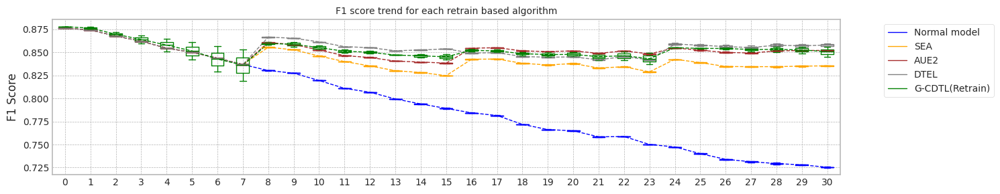

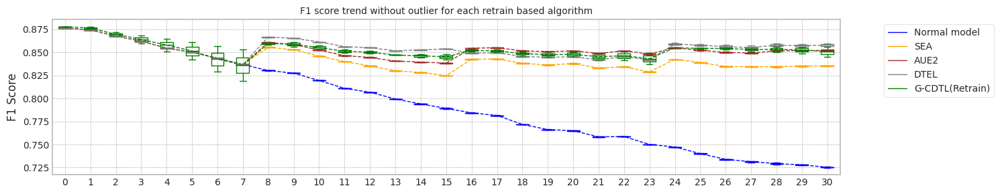

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.247842907905579
Base flops (train + inference flops of normal model, median): 1100115000.0


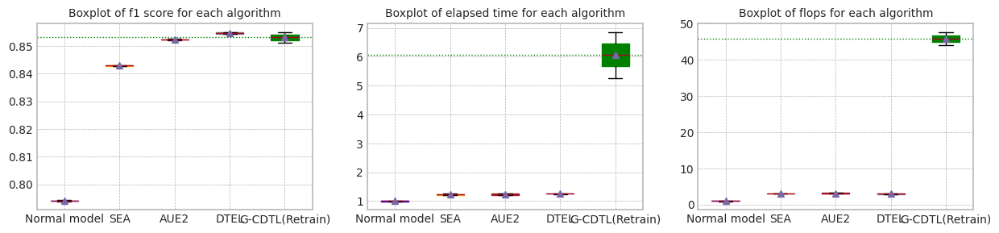

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.247842907905579


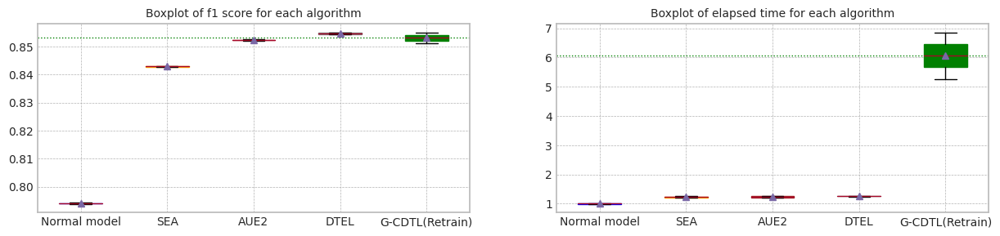

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.793844,0.724863,6.223016,8.926200e+08,121365000.0,1.013985e+09
1,1.0,0.876676,0.874448,0.794226,0.725792,6.272670,1.064880e+09,121365000.0,1.186245e+09
2,median,0.876450,0.874379,0.794035,0.725328,6.247843,9.787500e+08,121365000.0,1.100115e+09
3,std,0.000320,0.000098,0.000270,0.000657,0.035110,1.218062e+08,0.0,1.218062e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.877915,0.877728,0.828696,0.791767,6.256353,3.933000e+10,609615000.0,3.993962e+10
1,1.0,0.877968,0.875111,0.651347,0.347888,6.233026,3.933000e+10,609615000.0,3.993962e+10
2,median,0.877942,0.876420,0.740022,0.569828,6.244689,3.933000e+10,609615000.0,3.993962e+10
3,std,0.000037,0.001850,0.125405,0.313870,0.016495,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.842661,0.835000,7.839048,1.521630e+09,1.772190e+09,3.293820e+09
1,1.0,0.876676,0.874448,0.843122,0.835937,7.513132,1.418535e+09,1.841355e+09,3.259890e+09
2,median,0.876450,0.874379,0.842891,0.835469,7.676090,1.470082e+09,1.806772e+09,3.276855e+09
3,std,0.000320,0.000098,0.000326,0.000663,0.230457,7.289917e+07,4.890704e+07,2.399213e+07


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.852581,0.852558,7.942690,1.596885e+09,1.968810e+09,3.565695e+09
1,1.0,0.876676,0.874448,0.852153,0.851708,7.512937,1.439415e+09,1.983600e+09,3.423015e+09
2,median,0.876450,0.874379,0.852367,0.852133,7.727813,1.518150e+09,1.976205e+09,3.494355e+09
3,std,0.000320,0.000098,0.000303,0.000601,0.303881,1.113481e+08,1.045811e+07,1.008900e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.855068,0.859851,7.816245,1.512060e+09,1.659960e+09,3.172020e+09
1,1.0,0.876676,0.874448,0.854303,0.856152,7.943672,1.624725e+09,1.795245e+09,3.419970e+09
2,median,0.876450,0.874379,0.854686,0.858002,7.879958,1.568392e+09,1.727602e+09,3.295995e+09
3,std,0.000320,0.000098,0.000541,0.002616,0.090104,7.966619e+07,9.566094e+07,1.753271e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.877915,0.877728,0.855056,0.845518,32.913034,4.840868e+10,62685000.0,4.847136e+10
1,1.0,0.877968,0.875111,0.851237,0.855895,42.853656,5.244000e+10,62685000.0,5.250268e+10
2,median,0.877942,0.876420,0.853147,0.850706,37.883345,5.042434e+10,62685000.0,5.048702e+10
3,std,0.000037,0.001850,0.002700,0.007338,7.029081,2.850577e+09,0.0,2.850577e+09


trial_count: 2
Lambda :  0.9
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-11-26 12:14:25,426] [INFO] [profiler.py:80:start_profile] Flops profiler started


 11%|█▏        | 227/2000 [00:00<00:03, 451.60it/s]

Early stop: 227
[2023-11-26 12:14:25,934] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 892620000
precision_recall_fscore: (array([0.87878104, 0.87133479]), array([0.86877929, 0.8811684 ]), array([0.87375154, 0.87622401]), array([4481, 4519]))
Test f1 score: 0.8762240070414787
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.05it/s]

mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.793844292419275
inference_flops: 121365000
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 12:14:32,115] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:14:32,117] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 146.30it/s]

[2023-11-26 12:14:45,795] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:14:45,796] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.88372093, 0.86887733]), array([0.86498549, 0.88714317]), array([0.87425285, 0.87791525]), array([4481, 4519]))
Test f1 score: 0.8779152523814737
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.07it/s]

mean of drift:
x0    0.328362
x1    0.176735
x2    0.082961
x3    0.099258
z0    0.417477
dtype: float64
Mean F1 for all data: 0.8286959262310046
inference_flops: 609615000
Normal model median        : 0.793844292419275
Drift tolerant model median: 0.8286959262310046
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-11-26 12:14:51,957] [INFO] [profiler.py:80:start_profile] Flops profiler started



 14%|█▎        | 271/2000 [00:00<00:03, 447.98it/s]

Early stop: 271
[2023-11-26 12:14:52,567] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1064880000
precision_recall_fscore: (array([0.87989143, 0.87093252]), array([0.8681098 , 0.88249613]), array([0.87396091, 0.87667619]), array([4481, 4519]))
Test f1 score: 0.8766761925697956
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.16it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.7942263404081991
inference_flops: 121365000
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 12:14:58,613] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:14:58,616] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 149.27it/s]

[2023-11-26 12:15:12,025] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:15:12,026] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.8781362 , 0.87632275]), array([0.87480473, 0.87961938]), array([0.8764673 , 0.87796797]), array([4481, 4519]))
Test f1 score: 0.8779679734953065
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.20it/s]


mean of drift:
x0    0.315333
x1    0.329308
x2    0.191297
x3    0.197401
z0    0.523606
dtype: float64
Mean F1 for all data: 0.6513471798026521
inference_flops: 609615000
Normal model median        : 0.794035316413737
Drift tolerant model median: 0.7400215530168284
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:04,  5.19it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:15:19,389] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:15:19,391] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:15:31,868] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:15:31,870] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:13<01:42,  4.27s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


 42%|████▏     | 13/31 [00:15<00:11,  1.55it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:15:33,251] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:15:33,253] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:15:45,581] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:15:45,583] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 48%|████▊     | 15/31 [00:27<00:48,  3.02s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


 65%|██████▍   | 20/31 [00:28<00:07,  1.49it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:15:46,978] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:15:46,981] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:15:53,928] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:15:53,929] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:36<00:17,  1.89s/it]

G-CDTL train flops: 1926750000 478935000 2405685000


 87%|████████▋ | 27/31 [00:37<00:01,  2.09it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:15:55,290] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:15:55,293] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:16:07,895] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:16:07,896] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:49<00:12,  4.18s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


100%|██████████| 31/31 [00:50<00:00,  1.63s/it]


Early stop at  [1999, 1999, 1100, 1999]
Train flops  [4370000000, 4370000000, 2405685000, 4370000000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8537140099217917
G_CDTL+AUE median: 0.8537140099217917
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:07,  3.25it/s]

Ensemble_SEA train flops: 147900000


 48%|████▊     | 15/31 [00:03<00:04,  3.31it/s]

Ensemble_SEA train flops: 128325000


 71%|███████   | 22/31 [00:05<00:02,  3.74it/s]

Ensemble_SEA train flops: 86130000


 94%|█████████▎| 29/31 [00:07<00:00,  3.58it/s]

Ensemble_SEA train flops: 100920000


100%|██████████| 31/31 [00:07<00:00,  4.02it/s]


Early stop at  [339, 294, 197, 231]
Train flops  [147900000, 128325000, 86130000, 100920000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8480358708880866
SEA median: 0.8480358708880866
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:08,  2.72it/s]

Ensemble_SEA train flops: 142680000


 48%|████▊     | 15/31 [00:04<00:05,  2.83it/s]

Ensemble_SEA train flops: 194010000


 71%|███████   | 22/31 [00:06<00:02,  3.30it/s]

Ensemble_SEA train flops: 122670000


 94%|█████████▎| 29/31 [00:08<00:00,  2.67it/s]

Ensemble_SEA train flops: 236640000


100%|██████████| 31/31 [00:08<00:00,  3.61it/s]


Early stop at  [327, 445, 281, 543]
Train flops  [142680000, 194010000, 122670000, 236640000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8550537475946363
AUE median: 0.8550537475946363
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:04,  5.27it/s]

Ensemble_DTEL train flops: 124845000


 26%|██▌       | 8/31 [00:02<00:09,  2.48it/s]

Ensemble_DTEL train flops: 150075000


 48%|████▊     | 15/31 [00:04<00:04,  3.43it/s]

Ensemble_DTEL train flops: 103095000
Ensemble_DTEL train flops: 870000


 68%|██████▊   | 21/31 [00:05<00:03,  2.91it/s]

Ensemble_DTEL train flops: 115710000
Ensemble_DTEL train flops: 9570000


 90%|█████████ | 28/31 [00:08<00:01,  2.30it/s]

Ensemble_DTEL train flops: 208365000
Ensemble_DTEL train flops: 870000


100%|██████████| 31/31 [00:08<00:00,  3.60it/s]


Early stop at  [286, 344, 236, 1, 265, 21, 478, 1]
Train flops  [124845000, 150075000, 103095000, 870000, 115710000, 9570000, 208365000, 870000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8570911182174895
DTEL median: 0.8570911182174895
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:05,  4.86it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:16:34,979] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:16:34,982] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:16:40,548] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:16:40,550] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:07<00:48,  2.03s/it]

G-CDTL train flops: 1555750000 386715000 1942465000


 42%|████▏     | 13/31 [00:08<00:07,  2.57it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:16:41,909] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:16:41,913] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:16:54,539] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:16:54,540] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 48%|████▊     | 15/31 [00:21<00:47,  2.96s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


 65%|██████▍   | 20/31 [00:22<00:07,  1.52it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:16:55,910] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:16:55,913] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:17:00,314] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:17:00,316] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:26<00:18,  1.84s/it]

G-CDTL train flops: 1202250000 298845000 1501095000


 87%|████████▋ | 27/31 [00:27<00:01,  2.57it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:17:01,697] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:17:01,701] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:17:14,698] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:17:14,700] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:41<00:12,  4.23s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


100%|██████████| 31/31 [00:41<00:00,  1.35s/it]


Early stop at  [888, 1999, 686, 1999]
Train flops  [1942465000, 4370000000, 1501095000, 4370000000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8532990576493689
G_CDTL+AUE median: 0.8535065337855803
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:01<00:06,  3.61it/s]

Ensemble_SEA train flops: 94395000


 45%|████▌     | 14/31 [00:03<00:05,  3.37it/s]

Ensemble_SEA train flops: 90480000


 71%|███████   | 22/31 [00:05<00:02,  3.81it/s]

Ensemble_SEA train flops: 85260000


 94%|█████████▎| 29/31 [00:06<00:00,  3.68it/s]

Ensemble_SEA train flops: 96135000


100%|██████████| 31/31 [00:07<00:00,  4.21it/s]


Early stop at  [216, 207, 195, 220]
Train flops  [94395000, 90480000, 85260000, 96135000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8480440358872589
SEA median: 0.8480399533876728
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:10,  2.22it/s]

Ensemble_SEA train flops: 314505000


 48%|████▊     | 15/31 [00:04<00:04,  3.53it/s]

Ensemble_SEA train flops: 91350000


 71%|███████   | 22/31 [00:06<00:02,  3.43it/s]

Ensemble_SEA train flops: 109185000


 94%|█████████▎| 29/31 [00:08<00:00,  3.18it/s]

Ensemble_SEA train flops: 137895000


100%|██████████| 31/31 [00:08<00:00,  3.55it/s]


Early stop at  [722, 209, 250, 316]
Train flops  [314505000, 91350000, 109185000, 137895000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8534705156408652
AUE median: 0.8542621316177508
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:04,  5.27it/s]

Ensemble_DTEL train flops: 267090000


 26%|██▌       | 8/31 [00:03<00:12,  1.83it/s]

Ensemble_DTEL train flops: 192270000


 48%|████▊     | 15/31 [00:04<00:05,  3.20it/s]

Ensemble_DTEL train flops: 121800000
Ensemble_DTEL train flops: 870000


 65%|██████▍   | 20/31 [00:05<00:02,  4.71it/s]

Ensemble_DTEL train flops: 124845000


 71%|███████   | 22/31 [00:07<00:03,  2.78it/s]

Ensemble_DTEL train flops: 86130000


 90%|█████████ | 28/31 [00:09<00:01,  1.60it/s]

Ensemble_DTEL train flops: 392805000
Ensemble_DTEL train flops: 870000


100%|██████████| 31/31 [00:10<00:00,  3.06it/s]


Early stop at  [613, 441, 279, 1, 286, 197, 902, 1]
Train flops  [267090000, 192270000, 121800000, 870000, 124845000, 86130000, 392805000, 870000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8566014220045405
DTEL median: 0.856846270111015


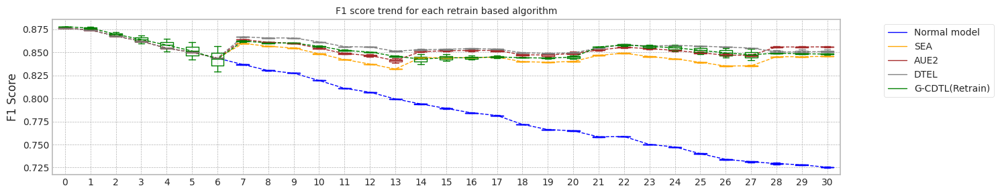

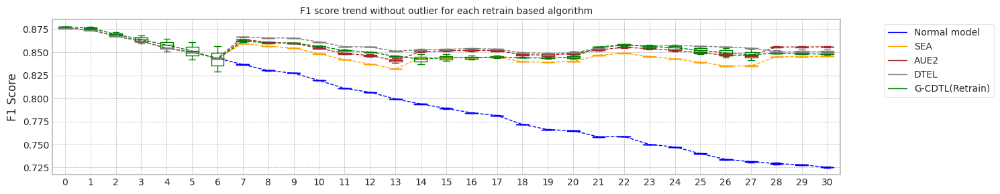

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.095141410827637
Base flops (train + inference flops of normal model, median): 1100115000.0


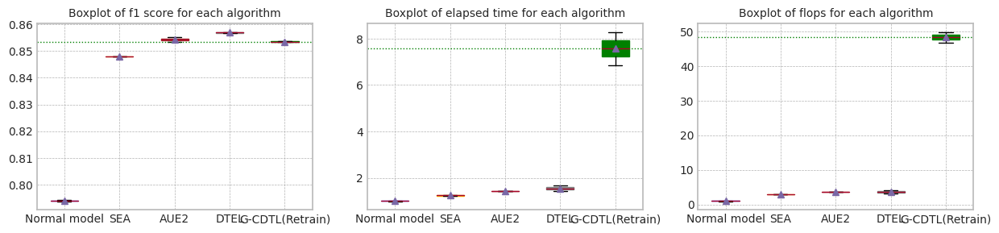

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.095141410827637


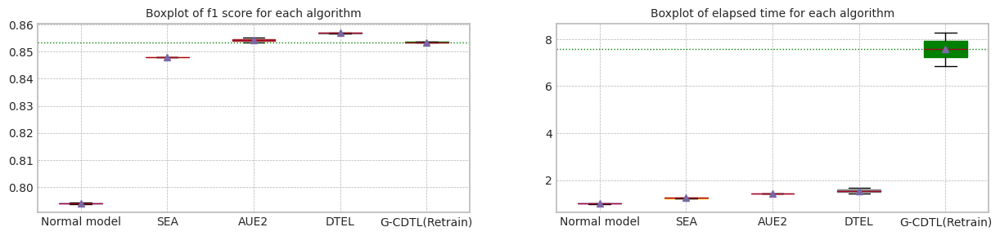

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.793844,0.724863,6.163644,8.926200e+08,121365000.0,1.013985e+09
1,1.0,0.876676,0.874448,0.794226,0.725792,6.026639,1.064880e+09,121365000.0,1.186245e+09
2,median,0.876450,0.874379,0.794035,0.725328,6.095141,9.787500e+08,121365000.0,1.100115e+09
3,std,0.000320,0.000098,0.000270,0.000657,0.096877,1.218062e+08,0.0,1.218062e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.877915,0.877728,0.828696,0.791767,6.139475,3.933000e+10,609615000.0,3.993962e+10
1,1.0,0.877968,0.875111,0.651347,0.347888,5.980000,3.933000e+10,609615000.0,3.993962e+10
2,median,0.877942,0.876420,0.740022,0.569828,6.059738,3.933000e+10,609615000.0,3.993962e+10
3,std,0.000037,0.001850,0.125405,0.313870,0.112765,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.848036,0.845651,7.739464,1.528155e+09,1.813950e+09,3.342105e+09
1,1.0,0.876676,0.874448,0.848044,0.845785,7.394700,1.431150e+09,1.889205e+09,3.320355e+09
2,median,0.876450,0.874379,0.848040,0.845718,7.567082,1.479652e+09,1.851578e+09,3.331230e+09
3,std,0.000320,0.000098,0.000006,0.000095,0.243785,6.859289e+07,5.321332e+07,1.537957e+07


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.855054,0.856615,8.610510,1.760880e+09,2.168040e+09,3.928920e+09
1,1.0,0.876676,0.874448,0.853471,0.855552,8.742150,1.717815e+09,2.297235e+09,4.015050e+09
2,median,0.876450,0.874379,0.854262,0.856083,8.676330,1.739348e+09,2.232638e+09,3.971985e+09
3,std,0.000320,0.000098,0.001120,0.000752,0.093083,3.045155e+07,9.135466e+07,6.090311e+07


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.857091,0.852984,8.643826,1.778280e+09,1.751745e+09,3.530025e+09
1,1.0,0.876676,0.874448,0.856601,0.848927,10.160060,2.251560e+09,2.227200e+09,4.478760e+09
2,median,0.876450,0.874379,0.856846,0.850956,9.401943,2.014920e+09,1.989472e+09,4.004392e+09
3,std,0.000320,0.000098,0.000346,0.002868,1.072140,3.346595e+08,3.361975e+08,6.708570e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.877915,0.877728,0.853714,0.847374,50.500818,5.484568e+10,26865000.0,5.487255e+10
1,1.0,0.877968,0.875111,0.853299,0.849076,41.818365,5.151356e+10,26865000.0,5.154042e+10
2,median,0.877942,0.876420,0.853507,0.848225,46.159592,5.317962e+10,26865000.0,5.320649e+10
3,std,0.000037,0.001850,0.000293,0.001203,6.139422,2.356168e+09,0.0,2.356168e+09


trial_count: 2
Lambda :  0.9
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-11-26 12:17:46,117] [INFO] [profiler.py:80:start_profile] Flops profiler started


 11%|█▏        | 227/2000 [00:00<00:04, 429.84it/s]

Early stop: 227
[2023-11-26 12:17:46,651] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 892620000
precision_recall_fscore: (array([0.87878104, 0.87133479]), array([0.86877929, 0.8811684 ]), array([0.87375154, 0.87622401]), array([4481, 4519]))
Test f1 score: 0.8762240070414787
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.25it/s]

mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.793844292419275
inference_flops: 121365000
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 12:17:52,596] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-26 12:17:52,599] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 143.15it/s]

[2023-11-26 12:18:06,579] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:18:06,580] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.88372093, 0.86887733]), array([0.86498549, 0.88714317]), array([0.87425285, 0.87791525]), array([4481, 4519]))
Test f1 score: 0.8779152523814737
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.08it/s]


mean of drift:
x0    0.328362
x1    0.176735
x2    0.082961
x3    0.099258
z0    0.417477
dtype: float64
Mean F1 for all data: 0.8286959262310046
inference_flops: 609615000
Normal model median        : 0.793844292419275
Drift tolerant model median: 0.8286959262310046
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-11-26 12:18:12,721] [INFO] [profiler.py:80:start_profile] Flops profiler started


 14%|█▎        | 271/2000 [00:00<00:04, 423.92it/s]

Early stop: 271
[2023-11-26 12:18:13,365] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1064880000
precision_recall_fscore: (array([0.87989143, 0.87093252]), array([0.8681098 , 0.88249613]), array([0.87396091, 0.87667619]), array([4481, 4519]))
Test f1 score: 0.8766761925697956
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.12it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.7942263404081991
inference_flops: 121365000
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 12:18:19,463] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:18:19,465] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 142.90it/s]

[2023-11-26 12:18:33,470] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:18:33,471] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.8781362 , 0.87632275]), array([0.87480473, 0.87961938]), array([0.8764673 , 0.87796797]), array([4481, 4519]))
Test f1 score: 0.8779679734953065
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.06it/s]


mean of drift:
x0    0.315333
x1    0.329308
x2    0.191297
x3    0.197401
z0    0.523606
dtype: float64
Mean F1 for all data: 0.6513471798026521
inference_flops: 609615000
Normal model median        : 0.794035316413737
Drift tolerant model median: 0.7400215530168284
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:00<00:05,  5.16it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:18:40,838] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:18:40,842] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:18:53,934] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:18:53,935] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:14<01:56,  4.65s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


 35%|███▌      | 11/31 [00:15<00:17,  1.13it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:18:55,183] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:18:55,185] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:19:08,137] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:19:08,138] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:28<01:27,  4.62s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


 55%|█████▍    | 17/31 [00:29<00:13,  1.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:19:09,381] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:19:09,383] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:19:22,571] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:19:22,572] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 61%|██████▏   | 19/31 [00:43<00:39,  3.33s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


 74%|███████▍  | 23/31 [00:43<00:07,  1.06it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:19:23,733] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:19:23,735] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:19:37,073] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:19:37,075] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:57<00:33,  4.72s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


 94%|█████████▎| 29/31 [00:58<00:01,  1.05it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:19:38,258] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:19:38,262] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:19:51,506] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:19:51,507] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [01:11<00:04,  4.70s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


100%|██████████| 31/31 [01:12<00:00,  2.32s/it]


Early stop at  [1999, 1999, 1999, 1999, 1999]
Train flops  [4370000000, 4370000000, 4370000000, 4370000000, 4370000000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8560179750450619
G_CDTL+AUE median: 0.8560179750450619
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:11,  2.09it/s]

Ensemble_SEA train flops: 344085000


 42%|████▏     | 13/31 [00:04<00:05,  3.56it/s]

Ensemble_SEA train flops: 76560000


 61%|██████▏   | 19/31 [00:05<00:03,  3.76it/s]

Ensemble_SEA train flops: 78300000


 77%|███████▋  | 24/31 [00:07<00:02,  2.48it/s]

Ensemble_SEA train flops: 175305000


 97%|█████████▋| 30/31 [00:08<00:00,  3.02it/s]

Ensemble_SEA train flops: 101355000


100%|██████████| 31/31 [00:08<00:00,  3.50it/s]


Early stop at  [790, 175, 179, 402, 232]
Train flops  [344085000, 76560000, 78300000, 175305000, 101355000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8487897828788497
SEA median: 0.8487897828788497
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:09,  2.58it/s]

Ensemble_SEA train flops: 232290000


 42%|████▏     | 13/31 [00:04<00:09,  1.97it/s]

Ensemble_SEA train flops: 355830000


 61%|██████▏   | 19/31 [00:06<00:03,  3.18it/s]

Ensemble_SEA train flops: 110055000


 81%|████████  | 25/31 [00:08<00:02,  2.33it/s]

Ensemble_SEA train flops: 270135000


 97%|█████████▋| 30/31 [00:10<00:00,  2.64it/s]

Ensemble_SEA train flops: 125715000


100%|██████████| 31/31 [00:10<00:00,  3.03it/s]


Early stop at  [533, 817, 252, 620, 288]
Train flops  [232290000, 355830000, 110055000, 270135000, 125715000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8563950355060812
AUE median: 0.8563950355060812
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:00<00:05,  5.05it/s]

Ensemble_DTEL train flops: 172695000


 23%|██▎       | 7/31 [00:02<00:11,  2.14it/s]

Ensemble_DTEL train flops: 150075000


 39%|███▊      | 12/31 [00:03<00:07,  2.71it/s]

Ensemble_DTEL train flops: 111360000
Ensemble_DTEL train flops: 870000


 58%|█████▊    | 18/31 [00:05<00:05,  2.44it/s]

Ensemble_DTEL train flops: 169215000
Ensemble_DTEL train flops: 1305000


 81%|████████  | 25/31 [00:07<00:01,  3.64it/s]

Ensemble_DTEL train flops: 71340000
Ensemble_DTEL train flops: 1305000


 97%|█████████▋| 30/31 [00:08<00:00,  3.15it/s]

Ensemble_DTEL train flops: 94830000
Ensemble_DTEL train flops: 8265000


100%|██████████| 31/31 [00:09<00:00,  3.42it/s]


Early stop at  [396, 344, 255, 1, 388, 2, 163, 2, 217, 18]
Train flops  [172695000, 150075000, 111360000, 870000, 169215000, 1305000, 71340000, 1305000, 94830000, 8265000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8540614051033117
DTEL median: 0.8540614051033117
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:00<00:05,  5.13it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:20:21,157] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:20:21,159] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:20:34,300] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:20:34,301] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:14<01:16,  3.20s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


 35%|███▌      | 11/31 [00:15<00:17,  1.14it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:20:35,482] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:20:35,485] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:20:38,869] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:20:38,870] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:18<00:32,  1.70s/it]

G-CDTL train flops: 871500000 216630000 1088130000


 55%|█████▍    | 17/31 [00:19<00:06,  2.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:20:40,045] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:20:40,048] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:20:48,212] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:20:48,213] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:28<00:36,  2.82s/it]

G-CDTL train flops: 2143750000 532875000 2676625000


 74%|███████▍  | 23/31 [00:29<00:05,  1.56it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:20:49,419] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:20:49,422] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:21:02,965] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:21:02,966] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:42<00:32,  4.57s/it]

G-CDTL train flops: 3500000000 870000000 4370000000


 94%|█████████▎| 29/31 [00:43<00:01,  1.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 12:21:04,170] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 12:21:04,172] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 12:21:13,176] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 12:21:13,178] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:53<00:03,  3.42s/it]

G-CDTL train flops: 2331000000 579420000 2910420000


100%|██████████| 31/31 [00:53<00:00,  1.72s/it]


Early stop at  [1999, 497, 1224, 1999, 1331]
Train flops  [4370000000, 1088130000, 2676625000, 4370000000, 2910420000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8550633627427863
G_CDTL+AUE median: 0.8555406688939241
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:08,  3.00it/s]

Ensemble_SEA train flops: 115275000


 42%|████▏     | 13/31 [00:04<00:09,  1.97it/s]

Ensemble_SEA train flops: 391500000


 61%|██████▏   | 19/31 [00:06<00:05,  2.08it/s]

Ensemble_SEA train flops: 330165000


 81%|████████  | 25/31 [00:08<00:02,  2.86it/s]

Ensemble_SEA train flops: 150945000


100%|██████████| 31/31 [00:10<00:00,  3.07it/s]

Ensemble_SEA train flops: 121365000
Early stop at  [264, 899, 758, 346, 278]
Train flops  [115275000, 391500000, 330165000, 150945000, 121365000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8496456316560517


SEA median: 0.8492177072674507
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:07,  3.19it/s]

Ensemble_SEA train flops: 131370000


 42%|████▏     | 13/31 [00:04<00:08,  2.08it/s]

Ensemble_SEA train flops: 335385000


 61%|██████▏   | 19/31 [00:06<00:05,  2.17it/s]

Ensemble_SEA train flops: 301020000


 81%|████████  | 25/31 [00:09<00:03,  1.61it/s]

Ensemble_SEA train flops: 504600000


100%|██████████| 31/31 [00:11<00:00,  2.61it/s]

Ensemble_SEA train flops: 277965000
Early stop at  [301, 770, 691, 1159, 638]
Train flops  [131370000, 335385000, 301020000, 504600000, 277965000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8565678849187931
AUE median: 0.8564814602124371
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)


Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:00<00:04,  5.26it/s]

Ensemble_DTEL train flops: 175740000


 23%|██▎       | 7/31 [00:03<00:14,  1.66it/s]

Ensemble_DTEL train flops: 304065000


 42%|████▏     | 13/31 [00:04<00:05,  3.19it/s]

Ensemble_DTEL train flops: 91350000
Ensemble_DTEL train flops: 870000


 61%|██████▏   | 19/31 [00:06<00:03,  3.34it/s]

Ensemble_DTEL train flops: 112230000
Ensemble_DTEL train flops: 1305000


 81%|████████  | 25/31 [00:08<00:02,  2.36it/s]

Ensemble_DTEL train flops: 279705000
Ensemble_DTEL train flops: 1305000


 97%|█████████▋| 30/31 [00:09<00:00,  2.63it/s]

Ensemble_DTEL train flops: 117015000
Ensemble_DTEL train flops: 7830000


100%|██████████| 31/31 [00:10<00:00,  3.06it/s]


Early stop at  [403, 698, 209, 1, 257, 2, 642, 2, 268, 17]
Train flops  [175740000, 304065000, 91350000, 870000, 112230000, 1305000, 279705000, 1305000, 117015000, 7830000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.182717
dtype: float64
Mean F1 for all data: 0.8526160277248849
DTEL median: 0.8533387164140983


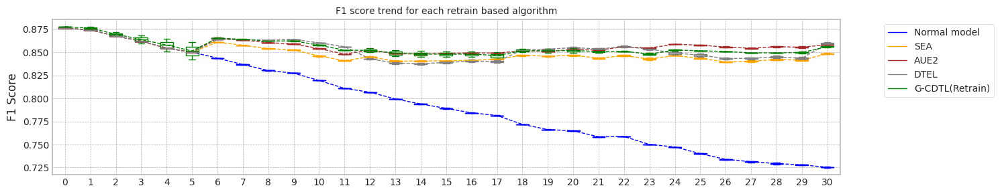

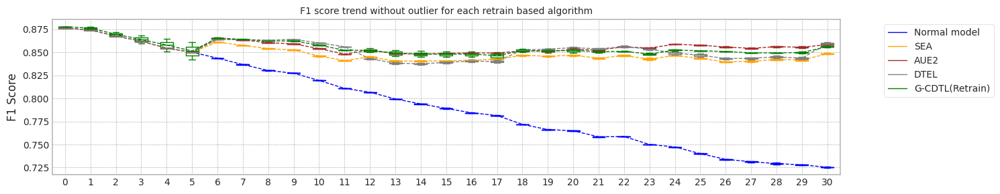

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.005880117416382
Base flops (train + inference flops of normal model, median): 1100115000.0


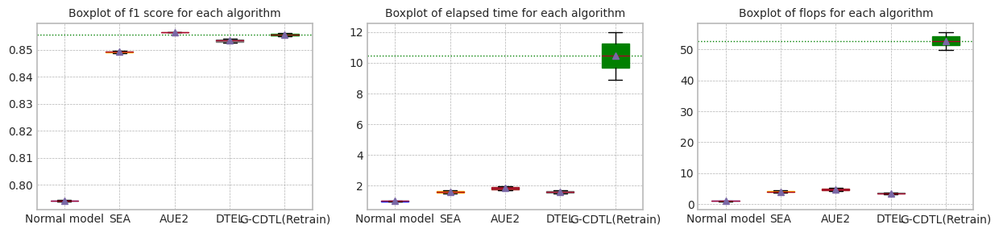

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.005880117416382


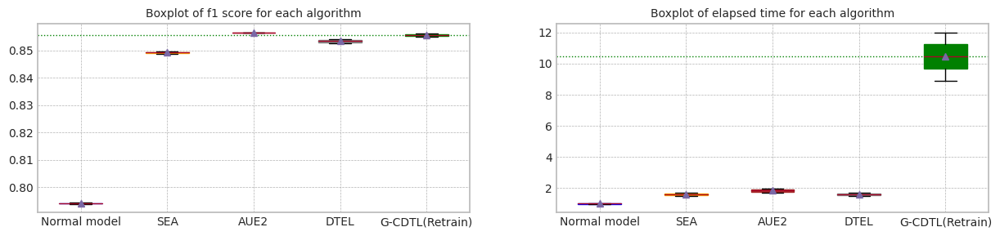

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.793844,0.724863,5.930004,8.926200e+08,121365000.0,1.013985e+09
1,1.0,0.876676,0.874448,0.794226,0.725792,6.081757,1.064880e+09,121365000.0,1.186245e+09
2,median,0.876450,0.874379,0.794035,0.725328,6.005880,9.787500e+08,121365000.0,1.100115e+09
3,std,0.000320,0.000098,0.000270,0.000657,0.107306,1.218062e+08,0.0,1.218062e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.877915,0.877728,0.828696,0.791767,6.123570,3.933000e+10,609615000.0,3.993962e+10
1,1.0,0.877968,0.875111,0.651347,0.347888,6.149275,3.933000e+10,609615000.0,3.993962e+10
2,median,0.877942,0.876420,0.740022,0.569828,6.136422,3.933000e+10,609615000.0,3.993962e+10
3,std,0.000037,0.001850,0.125405,0.313870,0.018176,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.848790,0.847960,8.894759,1.840485e+09,2.169345e+09,4.009830e+09
1,1.0,0.876676,0.874448,0.849646,0.849179,10.114746,2.174130e+09,2.675250e+09,4.849380e+09
2,median,0.876450,0.874379,0.849218,0.848569,9.504753,2.007308e+09,2.422298e+09,4.429605e+09
3,std,0.000320,0.000098,0.000605,0.000862,0.862661,2.359226e+08,3.577289e+08,5.936515e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.856395,0.858546,10.264142,2.158905e+09,2.609130e+09,4.768035e+09
1,1.0,0.876676,0.874448,0.856568,0.858263,11.928184,2.615220e+09,3.237705e+09,5.852925e+09
2,median,0.876450,0.874379,0.856481,0.858404,11.096163,2.387062e+09,2.923418e+09,5.310480e+09
3,std,0.000320,0.000098,0.000122,0.000201,1.176655,3.226634e+08,4.444696e+08,7.671331e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.876224,0.874310,0.854061,0.861010,9.088806,1.846140e+09,1.638645e+09,3.484785e+09
1,1.0,0.876676,0.874448,0.852616,0.858123,10.151937,2.156295e+09,1.986645e+09,4.142940e+09
2,median,0.876450,0.874379,0.853339,0.859566,9.620371,2.001218e+09,1.812645e+09,3.813862e+09
3,std,0.000320,0.000098,0.001022,0.002041,0.751748,2.193127e+08,2.460732e+08,4.653859e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.877915,0.877728,0.856018,0.857050,72.078712,6.118000e+10,8955000.0,6.118896e+10
1,1.0,0.877968,0.875111,0.855063,0.855273,53.436273,5.474518e+10,8955000.0,5.475413e+10
2,median,0.877942,0.876420,0.855541,0.856162,62.757493,5.796259e+10,8955000.0,5.797154e+10
3,std,0.000037,0.001850,0.000675,0.001257,13.182195,4.550108e+09,0.0,4.550108e+09


In [ ]:

org_df_rt = {}
gcd_df_rt = {}
sea_df_rt = {}
aue_df_rt = {}
dte_df_rt = {}
gea_df_rt = {}


orgf_df_rt = {}
gcdf_df_rt = {}
seaf_df_rt = {}
auef_df_rt = {}
dtef_df_rt = {}
geaf_df_rt = {}

test_f1_score = []

for RT in range(1,6):
    org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case1',X1, Y1,train_size, test_size,avaible_range = 300,
                                                                lambda_f2=0.9,trial_count=2,lr_g=0.004,
                                                                retrain_count=RT,weight_init=True)
    test_f1_score = org_df['Testset F1']
    org_df_rt[f'{RT}'] = org_df['Mean F1']
    gcd_df_rt[f'{RT}'] = gcd_df['Mean F1']
    sea_df_rt[f'{RT}'] = sea_df['Mean F1']
    aue_df_rt[f'{RT}'] = aue_df['Mean F1']
    dte_df_rt[f'{RT}'] = dte_df['Mean F1']
    gea_df_rt[f'{RT}'] = gea_df['Mean F1']

    orgf_df_rt[f'{RT}'] = org_df['flops']
    gcdf_df_rt[f'{RT}'] = gcd_df['flops']
    seaf_df_rt[f'{RT}'] = sea_df['flops']
    auef_df_rt[f'{RT}'] = aue_df['flops']
    dtef_df_rt[f'{RT}'] = dte_df['flops']
    geaf_df_rt[f'{RT}'] = gea_df['flops']

In [ ]:

def draw_chart2(axis,legends,title, df,color,showfliers=True):
    if legends == None:
        legends = []

    legends.append((title,color))
    pos = np.asarray(range(1,6)) + (len(legends) - 1)*0.1

    axis.set_xticks([])
    flierprops = dict(marker='.', markerfacecolor=color, markeredgecolor='none')
    if showfliers:
        df[0:df.shape[0]-2].plot.box(ax=axis, positions= pos, flierprops=flierprops,ylabel='F1 Score',fontsize=10,color=color)
    else:
        df[0:df.shape[0]-2].plot.box(ax=axis, positions= pos, showfliers=False,ylabel='F1 Score',fontsize=10,color=color)
    med_df = pd.concat([pd.DataFrame({'med':None},index=[0]), pd.DataFrame({'med':df[0:df.shape[0]-1].median().values})],axis=0).reset_index(drop=True)
    med_df.plot(ax = axis,linestyle='--',linewidth=1,ylabel='F1 Score',fontsize=10,color=color)
    return legends

def draw_chart3(axis,legends,title, df,color,showfliers=True):
    if legends == None:
        legends = []

    legends.append((title,color))
    pos = list(range(1,len(legends)+1))
    axis.set_xticks([])
    flierprops = dict(marker='.', markerfacecolor=color, markeredgecolor='none')
    if showfliers:
        df[0:df.shape[0]-2].plot.box(ax=axis, positions= pos, flierprops=flierprops,ylabel='flops',fontsize=10,color=color)
    else:
        df[0:df.shape[0]-2].plot.box(ax=axis, positions= pos, showfliers=False,ylabel='flops',fontsize=10,color=color)
    med_df = pd.concat([pd.DataFrame({'med':None},index=[0]), pd.DataFrame({'med':df[0:df.shape[0]-1].median().values})],axis=0).reset_index(drop=True)
    med_df.plot(ax = axis,linestyle='--',linewidth=1,ylabel='flops',fontsize=10,color=color)
    return legends

def set_legend2(axis,legends,title):
    axis.set_title(title,fontdict={'fontsize':10})
    #axis.legend([v for v,c in legends],ncol=len(legends),bbox_to_anchor=(1.05, 1.0), loc='upper left')
    axis.legend([v for v,c in legends],bbox_to_anchor=(1.05, 1.0), loc='upper left')
    leg = axis.get_legend()
    for i,(v,c) in enumerate(legends):
        leg.legendHandles[i].set_color(c)

ValueError: ignored

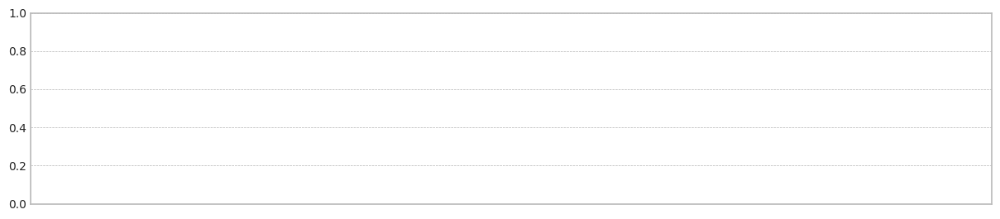

In [ ]:
org_df1 = pd.DataFrame(org_df_rt)
gcd_df1 = pd.DataFrame(gcd_df_rt)

sea_df1 = pd.DataFrame(sea_df_rt)
aue_df1 = pd.DataFrame(aue_df_rt)
dte_df1 = pd.DataFrame(dte_df_rt)
gea_df1 = pd.DataFrame(gea_df_rt)

sea_df1.insert(0, "0", org_df1['1'], True)
aue_df1.insert(0, "0", org_df1['1'], True)
dte_df1.insert(0, "0", org_df1['1'], True)
gea_df1.insert(0, "0", gcd_df1['1'], True)

fig, ax = plt.subplots(figsize=main_figsize)
lg = draw_chart2(ax,None,'SEA',sea_df1,'orange',showfliers=False)
lg = draw_chart2(ax,lg,'AUE2',aue_df1,'brown',showfliers=False)
lg = draw_chart2(ax,lg,'DTEL',dte_df1,'gray',showfliers=False)
lg = draw_chart2(ax,lg,'G-CDTL(Retrain)',gea_df1,'green',showfliers=False)
#lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)

ax.axhline(y = np.mean(org_df1['1'][0:org_df1.shape[0]-2]), color = 'black', linewidth=1, linestyle = ':')

tf1 = np.mean(test_f1_score[0:org_df1.shape[0]-2])
thr = 0.97
print('Test F1 Score:',tf1)
print(f'Test F1 Score ({thr*100}%):',tf1*thr)

ax.axhline(y = tf1*thr, color = 'red', linewidth=2, linestyle = ':')

set_legend2(ax,lg,'F1 score of retrained models')
plt.tight_layout()
plt.show()


In [ ]:
vvv = np.asarray(range(1,6)) + 0.1
vvv

array([1.1, 2.1, 3.1, 4.1, 5.1])

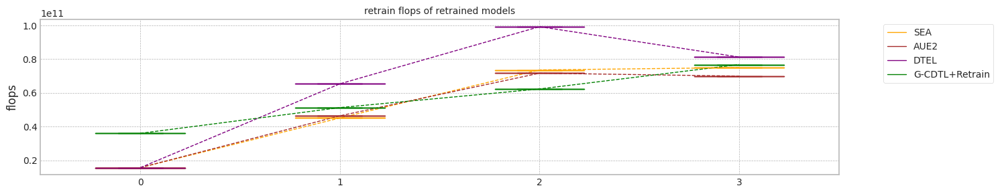

In [ ]:
org_df2 = pd.DataFrame(orgf_df_rt)
gcd_df2 = pd.DataFrame(gcdf_df_rt)

sea_df2 = pd.DataFrame(seaf_df_rt)
aue_df2 = pd.DataFrame(auef_df_rt)
dte_df2 = pd.DataFrame(dtef_df_rt)
gea_df2 = pd.DataFrame(geaf_df_rt)

sea_df2.insert(0, "0", org_df2['1'], True)
aue_df2.insert(0, "0", org_df2['1'], True)
dte_df2.insert(0, "0", org_df2['1'], True)
gea_df2.insert(0, "0", gcd_df2['1'], True)

fig, ax = plt.subplots(figsize=main_figsize)
lg = draw_chart3(ax,None,'SEA',sea_df2,'orange',showfliers=False)
lg = draw_chart3(ax,lg,'AUE2',aue_df2,'brown',showfliers=False)
lg = draw_chart3(ax,lg,'DTEL',dte_df2,'purple',showfliers=False)
lg = draw_chart3(ax,lg,'G-CDTL+Retrain',gea_df2,'green',showfliers=False)
#lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)

set_legend2(ax,lg,'retrain flops of retrained models')
plt.tight_layout()
plt.show()

## synthetic data의 생성 (Case #2 MI의 증감(상대적), Drift의 고정)

+ $P_t(y|X) \ne P_{t+w}(y|X)$ and $P_t(X) = P_{t+w}(X)$
+ Actual Drift
+ 즉, P(X)의 변화없이, Concept (본 Dataset에서 MI의 변화)만 변경


+ 5개의 feature
+ 각각 importance를 부여
+ 그 중, 1개의 feature에 대해 y의 비중이 시간에 따라 감소하도록 생성

### Dataset 준비

In [41]:
data_size = 40000
cor = np.asarray([1.5, 1.2, 0.9 , 0.7, 2.5])

In [42]:
seed_everything()

x1 = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    x1[:,ix] = np.random.normal(1,cor_,data_size)

In [43]:
x1.shape

(40000, 5)

In [44]:
import matplotlib.pyplot as plt

seed_everything()

y1_array = []
cor_const = cor[4]
for ii in range(x1.shape[0]):
    cor[4] = cor[4] - cor_const / x1.shape[0]
    e = np.random.normal(0.0, 2.0)
    y1_array.append(np.sum(cor * x1[ii])+e)

In [45]:
m = 5 #np.mean(y1_array[0:2000])
print(m)
y1 = [1 if y_ > m else 0 for y_ in y1_array]
print(sum(y1))

5
21325


### 실험

MI Analysis MI Max 0.22746, Min 0.00677, Mean 0.06988, Std 0.08433
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (39000, 5)
Truncate 8000 rows from live_set (39000, 5)
Search MI & Drift...for X_live_set (31, 9000, 5)


100%|██████████| 31/31 [00:05<00:00,  5.21it/s]


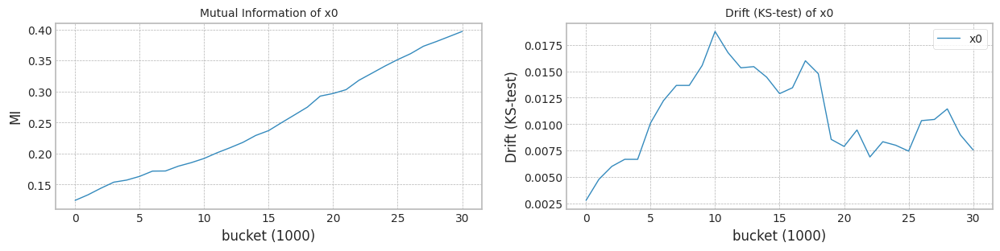

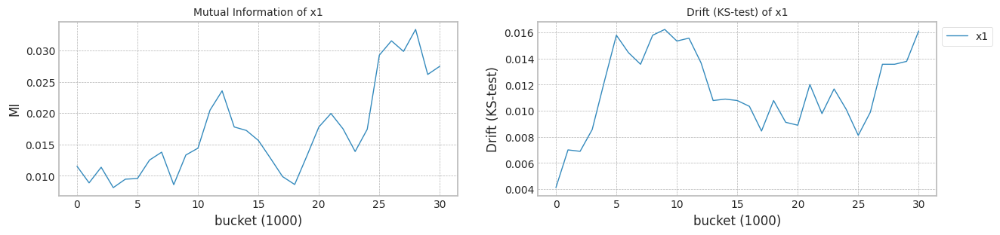

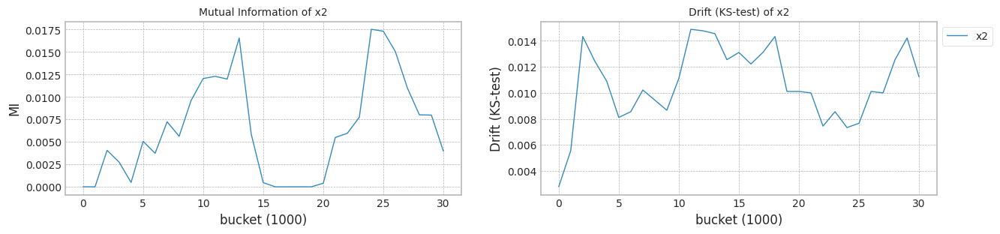

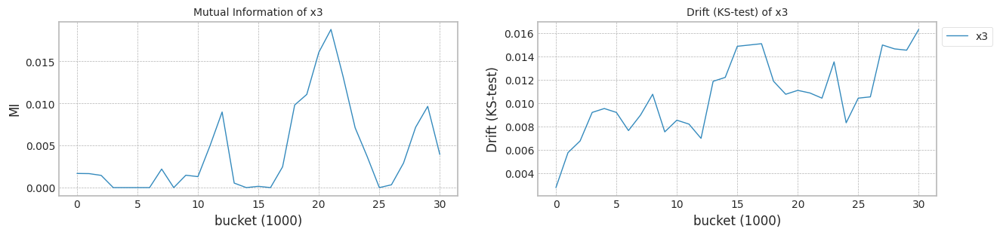

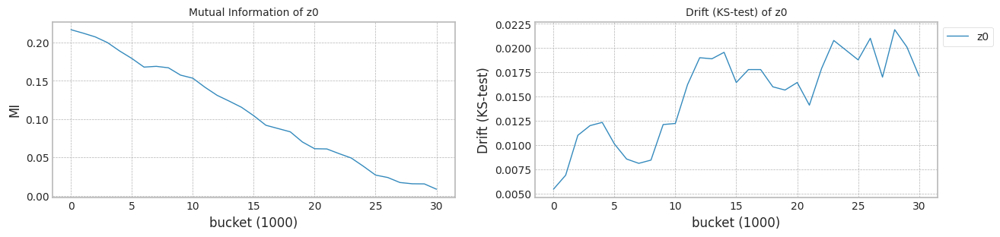

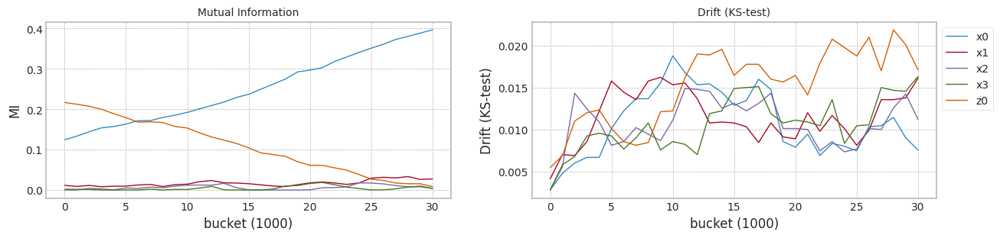

In [47]:
columns=['x0','x1','x2','x3','z0']
X1 = pd.DataFrame(x1,columns=columns)

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X1, y1,train_size, test_size)
#model,df = train_classificaion_model(X1,Y1,train_size, test_size)

In [48]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.525799,0.497734,0.329063,0.549493,0.366139,0
1,0.610533,0.420412,0.508390,0.580336,0.662926,0
2,0.556874,0.464734,0.669603,0.724770,0.486574,0
3,0.344341,0.646524,0.340976,0.528780,0.611850,0
4,0.503142,0.550860,0.598773,0.465698,0.487044,0
...,...,...,...,...,...,...
39995,0.333622,0.399822,0.303105,0.605408,0.709407,39
39996,0.358451,0.483875,0.341855,0.574439,0.695384,39
39997,0.559469,0.343824,0.542547,0.575250,0.504288,39
39998,0.433692,0.530132,0.301231,0.282353,0.762158,39


trial_count: 2
Lambda :  0.9
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-27 12:19:49,849] [INFO] [profiler.py:80:start_profile] Flops profiler started


 76%|███████▋  | 1525/2000 [00:03<00:01, 450.16it/s]

Early stop: 1525
[2023-11-27 12:19:53,243] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5974290000
precision_recall_fscore: (array([0.98925309, 0.98901099]), array([0.98449198, 0.99239544]), array([0.98686679, 0.99070032]), array([3740, 5260]))
Test f1 score: 0.9907003226418676
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.11it/s]

mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989312862519606
inference_flops: 121365000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-27 12:19:59,376] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:19:59,378] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 32%|███▏      | 635/2000 [00:04<00:08, 155.22it/s]

[2023-11-27 12:20:12,298] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:20:12,301] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 10017000000 2489940000 44006940000
precision_recall_fscore: (array([0.99945873, 0.99114043]), array([0.98743316, 0.99961977]), array([0.99340955, 0.99536204]), array([3740, 5260]))
Test f1 score: 0.9953620444865121
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.02it/s]

mean of drift:
x0    0.240885
x1    0.065161
x2    0.113670
x3    0.041821
z0    0.332595
dtype: float64
Mean F1 for all data: 0.9460942608075876
inference_flops: 609615000
Normal model median        : 0.8989312862519606
Drift tolerant model median: 0.9460942608075876
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-27 12:20:18,541] [INFO] [profiler.py:80:start_profile] Flops profiler started



 56%|█████▌    | 1123/2000 [00:02<00:01, 446.20it/s]

Early stop: 1123
[2023-11-27 12:20:21,064] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4400460000
precision_recall_fscore: (array([0.99189408, 0.98697868]), array([0.9815508 , 0.99429658]), array([0.98669534, 0.99062411]), array([3740, 5260]))
Test f1 score: 0.9906241121318308
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.08it/s]

mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8988133031462875
inference_flops: 121365000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-27 12:20:27,234] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:20:27,236] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 36%|███▌      | 720/2000 [00:04<00:08, 155.27it/s]

[2023-11-27 12:20:34,830] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:20:34,832] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 10426500000 11355750000 2822715000 24604965000
precision_recall_fscore: (array([1.        , 0.97119645]), array([0.95828877, 1.        ]), array([0.97870016, 0.98538779]), array([3740, 5260]))
Test f1 score: 0.9853877856875235
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.10it/s]


mean of drift:
x0    0.243172
x1    0.153821
x2    0.315398
x3    0.073968
z0    0.237455
dtype: float64
Mean F1 for all data: 0.9302962647169628
inference_flops: 609615000
Normal model median        : 0.8988722946991241
Drift tolerant model median: 0.9381952627622752
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-27 12:20:44,128] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:20:44,131] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 12:20:55,770] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:20:55,771] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:14<00:55,  3.70s/it]

G-CDTL train flops: 3500000000 917000000 227940000 4644940000


100%|██████████| 31/31 [00:17<00:00,  1.74it/s]


Early stop at  [523]
Train flops  [4644940000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9646250961153556
G_CDTL+AUE median: 0.9646250961153556
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:06<00:12,  1.13it/s]

Ensemble_SEA train flops: 752985000


100%|██████████| 31/31 [00:09<00:00,  3.30it/s]


Early stop at  [1730]
Train flops  [752985000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.926666684091352
SEA median: 0.926666684091352
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:06<00:11,  1.21it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 31/31 [00:09<00:00,  3.42it/s]


Early stop at  [1999]
Train flops  [870000000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9469316656177185
AUE median: 0.9469316656177185
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.10it/s]

Ensemble_DTEL train flops: 770385000


 55%|█████▍    | 17/31 [00:09<00:21,  1.51s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 31/31 [00:12<00:00,  2.52it/s]


Early stop at  [1770, 1999]
Train flops  [770385000, 870000000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9502665582203345
DTEL median: 0.9502665582203345
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.97it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-27 12:21:33,060] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:21:33,063] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 12:21:36,301] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:21:36,303] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:06<00:17,  1.18s/it]

G-CDTL train flops: 59500000 850500000 211410000 1121410000


100%|██████████| 31/31 [00:09<00:00,  3.26it/s]


Early stop at  [485]
Train flops  [1121410000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9560104215976817
G_CDTL+AUE median: 0.9603177588565186
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:06<00:19,  1.28s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 31/31 [00:09<00:00,  3.21it/s]


Early stop at  [1999]
Train flops  [870000000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9293885115516509
SEA median: 0.9280275978215015
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:05<00:10,  1.35it/s]

Ensemble_SEA train flops: 706875000


100%|██████████| 31/31 [00:08<00:00,  3.58it/s]


Early stop at  [1624]
Train flops  [706875000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9467308647305354
AUE median: 0.9468312651741269
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.95it/s]

Ensemble_DTEL train flops: 721230000


 55%|█████▍    | 17/31 [00:09<00:21,  1.53s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 31/31 [00:12<00:00,  2.47it/s]


Early stop at  [1657, 1999]
Train flops  [721230000, 870000000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9499971229978499
DTEL median: 0.9501318406090922


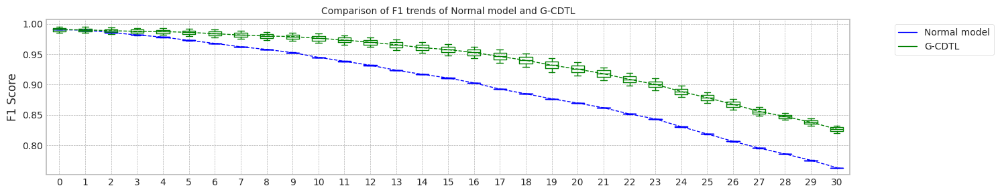

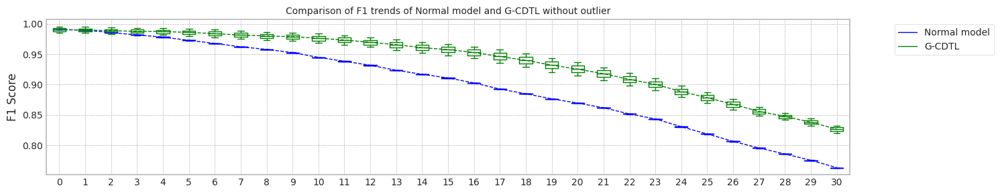

max_mean_trial= 0


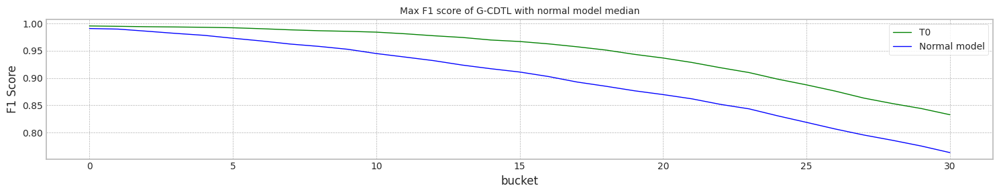

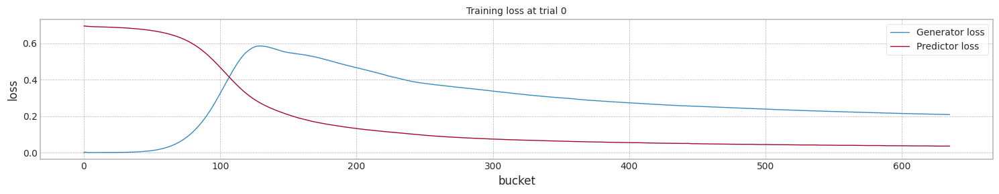

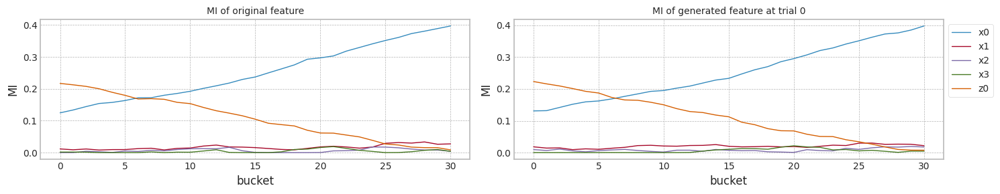

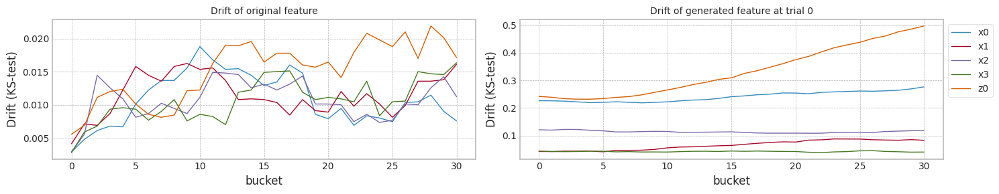

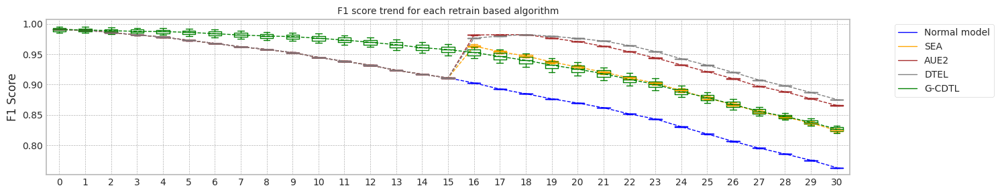

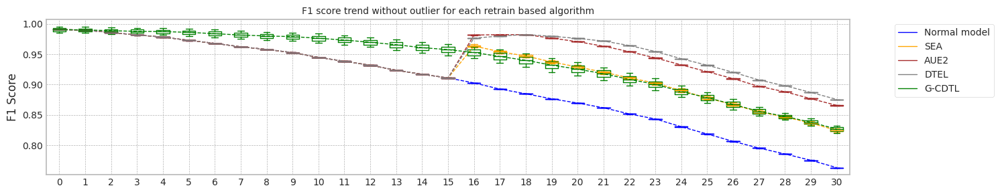

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.134588360786438
Base flops (inference flops of normal model, median): 121365000.0


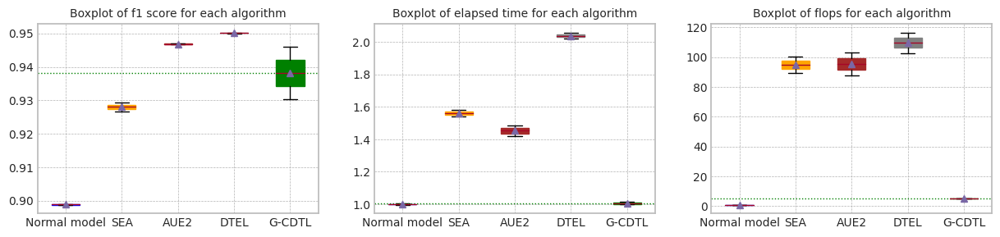

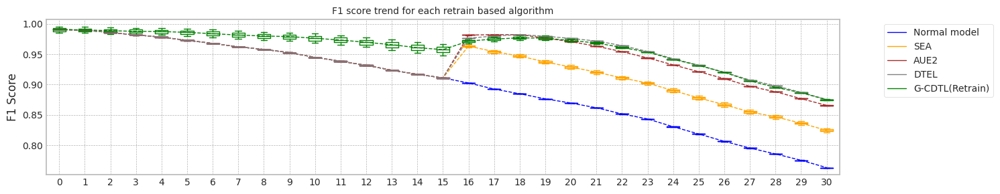

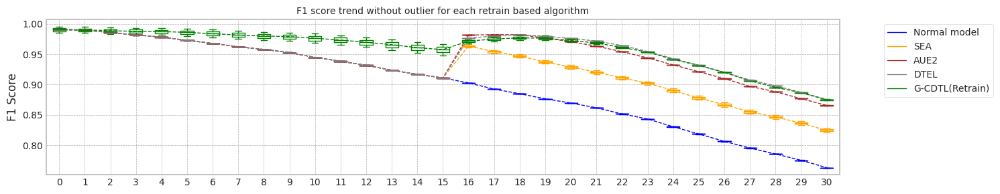

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.134588360786438
Base flops (train + inference flops of normal model, median): 5308740000.0


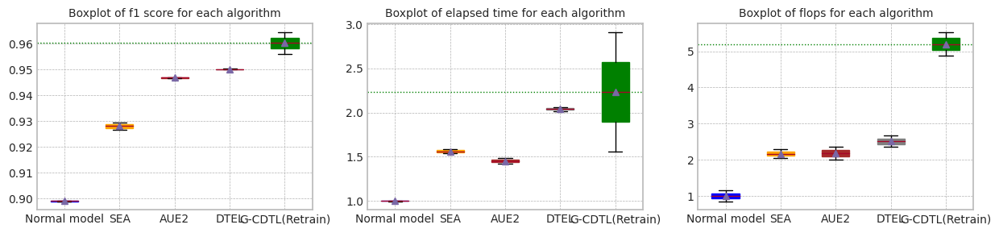

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.134588360786438


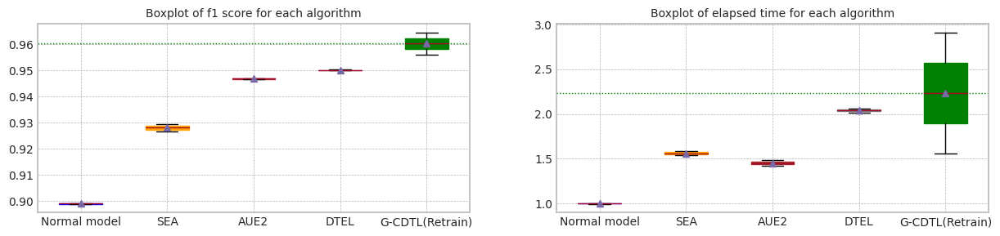

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.990700,0.989687,0.898931,0.763309,6.116152,5.974290e+09,121365000.0,6.095655e+09
1,1.0,0.990624,0.989517,0.898813,0.763246,6.153024,4.400460e+09,121365000.0,4.521825e+09
2,median,0.990662,0.989602,0.898872,0.763278,6.134588,5.187375e+09,121365000.0,5.308740e+09
3,std,0.000054,0.000120,0.000083,0.000045,0.026073,1.112866e+09,0.0,1.112866e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.995362,0.994706,0.946094,0.832699,6.223444,4.400694e+10,609615000.0,4.461656e+10
1,1.0,0.985388,0.985496,0.930296,0.820621,6.124255,2.460496e+10,609615000.0,2.521458e+10
2,median,0.990375,0.990101,0.938195,0.826660,6.173849,3.430595e+10,609615000.0,3.491557e+10
3,std,0.007053,0.006512,0.011171,0.008540,0.070138,1.371927e+10,0.0,1.371927e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.990700,0.989687,0.926667,0.821325,9.446898,5.153445e+09,7.032645e+09,1.218609e+10
1,1.0,0.990624,0.989517,0.929389,0.827898,9.713304,5.270460e+09,5.575830e+09,1.084629e+10
2,median,0.990662,0.989602,0.928028,0.824611,9.580101,5.211952e+09,6.304238e+09,1.151619e+10
3,std,0.000054,0.000120,0.001925,0.004648,0.188378,8.274210e+07,1.030124e+09,9.473817e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.990700,0.989687,0.946932,0.865560,9.115506,5.270460e+09,7.271025e+09,1.254148e+10
1,1.0,0.990624,0.989517,0.946731,0.865882,8.709153,5.107335e+09,5.534070e+09,1.064140e+10
2,median,0.990662,0.989602,0.946831,0.865721,8.912330,5.188898e+09,6.402548e+09,1.159144e+10
3,std,0.000054,0.000120,0.000142,0.000228,0.287335,1.153468e+08,1.228213e+09,1.343559e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.990700,0.989687,0.950267,0.875690,12.381351,6.040845e+09,8.104050e+09,1.414490e+10
1,1.0,0.990624,0.989517,0.949997,0.875497,12.622267,5.991690e+09,6.481065e+09,1.247276e+10
2,median,0.990662,0.989602,0.950132,0.875593,12.501809,6.016268e+09,7.292558e+09,1.330882e+10
3,std,0.000054,0.000120,0.000191,0.000137,0.170354,3.475783e+07,1.147624e+09,1.182382e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.995362,0.994706,0.964625,0.876195,17.855663,2.924990e+10,134325000.0,2.938423e+10
1,1.0,0.985388,0.985496,0.956010,0.873715,9.557541,2.572638e+10,134325000.0,2.586070e+10
2,median,0.990375,0.990101,0.960318,0.874955,13.706602,2.748814e+10,134325000.0,2.762246e+10
3,std,0.007053,0.006512,0.006091,0.001753,5.867658,2.491512e+09,0.0,2.491512e+09


In [49]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case2',X1, Y1,train_size, test_size,avaible_range = 300,
                                                            lambda_f2=0.9,trial_count=2,lr_g=0.002,
                                                            retrain_count=1,weight_init=True)

trial_count: 2
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-25 08:55:05,390] [INFO] [profiler.py:80:start_profile] Flops profiler started


100%|██████████| 4000/4000 [00:09<00:00, 440.72it/s]

[2023-11-25 08:55:14,471] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 15660000000
precision_recall_fscore: (array([0.99084545, 0.98864926]), array([0.98395722, 0.99353612]), array([0.98738932, 0.99108667]), array([3740, 5260]))
Test f1 score: 0.9910866679309691
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.39it/s]

mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989171036382408
inference_flops: 121365000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 08:55:20,289] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 08:55:20,291] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 4000/4000 [00:28<00:00, 141.88it/s]

[2023-11-25 08:55:48,489] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 08:55:48,490] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 63000000000 15660000000 78660000000
precision_recall_fscore: (array([0.9970604 , 0.99828832]), array([0.99759358, 0.99790875]), array([0.99732692, 0.9980985 ]), array([3740, 5260]))
Test f1 score: 0.9980984978132725
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.46it/s]

mean of drift:
x0    0.120219
x1    0.035530
x2    0.038817
x3    0.372448
z0    0.200280
dtype: float64
Mean F1 for all data: 0.9268699683171997
inference_flops: 609615000
Normal model median        : 0.8989171036382408
Drift tolerant model median: 0.9268699683171997
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-25 08:55:54,236] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 4000/4000 [00:09<00:00, 439.26it/s]

[2023-11-25 08:56:03,347] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 15660000000
precision_recall_fscore: (array([0.98978495, 0.98901515]), array([0.98449198, 0.99277567]), array([0.98713137, 0.99089184]), array([3740, 5260]))
Test f1 score: 0.9908918406072107
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.60it/s]

mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989098324837661
inference_flops: 121365000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 08:56:08,942] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 08:56:08,944] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 4000/4000 [00:28<00:00, 140.58it/s]

[2023-11-25 08:56:37,404] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 08:56:37,405] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 63000000000 15660000000 78660000000
precision_recall_fscore: (array([0.99625468, 0.99695933]), array([0.99572193, 0.9973384 ]), array([0.99598823, 0.99714883]), array([3740, 5260]))
Test f1 score: 0.9971488310207186
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.46it/s]


mean of drift:
x0    0.128308
x1    0.315466
x2    0.057993
x3    0.153097
z0    0.113534
dtype: float64
Mean F1 for all data: 0.9259368542839278
inference_flops: 609615000
Normal model median        : 0.8989134680610035
Drift tolerant model median: 0.9264034113005637
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:02,  5.58it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 08:56:46,074] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 08:56:46,077] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 16.0
[2023-11-25 08:56:50,173] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 08:56:50,174] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 17/31 [00:07<00:14,  1.05s/it]

G-CDTL train flops: 8930250000 2219805000 11150055000


100%|██████████| 31/31 [00:09<00:00,  3.18it/s]


Early stop at  [566]
Train flops  {'generator': [8930250000], 'discriminator': [2219805000], 'sum': [11150055000]}
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9410307016755842
G_CDTL+AUE median: 0.9410307016755842
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:08<00:18,  1.30s/it]

Ensemble_SEA train flops: 13134825000


100%|██████████| 31/31 [00:10<00:00,  2.85it/s]


Early stop at  [3354]
Train flops  [13134825000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9172654061624782
SEA median: 0.9172654061624782
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:08<00:19,  1.38s/it]

Ensemble_AUE2 train flops: 14050935000


100%|██████████| 31/31 [00:11<00:00,  2.75it/s]


Early stop at  [3588]
Train flops  [14050935000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9358853661360136
AUE median: 0.9358853661360136
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:02,  5.45it/s]

Ensemble_DTEL train flops: 12954735000


 55%|█████▍    | 17/31 [00:13<00:33,  2.42s/it]

Ensemble_DTEL train flops: 12954735000


100%|██████████| 31/31 [00:16<00:00,  1.91it/s]


Early stop at  [3308, 3308]
Train flops  [12954735000, 12954735000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9419705717791893
DTEL median: 0.9419705717791893
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:02,  5.40it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 08:57:34,492] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 08:57:34,494] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 16.0
[2023-11-25 08:57:39,164] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 08:57:39,166] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 17/31 [00:07<00:16,  1.17s/it]

G-CDTL train flops: 10316250000 2564325000 12880575000


100%|██████████| 31/31 [00:10<00:00,  2.98it/s]


Early stop at  [654]
Train flops  {'generator': [10316250000], 'discriminator': [2564325000], 'sum': [12880575000]}
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9433599929562292
G_CDTL+AUE median: 0.9421953473159067
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:06<00:13,  1.06it/s]

Ensemble_SEA train flops: 8757855000


100%|██████████| 31/31 [00:09<00:00,  3.35it/s]


Early stop at  [2236]
Train flops  [8757855000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9148396881536605
SEA median: 0.9160525471580694
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:07<00:16,  1.21s/it]

Ensemble_AUE2 train flops: 12011220000


100%|██████████| 31/31 [00:10<00:00,  2.96it/s]


Early stop at  [3067]
Train flops  [12011220000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9355806841890385
AUE median: 0.935733025162526
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:02,  5.50it/s]

Ensemble_DTEL train flops: 10366920000


 55%|█████▍    | 17/31 [00:11<00:27,  1.95s/it]

Ensemble_DTEL train flops: 10366920000


100%|██████████| 31/31 [00:14<00:00,  2.21it/s]


Early stop at  [2647, 2647]
Train flops  [10366920000, 10366920000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9419665451779277
DTEL median: 0.9419685584785584


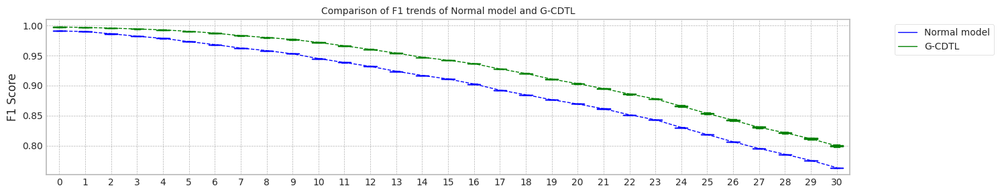

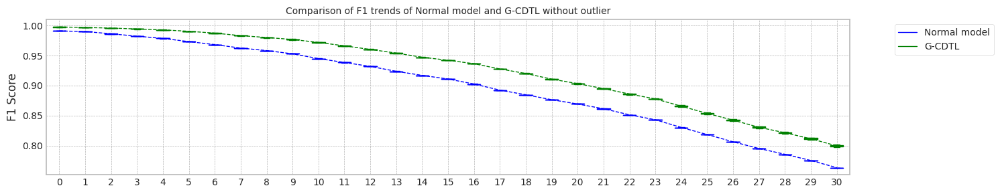

max_mean_trial= 0


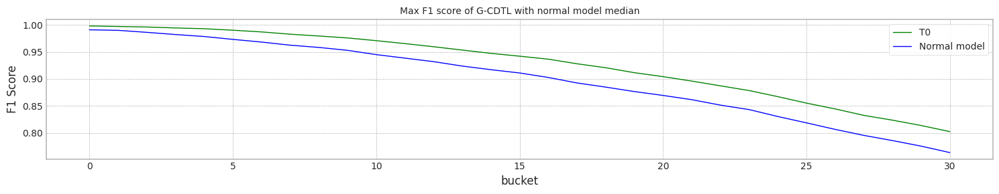

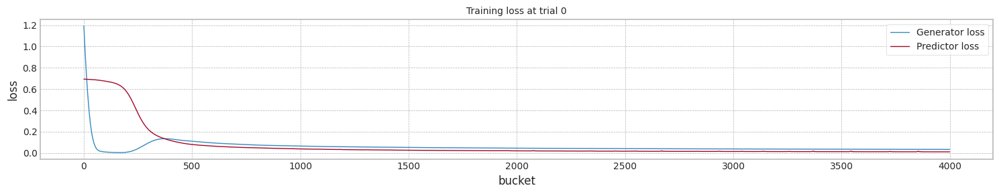

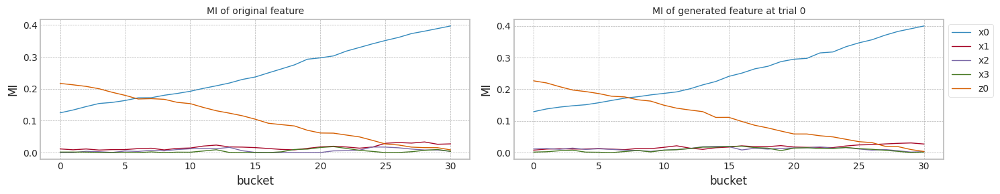

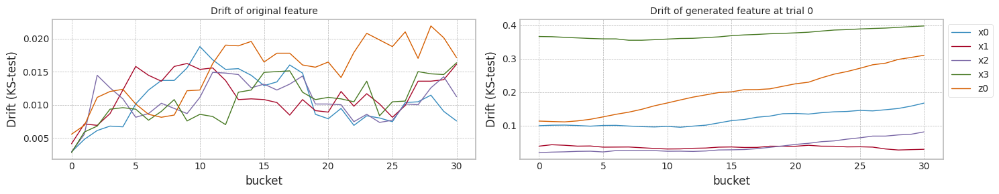

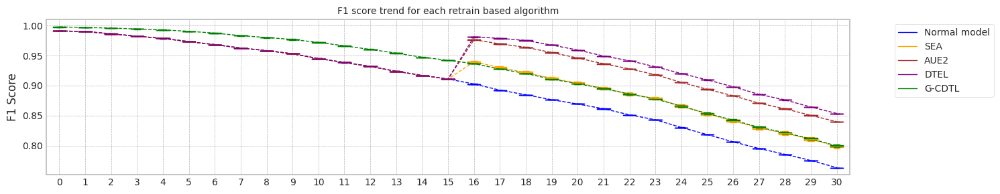

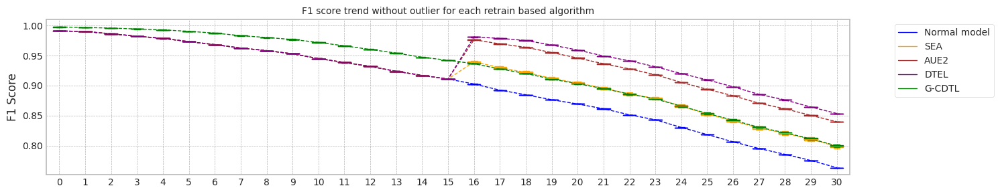

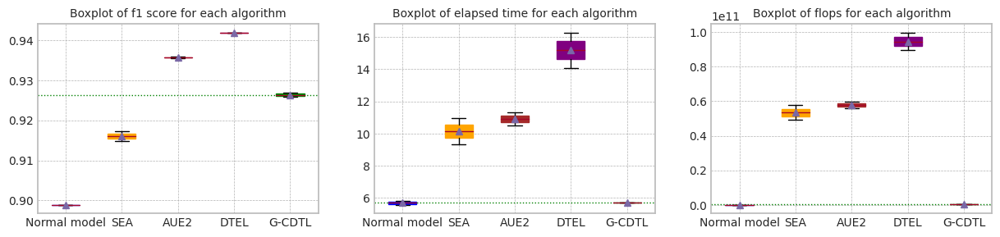

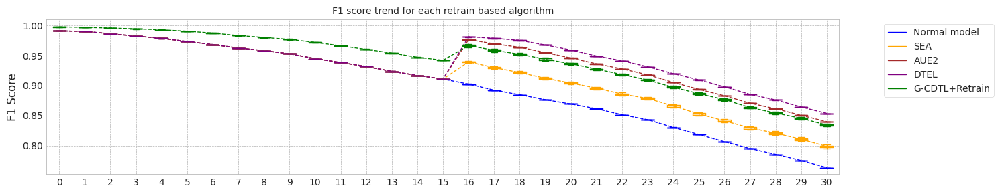

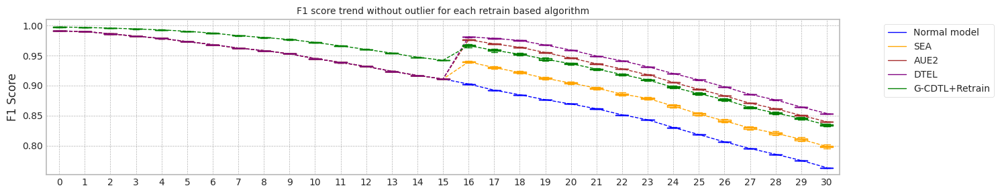

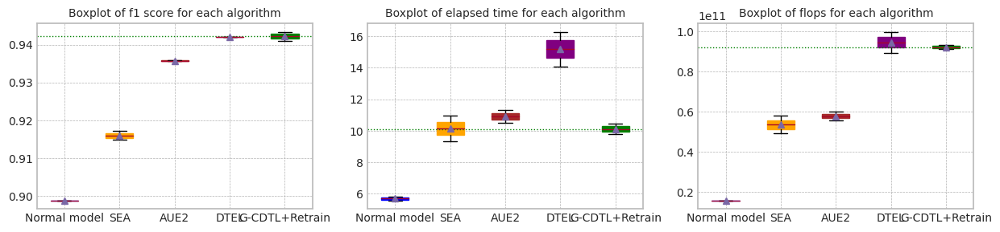

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.898917,0.763348,5.800730,1.566000e+10,121365000.0,1.578136e+10
1,1.0,0.990892,0.989878,0.898910,0.763359,5.578462,1.566000e+10,121365000.0,1.578136e+10
2,median,0.990989,0.989975,0.898913,0.763353,5.689596,1.566000e+10,121365000.0,1.578136e+10
3,std,0.000138,0.000138,0.000005,0.000008,0.157167,0.000000e+00,0.0,0.000000e+00


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.998098,0.997150,0.926870,0.802223,5.727549,7.866000e+10,609615000.0,7.926962e+10
1,1.0,0.997149,0.996297,0.925937,0.796987,5.717169,7.866000e+10,609615000.0,7.926962e+10
2,median,0.997624,0.996724,0.926403,0.799605,5.722359,7.866000e+10,609615000.0,7.926962e+10
3,std,0.000672,0.000604,0.000660,0.003702,0.007340,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.917265,0.801616,10.945378,2.879482e+10,2.910020e+10,5.789502e+10
1,1.0,0.990892,0.989878,0.914840,0.795660,9.310301,2.441786e+10,2.472322e+10,4.914108e+10
2,median,0.990989,0.989975,0.916053,0.798638,10.127840,2.660634e+10,2.691171e+10,5.351805e+10
3,std,0.000138,0.000138,0.001715,0.004211,1.156174,3.094985e+09,3.094985e+09,6.189970e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.935885,0.839996,11.321270,2.971094e+10,3.013854e+10,5.984948e+10
1,1.0,0.990892,0.989878,0.935581,0.839757,10.516359,2.767122e+10,2.809882e+10,5.577004e+10
2,median,0.990989,0.989975,0.935733,0.839877,10.918814,2.869108e+10,2.911868e+10,5.780976e+10
3,std,0.000138,0.000138,0.000215,0.000168,0.569158,1.442296e+09,1.442296e+09,2.884593e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.941971,0.853505,16.282771,4.156947e+10,5.820909e+10,9.977856e+10
1,1.0,0.990892,0.989878,0.941967,0.853690,14.069836,3.639384e+10,5.303346e+10,8.942730e+10
2,median,0.990989,0.989975,0.941969,0.853597,15.176304,3.898166e+10,5.562128e+10,9.460293e+10
3,std,0.000138,0.000138,0.000003,0.000131,1.564782,3.659723e+09,3.659723e+09,7.319446e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.998098,0.997150,0.941031,0.832155,9.802739,8.981006e+10,1.557905e+09,9.136796e+10
1,1.0,0.997149,0.996297,0.943360,0.836441,10.435681,9.154058e+10,1.557905e+09,9.309848e+10
2,median,0.997624,0.996724,0.942195,0.834298,10.119210,9.067532e+10,1.557905e+09,9.223322e+10
3,std,0.000672,0.000604,0.001647,0.003031,0.447558,1.223662e+09,0.000000e+00,1.223662e+09


trial_count: 2
Lambda :  0.8
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-11-25 08:58:30,637] [INFO] [profiler.py:80:start_profile] Flops profiler started


100%|██████████| 4000/4000 [00:09<00:00, 422.42it/s]

[2023-11-25 08:58:40,112] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 15660000000
precision_recall_fscore: (array([0.99084545, 0.98864926]), array([0.98395722, 0.99353612]), array([0.98738932, 0.99108667]), array([3740, 5260]))
Test f1 score: 0.9910866679309691
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.44it/s]

mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989171036382408
inference_flops: 121365000
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 08:58:45,876] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 08:58:45,879] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 4000/4000 [00:29<00:00, 135.91it/s]

[2023-11-25 08:59:15,316] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 08:59:15,318] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 63000000000 15660000000 78660000000
precision_recall_fscore: (array([0.9970604 , 0.99828832]), array([0.99759358, 0.99790875]), array([0.99732692, 0.9980985 ]), array([3740, 5260]))
Test f1 score: 0.9980984978132725
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.51it/s]

mean of drift:
x0    0.120219
x1    0.035530
x2    0.038817
x3    0.372448
z0    0.200280
dtype: float64
Mean F1 for all data: 0.9268699683171997
inference_flops: 609615000
Normal model median        : 0.8989171036382408
Drift tolerant model median: 0.9268699683171997
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-11-25 08:59:21,006] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 4000/4000 [00:09<00:00, 420.84it/s]

[2023-11-25 08:59:30,517] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 15660000000
precision_recall_fscore: (array([0.98978495, 0.98901515]), array([0.98449198, 0.99277567]), array([0.98713137, 0.99089184]), array([3740, 5260]))
Test f1 score: 0.9908918406072107
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.54it/s]

mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989098324837661
inference_flops: 121365000
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 08:59:36,175] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 08:59:36,178] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 4000/4000 [00:29<00:00, 137.43it/s]

[2023-11-25 09:00:05,292] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:00:05,293] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 63000000000 15660000000 78660000000
precision_recall_fscore: (array([0.99625468, 0.99695933]), array([0.99572193, 0.9973384 ]), array([0.99598823, 0.99714883]), array([3740, 5260]))
Test f1 score: 0.9971488310207186
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.18it/s]


mean of drift:
x0    0.128308
x1    0.315466
x2    0.057993
x3    0.153097
z0    0.113534
dtype: float64
Mean F1 for all data: 0.9259368542839278
inference_flops: 609615000
Normal model median        : 0.8989134680610035
Drift tolerant model median: 0.9264034113005637
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:01<00:03,  5.55it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:00:13,383] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:00:13,385] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 11.0
[2023-11-25 09:00:17,952] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:00:17,954] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:06<00:31,  1.58s/it]

G-CDTL train flops: 10032750000 2493855000 12526605000


 68%|██████▊   | 21/31 [00:08<00:02,  4.45it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:00:20,031] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:00:20,033] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 22.0
[2023-11-25 09:00:25,253] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:00:25,254] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:13<00:16,  1.79s/it]

G-CDTL train flops: 11308500000 2810970000 14119470000


100%|██████████| 31/31 [00:15<00:00,  1.99it/s]


Early stop at  [636, 717]
Train flops  {'generator': [10032750000, 11308500000], 'discriminator': [2493855000, 2810970000], 'sum': [12526605000, 14119470000]}
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9474026003645447
G_CDTL+AUE median: 0.9474026003645447
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:06<00:22,  1.20s/it]

Ensemble_SEA train flops: 11560995000


 74%|███████▍  | 23/31 [00:14<00:10,  1.27s/it]

Ensemble_SEA train flops: 12038625000


100%|██████████| 31/31 [00:15<00:00,  2.00it/s]


Early stop at  [2952, 3074]
Train flops  [11560995000, 12038625000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9236727752530027
SEA median: 0.9236727752530027
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:06<00:19,  1.01s/it]

Ensemble_AUE2 train flops: 9431235000


 74%|███████▍  | 23/31 [00:13<00:09,  1.23s/it]

Ensemble_AUE2 train flops: 11819385000


100%|██████████| 31/31 [00:14<00:00,  2.14it/s]


Early stop at  [2408, 3018]
Train flops  [9431235000, 11819385000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9400933342167751
AUE median: 0.9400933342167751
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:01<00:03,  5.59it/s]

Ensemble_DTEL train flops: 12441870000


 39%|███▊      | 12/31 [00:12<00:45,  2.38s/it]

Ensemble_DTEL train flops: 12441870000


 68%|██████▊   | 21/31 [00:14<00:02,  3.72it/s]

Ensemble_DTEL train flops: 12688515000


 74%|███████▍  | 23/31 [00:25<00:19,  2.49s/it]

Ensemble_DTEL train flops: 12688515000


100%|██████████| 31/31 [00:26<00:00,  1.15it/s]


Early stop at  [3177, 3177, 3240, 3240]
Train flops  [12441870000, 12441870000, 12688515000, 12688515000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9577893056265908
DTEL median: 0.9577893056265908
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:01<00:03,  5.55it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:01:26,025] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:01:26,027] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 11.0
[2023-11-25 09:01:31,482] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:01:31,483] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:07<00:37,  1.86s/it]

G-CDTL train flops: 11828250000 2940165000 14768415000


 68%|██████▊   | 21/31 [00:09<00:02,  4.38it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:01:33,514] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:01:33,517] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 22.0
[2023-11-25 09:01:38,396] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:01:38,397] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:14<00:15,  1.69s/it]

G-CDTL train flops: 10568250000 2626965000 13195215000


100%|██████████| 31/31 [00:16<00:00,  1.93it/s]


Early stop at  [750, 670]
Train flops  {'generator': [11828250000, 10568250000], 'discriminator': [2940165000, 2626965000], 'sum': [14768415000, 13195215000]}
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9470560872914581
G_CDTL+AUE median: 0.9472293438280014
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:07<00:24,  1.31s/it]

Ensemble_SEA train flops: 12747240000


 74%|███████▍  | 23/31 [00:13<00:08,  1.06s/it]

Ensemble_SEA train flops: 9807075000


100%|██████████| 31/31 [00:15<00:00,  2.06it/s]


Early stop at  [3255, 2504]
Train flops  [12747240000, 9807075000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9228299014137584
SEA median: 0.9232513383333806
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:08<00:27,  1.47s/it]

Ensemble_AUE2 train flops: 14606865000


 74%|███████▍  | 23/31 [00:14<00:09,  1.18s/it]

Ensemble_AUE2 train flops: 11114685000


100%|██████████| 31/31 [00:16<00:00,  1.90it/s]


Early stop at  [3730, 2838]
Train flops  [14606865000, 11114685000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9400031517400285
AUE median: 0.9400482429784018
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:01<00:03,  5.58it/s]

Ensemble_DTEL train flops: 11842875000


 35%|███▌      | 11/31 [00:11<01:03,  3.18s/it]

Ensemble_DTEL train flops: 11842875000


 68%|██████▊   | 21/31 [00:13<00:02,  3.78it/s]

Ensemble_DTEL train flops: 15660000000


 74%|███████▍  | 23/31 [00:26<00:23,  2.94s/it]

Ensemble_DTEL train flops: 15660000000


100%|██████████| 31/31 [00:28<00:00,  1.09it/s]


Early stop at  [3024, 3024, 3999, 3999]
Train flops  [11842875000, 11842875000, 15660000000, 15660000000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9576688912542182
DTEL median: 0.9577290984404045


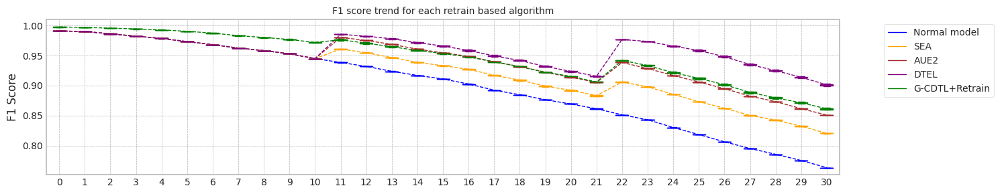

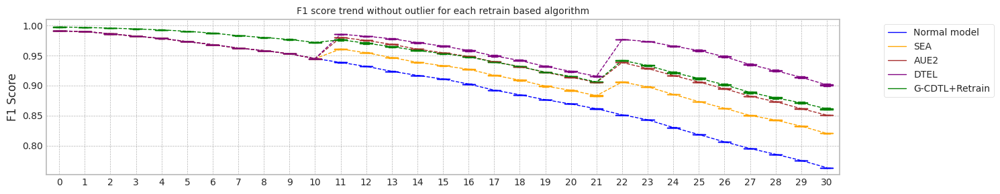

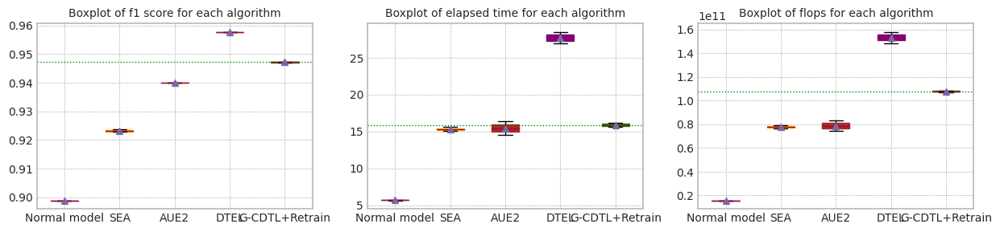

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.898917,0.763348,5.741055,1.566000e+10,121365000.0,1.578136e+10
1,1.0,0.990892,0.989878,0.898910,0.763359,5.639737,1.566000e+10,121365000.0,1.578136e+10
2,median,0.990989,0.989975,0.898913,0.763353,5.690396,1.566000e+10,121365000.0,1.578136e+10
3,std,0.000138,0.000138,0.000005,0.000008,0.071643,0.000000e+00,0.0,0.000000e+00


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.998098,0.997150,0.926870,0.802223,5.668211,7.866000e+10,609615000.0,7.926962e+10
1,1.0,0.997149,0.996297,0.925937,0.796987,6.030145,7.866000e+10,609615000.0,7.926962e+10
2,median,0.997624,0.996724,0.926403,0.799605,5.849178,7.866000e+10,609615000.0,7.926962e+10
3,std,0.000672,0.000604,0.000660,0.003702,0.255926,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.923673,0.820689,15.577169,3.925962e+10,3.961980e+10,7.887942e+10
1,1.0,0.990892,0.989878,0.922830,0.820199,15.075288,3.821432e+10,3.857450e+10,7.678881e+10
2,median,0.990989,0.989975,0.923251,0.820444,15.326228,3.873697e+10,3.909715e+10,7.783412e+10
3,std,0.000138,0.000138,0.000596,0.000346,0.354883,7.391423e+08,7.391423e+08,1.478285e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.940093,0.851138,14.514692,3.691062e+10,3.739434e+10,7.430496e+10
1,1.0,0.990892,0.989878,0.940003,0.850577,16.392416,4.138155e+10,4.186527e+10,8.324682e+10
2,median,0.990989,0.989975,0.940048,0.850858,15.453554,3.914608e+10,3.962980e+10,7.877589e+10
3,std,0.000138,0.000138,0.000064,0.000397,1.327751,3.161425e+09,3.161425e+09,6.322850e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.957789,0.899232,26.908673,6.592077e+10,8.256126e+10,1.484820e+11
1,1.0,0.990892,0.989878,0.957669,0.903291,28.503891,7.066575e+10,8.730624e+10,1.579720e+11
2,median,0.990989,0.989975,0.957729,0.901261,27.706282,6.829326e+10,8.493375e+10,1.532270e+11
3,std,0.000138,0.000138,0.000085,0.002870,1.127990,3.355208e+09,3.355208e+09,6.710415e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.998098,0.997150,0.947403,0.863356,15.624956,1.053061e+11,1.859435e+09,1.071655e+11
1,1.0,0.997149,0.996297,0.947056,0.859346,16.126772,1.066236e+11,1.859435e+09,1.084831e+11
2,median,0.997624,0.996724,0.947229,0.861351,15.875864,1.059649e+11,1.859435e+09,1.078243e+11
3,std,0.000672,0.000604,0.000245,0.002835,0.354838,9.316521e+08,0.000000e+00,9.316521e+08


trial_count: 2
Lambda :  0.8
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-11-25 09:02:43,616] [INFO] [profiler.py:80:start_profile] Flops profiler started


100%|██████████| 4000/4000 [00:09<00:00, 413.20it/s]

[2023-11-25 09:02:53,303] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 15660000000
precision_recall_fscore: (array([0.99084545, 0.98864926]), array([0.98395722, 0.99353612]), array([0.98738932, 0.99108667]), array([3740, 5260]))
Test f1 score: 0.9910866679309691
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.45it/s]

mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989171036382408
inference_flops: 121365000
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:02:59,053] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:02:59,055] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 4000/4000 [00:29<00:00, 134.27it/s]

[2023-11-25 09:03:28,854] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:03:28,855] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 63000000000 15660000000 78660000000
precision_recall_fscore: (array([0.9970604 , 0.99828832]), array([0.99759358, 0.99790875]), array([0.99732692, 0.9980985 ]), array([3740, 5260]))
Test f1 score: 0.9980984978132725
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.43it/s]

mean of drift:
x0    0.120219
x1    0.035530
x2    0.038817
x3    0.372448
z0    0.200280
dtype: float64
Mean F1 for all data: 0.9268699683171997
inference_flops: 609615000
Normal model median        : 0.8989171036382408
Drift tolerant model median: 0.9268699683171997
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-11-25 09:03:34,624] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 4000/4000 [00:09<00:00, 414.54it/s]

[2023-11-25 09:03:44,279] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 15660000000
precision_recall_fscore: (array([0.98978495, 0.98901515]), array([0.98449198, 0.99277567]), array([0.98713137, 0.99089184]), array([3740, 5260]))
Test f1 score: 0.9908918406072107
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.39it/s]

mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989098324837661
inference_flops: 121365000
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:03:50,097] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:03:50,099] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 4000/4000 [00:29<00:00, 134.14it/s]

[2023-11-25 09:04:19,926] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:04:19,928] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 63000000000 15660000000 78660000000
precision_recall_fscore: (array([0.99625468, 0.99695933]), array([0.99572193, 0.9973384 ]), array([0.99598823, 0.99714883]), array([3740, 5260]))
Test f1 score: 0.9971488310207186
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.37it/s]


mean of drift:
x0    0.128308
x1    0.315466
x2    0.057993
x3    0.153097
z0    0.113534
dtype: float64
Mean F1 for all data: 0.9259368542839278
inference_flops: 609615000
Normal model median        : 0.8989134680610035
Drift tolerant model median: 0.9264034113005637
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.26it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:04:27,359] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:04:27,361] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 8.0
[2023-11-25 09:04:33,025] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:04:33,026] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 29%|██▉       | 9/31 [00:07<00:31,  1.43s/it]

G-CDTL train flops: 11985750000 2979315000 14965065000


 48%|████▊     | 15/31 [00:08<00:05,  3.08it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:04:34,514] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:04:34,517] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 16.0
[2023-11-25 09:04:40,663] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:04:40,664] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:14<00:32,  2.14s/it]

G-CDTL train flops: 13104000000 3257280000 16361280000


 74%|███████▍  | 23/31 [00:16<00:02,  2.86it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:04:42,193] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:04:42,196] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 24.0
[2023-11-25 09:04:48,353] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:04:48,354] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:22<00:15,  2.16s/it]

G-CDTL train flops: 13245750000 3292515000 16538265000


100%|██████████| 31/31 [00:23<00:00,  1.30it/s]


Early stop at  [760, 831, 840]
Train flops  {'generator': [11985750000, 13104000000, 13245750000], 'discriminator': [2979315000, 3257280000, 3292515000], 'sum': [14965065000, 16361280000, 16538265000]}
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9533847983337351
G_CDTL+AUE median: 0.9533847983337351
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:08<00:36,  1.67s/it]

Ensemble_SEA train flops: 15660000000


 55%|█████▍    | 17/31 [00:15<00:19,  1.36s/it]

Ensemble_SEA train flops: 12253950000


 81%|████████  | 25/31 [00:22<00:08,  1.41s/it]

Ensemble_SEA train flops: 12986055000


100%|██████████| 31/31 [00:23<00:00,  1.34it/s]


Early stop at  [3999, 3129, 3316]
Train flops  [15660000000, 12253950000, 12986055000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9269648937568984
SEA median: 0.9269648937568984
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:08<00:35,  1.63s/it]

Ensemble_AUE2 train flops: 15660000000


 55%|█████▍    | 17/31 [00:15<00:19,  1.40s/it]

Ensemble_AUE2 train flops: 12649365000


 81%|████████  | 25/31 [00:21<00:07,  1.24s/it]

Ensemble_AUE2 train flops: 11083365000


100%|██████████| 31/31 [00:22<00:00,  1.38it/s]


Early stop at  [3999, 3230, 2830]
Train flops  [15660000000, 12649365000, 11083365000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9429479969439334
AUE median: 0.9429479969439334
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:01<00:04,  5.21it/s]

Ensemble_DTEL train flops: 23490000
Ensemble_DTEL train flops: 23490000


 48%|████▊     | 15/31 [00:02<00:03,  5.21it/s]

Ensemble_DTEL train flops: 12696345000


 55%|█████▍    | 17/31 [00:13<00:34,  2.43s/it]

Ensemble_DTEL train flops: 12696345000


 74%|███████▍  | 23/31 [00:14<00:03,  2.23it/s]

Ensemble_DTEL train flops: 11423970000


 81%|████████  | 25/31 [00:25<00:14,  2.35s/it]

Ensemble_DTEL train flops: 11423970000


100%|██████████| 31/31 [00:26<00:00,  1.19it/s]


Early stop at  [5, 5, 3242, 3242, 2917, 2917]
Train flops  [23490000, 23490000, 12696345000, 12696345000, 11423970000, 11423970000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.956530475048492
DTEL median: 0.956530475048492
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.32it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:06:03,120] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:06:03,122] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 8.0
[2023-11-25 09:06:07,929] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:06:07,930] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 29%|██▉       | 9/31 [00:06<00:27,  1.24s/it]

G-CDTL train flops: 10269000000 2552580000 12821580000


 48%|████▊     | 15/31 [00:07<00:04,  3.29it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:06:09,422] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:06:09,424] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 16.0
[2023-11-25 09:06:13,788] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:06:13,790] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:12<00:23,  1.59s/it]

G-CDTL train flops: 9292500000 2309850000 11602350000


 74%|███████▍  | 23/31 [00:13<00:02,  3.33it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:06:15,305] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:06:15,307] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 24.0
[2023-11-25 09:06:21,054] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:06:21,055] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:19<00:13,  2.00s/it]

G-CDTL train flops: 12237750000 3041955000 15279705000


100%|██████████| 31/31 [00:20<00:00,  1.49it/s]


Early stop at  [651, 589, 776]
Train flops  {'generator': [10269000000, 9292500000, 12237750000], 'discriminator': [2552580000, 2309850000, 3041955000], 'sum': [12821580000, 11602350000, 15279705000]}
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9509186517940568
G_CDTL+AUE median: 0.952151725063896
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:07<00:32,  1.46s/it]

Ensemble_SEA train flops: 13361895000


 55%|█████▍    | 17/31 [00:14<00:18,  1.32s/it]

Ensemble_SEA train flops: 11690190000


 81%|████████  | 25/31 [00:20<00:07,  1.25s/it]

Ensemble_SEA train flops: 11275200000


100%|██████████| 31/31 [00:21<00:00,  1.45it/s]


Early stop at  [3412, 2985, 2879]
Train flops  [13361895000, 11690190000, 11275200000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9264098006529328
SEA median: 0.9266873472049155
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:07<00:30,  1.40s/it]

Ensemble_AUE2 train flops: 12919500000


 55%|█████▍    | 17/31 [00:15<00:23,  1.68s/it]

Ensemble_AUE2 train flops: 15660000000


 81%|████████  | 25/31 [00:23<00:09,  1.60s/it]

Ensemble_AUE2 train flops: 14939640000


100%|██████████| 31/31 [00:24<00:00,  1.27it/s]


Early stop at  [3299, 3999, 3815]
Train flops  [12919500000, 15660000000, 14939640000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9426558603141478
AUE median: 0.9428019286290406
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.53it/s]

Ensemble_DTEL train flops: 5316570000


 29%|██▉       | 9/31 [00:06<00:26,  1.18s/it]

Ensemble_DTEL train flops: 5316570000


 48%|████▊     | 15/31 [00:07<00:04,  3.38it/s]

Ensemble_DTEL train flops: 5911650000


 55%|█████▍    | 17/31 [00:12<00:18,  1.30s/it]

Ensemble_DTEL train flops: 5911650000


 77%|███████▋  | 24/31 [00:14<00:02,  3.38it/s]

Ensemble_DTEL train flops: 74385000
Ensemble_DTEL train flops: 74385000


100%|██████████| 31/31 [00:15<00:00,  2.02it/s]


Early stop at  [1357, 1357, 1509, 1509, 18, 18]
Train flops  [5316570000, 5316570000, 5911650000, 5911650000, 74385000, 74385000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9513615963775228
DTEL median: 0.9539460357130074


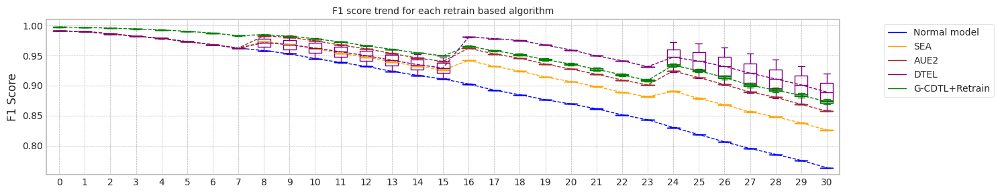

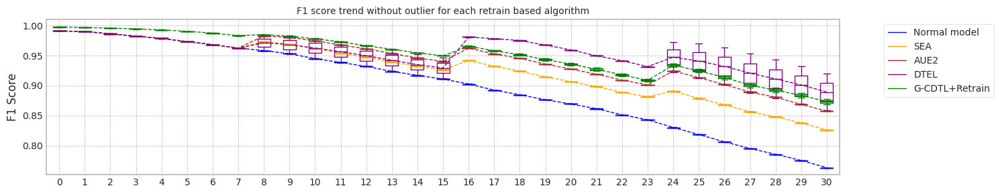

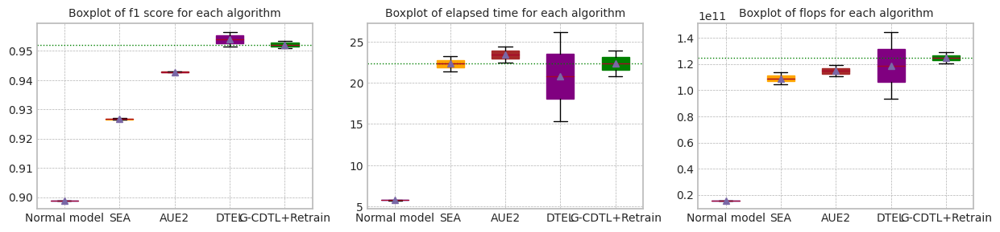

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.898917,0.763348,5.734056,1.566000e+10,121365000.0,1.578136e+10
1,1.0,0.990892,0.989878,0.898910,0.763359,5.801536,1.566000e+10,121365000.0,1.578136e+10
2,median,0.990989,0.989975,0.898913,0.763353,5.767796,1.566000e+10,121365000.0,1.578136e+10
3,std,0.000138,0.000138,0.000005,0.000008,0.047716,0.000000e+00,0.0,0.000000e+00


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.998098,0.997150,0.926870,0.802223,5.748389,7.866000e+10,609615000.0,7.926962e+10
1,1.0,0.997149,0.996297,0.925937,0.796987,5.818587,7.866000e+10,609615000.0,7.926962e+10
2,median,0.997624,0.996724,0.926403,0.799605,5.783488,7.866000e+10,609615000.0,7.926962e+10
3,std,0.000672,0.000604,0.000660,0.003702,0.049637,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.926965,0.826824,23.227755,5.656000e+10,5.698282e+10,1.135428e+11
1,1.0,0.990892,0.989878,0.926410,0.825462,21.402424,5.198728e+10,5.241010e+10,1.043974e+11
2,median,0.990989,0.989975,0.926687,0.826143,22.315089,5.427364e+10,5.469646e+10,1.089701e+11
3,std,0.000138,0.000138,0.000393,0.000963,1.290704,3.233401e+09,3.233401e+09,6.466803e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.942948,0.857829,22.436941,5.505273e+10,5.560083e+10,1.106536e+11
1,1.0,0.990892,0.989878,0.942656,0.857423,24.410838,5.917914e+10,5.972724e+10,1.189064e+11
2,median,0.990989,0.989975,0.942802,0.857626,23.423890,5.711594e+10,5.766404e+10,1.147800e+11
3,std,0.000138,0.000138,0.000207,0.000287,1.395756,2.917812e+09,2.917812e+09,5.835625e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.956530,0.919460,26.185558,6.394761e+10,8.058897e+10,1.445366e+11
1,1.0,0.990892,0.989878,0.951362,0.859100,15.368793,3.826521e+10,5.490657e+10,9.317178e+10
2,median,0.990989,0.989975,0.953946,0.889280,20.777176,5.110641e+10,6.774777e+10,1.188542e+11
3,std,0.000138,0.000138,0.003655,0.042681,7.648608,1.816020e+10,1.816020e+10,3.632040e+10


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.998098,0.997150,0.953385,0.877615,23.945382,1.265246e+11,2.202480e+09,1.287271e+11
1,1.0,0.997149,0.996297,0.950919,0.869227,20.840256,1.183636e+11,2.202480e+09,1.205661e+11
2,median,0.997624,0.996724,0.952152,0.873421,22.392819,1.224441e+11,2.202480e+09,1.246466e+11
3,std,0.000672,0.000604,0.001744,0.005931,2.195656,5.770681e+09,0.000000e+00,5.770681e+09


trial_count: 2
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-11-25 09:07:27,243] [INFO] [profiler.py:80:start_profile] Flops profiler started


100%|██████████| 4000/4000 [00:10<00:00, 395.35it/s]

[2023-11-25 09:07:37,367] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 15660000000
precision_recall_fscore: (array([0.99084545, 0.98864926]), array([0.98395722, 0.99353612]), array([0.98738932, 0.99108667]), array([3740, 5260]))
Test f1 score: 0.9910866679309691
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.46it/s]

mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989171036382408
inference_flops: 121365000
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:07:43,106] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:07:43,108] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 4000/4000 [00:30<00:00, 130.38it/s]

[2023-11-25 09:08:13,796] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:08:13,797] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 63000000000 15660000000 78660000000
precision_recall_fscore: (array([0.9970604 , 0.99828832]), array([0.99759358, 0.99790875]), array([0.99732692, 0.9980985 ]), array([3740, 5260]))
Test f1 score: 0.9980984978132725
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.34it/s]

mean of drift:
x0    0.120219
x1    0.035530
x2    0.038817
x3    0.372448
z0    0.200280
dtype: float64
Mean F1 for all data: 0.9268699683171997
inference_flops: 609615000
Normal model median        : 0.8989171036382408
Drift tolerant model median: 0.9268699683171997
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-11-25 09:08:19,667] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 4000/4000 [00:09<00:00, 405.29it/s]

[2023-11-25 09:08:29,543] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 15660000000
precision_recall_fscore: (array([0.98978495, 0.98901515]), array([0.98449198, 0.99277567]), array([0.98713137, 0.99089184]), array([3740, 5260]))
Test f1 score: 0.9908918406072107
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.23it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989098324837661
inference_flops: 121365000
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:08:35,539] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:08:35,541] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 4000/4000 [00:31<00:00, 126.43it/s]

[2023-11-25 09:09:07,185] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:09:07,186] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 63000000000 15660000000 78660000000
precision_recall_fscore: (array([0.99625468, 0.99695933]), array([0.99572193, 0.9973384 ]), array([0.99598823, 0.99714883]), array([3740, 5260]))
Test f1 score: 0.9971488310207186
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.43it/s]


mean of drift:
x0    0.128308
x1    0.315466
x2    0.057993
x3    0.153097
z0    0.113534
dtype: float64
Mean F1 for all data: 0.9259368542839278
inference_flops: 609615000
Normal model median        : 0.8989134680610035
Drift tolerant model median: 0.9264034113005637
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:04,  5.41it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:09:14,311] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:09:14,314] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 7.0
[2023-11-25 09:09:20,438] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:09:20,439] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:07<00:35,  1.55s/it]

G-CDTL train flops: 12552750000 3120255000 15673005000


 42%|████▏     | 13/31 [00:08<00:07,  2.46it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:09:21,772] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:09:21,774] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 14.0
[2023-11-25 09:09:27,293] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:09:27,295] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:14<00:34,  2.01s/it]

G-CDTL train flops: 11371500000 2826630000 14198130000


 65%|██████▍   | 20/31 [00:15<00:04,  2.49it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:09:28,636] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:09:28,639] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-25 09:09:35,216] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:09:35,217] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:22<00:23,  2.32s/it]

G-CDTL train flops: 13450500000 3343410000 16793910000


 87%|████████▋ | 27/31 [00:23<00:01,  2.27it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:09:36,588] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:09:36,590] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 28.0
[2023-11-25 09:09:43,365] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:09:43,366] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:30<00:07,  2.41s/it]

G-CDTL train flops: 13923000000 3460860000 17383860000


100%|██████████| 31/31 [00:31<00:00,  1.00s/it]


Early stop at  [796, 721, 853, 883]
Train flops  {'generator': [12552750000, 11371500000, 13450500000, 13923000000], 'discriminator': [3120255000, 2826630000, 3343410000, 3460860000], 'sum': [15673005000, 14198130000, 16793910000, 17383860000]}
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9539029474486057
G_CDTL+AUE median: 0.9539029474486057
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:07<00:35,  1.53s/it]

Ensemble_SEA train flops: 13753395000


 48%|████▊     | 15/31 [00:15<00:27,  1.73s/it]

Ensemble_SEA train flops: 15660000000


 71%|███████   | 22/31 [00:21<00:10,  1.20s/it]

Ensemble_SEA train flops: 9583920000


 94%|█████████▎| 29/31 [00:27<00:02,  1.24s/it]

Ensemble_SEA train flops: 10445220000


100%|██████████| 31/31 [00:27<00:00,  1.13it/s]


Early stop at  [3512, 3999, 2447, 2667]
Train flops  [13753395000, 15660000000, 9583920000, 10445220000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9283299208889768
SEA median: 0.9283299208889768
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:06<00:31,  1.39s/it]

Ensemble_AUE2 train flops: 12281355000


 48%|████▊     | 15/31 [00:13<00:21,  1.32s/it]

Ensemble_AUE2 train flops: 11376990000


 71%|███████   | 22/31 [00:19<00:12,  1.41s/it]

Ensemble_AUE2 train flops: 12273525000


 94%|█████████▎| 29/31 [00:25<00:02,  1.15s/it]

Ensemble_AUE2 train flops: 9482130000


100%|██████████| 31/31 [00:25<00:00,  1.21it/s]


Early stop at  [3136, 2905, 3134, 2421]
Train flops  [12281355000, 11376990000, 12273525000, 9482130000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9445488075310197
AUE median: 0.9445488075310197
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:01<00:04,  5.22it/s]

Ensemble_DTEL train flops: 19575000
Ensemble_DTEL train flops: 19575000


 42%|████▏     | 13/31 [00:02<00:03,  5.34it/s]

Ensemble_DTEL train flops: 8272395000


 48%|████▊     | 15/31 [00:10<00:27,  1.72s/it]

Ensemble_DTEL train flops: 8272395000


 65%|██████▍   | 20/31 [00:11<00:04,  2.27it/s]

Ensemble_DTEL train flops: 9501705000


 71%|███████   | 22/31 [00:19<00:18,  2.07s/it]

Ensemble_DTEL train flops: 9501705000


 87%|████████▋ | 27/31 [00:20<00:01,  2.01it/s]

Ensemble_DTEL train flops: 6448005000


 94%|█████████▎| 29/31 [00:26<00:03,  1.54s/it]

Ensemble_DTEL train flops: 6448005000


100%|██████████| 31/31 [00:27<00:00,  1.14it/s]


Early stop at  [4, 4, 2112, 2112, 2426, 2426, 1646, 1646]
Train flops  [19575000, 19575000, 8272395000, 8272395000, 9501705000, 9501705000, 6448005000, 6448005000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9623436073206657
DTEL median: 0.9623436073206657
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:04,  5.24it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:11:05,729] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:11:05,731] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 7.0
[2023-11-25 09:11:11,979] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:11:11,980] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:07<00:53,  2.24s/it]

G-CDTL train flops: 12852000000 3194640000 16046640000


 42%|████▏     | 13/31 [00:08<00:07,  2.45it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:11:13,299] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:11:13,302] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 14.0
[2023-11-25 09:11:18,052] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:11:18,053] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:13<00:30,  1.78s/it]

G-CDTL train flops: 9969750000 2478195000 12447945000


 65%|██████▍   | 20/31 [00:14<00:04,  2.64it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:11:19,410] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:11:19,412] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-25 09:11:23,483] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:11:23,484] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:19<00:15,  1.55s/it]

G-CDTL train flops: 8190000000 2035800000 10225800000


 87%|████████▋ | 27/31 [00:20<00:01,  2.81it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:11:24,886] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:11:24,888] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 28.0
[2023-11-25 09:11:29,623] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:11:29,624] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:25<00:05,  1.74s/it]

G-CDTL train flops: 9591750000 2384235000 11975985000


100%|██████████| 31/31 [00:25<00:00,  1.20it/s]


Early stop at  [815, 632, 519, 608]
Train flops  {'generator': [12852000000, 9969750000, 8190000000, 9591750000], 'discriminator': [3194640000, 2478195000, 2035800000, 2384235000], 'sum': [16046640000, 12447945000, 10225800000, 11975985000]}
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9544493239184966
G_CDTL+AUE median: 0.9541761356835512
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:07<00:37,  1.62s/it]

Ensemble_SEA train flops: 14039190000


 48%|████▊     | 15/31 [00:15<00:26,  1.66s/it]

Ensemble_SEA train flops: 14536395000


 71%|███████   | 22/31 [00:22<00:12,  1.37s/it]

Ensemble_SEA train flops: 11122515000


 94%|█████████▎| 29/31 [00:28<00:02,  1.41s/it]

Ensemble_SEA train flops: 12261780000


100%|██████████| 31/31 [00:29<00:00,  1.07it/s]


Early stop at  [3585, 3712, 2840, 3131]
Train flops  [14039190000, 14536395000, 11122515000, 12261780000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9278261181303142
SEA median: 0.9280780195096455
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:06<00:31,  1.39s/it]

Ensemble_AUE2 train flops: 12113010000


 48%|████▊     | 15/31 [00:13<00:22,  1.38s/it]

Ensemble_AUE2 train flops: 11807640000


 71%|███████   | 22/31 [00:19<00:11,  1.26s/it]

Ensemble_AUE2 train flops: 10449135000


 94%|█████████▎| 29/31 [00:24<00:02,  1.11s/it]

Ensemble_AUE2 train flops: 9149355000


100%|██████████| 31/31 [00:25<00:00,  1.24it/s]


Early stop at  [3093, 3015, 2668, 2336]
Train flops  [12113010000, 11807640000, 10449135000, 9149355000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9443721782769399
AUE median: 0.9444604929039797
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:01<00:04,  5.32it/s]

Ensemble_DTEL train flops: 19575000
Ensemble_DTEL train flops: 19575000


 42%|████▏     | 13/31 [00:02<00:03,  5.40it/s]

Ensemble_DTEL train flops: 8769600000


 48%|████▊     | 15/31 [00:10<00:29,  1.84s/it]

Ensemble_DTEL train flops: 8769600000


 65%|██████▍   | 20/31 [00:11<00:05,  2.17it/s]

Ensemble_DTEL train flops: 10449135000


 71%|███████   | 22/31 [00:21<00:20,  2.27s/it]

Ensemble_DTEL train flops: 10449135000


 87%|████████▋ | 27/31 [00:22<00:02,  1.87it/s]

Ensemble_DTEL train flops: 11737170000


 94%|█████████▎| 29/31 [00:32<00:05,  2.53s/it]

Ensemble_DTEL train flops: 11737170000


100%|██████████| 31/31 [00:33<00:00,  1.07s/it]


Early stop at  [4, 4, 2239, 2239, 2668, 2668, 2997, 2997]
Train flops  [19575000, 19575000, 8769600000, 8769600000, 10449135000, 10449135000, 11737170000, 11737170000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9626167697073215
DTEL median: 0.9624801885139935


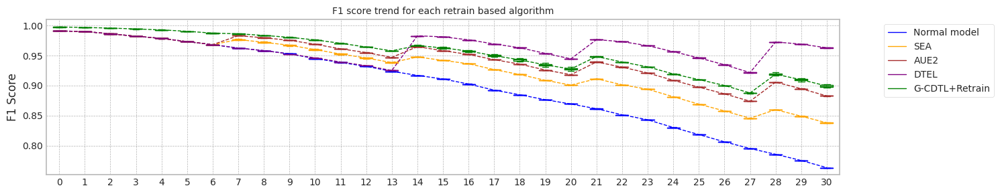

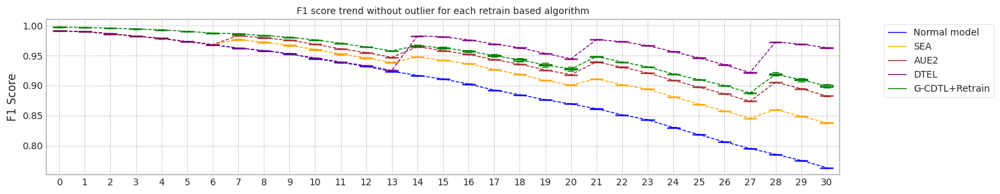

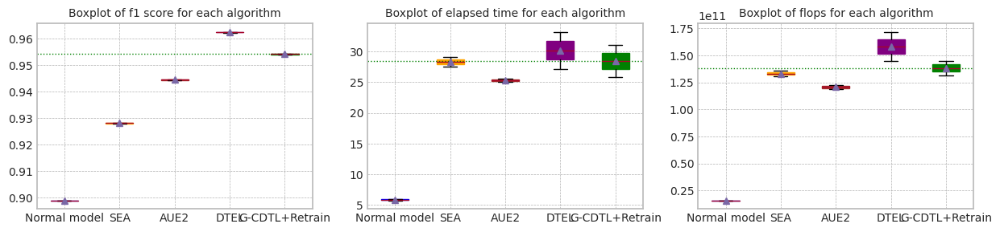

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.898917,0.763348,5.722997,1.566000e+10,121365000.0,1.578136e+10
1,1.0,0.990892,0.989878,0.898910,0.763359,5.976571,1.566000e+10,121365000.0,1.578136e+10
2,median,0.990989,0.989975,0.898913,0.763353,5.849784,1.566000e+10,121365000.0,1.578136e+10
3,std,0.000138,0.000138,0.000005,0.000008,0.179304,0.000000e+00,0.0,0.000000e+00


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.998098,0.997150,0.926870,0.802223,5.849472,7.866000e+10,609615000.0,7.926962e+10
1,1.0,0.997149,0.996297,0.925937,0.796987,5.758921,7.866000e+10,609615000.0,7.926962e+10
2,median,0.997624,0.996724,0.926403,0.799605,5.804196,7.866000e+10,609615000.0,7.926962e+10
3,std,0.000672,0.000604,0.000660,0.003702,0.064029,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.928330,0.837768,27.542969,6.510254e+10,6.556059e+10,1.306631e+11
1,1.0,0.990892,0.989878,0.927826,0.838326,29.146741,6.761988e+10,6.807794e+10,1.356978e+11
2,median,0.990989,0.989975,0.928078,0.838047,28.344855,6.636121e+10,6.681926e+10,1.331805e+11
3,std,0.000138,0.000138,0.000356,0.000395,1.134038,1.780032e+09,1.780032e+09,3.560063e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.944549,0.882939,25.623125,6.107400e+10,6.165951e+10,1.227335e+11
1,1.0,0.990892,0.989878,0.944372,0.882640,25.119467,5.917914e+10,5.976465e+10,1.189438e+11
2,median,0.990989,0.989975,0.944460,0.882789,25.371296,6.012657e+10,6.071208e+10,1.208386e+11
3,std,0.000138,0.000138,0.000125,0.000212,0.356141,1.339868e+09,1.339868e+09,2.679737e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.962344,0.962113,27.166765,6.414336e+10,8.078559e+10,1.449290e+11
1,1.0,0.990892,0.989878,0.962617,0.963775,33.228739,7.761096e+10,9.425319e+10,1.718642e+11
2,median,0.990989,0.989975,0.962480,0.962944,30.197752,7.087716e+10,8.751939e+10,1.583966e+11
3,std,0.000138,0.000138,0.000193,0.001175,4.286463,9.523031e+09,9.523031e+09,1.904606e+10


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.998098,0.997150,0.953903,0.901947,31.052800,1.427089e+11,2.410055e+09,1.451190e+11
1,1.0,0.997149,0.996297,0.954449,0.896737,25.908728,1.293564e+11,2.410055e+09,1.317664e+11
2,median,0.997624,0.996724,0.954176,0.899342,28.480764,1.360326e+11,2.410055e+09,1.384427e+11
3,std,0.000672,0.000604,0.000386,0.003684,3.637408,9.441668e+09,0.000000e+00,9.441668e+09


trial_count: 2
Lambda :  0.8
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-11-25 09:13:01,355] [INFO] [profiler.py:80:start_profile] Flops profiler started


100%|██████████| 4000/4000 [00:10<00:00, 386.07it/s]

[2023-11-25 09:13:11,723] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 15660000000
precision_recall_fscore: (array([0.99084545, 0.98864926]), array([0.98395722, 0.99353612]), array([0.98738932, 0.99108667]), array([3740, 5260]))
Test f1 score: 0.9910866679309691
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.43it/s]

mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989171036382408
inference_flops: 121365000
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:13:17,503] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:13:17,505] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 4000/4000 [00:33<00:00, 120.62it/s]

[2023-11-25 09:13:50,673] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:13:50,674] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 63000000000 15660000000 78660000000
precision_recall_fscore: (array([0.9970604 , 0.99828832]), array([0.99759358, 0.99790875]), array([0.99732692, 0.9980985 ]), array([3740, 5260]))
Test f1 score: 0.9980984978132725
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.23it/s]

mean of drift:
x0    0.120219
x1    0.035530
x2    0.038817
x3    0.372448
z0    0.200280
dtype: float64
Mean F1 for all data: 0.9268699683171997
inference_flops: 609615000
Normal model median        : 0.8989171036382408
Drift tolerant model median: 0.9268699683171997
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-11-25 09:13:56,667] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 4000/4000 [00:10<00:00, 390.84it/s]

[2023-11-25 09:14:06,907] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 15660000000
precision_recall_fscore: (array([0.98978495, 0.98901515]), array([0.98449198, 0.99277567]), array([0.98713137, 0.99089184]), array([3740, 5260]))
Test f1 score: 0.9908918406072107
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.41it/s]

mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989098324837661
inference_flops: 121365000
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:14:12,708] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:14:12,710] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 4000/4000 [00:32<00:00, 122.36it/s]

[2023-11-25 09:14:45,410] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:14:45,411] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 63000000000 15660000000 78660000000
precision_recall_fscore: (array([0.99625468, 0.99695933]), array([0.99572193, 0.9973384 ]), array([0.99598823, 0.99714883]), array([3740, 5260]))
Test f1 score: 0.9971488310207186
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.27it/s]


mean of drift:
x0    0.128308
x1    0.315466
x2    0.057993
x3    0.153097
z0    0.113534
dtype: float64
Mean F1 for all data: 0.9259368542839278
inference_flops: 609615000
Normal model median        : 0.8989134680610035
Drift tolerant model median: 0.9264034113005637
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:00<00:04,  5.34it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:14:52,539] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:14:52,541] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 6.0
[2023-11-25 09:14:57,894] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:14:57,896] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:06<00:50,  2.01s/it]

G-CDTL train flops: 10788750000 2681775000 13470525000


 35%|███▌      | 11/31 [00:07<00:09,  2.16it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:14:59,026] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:14:59,028] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 12.0
[2023-11-25 09:15:05,151] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:15:05,152] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:13<00:42,  2.25s/it]

G-CDTL train flops: 12048750000 2994975000 15043725000


 55%|█████▍    | 17/31 [00:14<00:07,  1.87it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:15:06,333] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:15:06,335] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 18.0
[2023-11-25 09:15:13,160] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:15:13,161] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:21<00:32,  2.49s/it]

G-CDTL train flops: 13513500000 3359070000 16872570000


 74%|███████▍  | 23/31 [00:22<00:04,  1.71it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:15:14,387] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:15:14,389] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 24.0
[2023-11-25 09:15:19,759] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:15:19,760] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:28<00:14,  2.09s/it]

G-CDTL train flops: 10552500000 2623050000 13175550000


 94%|█████████▎| 29/31 [00:29<00:01,  1.94it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:15:20,958] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:15:20,961] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-25 09:15:27,566] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:15:27,567] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:36<00:02,  2.41s/it]

G-CDTL train flops: 13009500000 3233790000 16243290000


100%|██████████| 31/31 [00:36<00:00,  1.17s/it]


Early stop at  [684, 764, 857, 669, 825]
Train flops  {'generator': [10788750000, 12048750000, 13513500000, 10552500000, 13009500000], 'discriminator': [2681775000, 2994975000, 3359070000, 2623050000, 3233790000], 'sum': [13470525000, 15043725000, 16872570000, 13175550000, 16243290000]}
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9549464624475204
G_CDTL+AUE median: 0.9549464624475204
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:06<00:35,  1.46s/it]

Ensemble_SEA train flops: 12148245000


 42%|████▏     | 13/31 [00:14<00:31,  1.78s/it]

Ensemble_SEA train flops: 14826105000


 61%|██████▏   | 19/31 [00:20<00:16,  1.38s/it]

Ensemble_SEA train flops: 10547010000


 81%|████████  | 25/31 [00:26<00:08,  1.37s/it]

Ensemble_SEA train flops: 10993320000


100%|██████████| 31/31 [00:32<00:00,  1.04s/it]

Ensemble_SEA train flops: 8887050000
Early stop at  [3102, 3786, 2693, 2807, 2269]
Train flops  [12148245000, 14826105000, 10547010000, 10993320000, 8887050000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9298966964943977
SEA median: 0.9298966964943977
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)


Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:07<00:37,  1.58s/it]

Ensemble_AUE2 train flops: 13264020000


 42%|████▏     | 13/31 [00:15<00:32,  1.81s/it]

Ensemble_AUE2 train flops: 15084495000


 61%|██████▏   | 19/31 [00:21<00:16,  1.38s/it]

Ensemble_AUE2 train flops: 10464795000


 81%|████████  | 25/31 [00:27<00:07,  1.32s/it]

Ensemble_AUE2 train flops: 10409985000


100%|██████████| 31/31 [00:32<00:00,  1.06s/it]

Ensemble_AUE2 train flops: 9994995000
Early stop at  [3387, 3852, 2672, 2658, 2552]
Train flops  [13264020000, 15084495000, 10464795000, 10409985000, 9994995000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9466830217907602
AUE median: 0.9466830217907602
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)


Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.15it/s]

Ensemble_DTEL train flops: 19575000
Ensemble_DTEL train flops: 19575000


 35%|███▌      | 11/31 [00:02<00:03,  5.19it/s]

Ensemble_DTEL train flops: 6686820000


 42%|████▏     | 13/31 [00:08<00:26,  1.49s/it]

Ensemble_DTEL train flops: 6686820000


 55%|█████▍    | 17/31 [00:09<00:07,  1.99it/s]

Ensemble_DTEL train flops: 14665590000


 61%|██████▏   | 19/31 [00:23<00:38,  3.17s/it]

Ensemble_DTEL train flops: 14665590000


 74%|███████▍  | 23/31 [00:23<00:07,  1.11it/s]

Ensemble_DTEL train flops: 7387605000


 81%|████████  | 25/31 [00:31<00:11,  1.94s/it]

Ensemble_DTEL train flops: 7387605000


 94%|█████████▎| 29/31 [00:31<00:01,  1.64it/s]

Ensemble_DTEL train flops: 15660000000


100%|██████████| 31/31 [00:46<00:00,  1.50s/it]

Ensemble_DTEL train flops: 15660000000
Early stop at  [4, 4, 1707, 1707, 3745, 3745, 1886, 1886, 3999, 3999]
Train flops  [19575000, 19575000, 6686820000, 6686820000, 14665590000, 14665590000, 7387605000, 7387605000, 15660000000, 15660000000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9666028222881358
DTEL median: 0.9666028222881358
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)


Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:00<00:04,  5.33it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:17:20,483] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:17:20,486] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 6.0
[2023-11-25 09:17:27,574] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:17:27,575] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:08<01:05,  2.60s/it]

G-CDTL train flops: 13718250000 3409965000 17128215000


 35%|███▌      | 11/31 [00:09<00:11,  1.80it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:17:28,738] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:17:28,741] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 12.0
[2023-11-25 09:17:33,153] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:17:33,154] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:13<00:34,  1.79s/it]

G-CDTL train flops: 8505000000 2114100000 10619100000


 55%|█████▍    | 17/31 [00:14<00:06,  2.15it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:17:34,361] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:17:34,363] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 18.0
[2023-11-25 09:17:41,313] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:17:41,315] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:21<00:32,  2.48s/it]

G-CDTL train flops: 13371750000 3323835000 16695585000


 74%|███████▍  | 23/31 [00:22<00:04,  1.73it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:17:42,511] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:17:42,514] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 24.0
[2023-11-25 09:17:49,089] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:17:49,090] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:29<00:17,  2.44s/it]

G-CDTL train flops: 12726000000 3163320000 15889320000


 94%|█████████▎| 29/31 [00:30<00:01,  1.75it/s]

G-CDTL Train: torch.Size([9000, 6])
[2023-11-25 09:17:50,284] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-25 09:17:50,286] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-25 09:17:56,251] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-25 09:17:56,252] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:36<00:02,  2.26s/it]

G-CDTL train flops: 11623500000 2889270000 14512770000


100%|██████████| 31/31 [00:37<00:00,  1.20s/it]


Early stop at  [870, 539, 848, 807, 737]
Train flops  {'generator': [13718250000, 8505000000, 13371750000, 12726000000, 11623500000], 'discriminator': [3409965000, 2114100000, 3323835000, 3163320000, 2889270000], 'sum': [17128215000, 10619100000, 16695585000, 15889320000, 14512770000]}
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.954330700281771
G_CDTL+AUE median: 0.9546385813646456
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:08<00:41,  1.75s/it]

Ensemble_SEA train flops: 14794785000


 42%|████▏     | 13/31 [00:13<00:23,  1.31s/it]

Ensemble_SEA train flops: 9595665000


 61%|██████▏   | 19/31 [00:19<00:15,  1.33s/it]

Ensemble_SEA train flops: 10515690000


 81%|████████  | 25/31 [00:24<00:06,  1.16s/it]

Ensemble_SEA train flops: 8640405000


100%|██████████| 31/31 [00:30<00:00,  1.01it/s]

Ensemble_SEA train flops: 10100700000
Early stop at  [3778, 2450, 2685, 2206, 2579]
Train flops  [14794785000, 9595665000, 10515690000, 8640405000, 10100700000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9283785618130994
SEA median: 0.9291376291537485
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)


Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:06<00:35,  1.46s/it]

Ensemble_AUE2 train flops: 11909430000


 42%|████▏     | 13/31 [00:15<00:34,  1.89s/it]

Ensemble_AUE2 train flops: 15660000000


 61%|██████▏   | 19/31 [00:21<00:18,  1.52s/it]

Ensemble_AUE2 train flops: 11557080000


 81%|████████  | 25/31 [00:27<00:07,  1.24s/it]

Ensemble_AUE2 train flops: 9188505000


100%|██████████| 31/31 [00:33<00:00,  1.07s/it]

Ensemble_AUE2 train flops: 10210320000
Early stop at  [3041, 3999, 2951, 2346, 2607]
Train flops  [11909430000, 15660000000, 11557080000, 9188505000, 10210320000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9461057483140795
AUE median: 0.9463943850524199
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)


Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.31it/s]

Ensemble_DTEL train flops: 15660000
Ensemble_DTEL train flops: 15660000


 35%|███▌      | 11/31 [00:02<00:03,  5.33it/s]

Ensemble_DTEL train flops: 5124735000


 42%|████▏     | 13/31 [00:07<00:21,  1.19s/it]

Ensemble_DTEL train flops: 5124735000


 55%|█████▍    | 17/31 [00:07<00:05,  2.35it/s]

Ensemble_DTEL train flops: 1378080000


 61%|██████▏   | 19/31 [00:09<00:06,  1.74it/s]

Ensemble_DTEL train flops: 1378080000


 74%|███████▍  | 23/31 [00:10<00:02,  3.44it/s]

Ensemble_DTEL train flops: 5935140000


 81%|████████  | 25/31 [00:16<00:08,  1.41s/it]

Ensemble_DTEL train flops: 5935140000


 94%|█████████▎| 29/31 [00:17<00:00,  2.09it/s]

Ensemble_DTEL train flops: 4560975000


100%|██████████| 31/31 [00:21<00:00,  1.43it/s]

Ensemble_DTEL train flops: 4560975000
Early stop at  [3, 3, 1308, 1308, 351, 351, 1515, 1515, 1164, 1164]
Train flops  [15660000, 15660000, 5124735000, 5124735000, 1378080000, 1378080000, 5935140000, 5935140000, 4560975000, 4560975000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9669779125509126
DTEL median: 0.9667903674195242


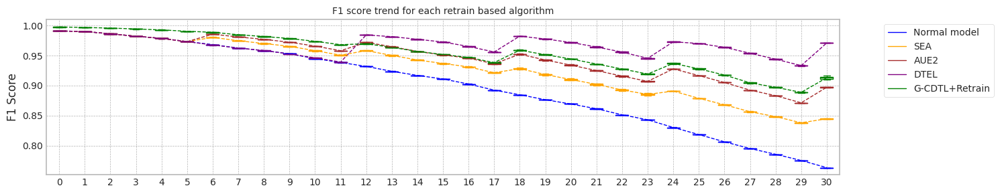

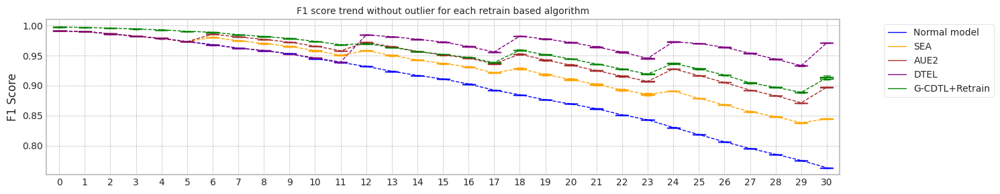

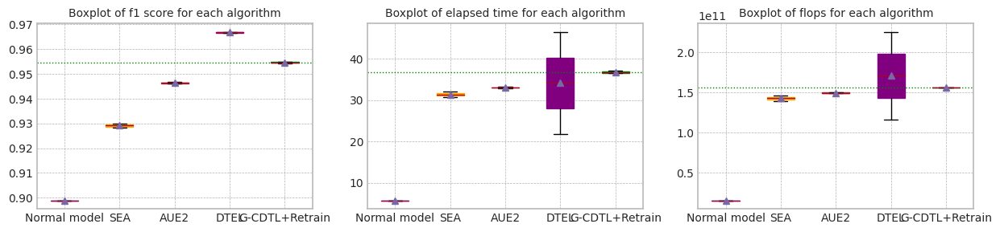

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.898917,0.763348,5.760796,1.566000e+10,121365000.0,1.578136e+10
1,1.0,0.990892,0.989878,0.898910,0.763359,5.778158,1.566000e+10,121365000.0,1.578136e+10
2,median,0.990989,0.989975,0.898913,0.763353,5.769477,1.566000e+10,121365000.0,1.578136e+10
3,std,0.000138,0.000138,0.000005,0.000008,0.012277,0.000000e+00,0.0,0.000000e+00


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.998098,0.997150,0.926870,0.802223,5.972365,7.866000e+10,609615000.0,7.926962e+10
1,1.0,0.997149,0.996297,0.925937,0.796987,5.932674,7.866000e+10,609615000.0,7.926962e+10
2,median,0.997624,0.996724,0.926403,0.799605,5.952519,7.866000e+10,609615000.0,7.926962e+10
3,std,0.000672,0.000604,0.000660,0.003702,0.028066,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.929897,0.844454,32.141756,7.306173e+10,7.356285e+10,1.466246e+11
1,1.0,0.990892,0.989878,0.928379,0.845028,30.620645,6.930724e+10,6.980836e+10,1.391156e+11
2,median,0.990989,0.989975,0.929138,0.844741,31.381200,7.118449e+10,7.168561e+10,1.428701e+11
3,std,0.000138,0.000138,0.001073,0.000406,1.075588,2.654822e+09,2.654822e+09,5.309644e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.946683,0.896951,32.879944,7.487829e+10,7.550948e+10,1.503878e+11
1,1.0,0.990892,0.989878,0.946106,0.897650,33.191331,7.418534e+10,7.481652e+10,1.490019e+11
2,median,0.990989,0.989975,0.946394,0.897300,33.035637,7.453181e+10,7.516300e+10,1.496948e+11
3,std,0.000138,0.000138,0.000408,0.000494,0.220184,4.899932e+08,4.899932e+08,9.799864e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991087,0.990073,0.966603,0.971137,46.487815,1.044992e+11,1.211423e+11,2.256415e+11
1,1.0,0.990892,0.989878,0.966978,0.970793,21.718919,4.968918e+10,6.633228e+10,1.160215e+11
2,median,0.990989,0.989975,0.966790,0.970965,34.103367,7.709418e+10,9.373728e+10,1.708315e+11
3,std,0.000138,0.000138,0.000265,0.000243,17.514255,3.875652e+10,3.875652e+10,7.751305e+10


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.998098,0.997150,0.954946,0.916533,36.434407,1.534657e+11,2.659145e+09,1.561248e+11
1,1.0,0.997149,0.996297,0.954331,0.909639,37.180578,1.535050e+11,2.659145e+09,1.561641e+11
2,median,0.997624,0.996724,0.954639,0.913086,36.807492,1.534853e+11,2.659145e+09,1.561445e+11
3,std,0.000672,0.000604,0.000435,0.004875,0.527622,2.781051e+07,0.000000e+00,2.781051e+07


In [ ]:

org_df_rt = {}
gcd_df_rt = {}
sea_df_rt = {}
aue_df_rt = {}
dte_df_rt = {}
gea_df_rt = {}


orgf_df_rt = {}
gcdf_df_rt = {}
seaf_df_rt = {}
auef_df_rt = {}
dtef_df_rt = {}
geaf_df_rt = {}

test_f1_score = []

for RT in range(1,6):
    org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(4000,'case2',X1, Y1,train_size, test_size,avaible_range = 300,
                                                                lambda_f2=0.8,trial_count=2,lr_g=0.001,retrain_count=RT,weight_init=True)
    test_f1_score = org_df['Testset F1']
    org_df_rt[f'{RT}'] = org_df['Mean F1']
    gcd_df_rt[f'{RT}'] = gcd_df['Mean F1']
    sea_df_rt[f'{RT}'] = sea_df['Mean F1']
    aue_df_rt[f'{RT}'] = aue_df['Mean F1']
    dte_df_rt[f'{RT}'] = dte_df['Mean F1']
    gea_df_rt[f'{RT}'] = gea_df['Mean F1']

    orgf_df_rt[f'{RT}'] = org_df['Train flops']
    gcdf_df_rt[f'{RT}'] = gcd_df['Train flops']
    seaf_df_rt[f'{RT}'] = sea_df['Train flops']
    auef_df_rt[f'{RT}'] = aue_df['Train flops']
    dtef_df_rt[f'{RT}'] = dte_df['Train flops']
    geaf_df_rt[f'{RT}'] = gea_df['Train flops']

trial_count: 20
lambda_f2 0.8
######################### Trial 0 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 597.21it/s]


Test f1 score: 0.9909926993457855
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.86it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989694761955246
######################### Trial 0 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 227.98it/s]


Test f1 score: 0.9979091427485269
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.85it/s]


mean of drift:
x0    0.129882
x1    0.043427
x2    0.038545
x3    0.393333
z0    0.092746
dtype: float64
Mean F1 for all data: 0.9365069669639685
Normal model median        : 0.8989694761955246
Drift tolerant model median: 0.9365069669639685
######################### Trial 1 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 598.62it/s]


Test f1 score: 0.9908952959028832
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.88it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8988516748917879
######################### Trial 1 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 228.52it/s]


Test f1 score: 0.9976238000190095
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.83it/s]


mean of drift:
x0    0.122487
x1    0.033434
x2    0.024208
x3    0.384455
z0    0.184348
dtype: float64
Mean F1 for all data: 0.9327213277347532
Normal model median        : 0.8989105755436562
Drift tolerant model median: 0.9346141473493609
######################### Trial 2 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 595.48it/s]


Test f1 score: 0.991088357982556
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.85it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8988026201698759
######################### Trial 2 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 228.48it/s]


Test f1 score: 0.9982886480319452
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.81it/s]


mean of drift:
x0    0.131523
x1    0.052778
x2    0.026731
x3    0.348362
z0    0.199323
dtype: float64
Mean F1 for all data: 0.9235684662060383
Normal model median        : 0.8988516748917879
Drift tolerant model median: 0.9327213277347532
######################### Trial 3 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 579.88it/s]


Test f1 score: 0.990990990990991
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.78it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.898718747043126
######################### Trial 3 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 226.14it/s]


Test f1 score: 0.9979091427485269
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.74it/s]


mean of drift:
x0    0.145527
x1    0.038932
x2    0.025735
x3    0.354358
z0    0.258799
dtype: float64
Mean F1 for all data: 0.9325582646613076
Normal model median        : 0.8988271475308318
Drift tolerant model median: 0.9326397961980304
######################### Trial 4 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 594.37it/s]


Test f1 score: 0.9910849772382397
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.87it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8988600370824412
######################### Trial 4 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 226.08it/s]


Test f1 score: 0.9973389089526706
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.82it/s]


mean of drift:
x0    0.147957
x1    0.079846
x2    0.044097
x3    0.392358
z0    0.224036
dtype: float64
Mean F1 for all data: 0.9247858457724495
Normal model median        : 0.8988516748917879
Drift tolerant model median: 0.9325582646613076
######################### Trial 5 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 590.57it/s]


Test f1 score: 0.990990990990991
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.77it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989404345280869
######################### Trial 5 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 226.40it/s]


Test f1 score: 0.998288322556105
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.72it/s]


mean of drift:
x0    0.133591
x1    0.043577
x2    0.044341
x3    0.356229
z0    0.299394
dtype: float64
Mean F1 for all data: 0.9254079077560518
Normal model median        : 0.8988558559871145
Drift tolerant model median: 0.9289830862086796
######################### Trial 6 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 576.16it/s]


Test f1 score: 0.9912779673871825
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.80it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989271725529969
######################### Trial 6 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 228.58it/s]


Test f1 score: 0.9977194982896237
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.80it/s]


mean of drift:
x0    0.159828
x1    0.044896
x2    0.033039
x3    0.026229
z0    0.182520
dtype: float64
Mean F1 for all data: 0.92846638390735
Normal model median        : 0.8988600370824412
Drift tolerant model median: 0.92846638390735
######################### Trial 7 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 592.46it/s]


Test f1 score: 0.991088357982556
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.80it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8988769197885723
######################### Trial 7 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 227.65it/s]


Test f1 score: 0.9978134803688564
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.74it/s]


mean of drift:
x0    0.119491
x1    0.042853
x2    0.328563
x3    0.044509
z0    0.166161
dtype: float64
Mean F1 for all data: 0.9391656623827289
Normal model median        : 0.8988684784355068
Drift tolerant model median: 0.9305123242843288
######################### Trial 8 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 597.90it/s]


Test f1 score: 0.991088357982556
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.75it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8988081724825099
######################### Trial 8 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 225.11it/s]


Test f1 score: 0.9974278365247213
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.83it/s]


mean of drift:
x0    0.088351
x1    0.088785
x2    0.020548
x3    0.020308
z0    0.247065
dtype: float64
Mean F1 for all data: 0.9184995061619875
Normal model median        : 0.8988600370824412
Drift tolerant model median: 0.92846638390735
######################### Trial 9 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 591.70it/s]


Test f1 score: 0.9910866679309691
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.76it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8988895462608276
######################### Trial 9 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 225.56it/s]


Test f1 score: 0.998101025446259
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.74it/s]


mean of drift:
x0    0.096692
x1    0.044176
x2    0.021778
x3    0.334061
z0    0.108538
dtype: float64
Mean F1 for all data: 0.9399895451794594
Normal model median        : 0.8988684784355068
Drift tolerant model median: 0.9305123242843288
######################### Trial 10 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 591.22it/s]


Test f1 score: 0.9910866679309691
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.79it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8989171036382408
######################### Trial 10 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 226.90it/s]


Test f1 score: 0.9979095400988217
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.80it/s]


mean of drift:
x0    0.107817
x1    0.043158
x2    0.022244
x3    0.360315
z0    0.086785
dtype: float64
Mean F1 for all data: 0.9244060988403509
Normal model median        : 0.8988769197885723
Drift tolerant model median: 0.92846638390735
######################### Trial 11 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 590.03it/s]


Test f1 score: 0.991088357982556
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.80it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8993058454877978
######################### Trial 11 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 220.92it/s]


Test f1 score: 0.9983841840129266
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.74it/s]


mean of drift:
x0    0.147763
x1    0.032853
x2    0.309090
x3    0.287914
z0    0.156563
dtype: float64
Mean F1 for all data: 0.9333281267009306
Normal model median        : 0.8988832330247
Drift tolerant model median: 0.9305123242843288
######################### Trial 12 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 584.79it/s]


Test f1 score: 0.991088357982556
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.71it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8987632717723844
######################### Trial 12 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 228.50it/s]


Test f1 score: 0.9977194982896237
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.76it/s]


mean of drift:
x0    0.145903
x1    0.058939
x2    0.357427
x3    0.071297
z0    0.122039
dtype: float64
Mean F1 for all data: 0.9312986461814515
Normal model median        : 0.8988769197885723
Drift tolerant model median: 0.9312986461814515
######################### Trial 13 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 598.89it/s]


Test f1 score: 0.9909875723365904
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.78it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.898975235041698
######################### Trial 13 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 228.67it/s]


Test f1 score: 0.997814311508125
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.81it/s]


mean of drift:
x0    0.128677
x1    0.026039
x2    0.289029
x3    0.313258
z0    0.138473
dtype: float64
Mean F1 for all data: 0.9343414057017149
Normal model median        : 0.8988832330247
Drift tolerant model median: 0.9319284554213796
######################### Trial 14 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 589.49it/s]


Test f1 score: 0.9911823267279796
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.76it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8988988673116259
######################### Trial 14 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 229.76it/s]


Test f1 score: 0.9975294564804258
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.82it/s]


mean of drift:
x0    0.141018
x1    0.056050
x2    0.061599
x3    0.379391
z0    0.076301
dtype: float64
Mean F1 for all data: 0.918266665117555
Normal model median        : 0.8988895462608276
Drift tolerant model median: 0.9312986461814515
######################### Trial 15 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 597.71it/s]


Test f1 score: 0.9911823267279796
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.60it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8987703597124719
######################### Trial 15 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 227.54it/s]


Test f1 score: 0.9980984978132725
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.77it/s]


mean of drift:
x0    0.093692
x1    0.026663
x2    0.277982
x3    0.337882
z0    0.270523
dtype: float64
Mean F1 for all data: 0.9256396471588257
Normal model median        : 0.8988832330247
Drift tolerant model median: 0.9298825150444008
######################### Trial 16 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 597.17it/s]


Test f1 score: 0.9909021986353299
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.79it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8987268677149437
######################### Trial 16 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 229.26it/s]


Test f1 score: 0.9981930575368521
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.78it/s]


mean of drift:
x0    0.105538
x1    0.043330
x2    0.036172
x3    0.380082
z0    0.165688
dtype: float64
Mean F1 for all data: 0.9313628406689397
Normal model median        : 0.8988769197885723
Drift tolerant model median: 0.9312986461814515
######################### Trial 17 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 596.09it/s]


Test f1 score: 0.9910866679309691
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.80it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.898898877885459
######################### Trial 17 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 227.03it/s]


Test f1 score: 0.9982889733840304
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.76it/s]


mean of drift:
x0    0.127541
x1    0.068724
x2    0.026344
x3    0.403882
z0    0.195516
dtype: float64
Mean F1 for all data: 0.9339459684364046
Normal model median        : 0.8988832330247
Drift tolerant model median: 0.9313307434251956
######################### Trial 18 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 598.31it/s]


Test f1 score: 0.9910917361637605
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.77it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8991271023394198
######################### Trial 18 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 231.04it/s]


Test f1 score: 0.9969523809523809
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.77it/s]


mean of drift:
x0    0.101384
x1    0.040416
x2    0.312538
x3    0.012552
z0    0.176631
dtype: float64
Mean F1 for all data: 0.9255714527474693
Normal model median        : 0.8988895462608276
Drift tolerant model median: 0.9312986461814515
######################### Trial 19 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 594.36it/s]


Test f1 score: 0.990990990990991
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.79it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8994535984712795
######################### Trial 19 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 227.27it/s]


Test f1 score: 0.9976260564048999
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.76it/s]


mean of drift:
x0    0.116061
x1    0.042380
x2    0.029161
x3    0.344100
z0    0.187889
dtype: float64
Mean F1 for all data: 0.9328805265587008
Normal model median        : 0.8988942067862268
Drift tolerant model median: 0.9313307434251956
######################### Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.66it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9159249616768138
SEA median: 0.9159249616768138
######################### Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.22it/s]


Early stop at  2414.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9408885659154219
AUE median: 0.9408885659154219
######################### Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.86it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9514370158785049
DTEL median: 0.9514370158785049
######################### Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:10<00:00,  2.89it/s]


Early stop at  3307.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9291007898393994
SEA median: 0.9225128757581066
######################### Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.82it/s]


Early stop at  3368.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9413434007731243
AUE median: 0.941115983344273
######################### Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.83it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9515943978889301
DTEL median: 0.9515157068837174
######################### Trial 2 for Normal model ###########################
retrain_interval: 16
######################### Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.62it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9148733752306726
SEA median: 0.9159249616768138
######################### Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.72it/s]


Early stop at  3440.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9409155426765505
AUE median: 0.9409155426765505
######################### Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.86it/s]


Early stop at  3807.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9513344434940597
DTEL median: 0.9514370158785049
######################### Trial 3 for Normal model ###########################
retrain_interval: 16
######################### Trial 3 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.77it/s]


Early stop at  3552.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9283816133073133
SEA median: 0.9221532874920635
######################### Trial 3 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:10<00:00,  2.94it/s]


Early stop at  3015.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9405426785272643
AUE median: 0.9409020542959863
######################### Trial 3 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.93it/s]


Early stop at  3400.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9515054986267537
DTEL median: 0.9514712572526294
######################### Trial 4 for Normal model ###########################
retrain_interval: 16
######################### Trial 4 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.59it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9293831793955326
SEA median: 0.9283816133073133
######################### Trial 4 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.67it/s]


Early stop at  3698.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.940887168862507
AUE median: 0.9408885659154219
######################### Trial 4 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:15<00:00,  2.04it/s]


Early stop at  2668.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9514429562398962
DTEL median: 0.9514429562398962
######################### Trial 5 for Normal model ###########################
retrain_interval: 16
######################### Trial 5 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.71it/s]


Early stop at  3770.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9279435284891389
SEA median: 0.9281625708982261
######################### Trial 5 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.61it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9412931864719167
AUE median: 0.9409020542959863
######################### Trial 5 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.85it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9515981783200632
DTEL median: 0.951474227433325
######################### Trial 6 for Normal model ###########################
retrain_interval: 16
######################### Trial 6 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:10<00:00,  2.86it/s]


Early stop at  3455.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9131975284166061
SEA median: 0.9279435284891389
######################### Trial 6 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.65it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9411619222600777
AUE median: 0.9409155426765505
######################### Trial 6 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.86it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.951595133943698
DTEL median: 0.9515054986267537
######################### Trial 7 for Normal model ###########################
retrain_interval: 16
######################### Trial 7 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.67it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9163234322697951
SEA median: 0.922133480379467
######################### Trial 7 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.66it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9408465959384393
AUE median: 0.9409020542959863
######################### Trial 7 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.85it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.951561410711548
DTEL median: 0.9515334546691508
######################### Trial 8 for Normal model ###########################
retrain_interval: 16
######################### Trial 8 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.68it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9331424366410738
SEA median: 0.9279435284891389
######################### Trial 8 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:10<00:00,  2.82it/s]


Early stop at  3434.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9415134028134658
AUE median: 0.9409155426765505
######################### Trial 8 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.86it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9511992786454815
DTEL median: 0.9515054986267537
######################### Trial 9 for Normal model ###########################
retrain_interval: 16
######################### Trial 9 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.65it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9344961725885051
SEA median: 0.9281625708982261
######################### Trial 9 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.73it/s]


Early stop at  3702.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9408975621517739
AUE median: 0.9409065524141622
######################### Trial 9 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:15<00:00,  1.94it/s]


Early stop at  3279.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.951516803628743
DTEL median: 0.9515111511277483
######################### Trial 10 for Normal model ###########################
retrain_interval: 16
######################### Trial 10 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.61it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9278799905615106
SEA median: 0.9279435284891389
######################### Trial 10 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.76it/s]


Early stop at  3479.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9415833477191445
AUE median: 0.9409155426765505
######################### Trial 10 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.93it/s]


Early stop at  3454.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9514667008020643
DTEL median: 0.9515054986267537
######################### Trial 11 for Normal model ###########################
retrain_interval: 16
######################### Trial 11 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.70it/s]


Early stop at  3796.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.926611359982745
SEA median: 0.9279117595253248
######################### Trial 11 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.65it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9410359601710935
AUE median: 0.940975751423822
######################### Trial 11 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:17<00:00,  1.81it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9514357163433457
DTEL median: 0.951486099714409
######################### Trial 12 for Normal model ###########################
retrain_interval: 16
######################### Trial 12 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:10<00:00,  2.84it/s]


Early stop at  3424.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9270042359325402
SEA median: 0.9278799905615106
######################### Trial 12 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.70it/s]


Early stop at  3774.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9408086155134641
AUE median: 0.9409155426765505
######################### Trial 12 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.83it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9511876863559592
DTEL median: 0.9514667008020643
######################### Trial 13 for Normal model ###########################
retrain_interval: 16
######################### Trial 13 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.64it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9278387463027811
SEA median: 0.9278593684321459
######################### Trial 13 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:10<00:00,  2.86it/s]


Early stop at  3363.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9415189238688901
AUE median: 0.940975751423822
######################### Trial 13 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:17<00:00,  1.82it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9515803393230098
DTEL median: 0.951486099714409
######################### Trial 14 for Normal model ###########################
retrain_interval: 16
######################### Trial 14 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.61it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9277759991207103
SEA median: 0.9278387463027811
######################### Trial 14 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.74it/s]


Early stop at  3580.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9412709929837361
AUE median: 0.9410359601710935
######################### Trial 14 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:17<00:00,  1.82it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9514915469960961
DTEL median: 0.9514915469960961
######################### Trial 15 for Normal model ###########################
retrain_interval: 16
######################### Trial 15 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.68it/s]


Early stop at  3801.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9247042225490201
SEA median: 0.9278073727117457
######################### Trial 15 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.73it/s]


Early stop at  3580.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9405252704158387
AUE median: 0.940975751423822
######################### Trial 15 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.84it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9515272336996317
DTEL median: 0.9514985228114249
######################### Trial 16 for Normal model ###########################
retrain_interval: 16
######################### Trial 16 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.63it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9291686205078464
SEA median: 0.9278387463027811
######################### Trial 16 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:10<00:00,  3.01it/s]


Early stop at  2923.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9403728225639266
AUE median: 0.9409155426765505
######################### Trial 16 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.90it/s]


Early stop at  3809.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9512321731745169
DTEL median: 0.9514915469960961
######################### Trial 17 for Normal model ###########################
retrain_interval: 16
######################### Trial 17 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.64it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9276050423189838
SEA median: 0.9278073727117457
######################### Trial 17 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.79it/s]


Early stop at  3571.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9409407894046307
AUE median: 0.9409281660405906
######################### Trial 17 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.86it/s]


Early stop at  3839.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9515527361793651
DTEL median: 0.9514985228114249
######################### Trial 18 for Normal model ###########################
retrain_interval: 16
######################### Trial 18 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:12<00:00,  2.58it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9268826327668169
SEA median: 0.9277759991207103
######################### Trial 18 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.54it/s]


Early stop at  310.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8974885206230107
AUE median: 0.9409155426765505
######################### Trial 18 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.87it/s]


Early stop at  3855.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.951284113095136
DTEL median: 0.9514915469960961
######################### Trial 19 for Normal model ###########################
retrain_interval: 16
######################### Trial 19 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.64it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9337950332720122
SEA median: 0.9278073727117457
######################### Trial 19 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:10<00:00,  3.06it/s]


Early stop at  2728.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.9413236960307899
AUE median: 0.9409281660405906
######################### Trial 19 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:15<00:00,  1.96it/s]


Early stop at  3153.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.015151
dtype: float64
Mean F1 for all data: 0.951351519581105
DTEL median: 0.9514791238990802


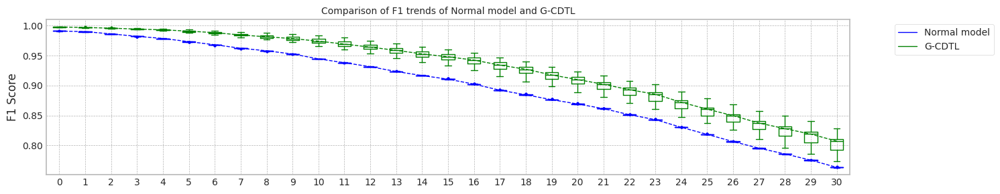

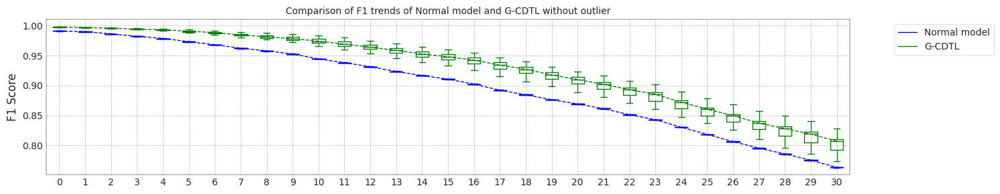

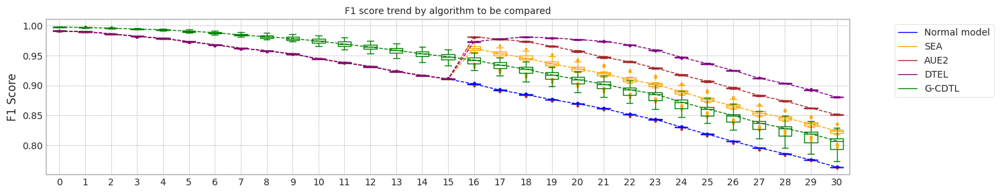

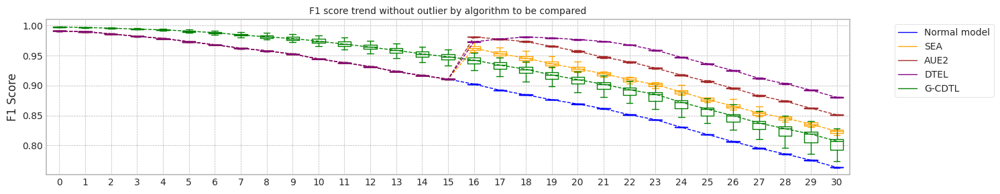

max_mean_trial= 9


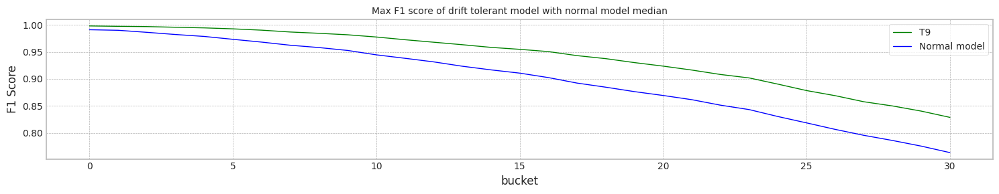

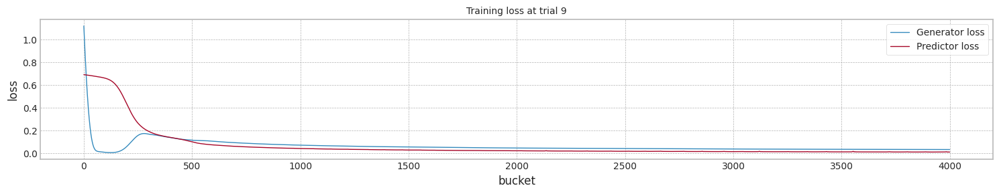

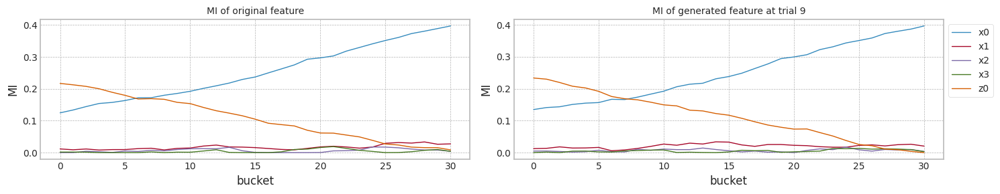

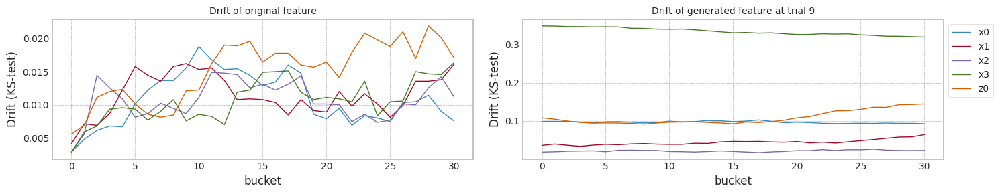

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.990993,0.989979,0.898969,0.763477,6.429227
1,1.0,0.990895,0.990073,0.898852,0.763427,6.402556
2,2.0,0.991088,0.990168,0.898803,0.763477,6.440051
3,3.0,0.990991,0.990073,0.898719,0.763238,6.538533
4,4.0,0.991085,0.990260,0.898860,0.763477,6.422551
5,5.0,0.990991,0.989977,0.898940,0.763348,6.540163
6,6.0,0.991278,0.989597,0.898927,0.763975,6.507426
7,7.0,0.991088,0.990168,0.898877,0.763636,6.513703
8,8.0,0.991088,0.990075,0.898808,0.763128,6.584319
9,9.0,0.991087,0.990073,0.898890,0.763427,6.570925


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.990993,0.989979,0.915925,0.801715,11.693596
1,1.0,0.990895,0.990073,0.929101,0.826569,10.778405
2,2.0,0.991088,0.990168,0.914873,0.799832,11.866280
3,3.0,0.990991,0.990073,0.928382,0.824342,11.248738
4,4.0,0.991085,0.990260,0.929383,0.825988,12.002006
5,5.0,0.990991,0.989977,0.927944,0.823682,11.486980
6,6.0,0.991278,0.989597,0.913198,0.796238,10.892370
7,7.0,0.991088,0.990168,0.916323,0.802798,11.668284
8,8.0,0.991088,0.990075,0.933142,0.834881,11.623973
9,9.0,0.991087,0.990073,0.934496,0.835987,11.745314


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.990993,0.989979,0.940889,0.850907,9.693094
1,1.0,0.990895,0.990073,0.941343,0.852053,11.059185
2,2.0,0.991088,0.990168,0.940916,0.851221,11.443786
3,3.0,0.990991,0.990073,0.940543,0.850976,10.582221
4,4.0,0.991085,0.990260,0.940887,0.851096,11.664737
5,5.0,0.990991,0.989977,0.941293,0.851775,11.932378
6,6.0,0.991278,0.989597,0.941162,0.851804,11.737344
7,7.0,0.991088,0.990168,0.940847,0.850690,11.706317
8,8.0,0.991088,0.990075,0.941513,0.852420,11.030827
9,9.0,0.991087,0.990073,0.940898,0.850852,11.412768


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.990993,0.989979,0.951437,0.880097,16.682413
1,1.0,0.990895,0.990073,0.951594,0.881026,17.006415
2,2.0,0.991088,0.990168,0.951334,0.880080,16.724368
3,3.0,0.990991,0.990073,0.951505,0.880637,16.101063
4,4.0,0.991085,0.990260,0.951443,0.880884,15.231090
5,5.0,0.990991,0.989977,0.951598,0.880787,16.786301
6,6.0,0.991278,0.989597,0.951595,0.881431,16.719945
7,7.0,0.991088,0.990168,0.951561,0.880813,16.831690
8,8.0,0.991088,0.990075,0.951199,0.880053,16.740509
9,9.0,0.991087,0.990073,0.951517,0.880442,16.040136


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.997909,0.996866,0.936507,0.817214,6.439544
1,1.0,0.997624,0.996867,0.932721,0.809491,6.471289
2,2.0,0.998289,0.997149,0.923568,0.793426,6.487424
3,3.0,0.997909,0.996772,0.932558,0.806274,6.590342
4,4.0,0.997339,0.996486,0.924786,0.787995,6.480243
5,5.0,0.998288,0.996959,0.925408,0.792322,6.619289
6,6.0,0.997719,0.997248,0.928466,0.805299,6.508184
7,7.0,0.997813,0.997057,0.939166,0.816882,6.593527
8,8.0,0.997428,0.996190,0.918500,0.773502,6.462529
9,9.0,0.998101,0.997439,0.939990,0.828737,6.585831


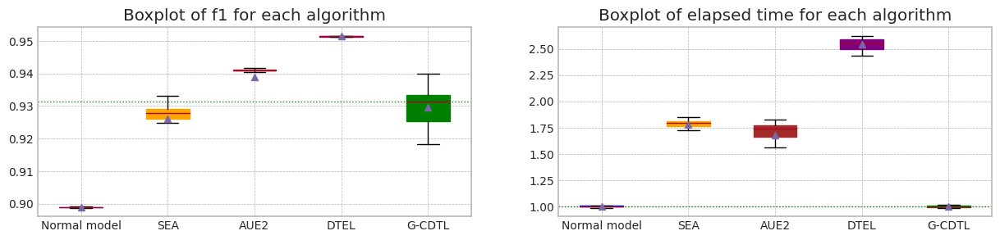

In [ ]:
_,_,_,_,_,_ = drift_tolerant2('case2',X1, Y1,train_size, test_size,avaible_range = 300,lambda_f2=0.8,trial_count=20,weight_init=True)

## synthetic data의 생성 (Case #3 MI의 증감(상대적), Drift의 증가)

+ $P_t(y,X) \ne P_{t+w}(y,X) $ 이고 $P_t(y|X) \ne P_{t+w}(y|X) $
+ Real concept drift
+ 즉, P(y|X)와 P(X)의 변화가 연관되어 나타남.
+ 이때 대상 feature $z_0$에 대해서 MI 증가, ks-test 통계량 증가
+ 이에따라 $X_0$의 MI 감소

+ 5개의 feature
+ 각각 importance를 부여
+ 그 중, 1개의 feature는 가변 data drift, MI는 고정

### Dataset 준비

In [50]:
import matplotlib.pyplot as plt

cor = np.asarray([2.5, 1.2, 0.9 , 0.7, 1.5])

seed_everything()

x1 = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    x1[:,ix] = np.random.normal(1,cor_,data_size)

seed_everything()

y1_array = []
cor_const = cor[0]
for ii in range(x1.shape[0]):
    cor[0] = cor[0] - cor_const / x1.shape[0]
    e = np.random.normal(0.0, 1.0)
    e1 = np.random.normal(0.0,  4*ii/40000)
    x1[ii,4] = x1[ii,4] + e1
    y1_array.append(np.sum(cor * x1[ii])+e)

In [51]:
m = np.mean(y1_array)
print(m)
y1 = [1 if y_ > m else 0 for y_ in y1_array]
sum(y1)

5.563076837122426


19931

### 실험

MI Analysis MI Max 0.21053, Min 0.00413, Mean 0.06759, Std 0.07940
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (39000, 5)
Truncate 8000 rows from live_set (39000, 5)
Search MI & Drift...for X_live_set (31, 9000, 5)


100%|██████████| 31/31 [00:06<00:00,  5.01it/s]


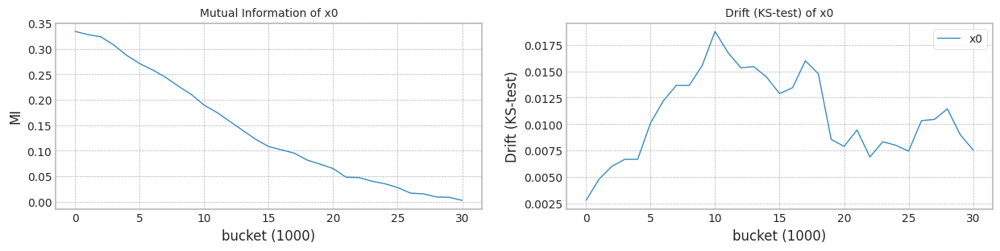

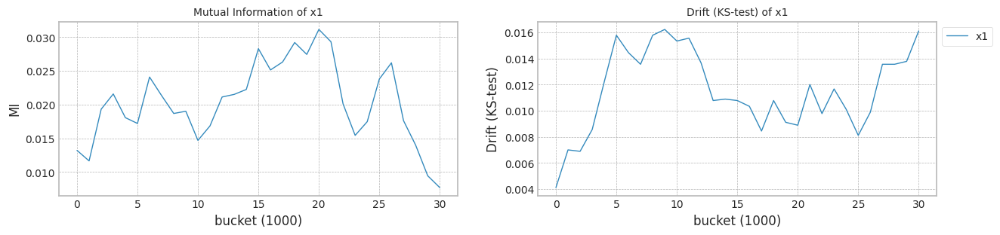

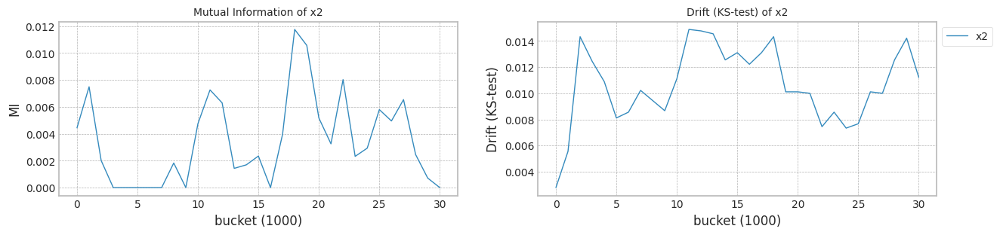

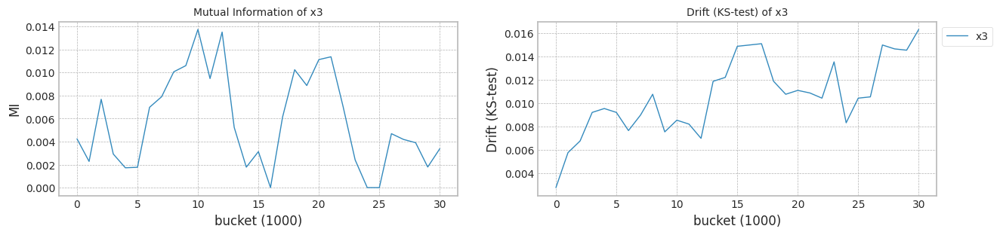

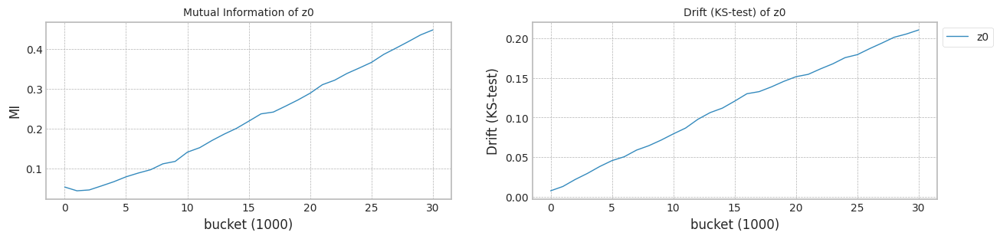

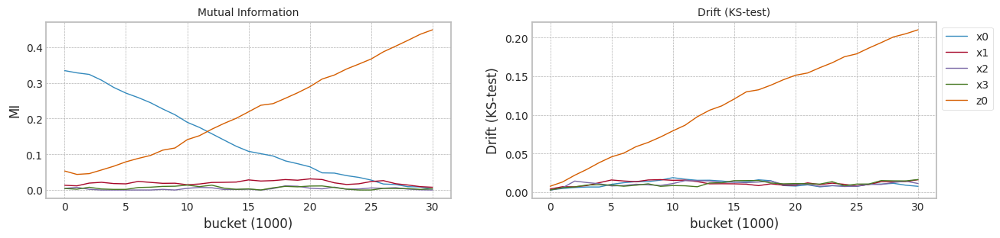

In [52]:
columns=['x0','x1','x2','x3','z0']
X1 = pd.DataFrame(x1,columns=columns)

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X1, y1,train_size, test_size)

In [53]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.525799,0.497734,0.329063,0.549493,0.348766,0
1,0.610533,0.420412,0.508390,0.580336,0.603602,0
2,0.556874,0.464734,0.669603,0.724770,0.452177,0
3,0.344341,0.646524,0.340976,0.528780,0.559737,0
4,0.503142,0.550860,0.598773,0.465698,0.452611,0
...,...,...,...,...,...,...
39995,0.333622,0.399822,0.303105,0.605408,0.612303,39
39996,0.358451,0.483875,0.341855,0.574439,0.395651,39
39997,0.559469,0.343824,0.542547,0.575250,0.268402,39
39998,0.433692,0.530132,0.301231,0.282353,0.347175,39


trial_count: 2
Lambda :  0.9
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-27 12:23:13,561] [INFO] [profiler.py:80:start_profile] Flops profiler started


 40%|███▉      | 793/2000 [00:01<00:02, 449.38it/s]

Early stop: 793
[2023-11-27 12:23:15,335] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3108510000
precision_recall_fscore: (array([0.94556093, 0.94653778]), array([0.93204614, 0.95730247]), array([0.93875489, 0.95188969]), array([3988, 5012]))
Test f1 score: 0.9518896934827894
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.02it/s]

mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8749986026078479
inference_flops: 121365000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-27 12:23:21,579] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:23:21,581] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▍       | 480/2000 [00:03<00:10, 149.53it/s]

[2023-11-27 12:23:34,147] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:23:34,148] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7575750000 1883115000 40958865000
precision_recall_fscore: (array([0.95923198, 0.93439785]), array([0.91449348, 0.96907422]), array([0.93632863, 0.95142018]), array([3988, 5012]))
Test f1 score: 0.9514201762977473
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.94it/s]

mean of drift:
x0    0.287380
x1    0.019036
x2    0.126269
x3    0.020197
z0    0.240989
dtype: float64
Mean F1 for all data: 0.9042429000768566
inference_flops: 609615000
Normal model median        : 0.8749986026078479
Drift tolerant model median: 0.9042429000768566
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-27 12:23:40,487] [INFO] [profiler.py:80:start_profile] Flops profiler started



 46%|████▋     | 926/2000 [00:02<00:02, 454.18it/s]

Early stop: 926
[2023-11-27 12:23:42,534] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3629205000
precision_recall_fscore: (array([0.94419077, 0.94741004]), array([0.9332999 , 0.95610535]), array([0.93871375, 0.95173784]), array([3988, 5012]))
Test f1 score: 0.9517378351539226
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.12it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8749458306463941
inference_flops: 121365000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-27 12:23:48,657] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:23:48,659] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 26%|██▌       | 514/2000 [00:03<00:09, 150.33it/s]

[2023-11-27 12:23:57,314] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:23:57,315] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 17797500000 8111250000 2016225000 27924975000
precision_recall_fscore: (array([0.93223263, 0.95851882]), array([0.94859579, 0.94513168]), array([0.94034303, 0.95177818]), array([3988, 5012]))
Test f1 score: 0.951778179626281
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.14it/s]


mean of drift:
x0    0.292961
x1    0.110806
x2    0.275459
x3    0.050462
z0    0.248953
dtype: float64
Mean F1 for all data: 0.9019438258097126
inference_flops: 609615000
Normal model median        : 0.874972216627121
Drift tolerant model median: 0.9030933629432846
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.80it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-27 12:24:06,720] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:24:06,722] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 12:24:09,076] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:24:09,077] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:05<00:13,  1.09it/s]

G-CDTL train flops: 68250000 595000000 147900000 811150000


100%|██████████| 31/31 [00:08<00:00,  3.61it/s]


Early stop at  [339]
Train flops  [811150000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.927382216772265
G_CDTL+AUE median: 0.927382216772265
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:04<00:07,  1.86it/s]

Ensemble_SEA train flops: 443265000


100%|██████████| 31/31 [00:07<00:00,  3.99it/s]


Early stop at  [1018]
Train flops  [443265000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8964232803640895
SEA median: 0.8964232803640895
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:04<00:06,  2.09it/s]

Ensemble_SEA train flops: 379755000


100%|██████████| 31/31 [00:07<00:00,  4.15it/s]


Early stop at  [872]
Train flops  [379755000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9103777188245126
AUE median: 0.9103777188245126
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.19it/s]

Ensemble_DTEL train flops: 473715000


 55%|█████▍    | 17/31 [00:08<00:18,  1.30s/it]

Ensemble_DTEL train flops: 773430000


100%|██████████| 31/31 [00:11<00:00,  2.74it/s]


Early stop at  [1088, 1777]
Train flops  [473715000, 773430000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9175373642419867
DTEL median: 0.9175373642419867
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.23it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-27 12:24:41,833] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:24:41,836] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 12:24:45,244] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:24:45,245] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 17/31 [00:06<00:12,  1.10it/s]

G-CDTL train flops: 57750000 920500000 228810000 1207060000


100%|██████████| 31/31 [00:09<00:00,  3.27it/s]


Early stop at  [525]
Train flops  [1207060000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.926761348038008
G_CDTL+AUE median: 0.9270717824051364
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:04<00:06,  2.18it/s]

Ensemble_SEA train flops: 361485000


100%|██████████| 31/31 [00:07<00:00,  4.29it/s]


Early stop at  [830]
Train flops  [361485000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8946638095234241
SEA median: 0.8955435449437568
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:04<00:08,  1.81it/s]

Ensemble_SEA train flops: 324945000


100%|██████████| 31/31 [00:07<00:00,  4.31it/s]


Early stop at  [746]
Train flops  [324945000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9103760276137011
AUE median: 0.9103768732191069
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.29it/s]

Ensemble_DTEL train flops: 387585000


 55%|█████▍    | 17/31 [00:06<00:10,  1.29it/s]

Ensemble_DTEL train flops: 379320000


100%|██████████| 31/31 [00:08<00:00,  3.56it/s]


Early stop at  [890, 871]
Train flops  [387585000, 379320000]
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9164643253067799
DTEL median: 0.9170008447743834


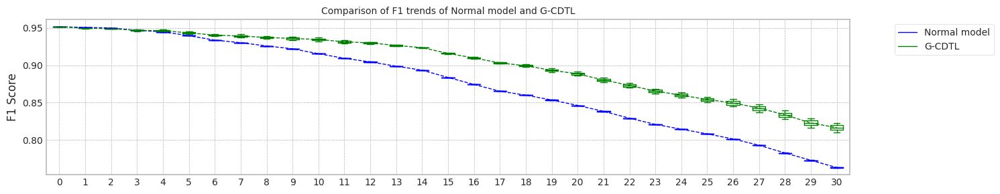

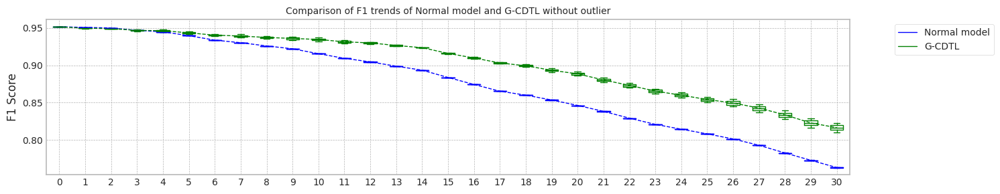

max_mean_trial= 0


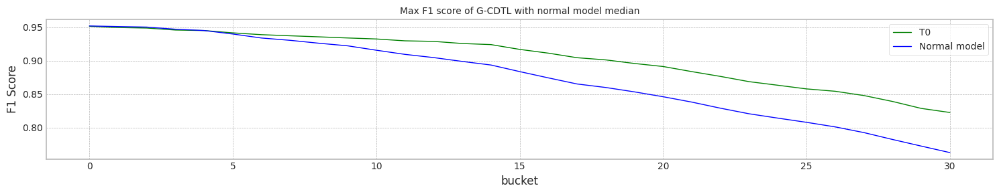

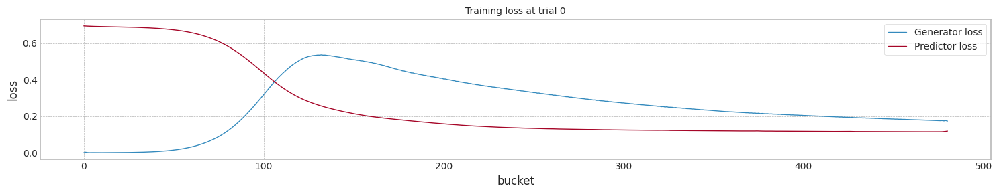

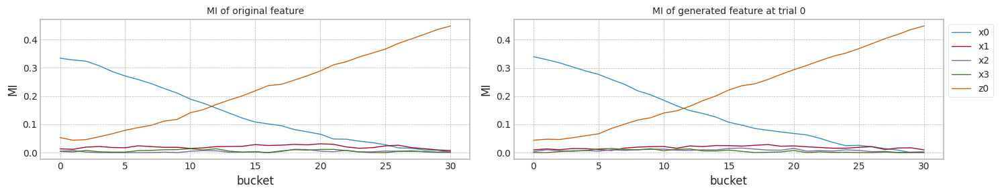

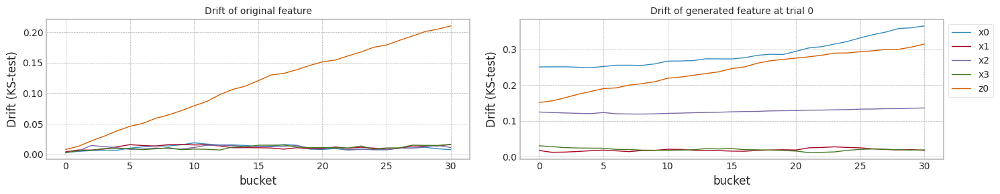

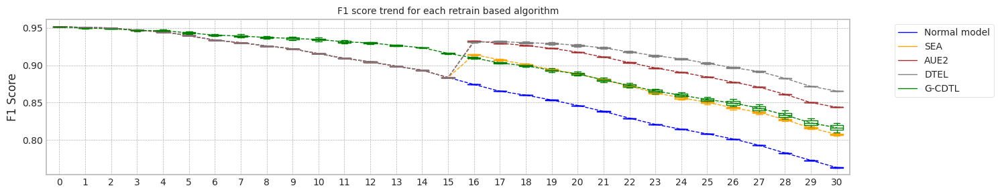

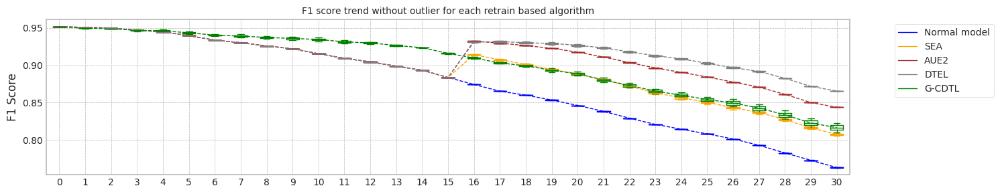

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.167856574058533
Base flops (inference flops of normal model, median): 121365000.0


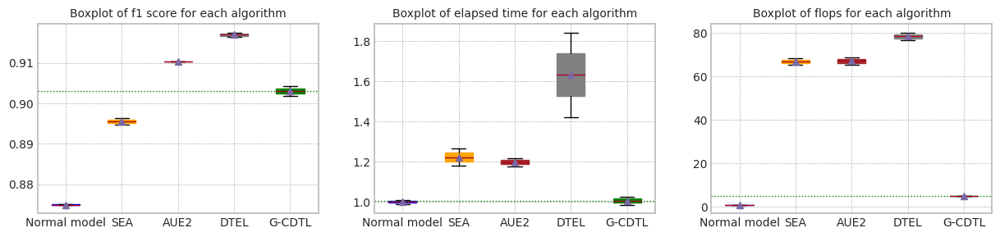

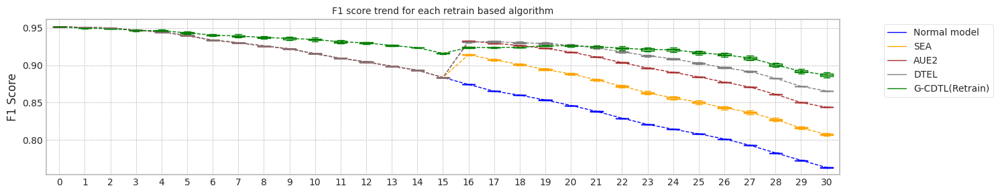

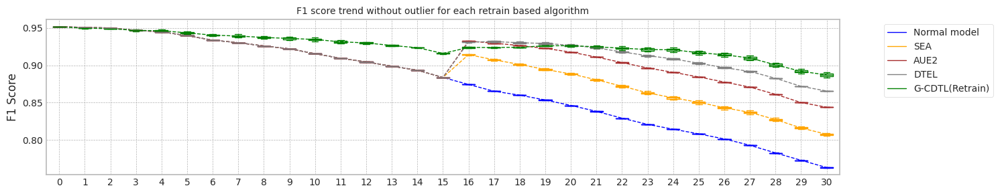

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.167856574058533
Base flops (train + inference flops of normal model, median): 3490222500.0


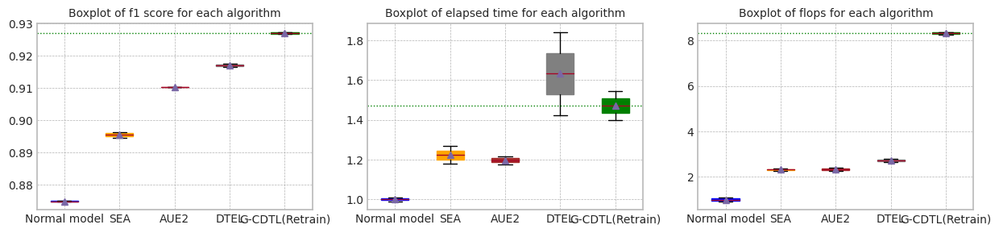

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.167856574058533


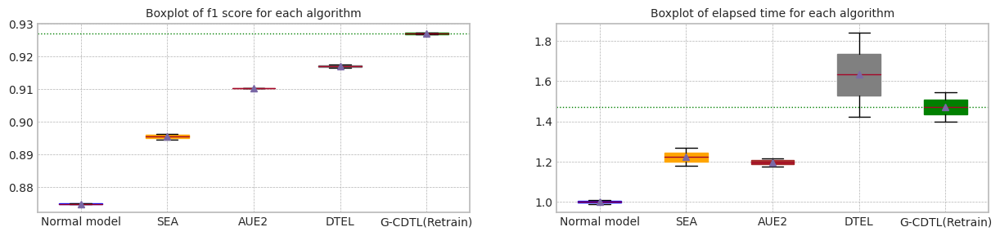

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.951890,0.951021,0.874999,0.762990,6.227387,3.108510e+09,121365000.0,3.229875e+09
1,1.0,0.951738,0.950774,0.874946,0.762693,6.108326,3.629205e+09,121365000.0,3.750570e+09
2,median,0.951814,0.950898,0.874972,0.762842,6.167857,3.368858e+09,121365000.0,3.490222e+09
3,std,0.000107,0.000175,0.000037,0.000210,0.084189,3.681870e+08,0.0,3.681870e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.951420,0.949465,0.904243,0.822693,6.320392,4.095886e+10,609615000.0,4.156848e+10
1,1.0,0.951778,0.950292,0.901944,0.810041,6.080831,2.792498e+10,609615000.0,2.853459e+10
2,median,0.951599,0.949879,0.903093,0.816367,6.200612,3.444192e+10,609615000.0,3.505154e+10
3,std,0.000253,0.000584,0.001626,0.008947,0.169396,9.216352e+09,0.0,9.216352e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.951890,0.951021,0.896423,0.809382,7.812562,4.072470e+09,3.857145e+09,7.929615e+09
1,1.0,0.951738,0.950774,0.894664,0.805536,7.265968,3.990690e+09,4.296060e+09,8.286750e+09
2,median,0.951814,0.950898,0.895544,0.807459,7.539265,4.031580e+09,4.076602e+09,8.108182e+09
3,std,0.000107,0.000175,0.001244,0.002719,0.386500,5.782719e+07,3.103598e+08,2.525326e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.951890,0.951021,0.910378,0.843703,7.511330,4.008960e+09,3.915000e+09,7.923960e+09
1,1.0,0.951738,0.950774,0.910376,0.843838,7.250880,3.954150e+09,4.380885e+09,8.335035e+09
2,median,0.951814,0.950898,0.910377,0.843770,7.381105,3.981555e+09,4.147942e+09,8.129498e+09
3,std,0.000107,0.000175,0.000001,0.000095,0.184166,3.875652e+07,3.294304e+08,2.906739e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.951890,0.951021,0.917537,0.865948,11.358228,4.876350e+09,4.845030e+09,9.721380e+09
1,1.0,0.951738,0.950774,0.916464,0.865173,8.769124,4.396110e+09,4.885485e+09,9.281595e+09
2,median,0.951814,0.950898,0.917001,0.865560,10.063676,4.636230e+09,4.865258e+09,9.501488e+09
3,std,0.000107,0.000175,0.000759,0.000548,1.830773,3.395810e+08,2.860600e+07,3.109750e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.951420,0.949465,0.927382,0.890893,8.630444,2.873612e+10,134325000.0,2.887045e+10
1,1.0,0.951778,0.950292,0.926761,0.883351,9.518189,2.913204e+10,134325000.0,2.926636e+10
2,median,0.951599,0.949879,0.927072,0.887122,9.074317,2.893408e+10,134325000.0,2.906840e+10
3,std,0.000253,0.000584,0.000439,0.005333,0.627731,2.799506e+08,0.0,2.799506e+08


In [54]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case3',X1, Y1,train_size, test_size,avaible_range = 300,
                                                            lambda_f2=0.9,trial_count=2,lr_g=0.002,
                                                            retrain_count=1,weight_init=True)


trial_count: 20
lambda_f2 0.8
######################### Trial 0 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 585.57it/s]


Test f1 score: 0.951813214108296
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.79it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8750341105531221
######################### Trial 0 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 224.54it/s]


Test f1 score: 0.9537267389790028
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.76it/s]


mean of drift:
x0    0.065272
x1    0.137534
x2    0.338251
x3    0.094183
z0    0.105419
dtype: float64
Mean F1 for all data: 0.8939720885034967
Normal model median        : 0.8750341105531221
Drift tolerant model median: 0.8939720885034967
######################### Trial 1 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 595.74it/s]


Test f1 score: 0.951813214108296
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.80it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8750719721833556
######################### Trial 1 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 225.07it/s]


Test f1 score: 0.9526939547853799
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.81it/s]


mean of drift:
x0    0.117563
x1    0.046968
x2    0.055892
x3    0.457090
z0    0.124057
dtype: float64
Mean F1 for all data: 0.8960197326909806
Normal model median        : 0.8750530413682389
Drift tolerant model median: 0.8949959105972387
######################### Trial 2 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 589.92it/s]


Test f1 score: 0.9518982309679984
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.83it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8748285410043974
######################### Trial 2 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 227.27it/s]


Test f1 score: 0.9530859257777333
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.86it/s]


mean of drift:
x0    0.044229
x1    0.017154
x2    0.017509
x3    0.504710
z0    0.104384
dtype: float64
Mean F1 for all data: 0.8965616766727671
Normal model median        : 0.8750341105531221
Drift tolerant model median: 0.8960197326909806
######################### Trial 3 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 591.42it/s]


Test f1 score: 0.952399880751267
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.63it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8749573813439233
######################### Trial 3 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 226.43it/s]


Test f1 score: 0.9532840886404472
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.81it/s]


mean of drift:
x0    0.073108
x1    0.014986
x2    0.015681
x3    0.114427
z0    0.116229
dtype: float64
Mean F1 for all data: 0.8987062406819523
Normal model median        : 0.8749957459485227
Drift tolerant model median: 0.8962907046818738
######################### Trial 4 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 593.22it/s]


Test f1 score: 0.9520969986086265
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.83it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8746834544364072
######################### Trial 4 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 226.75it/s]


Test f1 score: 0.9532152100338445
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.80it/s]


mean of drift:
x0    0.094384
x1    0.030079
x2    0.081541
x3    0.418763
z0    0.116882
dtype: float64
Mean F1 for all data: 0.9008774733936339
Normal model median        : 0.8749573813439233
Drift tolerant model median: 0.8965616766727671
######################### Trial 5 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 599.78it/s]


Test f1 score: 0.9506013318755591
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.81it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8744363029177237
######################### Trial 5 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 229.67it/s]


Test f1 score: 0.9541832669322708
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.78it/s]


mean of drift:
x0    0.064606
x1    0.055710
x2    0.018151
x3    0.429545
z0    0.105792
dtype: float64
Mean F1 for all data: 0.8915674042471949
Normal model median        : 0.8748929611741604
Drift tolerant model median: 0.8962907046818738
######################### Trial 6 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 590.62it/s]


Test f1 score: 0.951813214108296
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.80it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8750609239220203
######################### Trial 6 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 228.82it/s]


Test f1 score: 0.9531016628497461
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.83it/s]


mean of drift:
x0    0.032115
x1    0.027290
x2    0.018190
x3    0.432713
z0    0.116115
dtype: float64
Mean F1 for all data: 0.8980036558606851
Normal model median        : 0.8749573813439233
Drift tolerant model median: 0.8965616766727671
######################### Trial 7 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 594.86it/s]


Test f1 score: 0.951813214108296
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.75it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8750348264488694
######################### Trial 7 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 229.07it/s]


Test f1 score: 0.9530361950344003
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.78it/s]


mean of drift:
x0    0.110606
x1    0.053305
x2    0.355093
x3    0.082781
z0    0.105269
dtype: float64
Mean F1 for all data: 0.9004149293343514
Normal model median        : 0.8749957459485227
Drift tolerant model median: 0.8972826662667261
######################### Trial 8 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 602.84it/s]


Test f1 score: 0.9510183805265774
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.78it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8746542669743823
######################### Trial 8 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 227.48it/s]


Test f1 score: 0.952922401755436
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.62it/s]


mean of drift:
x0    0.200014
x1    0.104208
x2    0.089699
x3    0.079387
z0    0.071093
dtype: float64
Mean F1 for all data: 0.9014944254516171
Normal model median        : 0.8749573813439233
Drift tolerant model median: 0.8980036558606851
######################### Trial 9 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 594.65it/s]


Test f1 score: 0.951803637086356
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.79it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.875088523034331
######################### Trial 9 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 227.69it/s]


Test f1 score: 0.9525047495250476
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.85it/s]


mean of drift:
x0    0.041100
x1    0.027351
x2    0.050871
x3    0.464297
z0    0.107663
dtype: float64
Mean F1 for all data: 0.8965503978109918
Normal model median        : 0.8749957459485227
Drift tolerant model median: 0.8972826662667261
######################### Trial 10 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 590.22it/s]


Test f1 score: 0.9519928436537123
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.77it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8759075797352532
######################### Trial 10 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 225.96it/s]


Test f1 score: 0.9526662672258838
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.79it/s]


mean of drift:
x0    0.142839
x1    0.036921
x2    0.031613
x3    0.410470
z0    0.114695
dtype: float64
Mean F1 for all data: 0.9045006194166162
Normal model median        : 0.8750341105531221
Drift tolerant model median: 0.8980036558606851
######################### Trial 11 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 596.20it/s]


Test f1 score: 0.951813214108296
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.77it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8750719721833556
######################### Trial 11 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 227.17it/s]


Test f1 score: 0.9531625300240192
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.80it/s]


mean of drift:
x0    0.069366
x1    0.037308
x2    0.362437
x3    0.114889
z0    0.100961
dtype: float64
Mean F1 for all data: 0.9027638215468652
Normal model median        : 0.8750344685009958
Drift tolerant model median: 0.8983549482713187
######################### Trial 12 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 593.07it/s]


Test f1 score: 0.9525797793021175
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.77it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8752555835258026
######################### Trial 12 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 227.92it/s]


Test f1 score: 0.9535208458009177
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.74it/s]


mean of drift:
x0    0.041516
x1    0.058204
x2    0.370530
x3    0.191778
z0    0.104409
dtype: float64
Mean F1 for all data: 0.8963199601291691
Normal model median        : 0.8750348264488694
Drift tolerant model median: 0.8980036558606851
######################### Trial 13 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 593.25it/s]


Test f1 score: 0.951813214108296
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.75it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8750719721833556
######################### Trial 13 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 227.29it/s]


Test f1 score: 0.9530080814127506
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.77it/s]


mean of drift:
x0    0.093412
x1    0.041333
x2    0.070961
x3    0.441312
z0    0.109412
dtype: float64
Mean F1 for all data: 0.892669895435894
Normal model median        : 0.8750478751854449
Drift tolerant model median: 0.8972826662667261
######################### Trial 14 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 592.85it/s]


Test f1 score: 0.951813214108296
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.76it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8750719721833556
######################### Trial 14 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 229.86it/s]


Test f1 score: 0.9532449406838799
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.77it/s]


mean of drift:
x0    0.031516
x1    0.052670
x2    0.050566
x3    0.471953
z0    0.120244
dtype: float64
Mean F1 for all data: 0.8949223754096194
Normal model median        : 0.8750609239220203
Drift tolerant model median: 0.8965616766727671
######################### Trial 15 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 596.69it/s]


Test f1 score: 0.951926897099722
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.64it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8749388704699691
######################### Trial 15 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 228.91it/s]


Test f1 score: 0.9526467949356993
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.72it/s]


mean of drift:
x0    0.203817
x1    0.062086
x2    0.351172
x3    0.126373
z0    0.127530
dtype: float64
Mean F1 for all data: 0.8621207287037056
Normal model median        : 0.8750478751854449
Drift tolerant model median: 0.8965560372418795
######################### Trial 16 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 589.97it/s]


Test f1 score: 0.9515952688599543
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.75it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8749793983428157
######################### Trial 16 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 228.05it/s]


Test f1 score: 0.9532896044523951
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.76it/s]


mean of drift:
x0    0.094771
x1    0.031821
x2    0.022803
x3    0.415226
z0    0.121717
dtype: float64
Mean F1 for all data: 0.9002579770208725
Normal model median        : 0.8750348264488694
Drift tolerant model median: 0.8965616766727671
######################### Trial 17 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 583.31it/s]


Test f1 score: 0.951813214108296
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.82it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.875044532233886
######################### Trial 17 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 227.63it/s]


Test f1 score: 0.9536252119277949
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.80it/s]


mean of drift:
x0    0.064796
x1    0.116129
x2    0.017183
x3    0.067079
z0    0.155036
dtype: float64
Mean F1 for all data: 0.9015165528722126
Normal model median        : 0.8750396793413777
Drift tolerant model median: 0.8972826662667261
######################### Trial 18 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 591.03it/s]


Test f1 score: 0.9516048891980523
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.80it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8754825394194075
######################### Trial 18 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 229.32it/s]


Test f1 score: 0.9534513626417345
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.84it/s]


mean of drift:
x0    0.072097
x1    0.062953
x2    0.359986
x3    0.194244
z0    0.106842
dtype: float64
Mean F1 for all data: 0.897183498323281
Normal model median        : 0.875044532233886
Drift tolerant model median: 0.897183498323281
######################### Trial 19 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 593.82it/s]


Test f1 score: 0.9519364448857993
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.84it/s]


mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8748498514390991
######################### Trial 19 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 230.08it/s]


Test f1 score: 0.9529599362168626
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.76it/s]


mean of drift:
x0    0.108659
x1    0.072136
x2    0.057806
x3    0.458315
z0    0.113950
dtype: float64
Mean F1 for all data: 0.8980360303984328
Normal model median        : 0.8750396793413777
Drift tolerant model median: 0.8975935770919831
######################### Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.67it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8936549309279522
SEA median: 0.8936549309279522
######################### Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.60it/s]


Early stop at  1696.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9067599394142882
AUE median: 0.9067599394142882
######################### Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:13<00:00,  2.30it/s]


Early stop at  1610.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9212316212539753
DTEL median: 0.9212316212539753
######################### Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.44it/s]


Early stop at  2020.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.896233813021605
SEA median: 0.8949443719747786
######################### Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.18it/s]


Early stop at  2450.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9070049165707396
AUE median: 0.9068824279925138
######################### Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.84it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9212783290603466
DTEL median: 0.9212549751571609
######################### Trial 2 for Normal model ###########################
retrain_interval: 16
######################### Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.67it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8950014371383769
SEA median: 0.8950014371383769
######################### Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.64it/s]


Early stop at  1527.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9037818848859628
AUE median: 0.9067599394142882
######################### Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:14<00:00,  2.19it/s]


Early stop at  1937.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9209046827206925
DTEL median: 0.9212316212539753
######################### Trial 3 for Normal model ###########################
retrain_interval: 16
######################### Trial 3 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.59it/s]


Early stop at  1691.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8963632310959289
SEA median: 0.895617625079991
######################### Trial 3 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.64it/s]


Early stop at  1590.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9067706510736648
AUE median: 0.9067652952439765
######################### Trial 3 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.85it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9210472928102704
DTEL median: 0.9211394570321229
######################### Trial 4 for Normal model ###########################
retrain_interval: 16
######################### Trial 4 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.83it/s]


Early stop at  1354.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8995702375217121
SEA median: 0.896233813021605
######################### Trial 4 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.11it/s]


Early stop at  2667.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9043018655436427
AUE median: 0.9067599394142882
######################### Trial 4 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:13<00:00,  2.37it/s]


Early stop at  1367.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9200306275936198
DTEL median: 0.9210472928102704
######################### Trial 5 for Normal model ###########################
retrain_interval: 16
######################### Trial 5 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.33it/s]


Early stop at  2228.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8957108573622252
SEA median: 0.8959723351919151
######################### Trial 5 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.51it/s]


Early stop at  1746.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9065035354830971
AUE median: 0.9066317374486927
######################### Trial 5 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:12<00:00,  2.39it/s]


Early stop at  1102.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9209340938350222
DTEL median: 0.9209906933226464
######################### Trial 6 for Normal model ###########################
retrain_interval: 16
######################### Trial 6 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.14it/s]


Early stop at  2523.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8963598967065832
SEA median: 0.896233813021605
######################### Trial 6 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:12<00:00,  2.57it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9062495228938926
AUE median: 0.9065035354830971
######################### Trial 6 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:14<00:00,  2.17it/s]


Early stop at  2018.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.920727967264473
DTEL median: 0.9209340938350222
######################### Trial 7 for Normal model ###########################
retrain_interval: 16
######################### Trial 7 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.49it/s]


Early stop at  1865.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8963043711745288
SEA median: 0.8962690920980669
######################### Trial 7 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.64it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9064270137640055
AUE median: 0.9064652746235513
######################### Trial 7 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:12<00:00,  2.45it/s]


Early stop at  1039.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9213674541035278
DTEL median: 0.9209906933226464
######################### Trial 8 for Normal model ###########################
retrain_interval: 16
######################### Trial 8 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.38it/s]


Early stop at  2197.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8975226765690054
SEA median: 0.8963043711745288
######################### Trial 8 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.68it/s]


Early stop at  1454.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9062692918288733
AUE median: 0.9064270137640055
######################### Trial 8 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:14<00:00,  2.15it/s]


Early stop at  2160.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9198928026220572
DTEL median: 0.9209340938350222
######################### Trial 9 for Normal model ###########################
retrain_interval: 16
######################### Trial 9 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.32it/s]


Early stop at  2098.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9015467238014709
SEA median: 0.896332133940556
######################### Trial 9 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.40it/s]


Early stop at  2025.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.903854095544113
AUE median: 0.9063481527964394
######################### Trial 9 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:17<00:00,  1.82it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9207755396811638
DTEL median: 0.9209193882778574
######################### Trial 10 for Normal model ###########################
retrain_interval: 16
######################### Trial 10 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.66it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8949891426358474
SEA median: 0.8963043711745288
######################### Trial 10 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.49it/s]


Early stop at  1856.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.906828160134909
AUE median: 0.9064270137640055
######################### Trial 10 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:13<00:00,  2.30it/s]


Early stop at  1511.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9212997932074325
DTEL median: 0.9209340938350222
######################### Trial 11 for Normal model ###########################
retrain_interval: 16
######################### Trial 11 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.48it/s]


Early stop at  1892.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8962747555579037
SEA median: 0.8962895633662162
######################### Trial 11 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.66it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.906131503339364
AUE median: 0.9063481527964394
######################### Trial 11 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:13<00:00,  2.31it/s]


Early stop at  1197.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9214372470559518
DTEL median: 0.9209906933226464
######################### Trial 12 for Normal model ###########################
retrain_interval: 16
######################### Trial 12 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.29it/s]


Early stop at  2220.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8964344683263012
SEA median: 0.8963043711745288
######################### Trial 12 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.33it/s]


Early stop at  2101.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9065597094702837
AUE median: 0.9064270137640055
######################### Trial 12 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:15<00:00,  1.96it/s]


Early stop at  3293.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9211284700863608
DTEL median: 0.9210472928102704
######################### Trial 13 for Normal model ###########################
retrain_interval: 16
######################### Trial 13 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.49it/s]


Early stop at  1861.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8967882414538014
SEA median: 0.896332133940556
######################### Trial 13 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.50it/s]


Early stop at  1776.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.907044978869141
AUE median: 0.9064652746235513
######################### Trial 13 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.93it/s]


Early stop at  3322.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9212865255626566
DTEL median: 0.9210878814483157
######################### Trial 14 for Normal model ###########################
retrain_interval: 16
######################### Trial 14 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.42it/s]


Early stop at  1933.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8963468556126649
SEA median: 0.8963468556126649
######################### Trial 14 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.52it/s]


Early stop at  1854.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.907172539046814
AUE median: 0.9065035354830971
######################### Trial 14 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.86it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9212998638907414
DTEL median: 0.9211284700863608
######################### Trial 15 for Normal model ###########################
retrain_interval: 16
######################### Trial 15 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.30it/s]


Early stop at  2260.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9007078899157912
SEA median: 0.8963533761596241
######################### Trial 15 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.68it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9024671187374464
AUE median: 0.9064652746235513
######################### Trial 15 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:15<00:00,  1.96it/s]


Early stop at  3230.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9203421201896755
DTEL median: 0.9210878814483157
######################### Trial 16 for Normal model ###########################
retrain_interval: 16
######################### Trial 16 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.70it/s]


Early stop at  1474.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8965602381272922
SEA median: 0.8963598967065832
######################### Trial 16 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.44it/s]


Early stop at  1988.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9067438398411608
AUE median: 0.9065035354830971
######################### Trial 16 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:13<00:00,  2.27it/s]


Early stop at  1679.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9209391159941814
DTEL median: 0.9210472928102704
######################### Trial 17 for Normal model ###########################
retrain_interval: 16
######################### Trial 17 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.15it/s]


Early stop at  2649.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8962756884477119
SEA median: 0.8963533761596241
######################### Trial 17 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.28it/s]


Early stop at  2257.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9069453195174595
AUE median: 0.9065316224766904
######################### Trial 17 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:14<00:00,  2.13it/s]


Early stop at  2307.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9214356799211139
DTEL median: 0.9210878814483157
######################### Trial 18 for Normal model ###########################
retrain_interval: 16
######################### Trial 18 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.56it/s]


Early stop at  1720.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8963658415503921
SEA median: 0.8963598967065832
######################### Trial 18 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.77it/s]


Early stop at  45.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8714216195271919
AUE median: 0.9065035354830971
######################### Trial 18 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:14<00:00,  2.17it/s]


Early stop at  2108.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9205630940336321
DTEL median: 0.9210472928102704
######################### Trial 19 for Normal model ###########################
retrain_interval: 16
######################### Trial 19 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.75it/s]


Early stop at  1384.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.8970481990649163
SEA median: 0.8963615639012561
######################### Trial 19 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.35it/s]


Early stop at  2113.0
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9062470886574492
AUE median: 0.9064652746235513
######################### Trial 19 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.84it/s]


Early stop at  nan
Mean of drift:
x0    0.010828
x1    0.011545
x2    0.010692
x3    0.010649
z0    0.114068
dtype: float64
Mean F1 for all data: 0.9202696085921699
DTEL median: 0.920993204402226


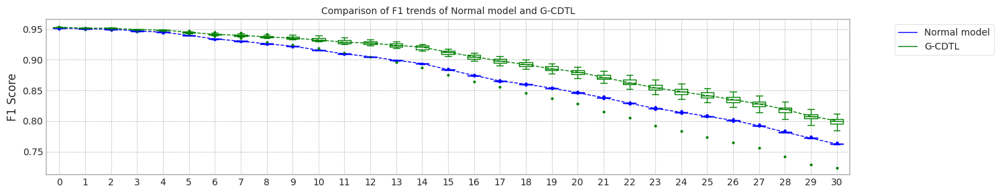

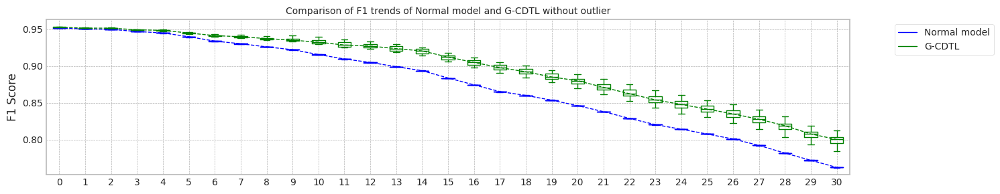

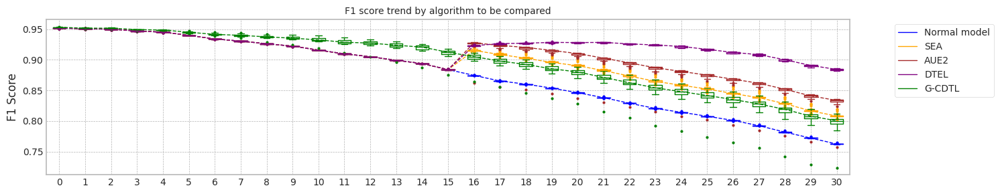

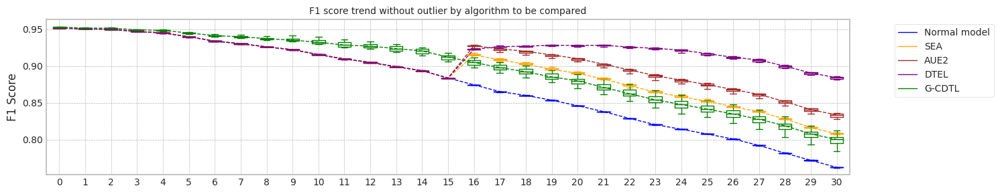

max_mean_trial= 10


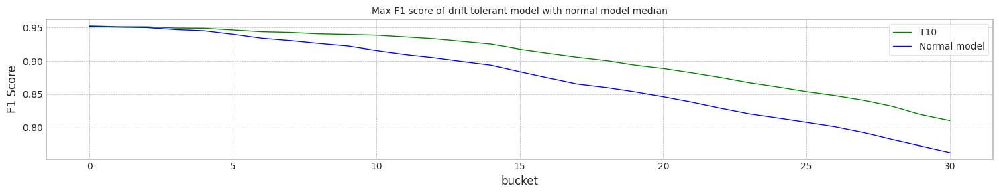

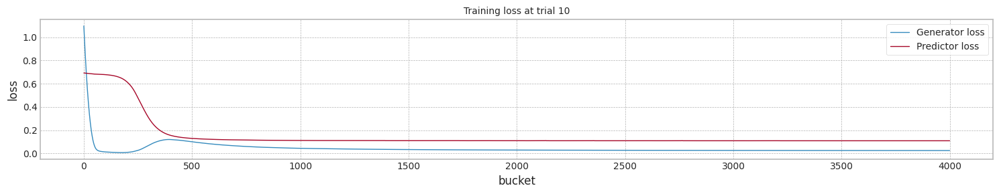

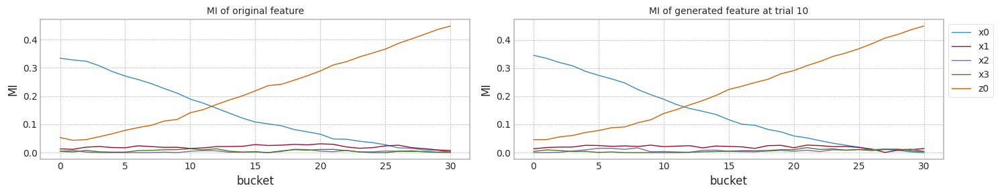

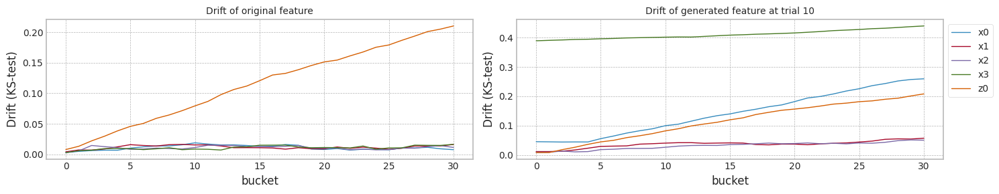

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.951813,0.950859,0.875034,0.762416,6.523332
1,1.0,0.951813,0.950859,0.875072,0.762363,6.501095
2,2.0,0.951898,0.950943,0.874829,0.762033,6.465761
3,3.0,0.952400,0.951539,0.874957,0.762310,6.748230
4,4.0,0.952097,0.950963,0.874683,0.762182,6.470031
5,5.0,0.950601,0.949762,0.874436,0.762725,6.498654
6,6.0,0.951813,0.950859,0.875061,0.762363,6.510529
7,7.0,0.951813,0.950859,0.875035,0.762363,6.570400
8,8.0,0.951018,0.950273,0.874654,0.762831,6.528338
9,9.0,0.951804,0.950839,0.875089,0.762683,6.513772


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.951813,0.950859,0.893655,0.801914,11.658850
1,1.0,0.951813,0.950859,0.896234,0.807988,9.062498
2,2.0,0.951898,0.950943,0.895001,0.804579,11.663125
3,3.0,0.952400,0.951539,0.896363,0.808359,8.691679
4,4.0,0.952097,0.950963,0.899570,0.816194,8.150976
5,5.0,0.950601,0.949762,0.895711,0.807476,9.348471
6,6.0,0.951813,0.950859,0.896360,0.807988,9.911383
7,7.0,0.951813,0.950859,0.896304,0.807988,8.919361
8,8.0,0.951018,0.950273,0.897523,0.811720,9.218019
9,9.0,0.951804,0.950839,0.901547,0.820082,9.378643


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.951813,0.950859,0.906760,0.834736,8.665364
1,1.0,0.951813,0.950859,0.907005,0.835428,9.798713
2,2.0,0.951898,0.950943,0.903782,0.828320,8.570089
3,3.0,0.952400,0.951539,0.906771,0.834947,8.573766
4,4.0,0.952097,0.950963,0.904302,0.829363,10.012218
5,5.0,0.950601,0.949762,0.906504,0.835525,8.891799
6,6.0,0.951813,0.950859,0.906250,0.831856,12.094660
7,7.0,0.951813,0.950859,0.906427,0.832949,11.814676
8,8.0,0.951018,0.950273,0.906269,0.833928,8.480247
9,9.0,0.951804,0.950839,0.903854,0.827665,9.171829


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.951813,0.950859,0.921232,0.884977,13.506185
1,1.0,0.951813,0.950859,0.921278,0.885701,16.938260
2,2.0,0.951898,0.950943,0.920905,0.883341,14.228790
3,3.0,0.952400,0.951539,0.921047,0.884838,16.791615
4,4.0,0.952097,0.950963,0.920031,0.881352,13.129154
5,5.0,0.950601,0.949762,0.920934,0.885914,13.031988
6,6.0,0.951813,0.950859,0.920728,0.883020,14.315648
7,7.0,0.951813,0.950859,0.921367,0.885435,12.713425
8,8.0,0.951018,0.950273,0.919893,0.881360,14.460136
9,9.0,0.951804,0.950839,0.920776,0.881844,17.097508


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.953727,0.952058,0.893972,0.790944,6.558662
1,1.0,0.952694,0.951726,0.896020,0.795328,6.500403
2,2.0,0.953086,0.951427,0.896562,0.801185,6.421573
3,3.0,0.953284,0.952029,0.898706,0.800244,6.489593
4,4.0,0.953215,0.951944,0.900877,0.801658,6.504790
5,5.0,0.954183,0.952723,0.891567,0.784650,6.536976
6,6.0,0.953102,0.951840,0.898004,0.798912,6.471786
7,7.0,0.953036,0.951268,0.900415,0.801356,6.534019
8,8.0,0.952922,0.951792,0.901494,0.809686,6.755198
9,9.0,0.952505,0.950570,0.896550,0.802380,6.439091


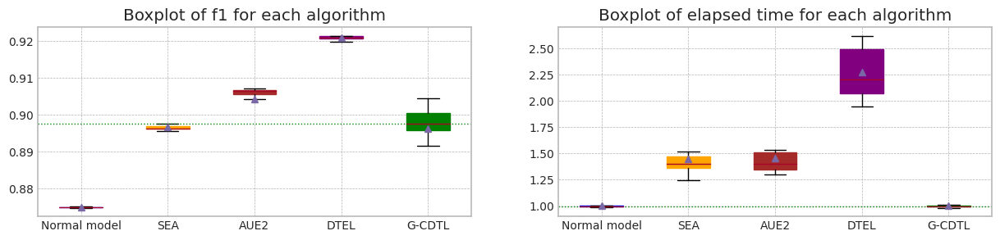

In [ ]:
_,_,_,_,_,_ = drift_tolerant2('case3',X1, Y1,train_size, test_size,avaible_range = 300,lambda_f2=0.8,trial_count=20,weight_init=True)


## synthetic data의 생성 (Case #4 MI의 고정, Drift의 증가)

+ $P_t(y|X) = P_{t+w}(y|X)$ and $P_t(X) \ne P_{t+w}(X)$
+ Virtual Drift
+ 즉, Concept (본 Dataset에서 MI의 변화)의 변화는 없고, P(X)만 변함.

### Dataset 준비

In [55]:
seed_everything()

data_size = 40000
cor = np.asarray([1.5, 1.2, 0.9 , 0.7, 0.5])

y3= (np.random.normal(0.5,0.5,data_size) > 0.5).astype(int)
x3 = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    '''
    x3[:,ix] = y3 + np.random.normal(1,cor_,data_size)
    '''
    # z0
    if ix == 4:
        for ii in range(len(y3)):
            x3[ii,ix] = y3[ii] + np.random.normal(0.0 + 4*ii/data_size,cor_)
    else:
        x3[:,ix] = y3 + np.random.normal(1,cor_,data_size)


### 실험

MI Analysis MI Max 0.20278, Min 0.05089, Mean 0.11172, Std 0.05282
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (39000, 5)
Truncate 8000 rows from live_set (39000, 5)
Search MI & Drift...for X_live_set (31, 9000, 5)


100%|██████████| 31/31 [00:05<00:00,  5.25it/s]


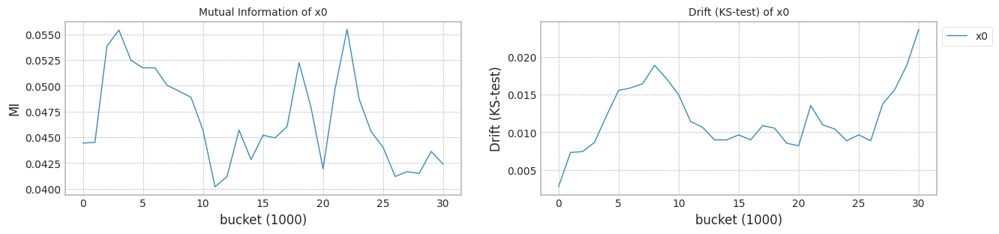

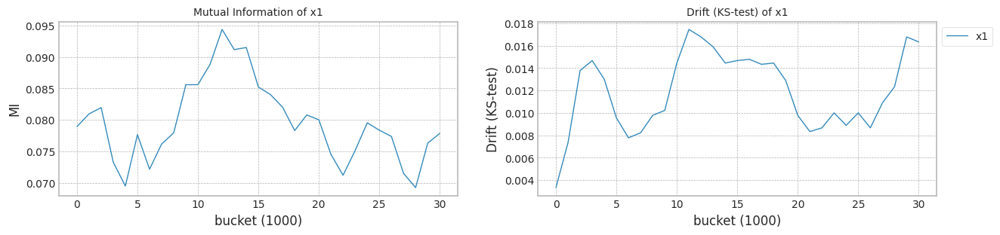

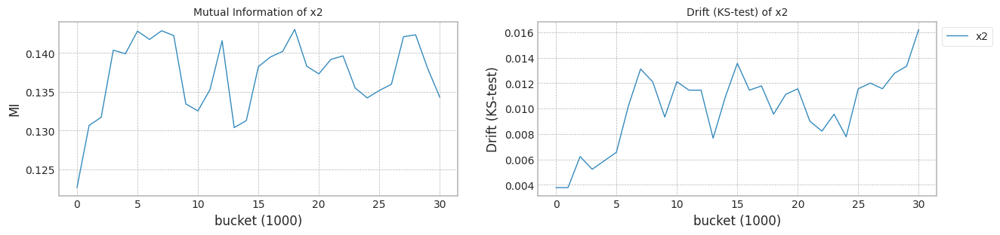

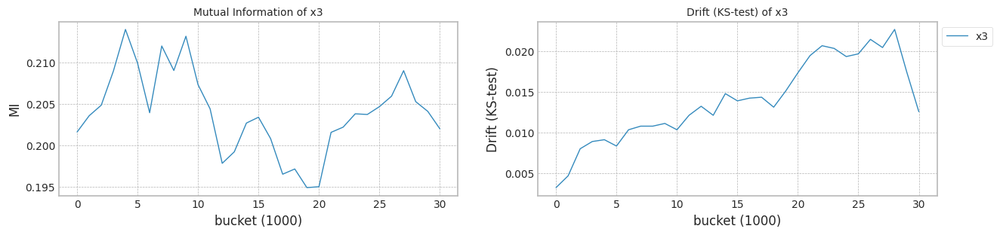

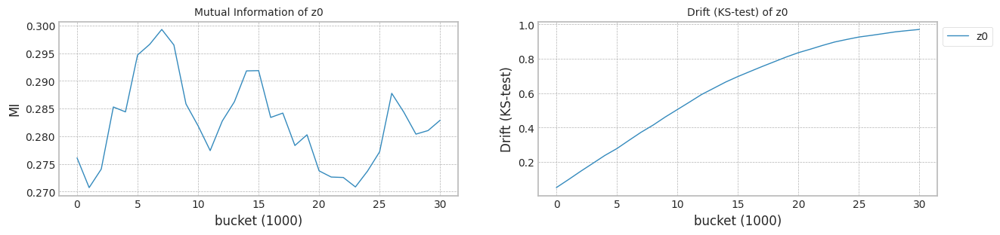

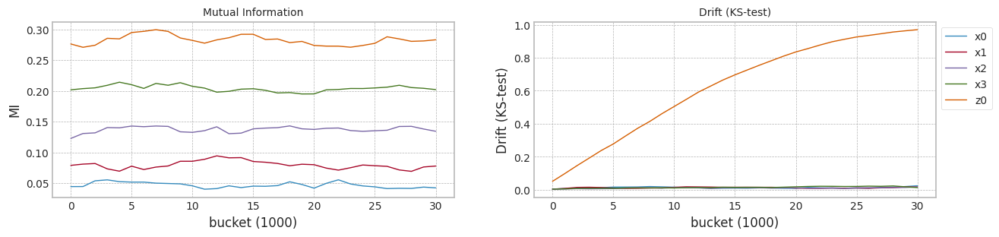

In [56]:
columns=['x0','x1','x2','x3','z0']
X3 = pd.DataFrame(x3,columns=columns)

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X3, y3,train_size, test_size)

In [57]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.520974,0.392205,0.600995,0.478669,0.477486,0
1,0.447230,0.556479,0.629077,0.735705,0.578715,0
2,0.489501,0.704159,0.760582,0.582973,0.354045,0
3,0.581446,0.301839,0.443337,0.515173,0.360338,0
4,0.571642,0.639275,0.524701,0.583380,0.597569,0
...,...,...,...,...,...,...
39995,0.346158,0.267147,0.513105,0.599663,0.989291,39
39996,0.426322,0.302644,0.484909,0.587518,1.004704,39
39997,0.374186,0.587769,0.624447,0.598315,1.321791,39
39998,0.470439,0.265430,0.218971,0.645349,1.148847,39


trial_count: 2
Lambda :  0.9
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-27 12:25:51,507] [INFO] [profiler.py:80:start_profile] Flops profiler started


 57%|█████▋    | 1148/2000 [00:02<00:01, 434.67it/s]

Early stop: 1148
[2023-11-27 12:25:54,155] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4498335000
precision_recall_fscore: (array([0.92735739, 0.89415515]), array([0.88886409, 0.93095818]), array([0.90770283, 0.9121856 ]), array([4481, 4519]))
Test f1 score: 0.9121856027753685
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.19it/s]

mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7697051759409799
inference_flops: 121365000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-27 12:26:00,166] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:26:00,168] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|█▉        | 393/2000 [00:02<00:11, 145.95it/s]

[2023-11-27 12:26:12,138] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:26:12,139] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6205500000 1542510000 39248010000
precision_recall_fscore: (array([0.9128149 , 0.92919955]), array([0.92992636, 0.91192742]), array([0.92129118, 0.92048247]), array([4481, 4519]))
Test f1 score: 0.9204824659370114
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.24it/s]

mean of drift:
x0    0.596265
x1    0.504376
x2    0.263391
x3    0.268333
z0    0.642552
dtype: float64
Mean F1 for all data: 0.921389118590153
inference_flops: 609615000
Normal model median        : 0.7697051759409799
Drift tolerant model median: 0.921389118590153
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-27 12:26:18,101] [INFO] [profiler.py:80:start_profile] Flops profiler started



 46%|████▌     | 919/2000 [00:02<00:02, 451.07it/s]

Early stop: 919
[2023-11-27 12:26:20,146] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3601800000
precision_recall_fscore: (array([0.92626192, 0.89385237]), array([0.88864093, 0.92985174]), array([0.9070615 , 0.91149675]), array([4481, 4519]))
Test f1 score: 0.9114967462039045
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.00it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7698804483684144
inference_flops: 121365000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-27 12:26:26,381] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:26:26,384] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 24%|██▍       | 487/2000 [00:03<00:10, 145.89it/s]

[2023-11-27 12:26:34,216] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:26:34,218] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 15135750000 7686000000 1910520000 24732270000
precision_recall_fscore: (array([0.92043682, 0.92222468]), array([0.92166927, 0.92100022]), array([0.92105263, 0.92161205]), array([4481, 4519]))
Test f1 score: 0.9216120460584589
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.99it/s]


mean of drift:
x0    0.181706
x1    0.465860
x2    0.379724
x3    0.399885
z0    0.544312
dtype: float64
Mean F1 for all data: 0.9176481823709043
inference_flops: 609615000
Normal model median        : 0.7697928121546971
Drift tolerant model median: 0.9195186504805286
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.13it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-27 12:26:43,616] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:26:43,619] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 12:26:49,773] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:26:49,774] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 17/31 [00:09<00:20,  1.49s/it]

G-CDTL train flops: 1323000000 815500000 202710000 2341210000


100%|██████████| 31/31 [00:12<00:00,  2.55it/s]


Early stop at  [465]
Train flops  [2341210000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.9068850275485715
G_CDTL+AUE median: 0.9068850275485715
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:04<00:06,  2.10it/s]

Ensemble_SEA train flops: 367140000


100%|██████████| 31/31 [00:07<00:00,  4.21it/s]


Early stop at  [843]
Train flops  [367140000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8094720395406613
SEA median: 0.8094720395406613
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:04<00:07,  2.07it/s]

Ensemble_SEA train flops: 259695000


100%|██████████| 31/31 [00:06<00:00,  4.45it/s]


Early stop at  [596]
Train flops  [259695000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8369338037267575
AUE median: 0.8369338037267575
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:04<00:08,  1.78it/s]

Ensemble_DTEL train flops: 322770000
Ensemble_DTEL train flops: 8700000


100%|██████████| 31/31 [00:07<00:00,  4.26it/s]


Early stop at  [741, 19]
Train flops  [322770000, 8700000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8616155047969203
DTEL median: 0.8616155047969203
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.17it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-27 12:27:17,527] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:27:17,529] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 12:27:29,092] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:27:29,093] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:14<00:55,  3.68s/it]

G-CDTL train flops: 3500000000 770000000 191400000 4461400000


100%|██████████| 31/31 [00:17<00:00,  1.74it/s]


Early stop at  [439]
Train flops  [4461400000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.9010344537665715
G_CDTL+AUE median: 0.9039597406575715
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:04<00:07,  2.02it/s]

Ensemble_SEA train flops: 253170000


100%|██████████| 31/31 [00:07<00:00,  4.23it/s]


Early stop at  [581]
Train flops  [253170000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8100766626916555
SEA median: 0.8097743511161584
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:04<00:07,  1.90it/s]

Ensemble_SEA train flops: 281880000


100%|██████████| 31/31 [00:07<00:00,  4.15it/s]


Early stop at  [647]
Train flops  [281880000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8371675368783399
AUE median: 0.8370506703025486
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:04<00:09,  1.61it/s]

Ensemble_DTEL train flops: 345390000
Ensemble_DTEL train flops: 9135000


100%|██████████| 31/31 [00:07<00:00,  3.99it/s]


Early stop at  [793, 20]
Train flops  [345390000, 9135000]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8622278521980216
DTEL median: 0.8619216784974709


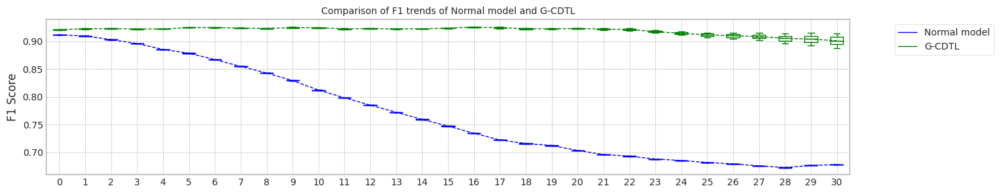

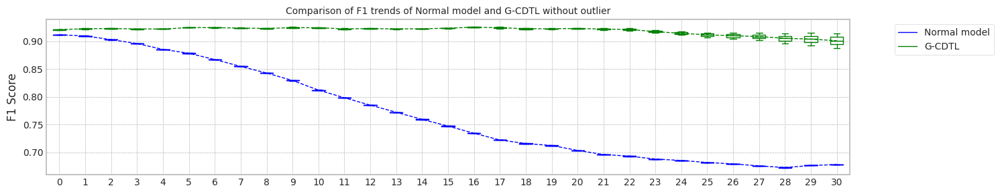

max_mean_trial= 0


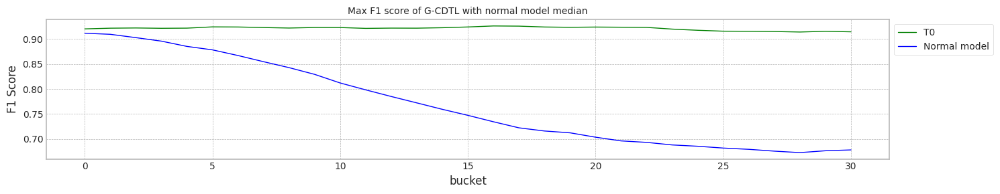

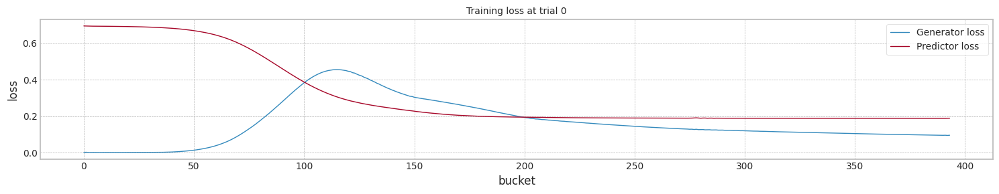

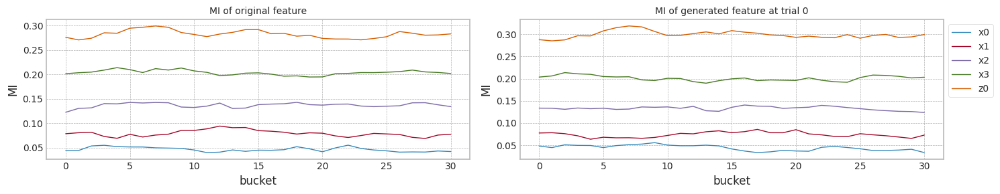

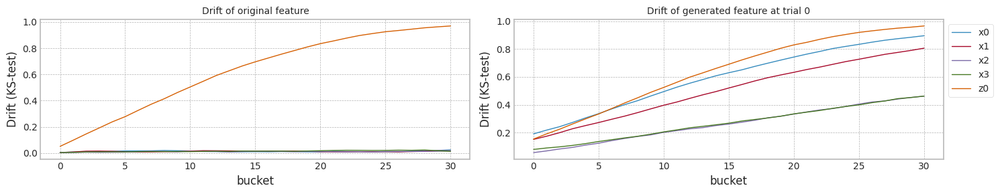

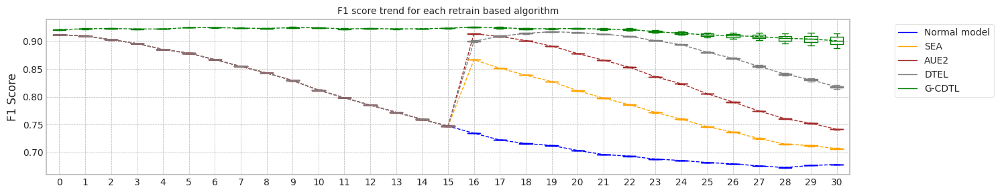

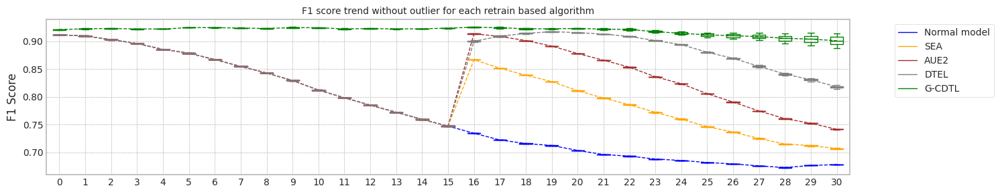

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.107025146484375
Base flops (inference flops of normal model, median): 121365000.0


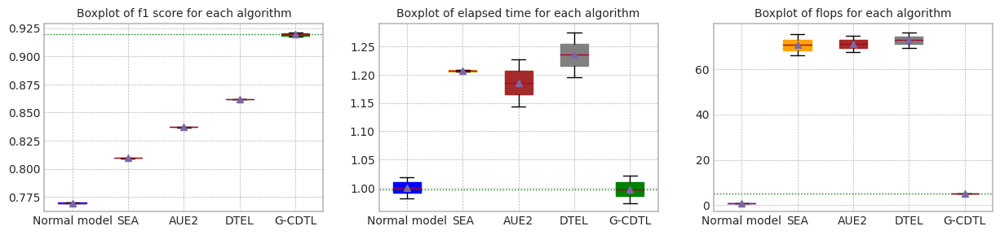

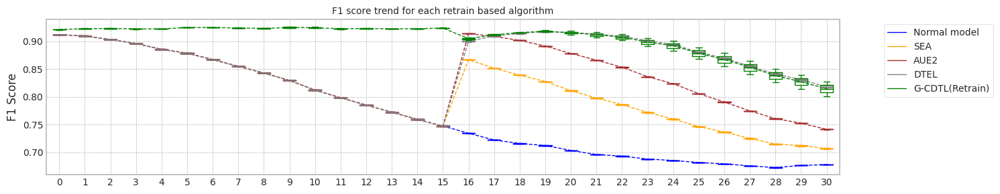

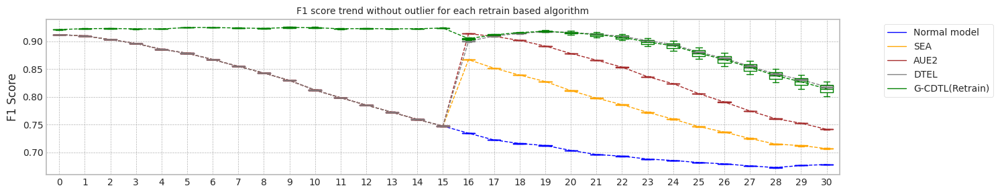

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.107025146484375
Base flops (train + inference flops of normal model, median): 4171432500.0


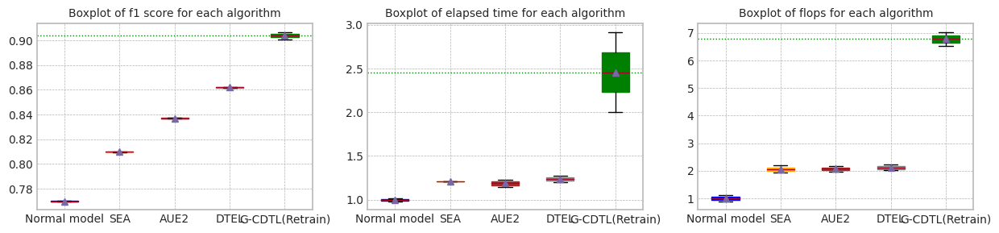

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.107025146484375


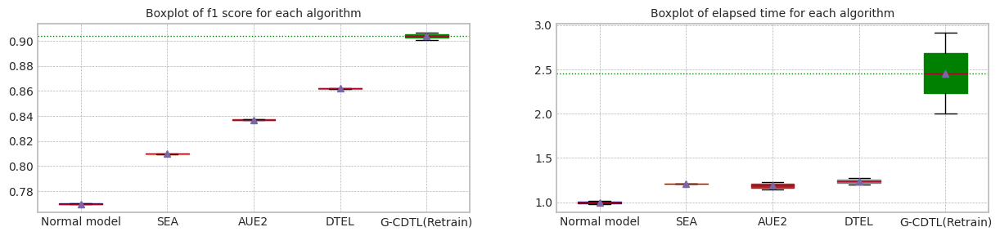

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.912186,0.909984,0.769705,0.677723,5.993974,4.498335e+09,121365000.0,4.619700e+09
1,1.0,0.911497,0.909266,0.769880,0.677923,6.220077,3.601800e+09,121365000.0,3.723165e+09
2,median,0.911841,0.909625,0.769793,0.677823,6.107025,4.050068e+09,121365000.0,4.171432e+09
3,std,0.000487,0.000508,0.000124,0.000142,0.159879,6.339460e+08,0.0,6.339460e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920482,0.921903,0.921389,0.914655,5.942543,3.924801e+10,609615000.0,3.985762e+10
1,1.0,0.921612,0.923368,0.917648,0.887490,6.242498,2.473227e+10,609615000.0,2.534188e+10
2,median,0.921047,0.922635,0.919519,0.901072,6.092521,3.199014e+10,609615000.0,3.259976e+10
3,std,0.000799,0.001036,0.002645,0.019209,0.212100,1.026418e+10,0.0,1.026418e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.912186,0.909984,0.809472,0.705674,7.381962,3.968940e+09,5.170845e+09,9.139785e+09
1,1.0,0.911497,0.909266,0.810077,0.707528,7.362154,3.854970e+09,4.160340e+09,8.015310e+09
2,median,0.911841,0.909625,0.809774,0.706601,7.372058,3.911955e+09,4.665592e+09,8.577548e+09
3,std,0.000487,0.000508,0.000428,0.001311,0.014006,8.058896e+07,7.145349e+08,7.951239e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.912186,0.909984,0.836934,0.740951,6.984555,3.861495e+09,5.184765e+09,9.046260e+09
1,1.0,0.911497,0.909266,0.837168,0.741671,7.499350,3.883680e+09,4.310415e+09,8.194095e+09
2,median,0.911841,0.909625,0.837051,0.741311,7.241953,3.872588e+09,4.747590e+09,8.620178e+09
3,std,0.000487,0.000508,0.000165,0.000510,0.364015,1.568716e+07,6.182588e+08,6.025717e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.912186,0.909984,0.861616,0.814531,7.299072,3.933270e+09,5.319180e+09,9.252450e+09
1,1.0,0.911497,0.909266,0.862228,0.821113,7.788368,3.956325e+09,4.445700e+09,8.402025e+09
2,median,0.911841,0.909625,0.861922,0.817822,7.543720,3.944798e+09,4.882440e+09,8.827238e+09
3,std,0.000487,0.000508,0.000433,0.004655,0.345985,1.630235e+07,6.176436e+08,6.013413e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920482,0.921903,0.906885,0.827198,12.201686,2.707348e+10,134325000.0,2.720780e+10
1,1.0,0.921612,0.923368,0.901034,0.801264,17.820872,2.919367e+10,134325000.0,2.932800e+10
2,median,0.921047,0.922635,0.903960,0.814231,15.011279,2.813358e+10,134325000.0,2.826790e+10
3,std,0.000799,0.001036,0.004137,0.018338,3.973365,1.499201e+09,0.0,1.499201e+09


In [58]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case4',X1, Y1,train_size, test_size,avaible_range = 300,
                                                            lambda_f2=0.9,trial_count=2,lr_g=0.002,
                                                            retrain_count=1,weight_init=True)

trial_count: 3
Lambda :  0.8
######################### Trial 0 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 703.91it/s]


precision_recall_fscore: (array([0.92735739, 0.89415515]), array([0.88886409, 0.93095818]), array([0.90770283, 0.9121856 ]), array([4481, 4519]))
Test f1 score: 0.9121856027753685
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.49it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7694103092075215
######################### Trial 0 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 239.74it/s]


precision_recall_fscore: (array([0.92449854, 0.91694061]), array([0.91542067, 0.92586855]), array([0.91993721, 0.92138296]), array([4481, 4519]))
Test f1 score: 0.9213829552961903
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.42it/s]


mean of drift:
x0    0.219265
x1    0.436530
x2    0.201441
x3    0.200172
z0    0.341900
dtype: float64
Mean F1 for all data: 0.9175070832220547
Normal model median        : 0.7694103092075215
Drift tolerant model median: 0.9175070832220547
######################### Trial 1 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 713.75it/s]


precision_recall_fscore: (array([0.92792162, 0.89327392]), array([0.88774827, 0.93162204]), array([0.90739051, 0.91204506]), array([4481, 4519]))
Test f1 score: 0.9120450606585788
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.38it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7706051275924641
######################### Trial 1 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 224.87it/s]


precision_recall_fscore: (array([0.9216827 , 0.92010594]), array([0.91921446, 0.92254924]), array([0.92044693, 0.92132597]), array([4481, 4519]))
Test f1 score: 0.9213259668508288
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.31it/s]


mean of drift:
x0    0.154523
x1    0.556312
x2    0.073982
x3    0.135251
z0    0.530204
dtype: float64
Mean F1 for all data: 0.9210881100677243
Normal model median        : 0.7700077183999928
Drift tolerant model median: 0.9192975966448895
######################### Trial 2 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 699.23it/s]


precision_recall_fscore: (array([0.92710759, 0.89375266]), array([0.88841776, 0.93073689]), array([0.90735043, 0.91186992]), array([4481, 4519]))
Test f1 score: 0.9118699186991871
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.43it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7695583529046279
######################### Trial 2 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 220.61it/s]


precision_recall_fscore: (array([0.92418448, 0.91811196]), array([0.91675965, 0.92542598]), array([0.92045709, 0.92175446]), array([4481, 4519]))
Test f1 score: 0.9217544633017412
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.38it/s]


mean of drift:
x0    0.569075
x1    0.122914
x2    0.096140
x3    0.122652
z0    0.434294
dtype: float64
Mean F1 for all data: 0.9226246226516603
Normal model median        : 0.7695583529046279
Drift tolerant model median: 0.9210881100677243
######################### Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Trial 0 for G_CDTL+SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.18it/s]


Early stop at  [961]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.9223119495249027
G_CDTL+SEA median: 0.9223119495249027
######################### Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:08<00:00,  3.56it/s]


Early stop at  [2029]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8113356123104521
SEA median: 0.8113356123104521
######################### Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:07<00:00,  4.18it/s]


Early stop at  [1273]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8299853520859709
AUE median: 0.8299853520859709
######################### Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:12<00:00,  2.55it/s]


Early stop at  [840]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8577351759601615
DTEL median: 0.8577351759601615
######################### Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Trial 1 for G_CDTL+SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:10<00:00,  2.93it/s]


Early stop at  [1092]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.9204273863596463
G_CDTL+SEA median: 0.9213696679422745
######################### Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:07<00:00,  4.11it/s]


Early stop at  [1171]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8143681932544319
SEA median: 0.812851902782442
######################### Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.74it/s]


Early stop at  []
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8292249454028429
AUE median: 0.8296051487444069
######################### Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:13<00:00,  2.32it/s]


Early stop at  [1642]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8576212864879234
DTEL median: 0.8576782312240424
######################### Trial 2 for Normal model ###########################
retrain_interval: 16
######################### Trial 2 for G_CDTL+SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.64it/s]


Early stop at  [1329]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.9178552952547684
G_CDTL+SEA median: 0.9204273863596463
######################### Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.89it/s]


Early stop at  [38]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7693088503269124
SEA median: 0.8113356123104521
######################### Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:07<00:00,  4.07it/s]


Early stop at  [1209]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8299250965917443
AUE median: 0.8299250965917443
######################### Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:13<00:00,  2.24it/s]


Early stop at  [1964]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8585693336905366
DTEL median: 0.8577351759601615


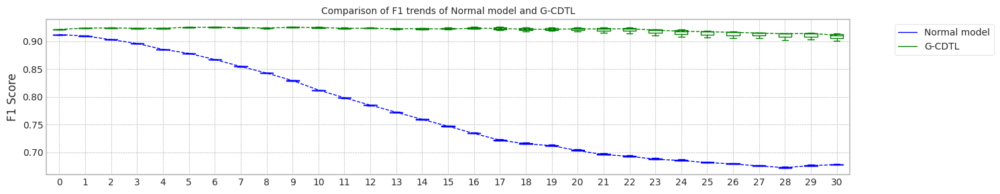

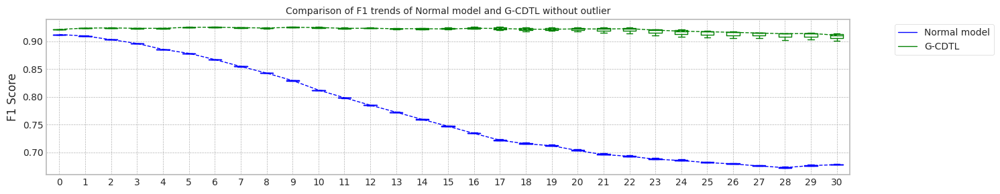

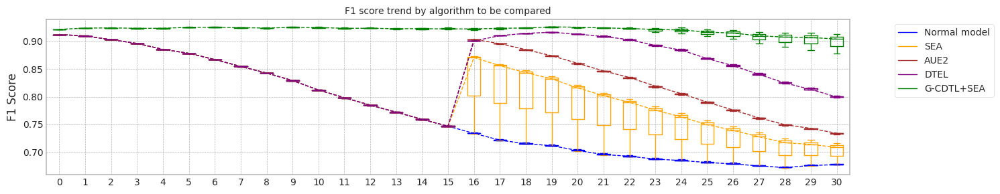

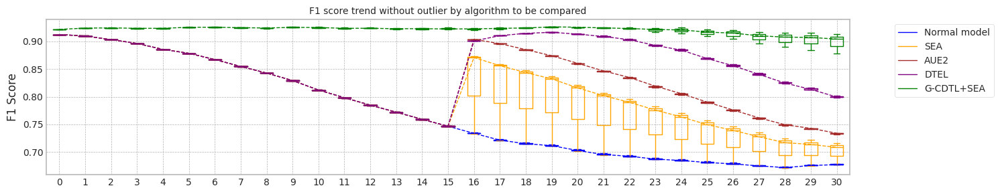

max_mean_trial= 2


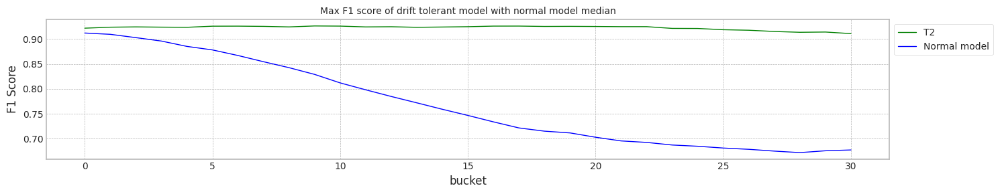

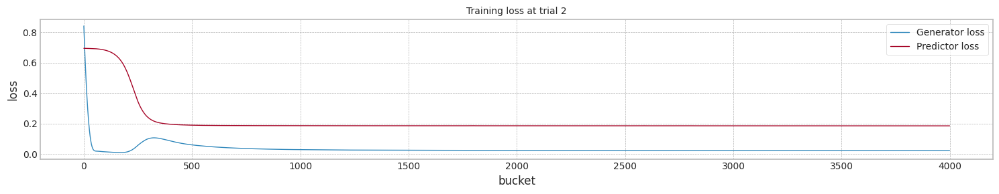

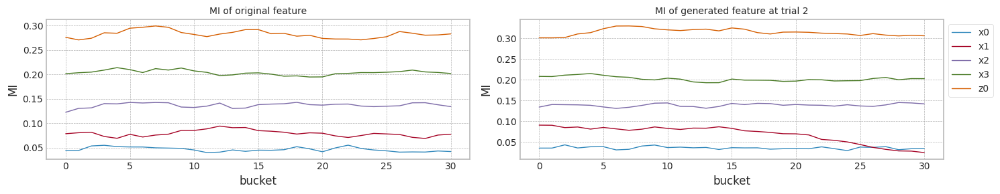

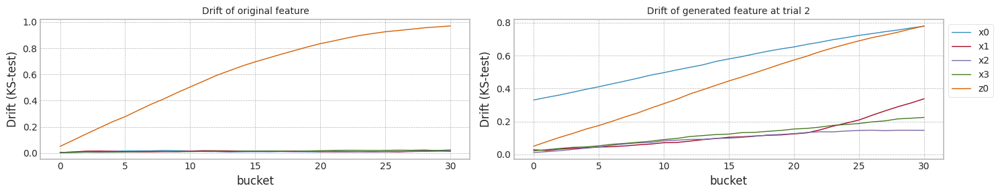

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.769410,0.677472,5.669458
1,1.0,0.912045,0.909440,0.770605,0.678979,5.781678
2,2.0,0.911870,0.909421,0.769558,0.677522,5.736739
3,median,0.912045,0.909440,0.769558,0.677522,5.736739
4,std,0.000158,0.000387,0.000651,0.000856,0.056479


@ G-CDTL+SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.921383,0.923570,0.922312,0.913070,9.779829
1,1.0,0.921326,0.923538,0.920427,0.903926,10.614917
2,2.0,0.921754,0.923741,0.917855,0.877511,11.771465
3,median,0.921383,0.923570,0.920427,0.903926,10.614917
4,std,0.000233,0.000109,0.002237,0.018465,1.000132


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.811336,0.708514,8.741894
1,1.0,0.912045,0.909440,0.814368,0.716355,7.569609
2,2.0,0.911870,0.909421,0.769309,0.677522,6.360259
3,median,0.912045,0.909440,0.811336,0.708514,7.569609
4,std,0.000158,0.000387,0.025185,0.020534,1.190865


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.829985,0.734307,7.439929
1,1.0,0.912045,0.909440,0.829225,0.732410,11.341217
2,2.0,0.911870,0.909421,0.829925,0.734055,7.643373
3,median,0.912045,0.909440,0.829925,0.734055,7.643373
4,std,0.000158,0.000387,0.000423,0.001030,2.196038


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.857735,0.799335,12.177342
1,1.0,0.912045,0.909440,0.857621,0.798496,13.393088
2,2.0,0.911870,0.909421,0.858569,0.802002,13.840095
3,median,0.912045,0.909440,0.857735,0.799335,13.393088
4,std,0.000158,0.000387,0.000518,0.001831,0.860484


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.921383,0.923570,0.917507,0.900884,5.743948
1,1.0,0.921326,0.923538,0.921088,0.913683,5.857195
2,2.0,0.921754,0.923741,0.922625,0.910864,5.780780
3,median,0.921383,0.923570,0.921088,0.910864,5.780780
4,std,0.000233,0.000109,0.002626,0.006725,0.057765


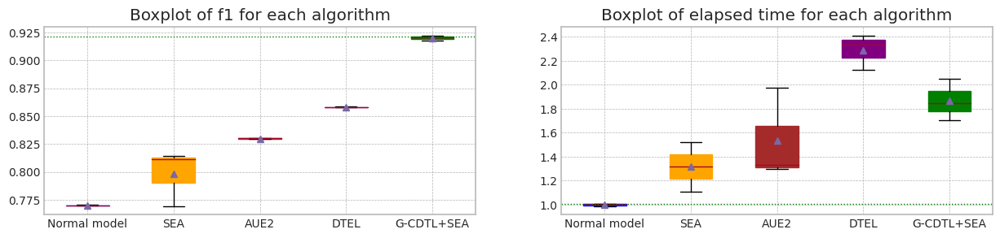

trial_count: 3
Lambda :  0.8
######################### Trial 0 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 689.64it/s]


precision_recall_fscore: (array([0.92735739, 0.89415515]), array([0.88886409, 0.93095818]), array([0.90770283, 0.9121856 ]), array([4481, 4519]))
Test f1 score: 0.9121856027753685
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.37it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7694103092075215
######################### Trial 0 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 236.45it/s]


precision_recall_fscore: (array([0.92449854, 0.91694061]), array([0.91542067, 0.92586855]), array([0.91993721, 0.92138296]), array([4481, 4519]))
Test f1 score: 0.9213829552961903
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  5.16it/s]


mean of drift:
x0    0.219265
x1    0.436530
x2    0.201441
x3    0.200172
z0    0.341900
dtype: float64
Mean F1 for all data: 0.9175070832220547
Normal model median        : 0.7694103092075215
Drift tolerant model median: 0.9175070832220547
######################### Trial 1 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 700.69it/s]


precision_recall_fscore: (array([0.92792162, 0.89327392]), array([0.88774827, 0.93162204]), array([0.90739051, 0.91204506]), array([4481, 4519]))
Test f1 score: 0.9120450606585788
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.32it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7706051275924641
######################### Trial 1 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 235.47it/s]


precision_recall_fscore: (array([0.9216827 , 0.92010594]), array([0.91921446, 0.92254924]), array([0.92044693, 0.92132597]), array([4481, 4519]))
Test f1 score: 0.9213259668508288
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.26it/s]


mean of drift:
x0    0.154523
x1    0.556312
x2    0.073982
x3    0.135251
z0    0.530204
dtype: float64
Mean F1 for all data: 0.9210881100677243
Normal model median        : 0.7700077183999928
Drift tolerant model median: 0.9192975966448895
######################### Trial 2 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 683.10it/s]


precision_recall_fscore: (array([0.92710759, 0.89375266]), array([0.88841776, 0.93073689]), array([0.90735043, 0.91186992]), array([4481, 4519]))
Test f1 score: 0.9118699186991871
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.44it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7695583529046279
######################### Trial 2 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 235.53it/s]


precision_recall_fscore: (array([0.92418448, 0.91811196]), array([0.91675965, 0.92542598]), array([0.92045709, 0.92175446]), array([4481, 4519]))
Test f1 score: 0.9217544633017412
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.25it/s]


mean of drift:
x0    0.569075
x1    0.122914
x2    0.096140
x3    0.122652
z0    0.434294
dtype: float64
Mean F1 for all data: 0.9226246226516603
Normal model median        : 0.7695583529046279
Drift tolerant model median: 0.9210881100677243
######################### Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Trial 0 for G_CDTL+SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:13<00:00,  2.28it/s]


Early stop at  [876, 1018]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.9198802190414609
G_CDTL+SEA median: 0.9198802190414609
######################### Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.24it/s]


Early stop at  [1342, 1525]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8355610568470686
SEA median: 0.8355610568470686
######################### Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:10<00:00,  3.10it/s]


Early stop at  [1301, 1525]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8465096054094061
AUE median: 0.8465096054094061
######################### Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:25<00:00,  1.23it/s]


Early stop at  [3791, 2256]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8865691455970987
DTEL median: 0.8865691455970987
######################### Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Trial 1 for G_CDTL+SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:18<00:00,  1.65it/s]


Early stop at  [1343, 1569]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.9152755428650706
G_CDTL+SEA median: 0.9175778809532658
######################### Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.20it/s]


Early stop at  [1367, 1223]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8377803453024896
SEA median: 0.8366707010747791
######################### Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.14it/s]


Early stop at  [1241, 1583]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8457859182249795
AUE median: 0.8461477618171929
######################### Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:20<00:00,  1.54it/s]


Early stop at  [1272, 1251]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8870910983924173
DTEL median: 0.886830121994758
######################### Trial 2 for Normal model ###########################
retrain_interval: 11
######################### Trial 2 for G_CDTL+SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:14<00:00,  2.12it/s]


Early stop at  [950, 1081]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.9161974261590268
G_CDTL+SEA median: 0.9161974261590268
######################### Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:13<00:00,  2.27it/s]


Early stop at  [1804, 3508]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8363360148487694
SEA median: 0.8363360148487694
######################### Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:10<00:00,  2.92it/s]


Early stop at  [1789, 1672]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8463018101214356
AUE median: 0.8463018101214356
######################### Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:21<00:00,  1.47it/s]


Early stop at  [1559, 1508]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8866996331166974
DTEL median: 0.8866996331166974


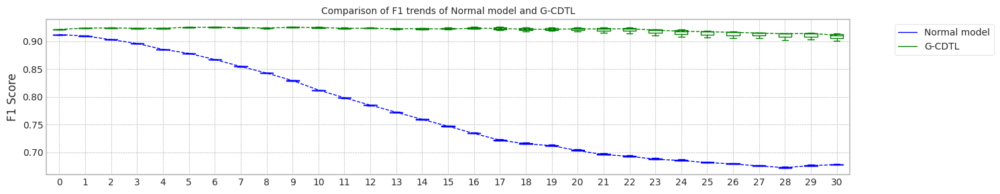

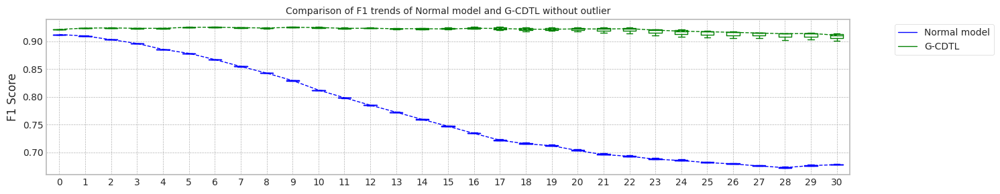

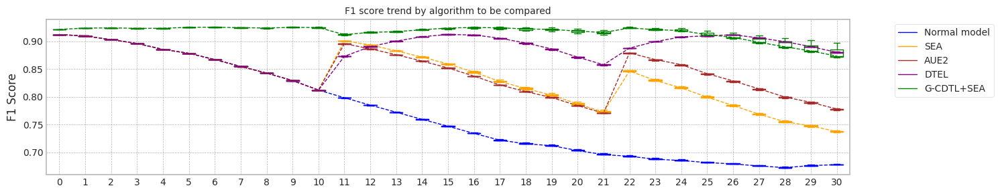

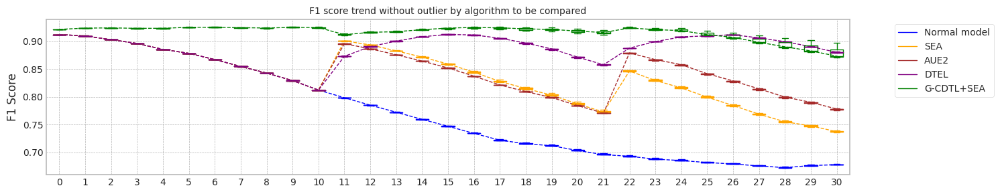

max_mean_trial= 2


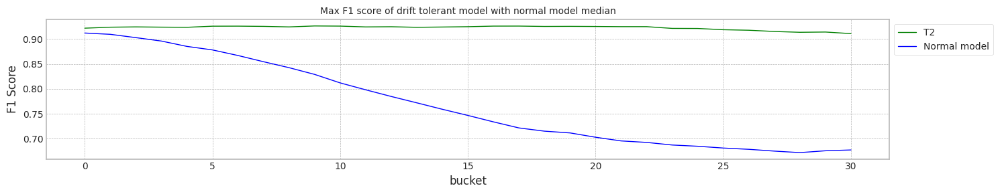

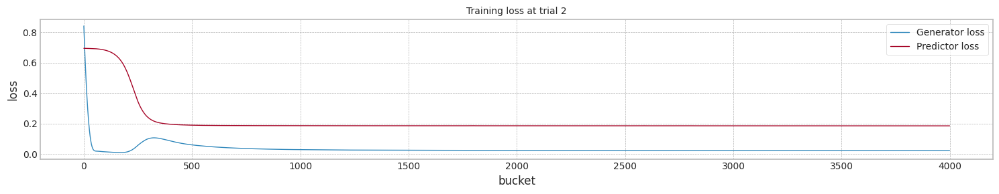

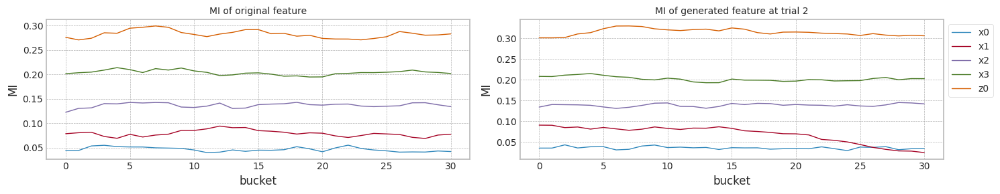

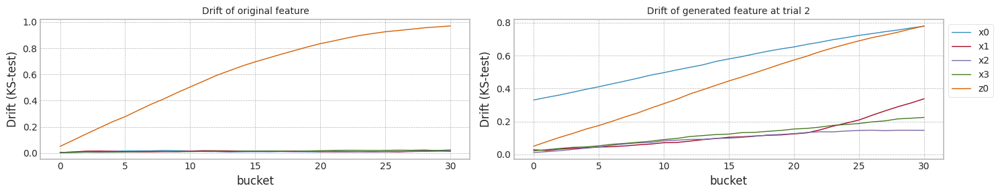

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.769410,0.677472,5.791238
1,1.0,0.912045,0.909440,0.770605,0.678979,5.843924
2,2.0,0.911870,0.909421,0.769558,0.677522,5.726605
3,median,0.912045,0.909440,0.769558,0.677522,5.791238
4,std,0.000158,0.000387,0.000651,0.000856,0.058760


@ G-CDTL+SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.921383,0.923570,0.919880,0.896538,13.594743
1,1.0,0.921326,0.923538,0.915276,0.873218,18.855883
2,2.0,0.921754,0.923741,0.916197,0.870666,14.648028
3,median,0.921383,0.923570,0.916197,0.873218,14.648028
4,std,0.000233,0.000109,0.002436,0.014258,2.783734


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.835561,0.735353,9.587850
1,1.0,0.912045,0.909440,0.837780,0.738814,9.711786
2,2.0,0.911870,0.909421,0.836336,0.737029,13.691897
3,median,0.912045,0.909440,0.836336,0.737029,9.711786
4,std,0.000158,0.000387,0.001126,0.001731,2.334518


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.846510,0.778374,10.035395
1,1.0,0.912045,0.909440,0.845786,0.775798,9.902183
2,2.0,0.911870,0.909421,0.846302,0.777844,10.662410
3,median,0.912045,0.909440,0.846302,0.777844,10.035395
4,std,0.000158,0.000387,0.000373,0.001360,0.405964


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.886569,0.880024,25.245203
1,1.0,0.912045,0.909440,0.887091,0.881252,20.093341
2,2.0,0.911870,0.909421,0.886700,0.879073,21.056058
3,median,0.912045,0.909440,0.886700,0.880024,21.056058
4,std,0.000158,0.000387,0.000272,0.001092,2.739144


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.921383,0.923570,0.917507,0.900884,6.027822
1,1.0,0.921326,0.923538,0.921088,0.913683,5.912132
2,2.0,0.921754,0.923741,0.922625,0.910864,5.927772
3,median,0.921383,0.923570,0.921088,0.910864,5.927772
4,std,0.000233,0.000109,0.002626,0.006725,0.062768


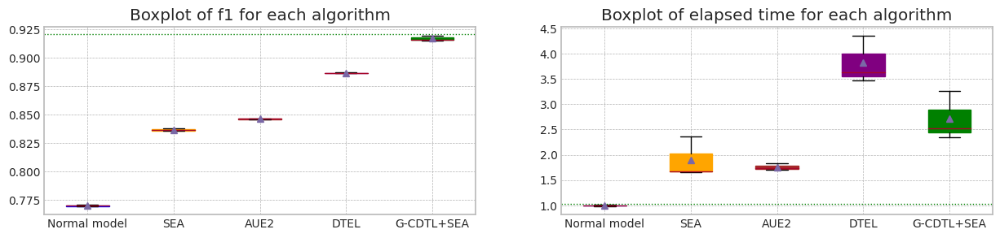

trial_count: 3
Lambda :  0.8
######################### Trial 0 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 643.50it/s]


precision_recall_fscore: (array([0.92735739, 0.89415515]), array([0.88886409, 0.93095818]), array([0.90770283, 0.9121856 ]), array([4481, 4519]))
Test f1 score: 0.9121856027753685
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.26it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7694103092075215
######################### Trial 0 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 234.65it/s]


precision_recall_fscore: (array([0.92449854, 0.91694061]), array([0.91542067, 0.92586855]), array([0.91993721, 0.92138296]), array([4481, 4519]))
Test f1 score: 0.9213829552961903
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.28it/s]


mean of drift:
x0    0.219265
x1    0.436530
x2    0.201441
x3    0.200172
z0    0.341900
dtype: float64
Mean F1 for all data: 0.9175070832220547
Normal model median        : 0.7694103092075215
Drift tolerant model median: 0.9175070832220547
######################### Trial 1 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 702.57it/s]


precision_recall_fscore: (array([0.92792162, 0.89327392]), array([0.88774827, 0.93162204]), array([0.90739051, 0.91204506]), array([4481, 4519]))
Test f1 score: 0.9120450606585788
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:06<00:00,  4.96it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7706051275924641
######################### Trial 1 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 234.55it/s]


precision_recall_fscore: (array([0.9216827 , 0.92010594]), array([0.91921446, 0.92254924]), array([0.92044693, 0.92132597]), array([4481, 4519]))
Test f1 score: 0.9213259668508288
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.25it/s]


mean of drift:
x0    0.154523
x1    0.556312
x2    0.073982
x3    0.135251
z0    0.530204
dtype: float64
Mean F1 for all data: 0.9210881100677243
Normal model median        : 0.7700077183999928
Drift tolerant model median: 0.9192975966448895
######################### Trial 2 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 671.83it/s]


precision_recall_fscore: (array([0.92710759, 0.89375266]), array([0.88841776, 0.93073689]), array([0.90735043, 0.91186992]), array([4481, 4519]))
Test f1 score: 0.9118699186991871
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.31it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7695583529046279
######################### Trial 2 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 231.19it/s]


precision_recall_fscore: (array([0.92418448, 0.91811196]), array([0.91675965, 0.92542598]), array([0.92045709, 0.92175446]), array([4481, 4519]))
Test f1 score: 0.9217544633017412
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.24it/s]


mean of drift:
x0    0.569075
x1    0.122914
x2    0.096140
x3    0.122652
z0    0.434294
dtype: float64
Mean F1 for all data: 0.9226246226516603
Normal model median        : 0.7695583529046279
Drift tolerant model median: 0.9210881100677243
######################### Trial 0 for Normal model ###########################
retrain_interval: 8
######################### Trial 0 for G_CDTL+SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:18<00:00,  1.72it/s]


Early stop at  [1077, 995, 880]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.9165590876864309
G_CDTL+SEA median: 0.9165590876864309
######################### Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:09<00:00,  3.17it/s]


Early stop at  [934, 1061, 978]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8467975127936239
SEA median: 0.8467975127936239
######################### Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:12<00:00,  2.43it/s]


Early stop at  [2398, 1487, 1150]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8402371962183394
AUE median: 0.8402371962183394
######################### Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:29<00:00,  1.05it/s]


Early stop at  [2335, 1533, 2165]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.9001828068098803
DTEL median: 0.9001828068098803
######################### Trial 1 for Normal model ###########################
retrain_interval: 8
######################### Trial 1 for G_CDTL+SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:17<00:00,  1.73it/s]


Early stop at  [978, 994, 936]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.9120594378138999
G_CDTL+SEA median: 0.9143092627501654
######################### Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:12<00:00,  2.42it/s]


Early stop at  [1815, 2104, 1226]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8478898353212881
SEA median: 0.847343674057456
######################### Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:17<00:00,  1.77it/s]


Early stop at  [2768, 1754]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8369448007456702
AUE median: 0.8385909984820048
######################### Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:27<00:00,  1.14it/s]


Early stop at  [756, 1631, 1866]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.899290090387947
DTEL median: 0.8997364485989137
######################### Trial 2 for Normal model ###########################
retrain_interval: 8
######################### Trial 2 for G_CDTL+SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:17<00:00,  1.74it/s]


Early stop at  [1231, 891, 794]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.9119667719469341
G_CDTL+SEA median: 0.9120594378138999
######################### Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:11<00:00,  2.60it/s]


Early stop at  [1063, 2519, 1009]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8471506544124446
SEA median: 0.8471506544124446
######################### Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:18<00:00,  1.67it/s]


Early stop at  [1429]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8337093522597514
AUE median: 0.8369448007456702
######################### Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:28<00:00,  1.08it/s]


Early stop at  [2133, 1803, 1230]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8997251655872409
DTEL median: 0.8997251655872409


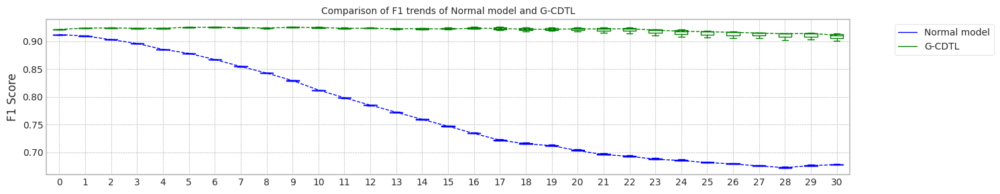

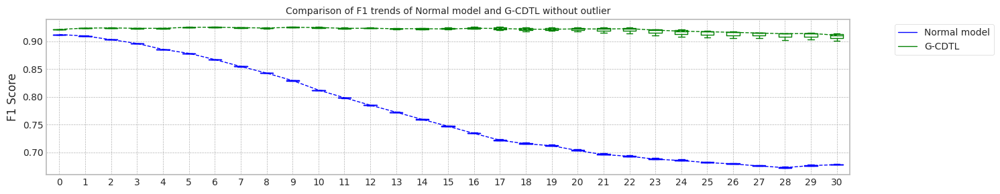

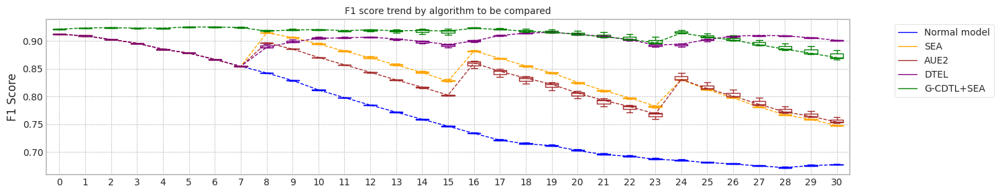

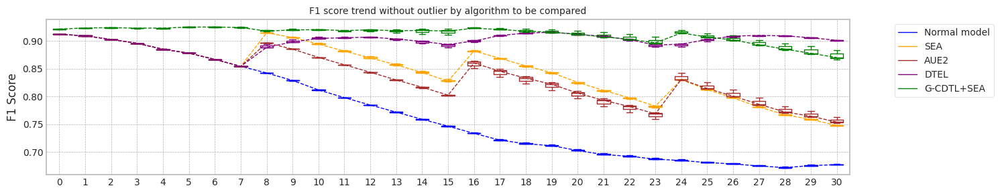

max_mean_trial= 2


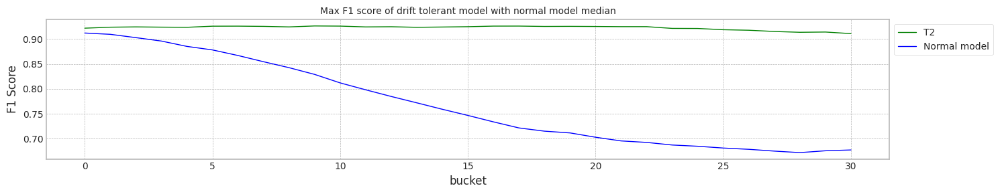

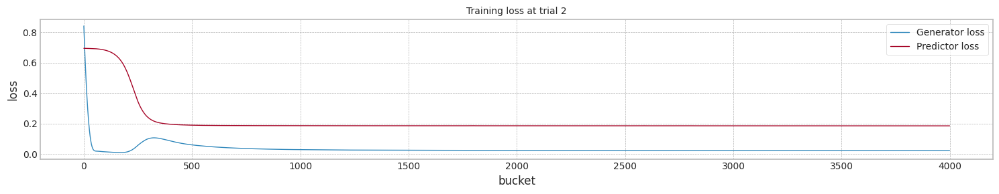

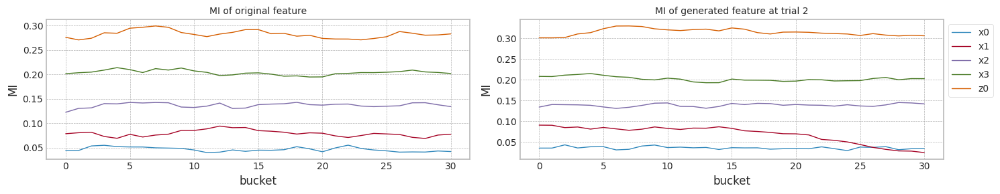

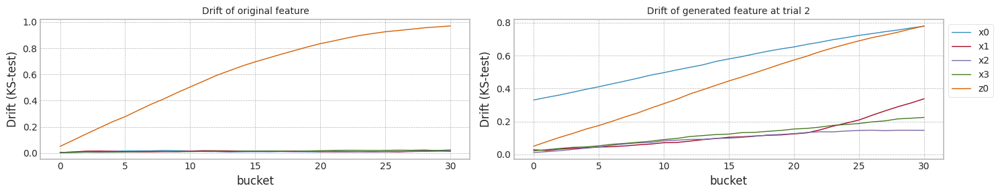

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.769410,0.677472,5.920697
1,1.0,0.912045,0.909440,0.770605,0.678979,6.273650
2,2.0,0.911870,0.909421,0.769558,0.677522,5.861849
3,median,0.912045,0.909440,0.769558,0.677522,5.920697
4,std,0.000158,0.000387,0.000651,0.000856,0.222718


@ G-CDTL+SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.921383,0.923570,0.916559,0.884119,18.084363
1,1.0,0.921326,0.923538,0.912059,0.867262,17.904118
2,2.0,0.921754,0.923741,0.911967,0.870211,17.831327
3,median,0.921383,0.923570,0.912059,0.870211,17.904118
4,std,0.000233,0.000109,0.002625,0.009003,0.130266


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.846798,0.748650,9.793506
1,1.0,0.912045,0.909440,0.847890,0.747855,12.836852
2,2.0,0.911870,0.909421,0.847151,0.747122,11.971447
3,median,0.912045,0.909440,0.847151,0.747855,11.971447
4,std,0.000158,0.000387,0.000557,0.000764,1.568136


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.840237,0.762866,12.803372
1,1.0,0.912045,0.909440,0.836945,0.754185,17.513813
2,2.0,0.911870,0.909421,0.833709,0.752819,18.580080
3,median,0.912045,0.909440,0.836945,0.754185,17.513813
4,std,0.000158,0.000387,0.003264,0.005449,3.073965


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.900183,0.901426,29.417023
1,1.0,0.912045,0.909440,0.899290,0.901574,27.195437
2,2.0,0.911870,0.909421,0.899725,0.899888,28.766387
3,median,0.912045,0.909440,0.899725,0.901426,28.766387
4,std,0.000158,0.000387,0.000446,0.000934,1.142122


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.921383,0.923570,0.917507,0.900884,5.897808
1,1.0,0.921326,0.923538,0.921088,0.913683,5.925769
2,2.0,0.921754,0.923741,0.922625,0.910864,5.937485
3,median,0.921383,0.923570,0.921088,0.910864,5.925769
4,std,0.000233,0.000109,0.002626,0.006725,0.020385


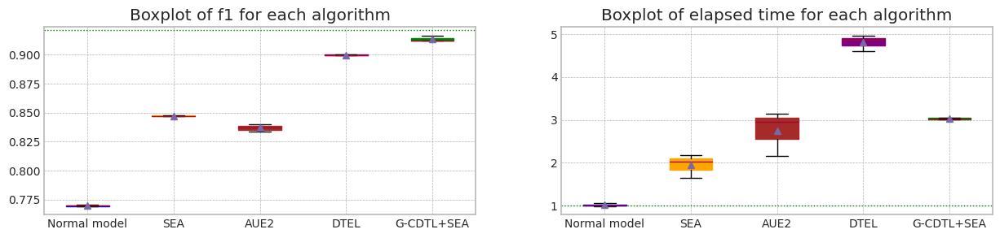

trial_count: 3
Lambda :  0.8
######################### Trial 0 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 684.21it/s]


precision_recall_fscore: (array([0.92735739, 0.89415515]), array([0.88886409, 0.93095818]), array([0.90770283, 0.9121856 ]), array([4481, 4519]))
Test f1 score: 0.9121856027753685
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.21it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7694103092075215
######################### Trial 0 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 234.46it/s]


precision_recall_fscore: (array([0.92449854, 0.91694061]), array([0.91542067, 0.92586855]), array([0.91993721, 0.92138296]), array([4481, 4519]))
Test f1 score: 0.9213829552961903
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.26it/s]


mean of drift:
x0    0.219265
x1    0.436530
x2    0.201441
x3    0.200172
z0    0.341900
dtype: float64
Mean F1 for all data: 0.9175070832220547
Normal model median        : 0.7694103092075215
Drift tolerant model median: 0.9175070832220547
######################### Trial 1 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 673.69it/s]


precision_recall_fscore: (array([0.92792162, 0.89327392]), array([0.88774827, 0.93162204]), array([0.90739051, 0.91204506]), array([4481, 4519]))
Test f1 score: 0.9120450606585788
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.31it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7706051275924641
######################### Trial 1 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 235.45it/s]


precision_recall_fscore: (array([0.9216827 , 0.92010594]), array([0.91921446, 0.92254924]), array([0.92044693, 0.92132597]), array([4481, 4519]))
Test f1 score: 0.9213259668508288
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.30it/s]


mean of drift:
x0    0.154523
x1    0.556312
x2    0.073982
x3    0.135251
z0    0.530204
dtype: float64
Mean F1 for all data: 0.9210881100677243
Normal model median        : 0.7700077183999928
Drift tolerant model median: 0.9192975966448895
######################### Trial 2 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 674.56it/s]


precision_recall_fscore: (array([0.92710759, 0.89375266]), array([0.88841776, 0.93073689]), array([0.90735043, 0.91186992]), array([4481, 4519]))
Test f1 score: 0.9118699186991871
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.34it/s]


mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.7695583529046279
######################### Trial 2 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.31it/s]


precision_recall_fscore: (array([0.92418448, 0.91811196]), array([0.91675965, 0.92542598]), array([0.92045709, 0.92175446]), array([4481, 4519]))
Test f1 score: 0.9217544633017412
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:05<00:00,  5.20it/s]


mean of drift:
x0    0.569075
x1    0.122914
x2    0.096140
x3    0.122652
z0    0.434294
dtype: float64
Mean F1 for all data: 0.9226246226516603
Normal model median        : 0.7695583529046279
Drift tolerant model median: 0.9210881100677243
######################### Trial 0 for Normal model ###########################
retrain_interval: 7
######################### Trial 0 for G_CDTL+SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:20<00:00,  1.48it/s]


Early stop at  [1008, 1100, 991, 653]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.9152255073059014
G_CDTL+SEA median: 0.9152255073059014
######################### Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:13<00:00,  2.30it/s]


Early stop at  [1705, 1226, 1092, 1638]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8426785774214747
SEA median: 0.8426785774214747
######################### Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:20<00:00,  1.54it/s]


Early stop at  [1094, 1344]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8338724742170317
AUE median: 0.8338724742170317
######################### Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:34<00:00,  1.13s/it]


Early stop at  [1178, 2389, 1245, 1569]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8994233781364916
DTEL median: 0.8994233781364916
######################### Trial 1 for Normal model ###########################
retrain_interval: 7
######################### Trial 1 for G_CDTL+SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:23<00:00,  1.30it/s]


Early stop at  [1270, 1052, 1187, 808]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.908226571084936
G_CDTL+SEA median: 0.9117260391954187
######################### Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:15<00:00,  2.01it/s]


Early stop at  [1742, 2545, 1184, 1587]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.846153766891252
SEA median: 0.8444161721563633
######################### Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:15<00:00,  1.97it/s]


Early stop at  [2376, 2106, 1255, 1484]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8384692198343776
AUE median: 0.8361708470257047
######################### Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:41<00:00,  1.34s/it]


Early stop at  [1685, 2417, 2884]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8985922609647135
DTEL median: 0.8990078195506026
######################### Trial 2 for Normal model ###########################
retrain_interval: 7
######################### Trial 2 for G_CDTL+SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:21<00:00,  1.41it/s]


Early stop at  [1172, 1168, 877, 673]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.9096751352917253
G_CDTL+SEA median: 0.9096751352917253
######################### Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.94it/s]


Early stop at  [1140, 2854, 2036, 1496]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8454899552057087
SEA median: 0.8454899552057087
######################### Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:16<00:00,  1.87it/s]


Early stop at  [1263, 1333, 1325]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8342475760530578
AUE median: 0.8342475760530578
######################### Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


100%|██████████| 31/31 [00:35<00:00,  1.13s/it]


Early stop at  [1806, 1126, 1859, 1402]
Mean of drift:
x0    0.011903
x1    0.011896
x2    0.010036
x3    0.013871
z0    0.624315
dtype: float64
Mean F1 for all data: 0.8990888227813767
DTEL median: 0.8990888227813767


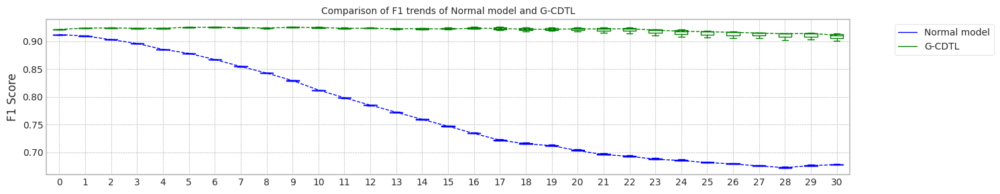

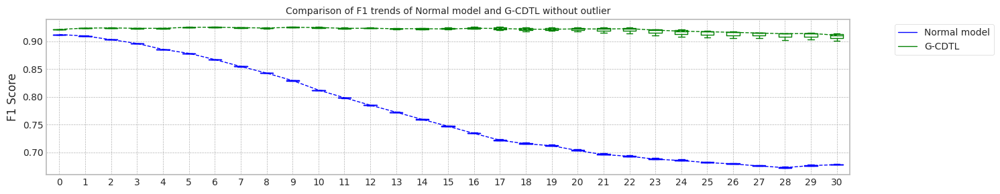

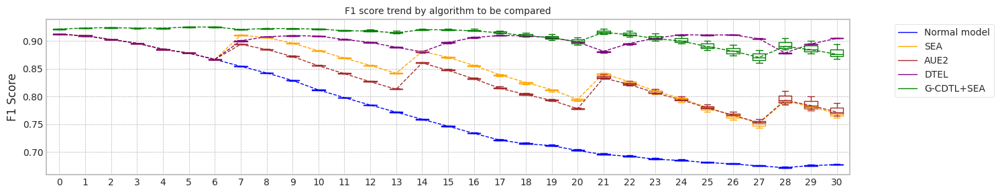

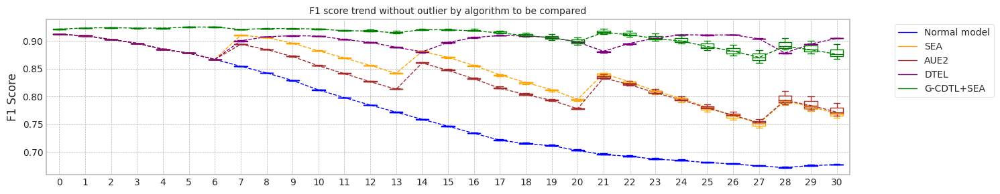

max_mean_trial= 2


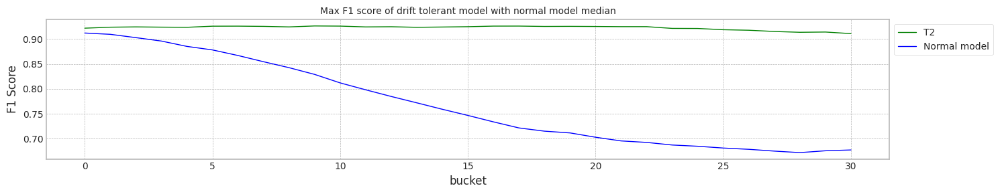

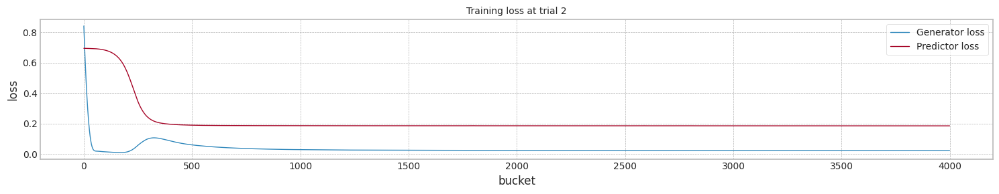

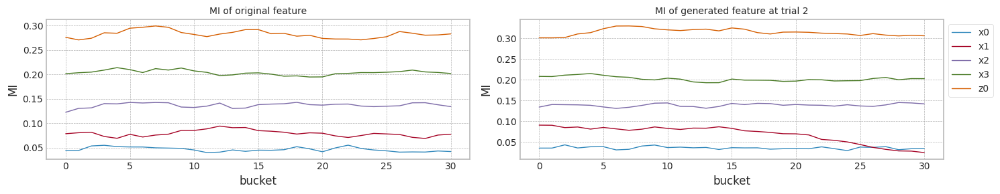

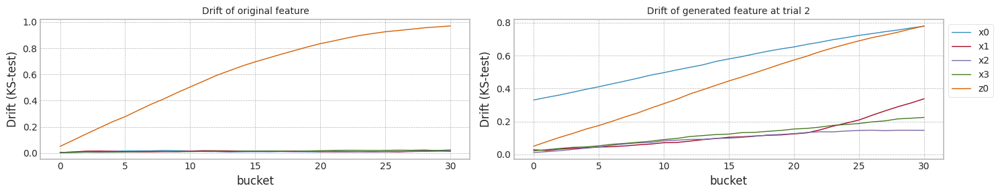

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.769410,0.677472,5.974249
1,1.0,0.912045,0.909440,0.770605,0.678979,5.860160
2,2.0,0.911870,0.909421,0.769558,0.677522,5.822386
3,median,0.912045,0.909440,0.769558,0.677522,5.860160
4,std,0.000158,0.000387,0.000651,0.000856,0.079063


@ G-CDTL+SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.921383,0.923570,0.915226,0.894447,20.986706
1,1.0,0.921326,0.923538,0.908227,0.876203,23.808513
2,2.0,0.921754,0.923741,0.909675,0.868059,21.997348
3,median,0.921383,0.923570,0.909675,0.876203,21.997348
4,std,0.000233,0.000109,0.003694,0.013512,1.429703


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.842679,0.761469,13.509511
1,1.0,0.912045,0.909440,0.846154,0.770774,15.480638
2,2.0,0.911870,0.909421,0.845490,0.769088,16.026163
3,median,0.912045,0.909440,0.845490,0.769088,15.480638
4,std,0.000158,0.000387,0.001845,0.004958,1.323913


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.833872,0.765356,20.138368
1,1.0,0.912045,0.909440,0.838469,0.787957,15.778494
2,2.0,0.911870,0.909421,0.834248,0.772194,16.606262
3,median,0.912045,0.909440,0.834248,0.772194,16.606262
4,std,0.000158,0.000387,0.002553,0.011591,2.315508


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.912186,0.910100,0.899423,0.904800,35.005200
1,1.0,0.912045,0.909440,0.898592,0.905085,41.564833
2,2.0,0.911870,0.909421,0.899089,0.904719,35.127991
3,median,0.912045,0.909440,0.899089,0.904800,35.127991
4,std,0.000158,0.000387,0.000418,0.000192,3.752262


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.921383,0.923570,0.917507,0.900884,5.917967
1,1.0,0.921326,0.923538,0.921088,0.913683,5.869652
2,2.0,0.921754,0.923741,0.922625,0.910864,5.984484
3,median,0.921383,0.923570,0.921088,0.910864,5.917967
4,std,0.000233,0.000109,0.002626,0.006725,0.057656


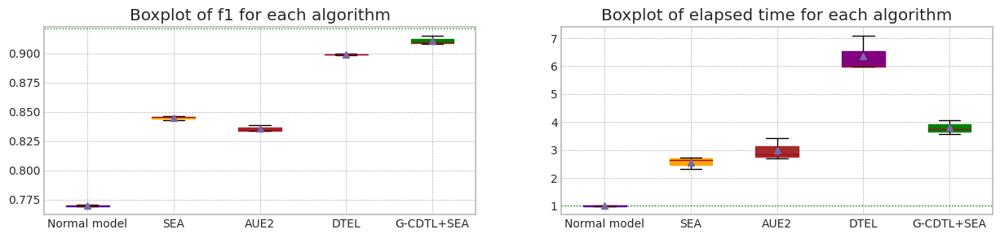

In [ ]:
org_df_rt = {}
sea_df_rt = {}
aue_df_rt = {}
dte_df_rt = {}
gea_df_rt = {}

for RT in range(1,5):
    org_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2('case4',X1, Y1,train_size, test_size,avaible_range = 300,lambda_f2=0.8,trial_count=3,retrain_count=RT,weight_init=True)
    org_df_rt[f'RT{RT}'] = org_df['Mean F1']
    sea_df_rt[f'RT{RT}'] = sea_df['Mean F1']
    aue_df_rt[f'RT{RT}'] = aue_df['Mean F1']
    dte_df_rt[f'RT{RT}'] = dte_df['Mean F1']
    gea_df_rt[f'RT{RT}'] = gea_df['Mean F1']

In [ ]:
org_df1 = pd.DataFrame(org_df_rt)
sea_df1 = pd.DataFrame(sea_df_rt)
aue_df1 = pd.DataFrame(aue_df_rt)
dte_df1 = pd.DataFrame(dte_df_rt)
gea_df1 = pd.DataFrame(gea_df_rt)

In [ ]:

def draw_chart2(axis,legends,title, df,color,showfliers=True):
    if legends == None:
        legends = []

    legends.append((title,color))

    axis.set_xticks([])
    flierprops = dict(marker='.', markerfacecolor=color, markeredgecolor='none')
    if showfliers:
        df[0:df.shape[0]-2].plot.box(ax=axis, flierprops=flierprops,ylabel='F1 Score',fontsize=10,color=color)
    else:
        df[0:df.shape[0]-2].plot.box(ax=axis, showfliers=False,ylabel='F1 Score',fontsize=10,color=color)
    med_df = pd.concat([pd.DataFrame({'med':None},index=[0]), pd.DataFrame({'med':df[0:df.shape[0]-1].median().values})],axis=0).reset_index(drop=True)
    med_df.plot(ax = axis,linestyle='--',linewidth=1,ylabel='F1 Score',fontsize=10,color=color)
    return legends

def set_legend2(axis,legends,title):
    axis.set_title(title,fontdict={'fontsize':10})
    #axis.legend([v for v,c in legends],ncol=len(legends),bbox_to_anchor=(1.05, 1.0), loc='upper left')
    axis.legend([v for v,c in legends],bbox_to_anchor=(1.05, 1.0), loc='upper left')
    leg = axis.get_legend()
    for i,(v,c) in enumerate(legends):
        leg.legendHandles[i].set_color(c)


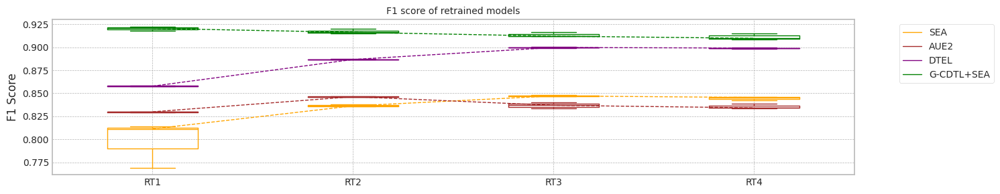

In [ ]:
fig, ax = plt.subplots(figsize=main_figsize)
lg = draw_chart2(ax,None,'SEA',sea_df1,'orange',showfliers=False)
lg = draw_chart2(ax,lg,'AUE2',aue_df1,'brown',showfliers=False)
lg = draw_chart2(ax,lg,'DTEL',dte_df1,'purple',showfliers=False)
lg = draw_chart2(ax,lg,'G-CDTL+SEA',gea_df1,'green',showfliers=False)
#lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)
set_legend2(ax,lg,'F1 score of retrained models')
plt.tight_layout()
plt.show()


## synthetic data의 생성 (Case #5 - Case #1,2,3,4의 상황이 각 feature에 혼재되어 있는 경우)

+ $P_t(y,X) \ne P_{t+w}(y,X) $ 이고 $P_t(y|X) \ne P_{t+w}(y|X) $
+ 전체적으로는 Real concept drift
+ 즉, P(y|X)와 P(X)의 변화가 연관되어 나타남.
+ $x_0$ : No drift
+ $x_1$ : $P_t(y|X) = P_{t+w}(y|X)$ 이면서 $P_t(X) \ne P_{t+w}(X)$ 인 Virtual Drift
+ $x_2$ : $P_t(y|X) \ne P_{t+w}(y|X)$ 이면서 $P_t(X) \ne P_{t+w}(X)$ 인 Real Concept Drift, MI 감소, Drift 증가
+ $x_3$ : $P_t(y|X) \ne P_{t+w}(y|X)$ 이면서 $P_t(X) \ne P_{t+w}(X)$ 인 Real Concept Drift, MI 증가, Drift 증가
+ $z_0$ : $P_t(y|X) \ne P_{t+w}(y|X)$ 이면서 $P_t(X) = P_{t+w}(X)$ 인 Actual Drift, MI 감소, Drift 고정


### Dataset 준비

In [59]:
seed_everything()

data_size = 40000
cor = np.asarray([1.5, 1.2, 0.5 , 0.7, 2.5])

x4 = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    x4[:,ix] = np.random.normal(1,cor_,data_size)

y4_array = []
cor_const = cor[4]
cor_const2 = 3/x4.shape[0]
for ii in range(x4.shape[0]):
    # Case #2, MI의 증감(상대적), Drift의 고정 - z0
    cor[4] = cor[4] - cor_const / x4.shape[0]
    e = np.random.normal(0.0, 2.0)
    # Case #3 MI의 증감(상대적), Drift의 증가 - x3
    e1 = np.random.normal(0.0, 3*cor_const2 * ii)
    x4[ii,3] = x4[ii,3] + e1
    y4_array.append(np.sum(cor * x4[ii])+e)

y4 = [1 if y_ > 5 else 0 for y_ in y4_array]

for i in range(len(y4)):
    #Case #1 MI의 감소, Drift의 증가 - x2
    x4[i,2] = y4[i] + np.random.normal(1,0.5+5*(i/data_size))
    #Case #4 MI의 고정, Drift의 증가 - x1
    x4[i,1] = y4[i] + np.random.normal(0.0 + 4*(i/data_size),cor[1])


### 실험

MI Analysis MI Max 0.14553, Min 0.02121, Mean 0.06553, Std 0.04745
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (39000, 5)
Truncate 8000 rows from live_set (39000, 5)
Search MI & Drift...for X_live_set (31, 9000, 5)


100%|██████████| 31/31 [00:05<00:00,  5.24it/s]


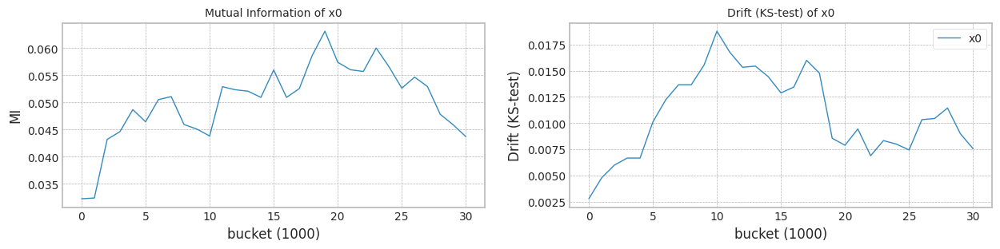

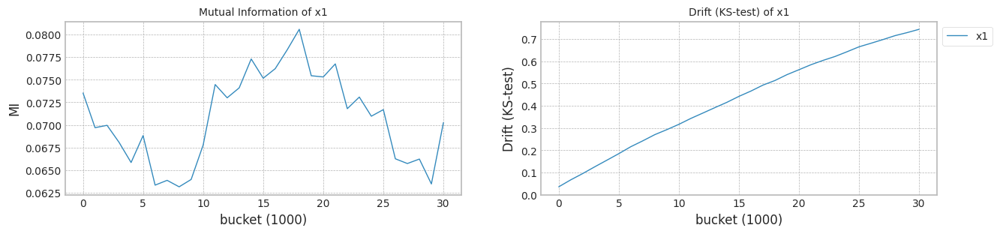

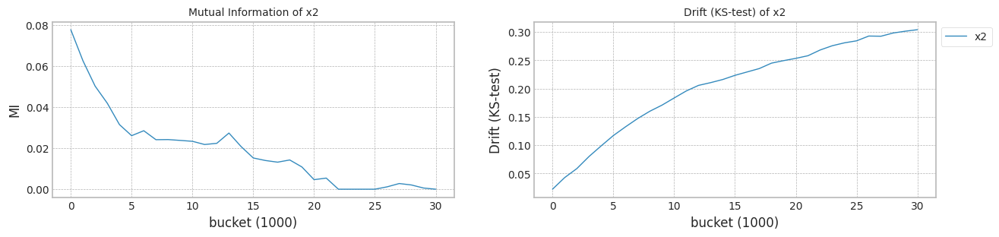

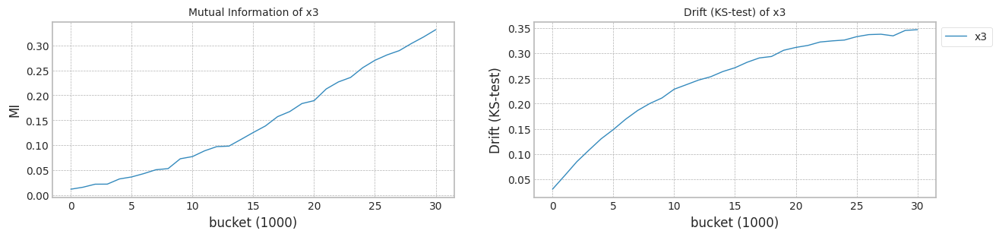

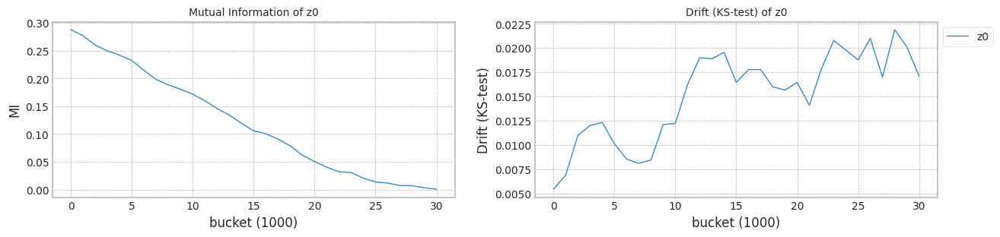

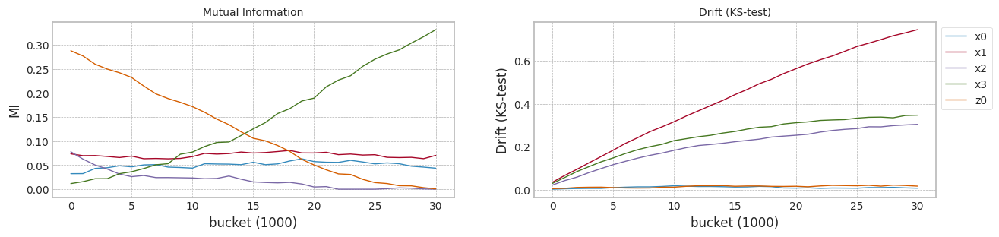

In [60]:
columns=['x0','x1','x2','x3','z0']
X4 = pd.DataFrame(x4,columns=columns)

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X4, y4,train_size, test_size)

In [68]:
bucket_size = 500
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.525799,0.342420,0.402006,0.544992,0.366139,0
1,0.610533,0.497561,0.441322,0.555701,0.662926,0
2,0.556874,0.352571,0.529190,0.605806,0.486574,0
3,0.344341,0.473869,0.616385,0.537806,0.611850,0
4,0.503142,0.533937,0.400930,0.515854,0.487044,0
...,...,...,...,...,...,...
39995,0.333622,0.653571,0.150448,0.657291,0.709407,79
39996,0.358451,1.072290,-0.088287,0.366003,0.695384,79
39997,0.559469,0.978520,0.655799,1.326009,0.504288,79
39998,0.433692,1.055652,0.254999,0.802431,0.762158,79


trial_count: 2
Lambda :  0.9
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-27 12:37:02,943] [INFO] [profiler.py:80:start_profile] Flops profiler started


 14%|█▍        | 283/2000 [00:00<00:04, 368.21it/s]

Early stop: 283
[2023-11-27 12:37:03,718] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1111860000
precision_recall_fscore: (array([0.90056135, 0.90853774]), array([0.87506494, 0.92776699]), array([0.88763009, 0.91805169]), array([3850, 5150]))
Test f1 score: 0.9180516860409261
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.05it/s]


mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8284248581106691
inference_flops: 121365000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-27 12:37:09,933] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:37:09,935] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 12%|█▏        | 244/2000 [00:01<00:12, 135.22it/s]

[2023-11-27 12:37:11,840] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:37:11,841] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 283500000 3858750000 959175000 5101425000
precision_recall_fscore: (array([0.8859335 , 0.92416503]), array([0.89974026, 0.91339806]), array([0.89278351, 0.91875   ]), array([3850, 5150]))
Test f1 score: 0.9187500000000001
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.10it/s]


mean of drift:
x0    0.153853
x1    0.375204
x2    0.293025
x3    0.282204
z0    0.286118
dtype: float64
Mean F1 for all data: 0.831748819393569
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.831748819393569
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-27 12:37:17,982] [INFO] [profiler.py:80:start_profile] Flops profiler started


 18%|█▊        | 364/2000 [00:00<00:04, 400.51it/s]

Early stop: 364
[2023-11-27 12:37:18,896] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1428975000
precision_recall_fscore: (array([0.89872068, 0.90891768]), array([0.87584416, 0.92621359]), array([0.88713496, 0.91748413]), array([3850, 5150]))
Test f1 score: 0.9174841315637622
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.18it/s]


mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8260808195328699
inference_flops: 121365000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-27 12:37:24,947] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:37:24,949] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 12%|█▏        | 240/2000 [00:01<00:13, 133.15it/s]

[2023-11-27 12:37:26,883] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:37:26,884] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 378000000 3795750000 943515000 5117265000
precision_recall_fscore: (array([0.90136693, 0.90757259]), array([0.87350649, 0.92854369]), array([0.88721805, 0.91793838]), array([3850, 5150]))
Test f1 score: 0.9179383818024763
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.07it/s]


mean of drift:
x0    0.104921
x1    0.386541
x2    0.245943
x3    0.292219
z0    0.256642
dtype: float64
Mean F1 for all data: 0.8351918436049243
inference_flops: 609615000
Normal model median        : 0.8272528388217695
Drift tolerant model median: 0.8334703314992467
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.93it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-27 12:37:36,375] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:37:36,378] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 12:37:37,988] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:37:37,989] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:04<00:10,  1.45it/s]

G-CDTL train flops: 50750000 369250000 91785000 511785000


100%|██████████| 31/31 [00:07<00:00,  3.93it/s]


Early stop at  [210]
Train flops  [511785000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8727278970567092
G_CDTL+AUE median: 0.8727278970567092
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:05<00:12,  1.25it/s]

Ensemble_SEA train flops: 108315000


100%|██████████| 31/31 [00:08<00:00,  3.80it/s]


Early stop at  [248]
Train flops  [108315000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8489232264833356
SEA median: 0.8489232264833356
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:04,  2.94it/s]

Ensemble_SEA train flops: 164430000


100%|██████████| 31/31 [00:06<00:00,  4.62it/s]


Early stop at  [377]
Train flops  [164430000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8611824878231585
AUE median: 0.8611824878231585
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.13it/s]

Ensemble_DTEL train flops: 111795000


 55%|█████▍    | 17/31 [00:04<00:05,  2.52it/s]

Ensemble_DTEL train flops: 110490000


100%|██████████| 31/31 [00:07<00:00,  4.41it/s]


Early stop at  [256, 253]
Train flops  [111795000, 110490000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8663552105857147
DTEL median: 0.8663552105857147
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.20it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-27 12:38:06,195] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:38:06,197] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 12:38:07,691] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:38:07,692] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 17/31 [00:04<00:07,  1.97it/s]

G-CDTL train flops: 33250000 344750000 85695000 463695000


100%|██████████| 31/31 [00:07<00:00,  4.11it/s]


Early stop at  [196]
Train flops  [463695000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8741571419164584
G_CDTL+AUE median: 0.8734425194865838
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:04,  3.05it/s]

Ensemble_SEA train flops: 152250000


100%|██████████| 31/31 [00:06<00:00,  4.63it/s]


Early stop at  [349]
Train flops  [152250000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8472621627690508
SEA median: 0.8480926946261932
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:04,  3.10it/s]

Ensemble_SEA train flops: 143550000


100%|██████████| 31/31 [00:06<00:00,  4.64it/s]


Early stop at  [329]
Train flops  [143550000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8606862799455884
AUE median: 0.8609343838843735
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.13it/s]

Ensemble_DTEL train flops: 126585000


 52%|█████▏    | 16/31 [00:04<00:07,  2.06it/s]

Ensemble_DTEL train flops: 91785000


100%|██████████| 31/31 [00:07<00:00,  4.40it/s]


Early stop at  [290, 210]
Train flops  [126585000, 91785000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8674924064762914
DTEL median: 0.8669238085310031


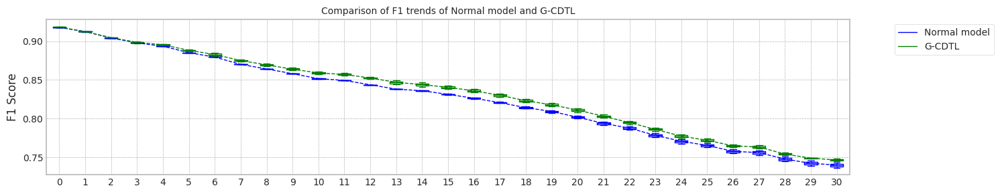

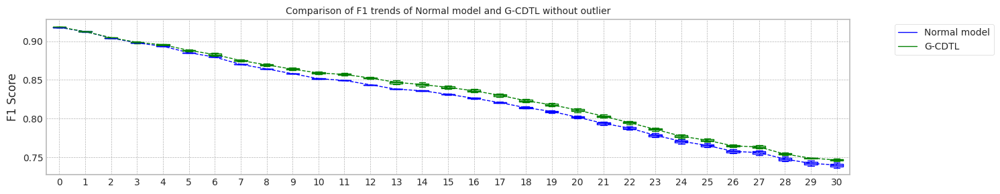

max_mean_trial= 1


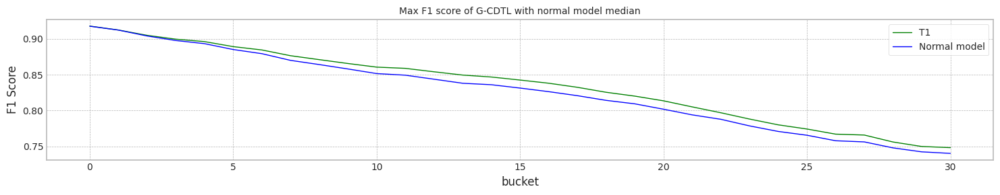

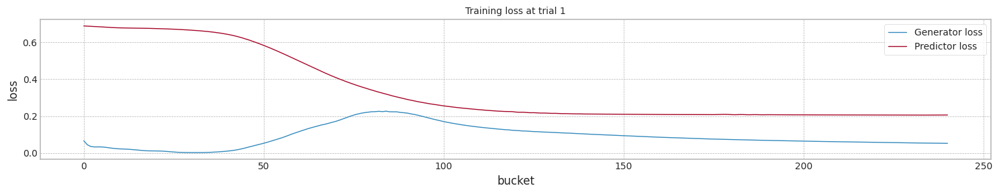

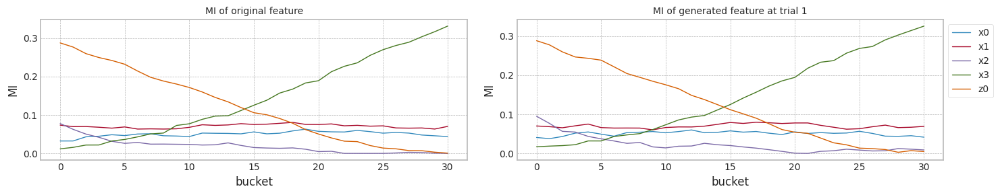

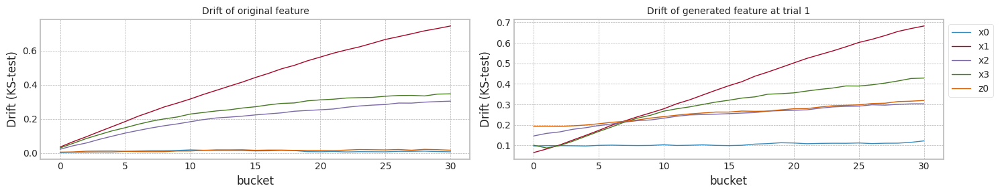

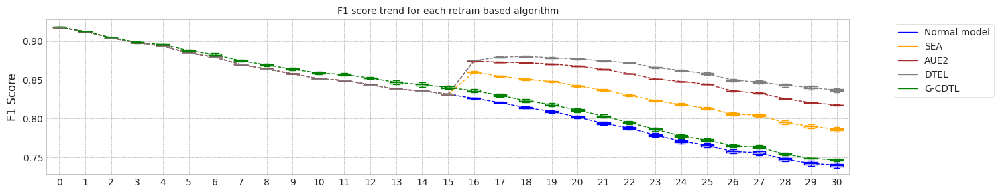

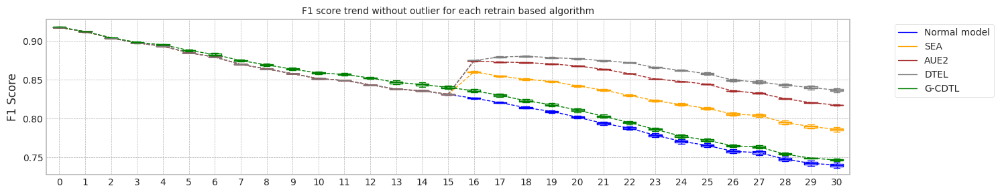

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.115119814872742
Base flops (inference flops of normal model, median): 121365000.0


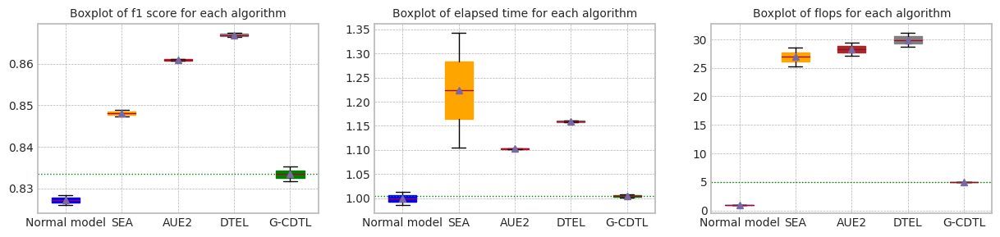

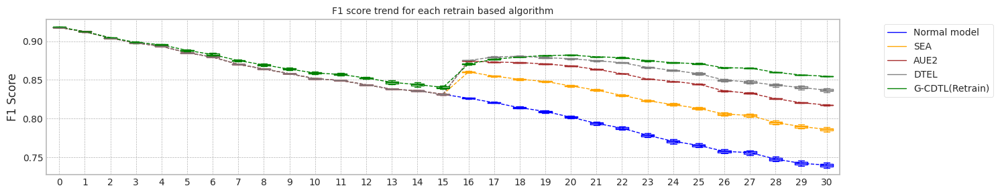

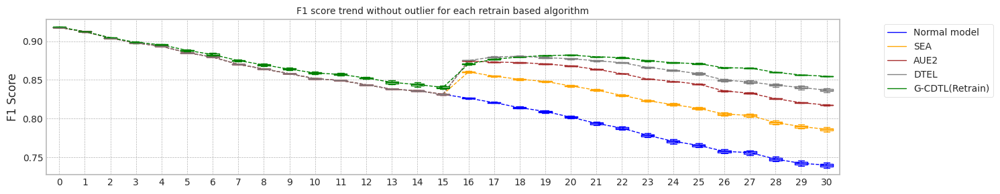

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.115119814872742
Base flops (train + inference flops of normal model, median): 1391782500.0


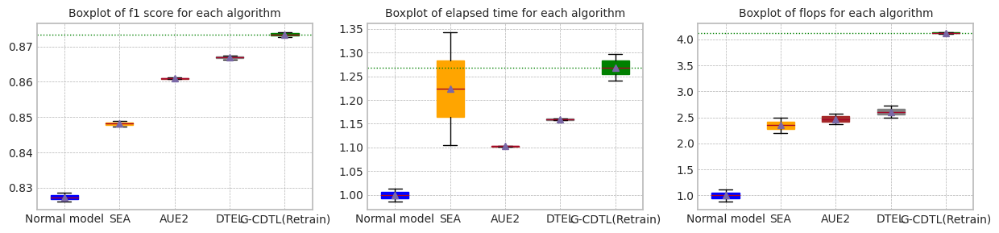

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.115119814872742


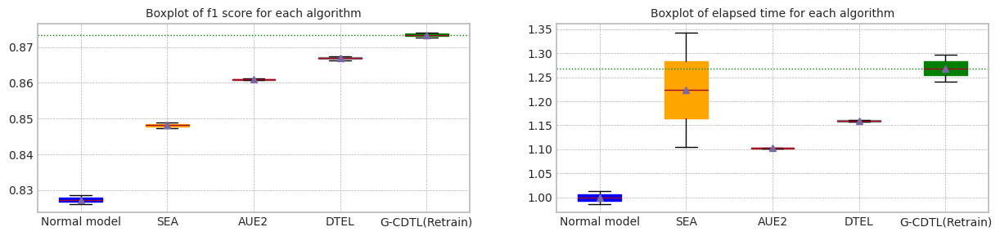

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.828425,0.743448,6.198299,1.111860e+09,121365000.0,1.233225e+09
1,1.0,0.917484,0.911968,0.826081,0.736690,6.031940,1.428975e+09,121365000.0,1.550340e+09
2,median,0.917768,0.912360,0.827253,0.740069,6.115120,1.270418e+09,121365000.0,1.391782e+09
3,std,0.000401,0.000554,0.001657,0.004778,0.117633,2.242342e+08,0.0,2.242342e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918750,0.912191,0.831749,0.744959,6.123147,5.101425e+09,609615000.0,5.711040e+09
1,1.0,0.917938,0.912449,0.835192,0.748113,6.166202,5.117265e+09,609615000.0,5.726880e+09
2,median,0.918344,0.912320,0.833470,0.746536,6.144675,5.109345e+09,609615000.0,5.718960e+09
3,std,0.000574,0.000183,0.002435,0.002231,0.030445,1.120057e+07,0.0,1.120057e+07


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.848923,0.789157,8.214568,1.537290e+09,1.525545e+09,3.062835e+09
1,1.0,0.917484,0.911968,0.847262,0.783176,6.751840,1.581225e+09,1.886595e+09,3.467820e+09
2,median,0.917768,0.912360,0.848093,0.786166,7.483204,1.559258e+09,1.706070e+09,3.265328e+09
3,std,0.000401,0.000554,0.001175,0.004229,1.034305,3.106674e+07,2.553009e+08,2.863676e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.861182,0.818293,6.750205,1.593405e+09,1.703025e+09,3.296430e+09
1,1.0,0.917484,0.911968,0.860686,0.816880,6.730252,1.572525e+09,1.999260e+09,3.571785e+09
2,median,0.917768,0.912360,0.860934,0.817586,6.740228,1.582965e+09,1.851142e+09,3.434108e+09
3,std,0.000401,0.000554,0.000351,0.000999,0.014109,1.476439e+07,2.094698e+08,1.947054e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.866355,0.834286,7.073881,1.651260e+09,1.823520e+09,3.474780e+09
1,1.0,0.917484,0.911968,0.867492,0.839338,7.100477,1.647345e+09,2.136720e+09,3.784065e+09
2,median,0.917768,0.912360,0.866924,0.836812,7.087179,1.649302e+09,1.980120e+09,3.629422e+09
3,std,0.000401,0.000554,0.000804,0.003573,0.018806,2.768323e+06,2.214658e+08,2.186975e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918750,0.912191,0.872728,0.854507,7.932912,5.629050e+09,134325000.0,5.763375e+09
1,1.0,0.917938,0.912449,0.874157,0.855023,7.582329,5.580960e+09,134325000.0,5.715285e+09
2,median,0.918344,0.912320,0.873443,0.854765,7.757620,5.605005e+09,134325000.0,5.739330e+09
3,std,0.000574,0.000183,0.001011,0.000365,0.247900,3.400477e+07,0.0,3.400477e+07


In [74]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case5',X1, Y1,train_size, test_size,avaible_range = 400,
                                                            lambda_f2=0.9,trial_count=2,lr_g=0.004,
                                                            retrain_count=1,weight_init=True)

trial_count: 5
Lambda :  0.9
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-26 01:32:41,621] [INFO] [profiler.py:80:start_profile] Flops profiler started


 14%|█▍        | 283/2000 [00:03<00:21, 81.50it/s] 

Early stop: 283
[2023-11-26 01:32:45,100] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1111860000
precision_recall_fscore: (array([0.90056135, 0.90853774]), array([0.87506494, 0.92776699]), array([0.88763009, 0.91805169]), array([3850, 5150]))
Test f1 score: 0.9180516860409261
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.48it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8284248581106691
inference_flops: 121365000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:32:50,824] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:32:50,826] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:11<00:00, 173.29it/s]

[2023-11-26 01:33:02,373] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:33:02,374] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.90427807, 0.91102662]), array([0.87844156, 0.93048544]), array([0.8911726 , 0.92065322]), array([3850, 5150]))
Test f1 score: 0.9206532180595582
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.26it/s]

mean of drift:
x0    0.524520
x1    0.481047
x2    0.742315
x3    0.154043
z0    0.054039
dtype: float64
Mean F1 for all data: 0.8401892584244594
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-26 01:33:08,331] [INFO] [profiler.py:80:start_profile] Flops profiler started



 18%|█▊        | 364/2000 [00:00<00:03, 500.51it/s]

Early stop: 364
[2023-11-26 01:33:09,066] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1428975000
precision_recall_fscore: (array([0.89872068, 0.90891768]), array([0.87584416, 0.92621359]), array([0.88713496, 0.91748413]), array([3850, 5150]))
Test f1 score: 0.9174841315637622
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.44it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8260808195328699
inference_flops: 121365000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:33:14,820] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:33:14,822] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:11<00:00, 168.74it/s]

[2023-11-26 01:33:26,681] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:33:26,682] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89538542, 0.91612032]), array([0.88701299, 0.92252427]), array([0.89117954, 0.91931115]), array([3850, 5150]))
Test f1 score: 0.919311145510836
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.46it/s]

mean of drift:
x0    0.416523
x1    0.338885
x2    0.520057
x3    0.227215
z0    0.118667
dtype: float64
Mean F1 for all data: 0.8435698956849597
inference_flops: 609615000
Normal model median        : 0.8272528388217695
Drift tolerant model median: 0.8418795770547095
######################### Retrain 1 Trial 2 for Normal model ###########################
cuda:0
[2023-11-26 01:33:32,425] [INFO] [profiler.py:80:start_profile] Flops profiler started



 21%|██        | 421/2000 [00:00<00:03, 504.66it/s]

Early stop: 421
[2023-11-26 01:33:33,265] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1652130000
precision_recall_fscore: (array([0.89761905, 0.91245211]), array([0.8812987 , 0.92485437]), array([0.88938401, 0.91861138]), array([3850, 5150]))
Test f1 score: 0.9186113789778207
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.37it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8463085799286945
inference_flops: 121365000
######################### Retrain 1 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:33:39,104] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:33:39,105] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:11<00:00, 168.09it/s]

[2023-11-26 01:33:51,012] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:33:51,013] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89173789, 0.92080171]), array([0.89428571, 0.91883495]), array([0.89300999, 0.91981728]), array([3850, 5150]))
Test f1 score: 0.9198172805909224
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.38it/s]

mean of drift:
x0    0.357720
x1    0.529108
x2    0.783882
x3    0.354287
z0    0.033842
dtype: float64
Mean F1 for all data: 0.8208615825464842
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 1 Trial 3 for Normal model ###########################
cuda:0
[2023-11-26 01:33:56,850] [INFO] [profiler.py:80:start_profile] Flops profiler started



 11%|█▏        | 228/2000 [00:00<00:03, 495.60it/s]

Early stop: 228
[2023-11-26 01:33:57,316] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 896535000
precision_recall_fscore: (array([0.89652428, 0.90995985]), array([0.87766234, 0.92427184]), array([0.88699304, 0.91706001]), array([3850, 5150]))
Test f1 score: 0.9170600134861766
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.38it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8244743311043818
inference_flops: 121365000
######################### Retrain 1 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:34:03,145] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:34:03,147] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:11<00:00, 166.73it/s]

[2023-11-26 01:34:15,149] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:34:15,151] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89086229, 0.92394917]), array([0.89896104, 0.9176699 ]), array([0.89489334, 0.92079883]), array([3850, 5150]))
Test f1 score: 0.920798830979055
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.36it/s]


mean of drift:
x0    0.132810
x1    0.571502
x2    0.392459
x3    0.378072
z0    0.185287
dtype: float64
Mean F1 for all data: 0.851497482919537
inference_flops: 609615000
Normal model median        : 0.8272528388217695
Drift tolerant model median: 0.8418795770547095
######################### Retrain 1 Trial 4 for Normal model ###########################
cuda:0
[2023-11-26 01:34:20,998] [INFO] [profiler.py:80:start_profile] Flops profiler started


 18%|█▊        | 356/2000 [00:00<00:03, 501.03it/s]

Early stop: 356
[2023-11-26 01:34:21,714] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1397655000
precision_recall_fscore: (array([0.90252417, 0.90731615]), array([0.87298701, 0.92951456]), array([0.8875099 , 0.91828122]), array([3850, 5150]))
Test f1 score: 0.9182812200268559
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.46it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8332321922969802
inference_flops: 121365000
######################### Retrain 1 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:34:27,451] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:34:27,453] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 166.64it/s]

[2023-11-26 01:34:39,463] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:34:39,465] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89719381, 0.91729323]), array([0.88857143, 0.9238835 ]), array([0.8928618 , 0.92057657]), array([3850, 5150]))
Test f1 score: 0.9205765696043339
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.41it/s]


mean of drift:
x0    0.132079
x1    0.427753
x2    0.407283
x3    0.144828
z0    0.053394
dtype: float64
Mean F1 for all data: 0.8334191606447507
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:02,  5.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:34:48,298] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:34:48,301] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:34:49,424] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:34:49,426] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 17/31 [00:04<00:05,  2.35it/s]

G-CDTL train flops: 350000000 87000000 437000000


100%|██████████| 31/31 [00:06<00:00,  4.48it/s]


Early stop at  [199]
Train flops  [437000000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8723999805822162
G_CDTL+AUE median: 0.8723999805822162
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:04,  3.28it/s]

Ensemble_SEA train flops: 185745000


100%|██████████| 31/31 [00:06<00:00,  4.98it/s]


Early stop at  [426]
Train flops  [185745000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8479989458807493
SEA median: 0.8479989458807493
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:04<00:06,  2.01it/s]

Ensemble_SEA train flops: 458055000


100%|██████████| 31/31 [00:07<00:00,  4.32it/s]


Early stop at  [1052]
Train flops  [458055000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8614918644742823
AUE median: 0.8614918644742823
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:02,  5.42it/s]

Ensemble_DTEL train flops: 120930000


 55%|█████▍    | 17/31 [00:03<00:04,  2.92it/s]

Ensemble_DTEL train flops: 110490000


100%|██████████| 31/31 [00:06<00:00,  4.82it/s]


Early stop at  [277, 253]
Train flops  [120930000, 110490000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8663552105857147
DTEL median: 0.8663552105857147
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.23it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:35:15,283] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:35:15,285] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:35:16,139] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:35:16,141] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 17/31 [00:04<00:05,  2.68it/s]

G-CDTL train flops: 259000000 64380000 323380000


100%|██████████| 31/31 [00:06<00:00,  4.62it/s]


Early stop at  [147]
Train flops  [323380000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8706012227186127
G_CDTL+AUE median: 0.8715006016504145
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:04,  2.88it/s]

Ensemble_SEA train flops: 233160000


100%|██████████| 31/31 [00:06<00:00,  4.77it/s]


Early stop at  [535]
Train flops  [233160000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8461296009520172
SEA median: 0.8470642734163832
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:03,  3.89it/s]

Ensemble_SEA train flops: 99180000


100%|██████████| 31/31 [00:06<00:00,  5.05it/s]


Early stop at  [227]
Train flops  [99180000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8603902240130717
AUE median: 0.860941044243677
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:02,  5.44it/s]

Ensemble_DTEL train flops: 192270000


 55%|█████▍    | 17/31 [00:04<00:05,  2.64it/s]

Ensemble_DTEL train flops: 91785000


100%|██████████| 31/31 [00:06<00:00,  4.66it/s]


Early stop at  [441, 210]
Train flops  [192270000, 91785000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8674924064762914
DTEL median: 0.8669238085310031
######################### Retrain 1 Trial 2 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:35:41,409] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:35:41,412] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:35:42,593] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:35:42,594] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 17/31 [00:04<00:06,  2.27it/s]

G-CDTL train flops: 367500000 91350000 458850000


100%|██████████| 31/31 [00:07<00:00,  4.40it/s]


Early stop at  [209]
Train flops  [458850000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8675004365819626
G_CDTL+AUE median: 0.8706012227186127
######################### Retrain 1 Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:04<00:05,  2.54it/s]

Ensemble_SEA train flops: 313200000


100%|██████████| 31/31 [00:06<00:00,  4.61it/s]


Early stop at  [719]
Train flops  [313200000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8596390065276124
SEA median: 0.8479989458807493
######################### Retrain 1 Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:03,  3.50it/s]

Ensemble_SEA train flops: 142680000


100%|██████████| 31/31 [00:06<00:00,  4.92it/s]


Early stop at  [327]
Train flops  [142680000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8655680223666092
AUE median: 0.8614918644742823
######################### Retrain 1 Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:02,  5.44it/s]

Ensemble_DTEL train flops: 127455000


 55%|█████▍    | 17/31 [00:03<00:05,  2.74it/s]

Ensemble_DTEL train flops: 128760000


100%|██████████| 31/31 [00:06<00:00,  4.72it/s]


Early stop at  [292, 295]
Train flops  [127455000, 128760000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8703510854597312
DTEL median: 0.8674924064762914
######################### Retrain 1 Trial 3 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.33it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:36:08,242] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:36:08,245] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:36:09,575] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:36:09,577] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 17/31 [00:04<00:06,  2.12it/s]

G-CDTL train flops: 406000000 100920000 506920000


100%|██████████| 31/31 [00:07<00:00,  4.31it/s]


Early stop at  [231]
Train flops  [506920000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8735980783711772
G_CDTL+AUE median: 0.8715006016504145
######################### Retrain 1 Trial 3 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:03,  3.91it/s]

Ensemble_SEA train flops: 92220000


100%|██████████| 31/31 [00:06<00:00,  5.07it/s]


Early stop at  [211]
Train flops  [92220000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8460522422215461
SEA median: 0.8470642734163832
######################### Retrain 1 Trial 3 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:04,  3.04it/s]

Ensemble_SEA train flops: 206190000


100%|██████████| 31/31 [00:06<00:00,  4.79it/s]


Early stop at  [473]
Train flops  [206190000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8606447400115024
AUE median: 0.8610683022428923
######################### Retrain 1 Trial 3 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:04<00:05,  2.47it/s]

Ensemble_DTEL train flops: 317115000
Ensemble_DTEL train flops: 2175000


100%|██████████| 31/31 [00:06<00:00,  4.57it/s]


Early stop at  [728, 4]
Train flops  [317115000, 2175000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8253354317117381
DTEL median: 0.8669238085310031
######################### Retrain 1 Trial 4 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:02,  5.50it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:36:34,934] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:36:34,937] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:36:36,386] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:36:36,387] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 17/31 [00:04<00:06,  2.03it/s]

G-CDTL train flops: 441000000 109620000 550620000


100%|██████████| 31/31 [00:07<00:00,  4.24it/s]


Early stop at  [251]
Train flops  [550620000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8727011407472205
G_CDTL+AUE median: 0.8723999805822162
######################### Retrain 1 Trial 4 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:03<00:03,  3.87it/s]

Ensemble_SEA train flops: 110490000


100%|██████████| 31/31 [00:06<00:00,  5.09it/s]


Early stop at  [253]
Train flops  [110490000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8510231192336455
SEA median: 0.8479989458807493
######################### Retrain 1 Trial 4 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:04<00:06,  2.12it/s]

Ensemble_SEA train flops: 418905000


100%|██████████| 31/31 [00:07<00:00,  4.38it/s]


Early stop at  [962]
Train flops  [418905000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8625015959349268
AUE median: 0.8614918644742823
######################### Retrain 1 Trial 4 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:02,  5.46it/s]

Ensemble_DTEL train flops: 107010000


 55%|█████▍    | 17/31 [00:03<00:04,  3.23it/s]

Ensemble_DTEL train flops: 82650000


100%|██████████| 31/31 [00:06<00:00,  4.90it/s]


Early stop at  [245, 189]
Train flops  [107010000, 82650000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8682938267315761
DTEL median: 0.8674924064762914


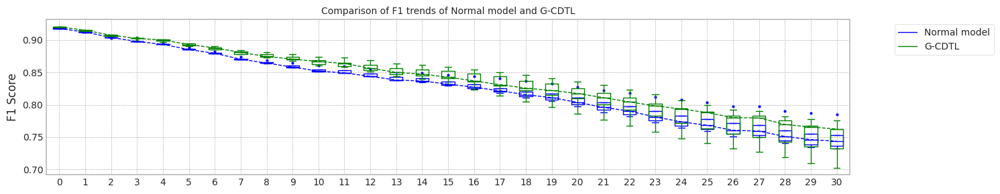

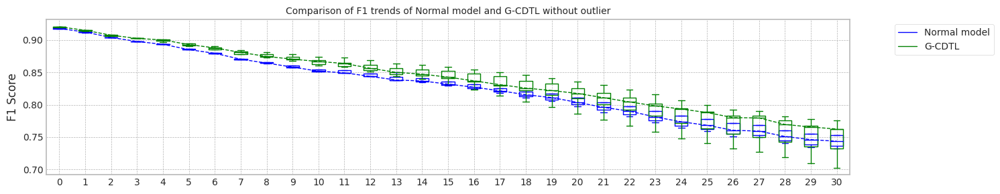

max_mean_trial= 3


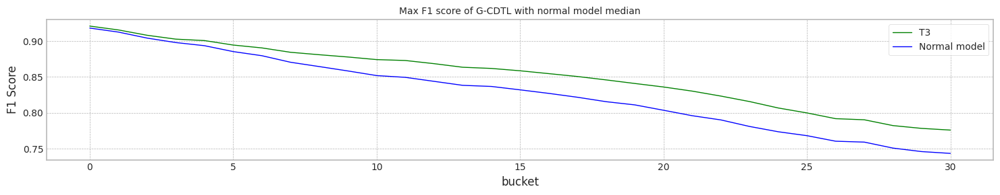

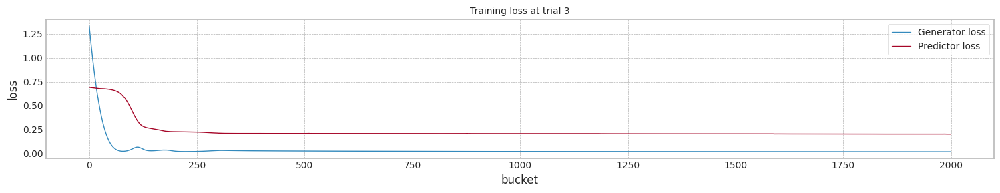

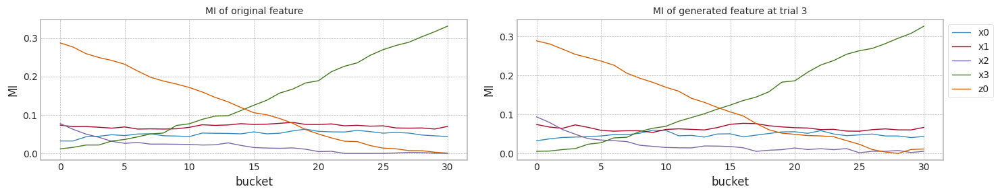

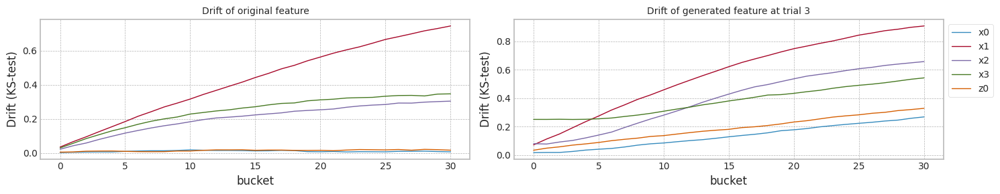

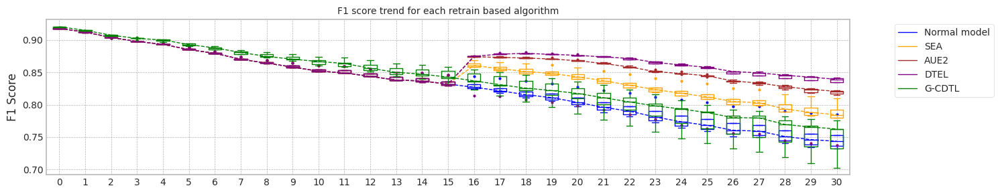

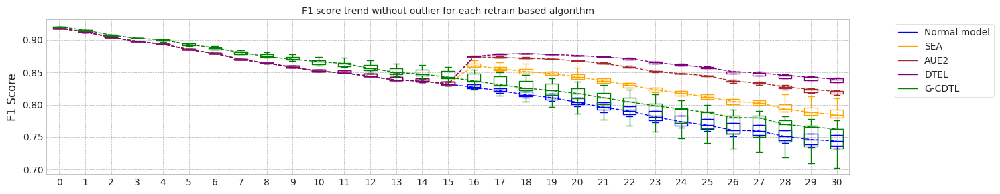

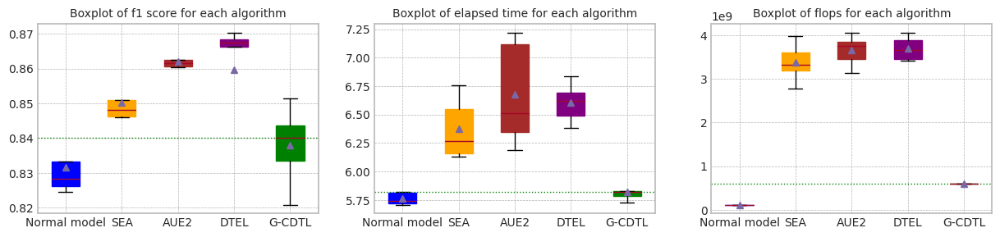

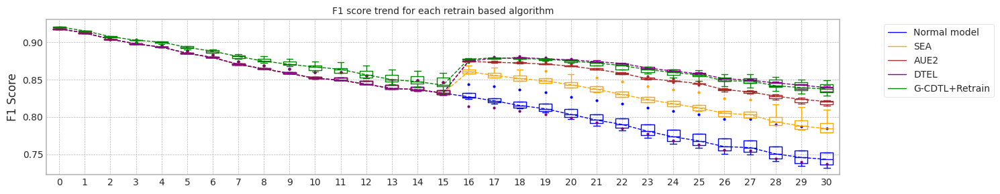

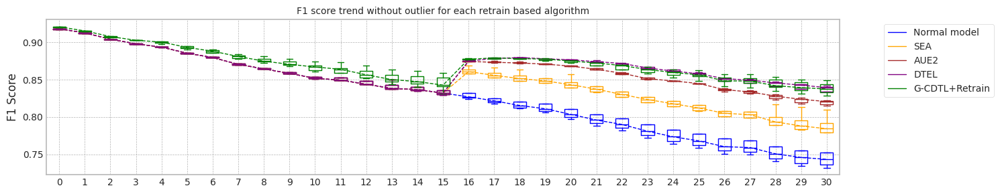

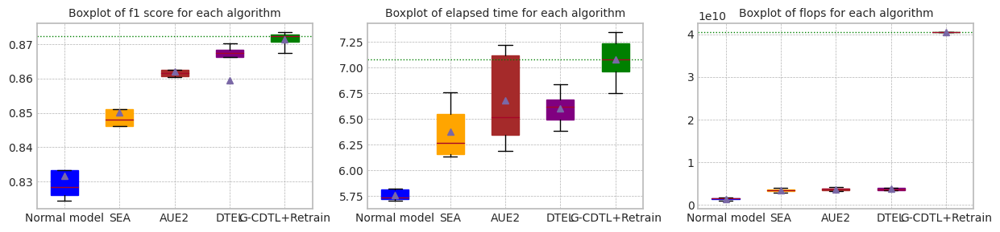

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.828425,0.743448,5.708410,1.111860e+09,121365000.0,1.233225e+09
1,1.0,0.917484,0.911968,0.826081,0.736690,5.739372,1.428975e+09,121365000.0,1.550340e+09
2,2.0,0.918611,0.913312,0.846309,0.784911,5.821576,1.652130e+09,121365000.0,1.773495e+09
3,3.0,0.917060,0.911745,0.824474,0.732351,5.811841,8.965350e+08,121365000.0,1.017900e+09
4,4.0,0.918281,0.912449,0.833232,0.752415,5.721367,1.397655e+09,121365000.0,1.519020e+09
5,median,0.918052,0.912449,0.828425,0.743448,5.739372,1.397655e+09,121365000.0,1.519020e+09
6,std,0.000623,0.000625,0.008807,0.020954,0.052577,2.950908e+08,0.0,2.950908e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920653,0.915697,0.840189,0.762458,5.939975,3.933000e+10,609615000.0,3.993962e+10
1,1.0,0.919311,0.913909,0.843570,0.762401,5.724488,3.933000e+10,609615000.0,3.993962e+10
2,2.0,0.919817,0.914225,0.820862,0.702603,5.818666,3.933000e+10,609615000.0,3.993962e+10
3,3.0,0.920799,0.915430,0.851497,0.775919,5.830055,3.933000e+10,609615000.0,3.993962e+10
4,4.0,0.920577,0.915182,0.833419,0.732372,5.781637,3.933000e+10,609615000.0,3.993962e+10
5,median,0.920577,0.915182,0.840189,0.762401,5.818666,3.933000e+10,609615000.0,3.993962e+10
6,std,0.000640,0.000780,0.011540,0.029569,0.079193,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.847999,0.784415,6.270238,1.583400e+09,1.602975e+09,3.186375e+09
1,1.0,0.917484,0.911968,0.846130,0.779643,6.549807,1.630815e+09,1.967505e+09,3.598320e+09
2,2.0,0.918611,0.913312,0.859639,0.809612,6.761279,1.710855e+09,2.270700e+09,3.981555e+09
3,3.0,0.917060,0.911745,0.846052,0.779585,6.158970,1.489875e+09,1.294125e+09,2.784000e+09
4,4.0,0.918281,0.912449,0.851023,0.791941,6.132261,1.508145e+09,1.813515e+09,3.321660e+09
5,median,0.918052,0.912449,0.847999,0.784415,6.270238,1.583400e+09,1.813515e+09,3.321660e+09
6,std,0.000623,0.000625,0.005665,0.012557,0.272183,9.068597e+07,3.687830e+08,4.487439e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.861492,0.821111,7.221585,1.855710e+09,1.996650e+09,3.852360e+09
1,1.0,0.917484,0.911968,0.860390,0.815500,6.186658,1.496835e+09,1.954890e+09,3.451725e+09
2,2.0,0.918611,0.913312,0.865568,0.822711,6.346753,1.540335e+09,2.221545e+09,3.761880e+09
3,3.0,0.917060,0.911745,0.860645,0.816886,6.514020,1.603845e+09,1.529460e+09,3.133305e+09
4,4.0,0.918281,0.912449,0.862502,0.820704,7.119842,1.816560e+09,2.243295e+09,4.059855e+09
5,median,0.918052,0.912449,0.861492,0.820704,6.514020,1.603845e+09,1.996650e+09,3.761880e+09
6,std,0.000623,0.000625,0.002097,0.003046,0.466031,1.634580e+08,2.877247e+08,3.632210e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.866355,0.834286,6.490578,1.629075e+09,1.832655e+09,3.461730e+09
1,1.0,0.917484,0.911968,0.867492,0.839338,6.691520,1.681710e+09,2.202405e+09,3.884115e+09
2,2.0,0.918611,0.913312,0.870351,0.842189,6.618096,1.653870e+09,2.397720e+09,4.051590e+09
3,3.0,0.917060,0.911745,0.825335,0.737577,6.836108,1.716945e+09,1.705200e+09,3.422145e+09
4,4.0,0.918281,0.912449,0.868294,0.840458,6.386142,1.587315e+09,2.076690e+09,3.664005e+09
5,median,0.918052,0.912449,0.867492,0.839338,6.618096,1.653870e+09,2.076690e+09,3.664005e+09
6,std,0.000623,0.000625,0.019191,0.045483,0.174684,4.949203e+07,2.787136e+08,2.705234e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920653,0.915697,0.872400,0.848737,6.961087,3.976700e+10,698490000.0,4.046549e+10
1,1.0,0.919311,0.913909,0.870601,0.837430,6.753155,3.965338e+10,698490000.0,4.035187e+10
2,2.0,0.919817,0.914225,0.867500,0.828727,7.079192,3.978885e+10,698490000.0,4.048734e+10
3,3.0,0.920799,0.915430,0.873598,0.833449,7.237100,3.983692e+10,698490000.0,4.053541e+10
4,4.0,0.920577,0.915182,0.872701,0.843839,7.345299,3.988062e+10,698490000.0,4.057911e+10
5,median,0.920577,0.915182,0.872400,0.837430,7.079192,3.978885e+10,698490000.0,4.048734e+10
6,std,0.000640,0.000780,0.002417,0.007991,0.232334,8.587912e+07,0.0,8.587912e+07


trial_count: 5
Lambda :  0.9
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-11-26 01:37:15,382] [INFO] [profiler.py:80:start_profile] Flops profiler started


 14%|█▍        | 283/2000 [00:00<00:03, 482.25it/s]

Early stop: 283
[2023-11-26 01:37:15,975] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1111860000
precision_recall_fscore: (array([0.90056135, 0.90853774]), array([0.87506494, 0.92776699]), array([0.88763009, 0.91805169]), array([3850, 5150]))
Test f1 score: 0.9180516860409261
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.07it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8284248581106691
inference_flops: 121365000
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:37:22,165] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:37:22,167] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 161.02it/s]

[2023-11-26 01:37:34,595] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:37:34,597] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.90427807, 0.91102662]), array([0.87844156, 0.93048544]), array([0.8911726 , 0.92065322]), array([3850, 5150]))
Test f1 score: 0.9206532180595582
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.29it/s]

mean of drift:
x0    0.524520
x1    0.481047
x2    0.742315
x3    0.154043
z0    0.054039
dtype: float64
Mean F1 for all data: 0.8401892584244594
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-11-26 01:37:40,526] [INFO] [profiler.py:80:start_profile] Flops profiler started



 18%|█▊        | 364/2000 [00:00<00:03, 478.95it/s]

Early stop: 364
[2023-11-26 01:37:41,292] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1428975000
precision_recall_fscore: (array([0.89872068, 0.90891768]), array([0.87584416, 0.92621359]), array([0.88713496, 0.91748413]), array([3850, 5150]))
Test f1 score: 0.9174841315637622
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.28it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8260808195328699
inference_flops: 121365000
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:37:47,240] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-26 01:37:47,243] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 159.73it/s]

[2023-11-26 01:37:59,772] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:37:59,775] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89538542, 0.91612032]), array([0.88701299, 0.92252427]), array([0.89117954, 0.91931115]), array([3850, 5150]))
Test f1 score: 0.919311145510836
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.29it/s]

mean of drift:
x0    0.416523
x1    0.338885
x2    0.520057
x3    0.227215
z0    0.118667
dtype: float64
Mean F1 for all data: 0.8435698956849597
inference_flops: 609615000
Normal model median        : 0.8272528388217695
Drift tolerant model median: 0.8418795770547095
######################### Retrain 2 Trial 2 for Normal model ###########################
cuda:0
[2023-11-26 01:38:05,707] [INFO] [profiler.py:80:start_profile] Flops profiler started



 21%|██        | 421/2000 [00:00<00:03, 468.55it/s]

Early stop: 421
[2023-11-26 01:38:06,611] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1652130000
precision_recall_fscore: (array([0.89761905, 0.91245211]), array([0.8812987 , 0.92485437]), array([0.88938401, 0.91861138]), array([3850, 5150]))
Test f1 score: 0.9186113789778207
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.41it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8463085799286945
inference_flops: 121365000
######################### Retrain 2 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:38:12,413] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:38:12,416] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 157.20it/s]

[2023-11-26 01:38:25,146] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:38:25,147] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89173789, 0.92080171]), array([0.89428571, 0.91883495]), array([0.89300999, 0.91981728]), array([3850, 5150]))
Test f1 score: 0.9198172805909224
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.23it/s]

mean of drift:
x0    0.357720
x1    0.529108
x2    0.783882
x3    0.354287
z0    0.033842
dtype: float64
Mean F1 for all data: 0.8208615825464842
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 2 Trial 3 for Normal model ###########################
cuda:0
[2023-11-26 01:38:31,147] [INFO] [profiler.py:80:start_profile] Flops profiler started



 11%|█▏        | 228/2000 [00:00<00:03, 469.39it/s]

Early stop: 228
[2023-11-26 01:38:31,639] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 896535000
precision_recall_fscore: (array([0.89652428, 0.90995985]), array([0.87766234, 0.92427184]), array([0.88699304, 0.91706001]), array([3850, 5150]))
Test f1 score: 0.9170600134861766
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.37it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8244743311043818
inference_flops: 121365000
######################### Retrain 2 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:38:37,478] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:38:37,479] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 158.71it/s]

[2023-11-26 01:38:50,088] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:38:50,089] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89086229, 0.92394917]), array([0.89896104, 0.9176699 ]), array([0.89489334, 0.92079883]), array([3850, 5150]))
Test f1 score: 0.920798830979055
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.33it/s]


mean of drift:
x0    0.132810
x1    0.571502
x2    0.392459
x3    0.378072
z0    0.185287
dtype: float64
Mean F1 for all data: 0.851497482919537
inference_flops: 609615000
Normal model median        : 0.8272528388217695
Drift tolerant model median: 0.8418795770547095
######################### Retrain 2 Trial 4 for Normal model ###########################
cuda:0
[2023-11-26 01:38:55,967] [INFO] [profiler.py:80:start_profile] Flops profiler started


 18%|█▊        | 356/2000 [00:00<00:03, 454.70it/s]

Early stop: 356
[2023-11-26 01:38:56,756] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1397655000
precision_recall_fscore: (array([0.90252417, 0.90731615]), array([0.87298701, 0.92951456]), array([0.8875099 , 0.91828122]), array([3850, 5150]))
Test f1 score: 0.9182812200268559
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.41it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8332321922969802
inference_flops: 121365000
######################### Retrain 2 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:39:02,556] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-26 01:39:02,559] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 158.57it/s]

[2023-11-26 01:39:15,179] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:39:15,180] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89719381, 0.91729323]), array([0.88857143, 0.9238835 ]), array([0.8928618 , 0.92057657]), array([3850, 5150]))
Test f1 score: 0.9205765696043339
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.34it/s]


mean of drift:
x0    0.132079
x1    0.427753
x2    0.407283
x3    0.144828
z0    0.053394
dtype: float64
Mean F1 for all data: 0.8334191606447507
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:01<00:03,  5.27it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:39:23,154] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:39:23,157] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:39:23,878] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:39:23,879] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:02<00:06,  2.89it/s]

G-CDTL train flops: 206500000 51330000 257830000


 68%|██████▊   | 21/31 [00:04<00:01,  5.06it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:39:25,986] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:39:25,989] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:39:27,758] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:39:27,759] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 74%|███████▍  | 23/31 [00:06<00:04,  1.76it/s]

G-CDTL train flops: 528500000 131370000 659870000


100%|██████████| 31/31 [00:08<00:00,  3.70it/s]


Early stop at  [117, 301]
Train flops  [257830000, 659870000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8787857328174418
G_CDTL+AUE median: 0.8787857328174418
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:02<00:04,  3.99it/s]

Ensemble_SEA train flops: 89610000


 74%|███████▍  | 23/31 [00:05<00:02,  3.18it/s]

Ensemble_SEA train flops: 184005000


100%|██████████| 31/31 [00:06<00:00,  4.66it/s]


Early stop at  [205, 422]
Train flops  [89610000, 184005000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8608966441512195
SEA median: 0.8608966441512195
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:03<00:08,  2.30it/s]

Ensemble_SEA train flops: 342345000


 74%|███████▍  | 23/31 [00:06<00:03,  2.28it/s]

Ensemble_SEA train flops: 355395000


100%|██████████| 31/31 [00:08<00:00,  3.79it/s]


Early stop at  [786, 816]
Train flops  [342345000, 355395000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8727128227699595
AUE median: 0.8727128227699595
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:02<00:05,  3.58it/s]

Ensemble_DTEL train flops: 125715000
Ensemble_DTEL train flops: 2175000


 68%|██████▊   | 21/31 [00:04<00:01,  5.34it/s]

Ensemble_DTEL train flops: 81345000


 74%|███████▍  | 23/31 [00:06<00:04,  1.75it/s]

Ensemble_DTEL train flops: 468060000


100%|██████████| 31/31 [00:08<00:00,  3.85it/s]


Early stop at  [288, 4, 186, 1075]
Train flops  [125715000, 2175000, 81345000, 468060000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8604014936758015
DTEL median: 0.8604014936758015
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:01<00:03,  5.38it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:39:54,608] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:39:54,611] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:39:56,396] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:39:56,397] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:04<00:10,  1.76it/s]

G-CDTL train flops: 525000000 130500000 655500000


 68%|██████▊   | 21/31 [00:05<00:02,  4.89it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:39:58,485] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:39:58,487] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:40:00,329] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:40:00,330] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 74%|███████▍  | 23/31 [00:07<00:04,  1.71it/s]

G-CDTL train flops: 533750000 132675000 666425000


100%|██████████| 31/31 [00:09<00:00,  3.26it/s]


Early stop at  [299, 304]
Train flops  [655500000, 666425000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8768347884471451
G_CDTL+AUE median: 0.8778102606322935
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:02<00:05,  3.69it/s]

Ensemble_SEA train flops: 116580000


 74%|███████▍  | 23/31 [00:05<00:02,  3.79it/s]

Ensemble_SEA train flops: 100920000


100%|██████████| 31/31 [00:06<00:00,  4.73it/s]


Early stop at  [267, 231]
Train flops  [116580000, 100920000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8605703060854447
SEA median: 0.8607334751183321
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:02<00:05,  3.18it/s]

Ensemble_SEA train flops: 182700000


 74%|███████▍  | 23/31 [00:05<00:02,  3.07it/s]

Ensemble_SEA train flops: 190530000


100%|██████████| 31/31 [00:07<00:00,  4.39it/s]


Early stop at  [419, 437]
Train flops  [182700000, 190530000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8729999917239062
AUE median: 0.8728564072469329
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:02<00:05,  3.50it/s]

Ensemble_DTEL train flops: 130935000
Ensemble_DTEL train flops: 2175000


 68%|██████▊   | 21/31 [00:04<00:01,  5.05it/s]

Ensemble_DTEL train flops: 429780000


 74%|███████▍  | 23/31 [00:06<00:04,  1.70it/s]

Ensemble_DTEL train flops: 114840000


100%|██████████| 31/31 [00:08<00:00,  3.78it/s]


Early stop at  [300, 4, 987, 263]
Train flops  [130935000, 2175000, 429780000, 114840000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8578680158394659
DTEL median: 0.8591347547576338
######################### Retrain 2 Trial 2 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:01<00:03,  5.38it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:40:26,145] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:40:26,147] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:40:27,583] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:40:27,584] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:03<00:09,  2.02it/s]

G-CDTL train flops: 414750000 103095000 517845000


 68%|██████▊   | 21/31 [00:05<00:01,  5.00it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:40:29,648] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:40:29,651] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:40:31,261] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:40:31,262] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:07<00:06,  1.47it/s]

G-CDTL train flops: 456750000 113535000 570285000


100%|██████████| 31/31 [00:08<00:00,  3.46it/s]


Early stop at  [236, 260]
Train flops  [517845000, 570285000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8784385827279256
G_CDTL+AUE median: 0.8784385827279256
######################### Retrain 2 Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:02<00:04,  3.81it/s]

Ensemble_SEA train flops: 99615000


 74%|███████▍  | 23/31 [00:05<00:02,  3.39it/s]

Ensemble_SEA train flops: 152685000


100%|██████████| 31/31 [00:06<00:00,  4.62it/s]


Early stop at  [228, 350]
Train flops  [99615000, 152685000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8664656578222313
SEA median: 0.8608966441512195
######################### Retrain 2 Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 35%|███▌      | 11/31 [00:02<00:06,  3.25it/s]

Ensemble_SEA train flops: 117450000


 74%|███████▍  | 23/31 [00:05<00:02,  3.30it/s]

Ensemble_SEA train flops: 157470000


100%|██████████| 31/31 [00:06<00:00,  4.57it/s]


Early stop at  [269, 361]
Train flops  [117450000, 157470000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8745661512284182
AUE median: 0.8729999917239062
######################### Retrain 2 Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:02<00:05,  3.73it/s]

Ensemble_DTEL train flops: 103965000
Ensemble_DTEL train flops: 1740000


 68%|██████▊   | 21/31 [00:04<00:01,  5.32it/s]

Ensemble_DTEL train flops: 151380000


 74%|███████▍  | 23/31 [00:05<00:03,  2.50it/s]

Ensemble_DTEL train flops: 157470000


100%|██████████| 31/31 [00:07<00:00,  4.32it/s]


Early stop at  [238, 3, 347, 361]
Train flops  [103965000, 1740000, 151380000, 157470000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8676049046427119
DTEL median: 0.8604014936758015
######################### Retrain 2 Trial 3 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:01<00:03,  5.33it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:40:55,955] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:40:55,959] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:40:57,006] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:40:57,007] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:03<00:07,  2.41it/s]

G-CDTL train flops: 299250000 74385000 373635000


 68%|██████▊   | 21/31 [00:04<00:01,  5.13it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:40:59,076] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:40:59,078] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:41:03,129] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:41:03,130] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 74%|███████▍  | 23/31 [00:09<00:08,  1.04s/it]

G-CDTL train flops: 1139250000 283185000 1422435000


100%|██████████| 31/31 [00:10<00:00,  2.83it/s]


Early stop at  [170, 650]
Train flops  [373635000, 1422435000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8783891076444377
G_CDTL+AUE median: 0.8784138451861816
######################### Retrain 2 Trial 3 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:03<00:08,  2.13it/s]

Ensemble_SEA train flops: 407595000


 74%|███████▍  | 23/31 [00:06<00:02,  2.90it/s]

Ensemble_SEA train flops: 226635000


100%|██████████| 31/31 [00:07<00:00,  4.00it/s]


Early stop at  [936, 520]
Train flops  [407595000, 226635000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8595586027686818
SEA median: 0.8607334751183321
######################### Retrain 2 Trial 3 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:02<00:05,  3.50it/s]

Ensemble_SEA train flops: 133545000


 74%|███████▍  | 23/31 [00:05<00:02,  3.16it/s]

Ensemble_SEA train flops: 175740000


100%|██████████| 31/31 [00:06<00:00,  4.45it/s]


Early stop at  [306, 403]
Train flops  [133545000, 175740000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8726267570745679
AUE median: 0.8728564072469329
######################### Retrain 2 Trial 3 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:02<00:04,  3.83it/s]

Ensemble_DTEL train flops: 103965000
Ensemble_DTEL train flops: 1740000


 68%|██████▊   | 21/31 [00:04<00:01,  5.40it/s]

Ensemble_DTEL train flops: 286230000


 74%|███████▍  | 23/31 [00:06<00:03,  2.00it/s]

Ensemble_DTEL train flops: 146595000


100%|██████████| 31/31 [00:07<00:00,  4.07it/s]


Early stop at  [238, 3, 657, 336]
Train flops  [103965000, 1740000, 286230000, 146595000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8560053086061086
DTEL median: 0.8591347547576338
######################### Retrain 2 Trial 4 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:01<00:04,  5.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:41:29,517] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:41:29,522] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:41:30,454] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:41:30,455] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:03<00:07,  2.56it/s]

G-CDTL train flops: 250250000 62205000 312455000


 68%|██████▊   | 21/31 [00:04<00:01,  5.13it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:41:32,525] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:41:32,527] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:41:33,657] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:41:33,658] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 74%|███████▍  | 23/31 [00:06<00:03,  2.32it/s]

G-CDTL train flops: 313250000 77865000 391115000


100%|██████████| 31/31 [00:07<00:00,  3.90it/s]


Early stop at  [142, 178]
Train flops  [312455000, 391115000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8763755771250219
G_CDTL+AUE median: 0.8783891076444377
######################### Retrain 2 Trial 4 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:02<00:05,  3.36it/s]

Ensemble_SEA train flops: 151815000


 74%|███████▍  | 23/31 [00:05<00:02,  3.41it/s]

Ensemble_SEA train flops: 143985000


100%|██████████| 31/31 [00:06<00:00,  4.53it/s]


Early stop at  [348, 330]
Train flops  [151815000, 143985000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8620061078344966
SEA median: 0.8608966441512195
######################### Retrain 2 Trial 4 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:02<00:05,  3.62it/s]

Ensemble_SEA train flops: 114405000


 74%|███████▍  | 23/31 [00:04<00:01,  4.11it/s]

Ensemble_SEA train flops: 75690000


100%|██████████| 31/31 [00:06<00:00,  4.80it/s]


Early stop at  [262, 173]
Train flops  [114405000, 75690000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8730617073990321
AUE median: 0.8729999917239062
######################### Retrain 2 Trial 4 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:01<00:03,  5.43it/s]

Ensemble_DTEL train flops: 90915000


 39%|███▊      | 12/31 [00:02<00:06,  2.98it/s]

Ensemble_DTEL train flops: 115710000


 74%|███████▍  | 23/31 [00:05<00:02,  2.71it/s]

Ensemble_DTEL train flops: 255780000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:07<00:00,  4.23it/s]


Early stop at  [208, 265, 587, 3]
Train flops  [90915000, 115710000, 255780000, 1740000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8679441255767568
DTEL median: 0.8604014936758015


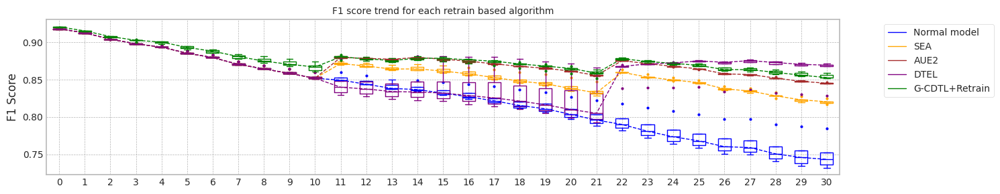

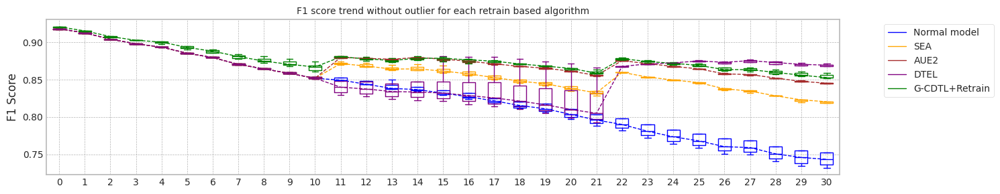

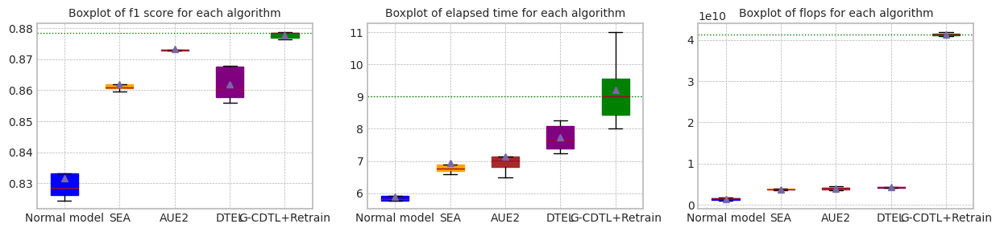

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.828425,0.743448,6.173435,1.111860e+09,121365000.0,1.233225e+09
1,1.0,0.917484,0.911968,0.826081,0.736690,5.926600,1.428975e+09,121365000.0,1.550340e+09
2,2.0,0.918611,0.913312,0.846309,0.784911,5.779870,1.652130e+09,121365000.0,1.773495e+09
3,3.0,0.917060,0.911745,0.824474,0.732351,5.816620,8.965350e+08,121365000.0,1.017900e+09
4,4.0,0.918281,0.912449,0.833232,0.752415,5.780930,1.397655e+09,121365000.0,1.519020e+09
5,median,0.918052,0.912449,0.828425,0.743448,5.816620,1.397655e+09,121365000.0,1.519020e+09
6,std,0.000623,0.000625,0.008807,0.020954,0.166533,2.950908e+08,0.0,2.950908e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920653,0.915697,0.840189,0.762458,5.910872,3.933000e+10,609615000.0,3.993962e+10
1,1.0,0.919311,0.913909,0.843570,0.762401,5.911031,3.933000e+10,609615000.0,3.993962e+10
2,2.0,0.919817,0.914225,0.820862,0.702603,5.983834,3.933000e+10,609615000.0,3.993962e+10
3,3.0,0.920799,0.915430,0.851497,0.775919,5.859587,3.933000e+10,609615000.0,3.993962e+10
4,4.0,0.920577,0.915182,0.833419,0.732372,5.848292,3.933000e+10,609615000.0,3.993962e+10
5,median,0.920577,0.915182,0.840189,0.762401,5.910872,3.933000e+10,609615000.0,3.993962e+10
6,std,0.000640,0.000780,0.011540,0.029569,0.053707,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.860897,0.819046,6.694215,1.671270e+09,1.745655e+09,3.416925e+09
1,1.0,0.917484,0.911968,0.860570,0.820642,6.598698,1.615155e+09,2.006655e+09,3.621810e+09
2,2.0,0.918611,0.913312,0.866466,0.824586,6.757568,1.649955e+09,2.264610e+09,3.914565e+09
3,3.0,0.917060,0.911745,0.859559,0.816586,7.804098,2.031885e+09,1.890945e+09,3.922830e+09
4,4.0,0.918281,0.912449,0.862006,0.820457,6.889917,1.693455e+09,2.053635e+09,3.747090e+09
5,median,0.918052,0.912449,0.860897,0.820457,6.757568,1.671270e+09,2.006655e+09,3.747090e+09
6,std,0.000623,0.000625,0.002698,0.002910,0.489632,1.699179e+08,1.931498e+08,2.127894e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.872713,0.846629,8.225060,2.095395e+09,2.291145e+09,4.386540e+09
1,1.0,0.917484,0.911968,0.873000,0.844569,7.128656,1.770885e+09,2.283750e+09,4.054635e+09
2,2.0,0.918611,0.913312,0.874566,0.844389,6.822964,1.672575e+09,2.408595e+09,4.081170e+09
3,3.0,0.917060,0.911745,0.872627,0.845305,7.021105,1.706940e+09,1.687365e+09,3.394305e+09
4,4.0,0.918281,0.912449,0.873062,0.845250,6.503141,1.587750e+09,2.069295e+09,3.657045e+09
5,median,0.918052,0.912449,0.873000,0.845250,7.021105,1.706940e+09,2.283750e+09,4.054635e+09
6,std,0.000623,0.000625,0.000789,0.000881,0.651483,1.952638e+08,2.851348e+08,3.895908e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.860401,0.871115,8.096936,2.074950e+09,2.152815e+09,4.227765e+09
1,1.0,0.917484,0.911968,0.857868,0.869698,8.256259,2.075385e+09,2.465145e+09,4.540530e+09
2,2.0,0.918611,0.913312,0.867605,0.869392,7.234785,1.812210e+09,2.452095e+09,4.264305e+09
3,3.0,0.917060,0.911745,0.856005,0.868328,7.665952,1.936185e+09,1.820475e+09,3.756660e+09
4,4.0,0.918281,0.912449,0.867944,0.828674,7.378953,1.861800e+09,2.260260e+09,4.122060e+09
5,median,0.918052,0.912449,0.860401,0.869392,7.665952,1.936185e+09,2.260260e+09,4.227765e+09
6,std,0.000623,0.000625,0.005530,0.018344,0.442749,1.206937e+08,2.641984e+08,2.836895e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920653,0.915697,0.878786,0.856180,8.432297,4.024770e+10,823860000.0,4.107156e+10
1,1.0,0.919311,0.913909,0.876835,0.852789,9.563007,4.065192e+10,823860000.0,4.147578e+10
2,2.0,0.919817,0.914225,0.878439,0.858693,9.000610,4.041813e+10,823860000.0,4.124199e+10
3,3.0,0.920799,0.915430,0.878389,0.852802,11.006004,4.112607e+10,823860000.0,4.194993e+10
4,4.0,0.920577,0.915182,0.876376,0.851643,8.006537,4.003357e+10,823860000.0,4.085743e+10
5,median,0.920577,0.915182,0.878389,0.852802,9.000610,4.041813e+10,823860000.0,4.124199e+10
6,std,0.000640,0.000780,0.001082,0.002930,1.166928,4.191830e+08,0.0,4.191830e+08


trial_count: 5
Lambda :  0.9
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-11-26 01:41:59,668] [INFO] [profiler.py:80:start_profile] Flops profiler started


 14%|█▍        | 283/2000 [00:00<00:03, 441.43it/s]

Early stop: 283
[2023-11-26 01:42:00,316] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1111860000
precision_recall_fscore: (array([0.90056135, 0.90853774]), array([0.87506494, 0.92776699]), array([0.88763009, 0.91805169]), array([3850, 5150]))
Test f1 score: 0.9180516860409261
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.47it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8284248581106691
inference_flops: 121365000
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:42:06,049] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:42:06,051] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 146.17it/s]

[2023-11-26 01:42:19,740] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:42:19,742] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.90427807, 0.91102662]), array([0.87844156, 0.93048544]), array([0.8911726 , 0.92065322]), array([3850, 5150]))
Test f1 score: 0.9206532180595582
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.34it/s]


mean of drift:
x0    0.524520
x1    0.481047
x2    0.742315
x3    0.154043
z0    0.054039
dtype: float64
Mean F1 for all data: 0.8401892584244594
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-11-26 01:42:25,613] [INFO] [profiler.py:80:start_profile] Flops profiler started


 18%|█▊        | 364/2000 [00:00<00:03, 438.39it/s]

Early stop: 364
[2023-11-26 01:42:26,448] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1428975000
precision_recall_fscore: (array([0.89872068, 0.90891768]), array([0.87584416, 0.92621359]), array([0.88713496, 0.91748413]), array([3850, 5150]))
Test f1 score: 0.9174841315637622
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.40it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8260808195328699
inference_flops: 121365000
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:42:32,274] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:42:32,275] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 147.95it/s]

[2023-11-26 01:42:45,803] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:42:45,804] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89538542, 0.91612032]), array([0.88701299, 0.92252427]), array([0.89117954, 0.91931115]), array([3850, 5150]))
Test f1 score: 0.919311145510836
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.37it/s]


mean of drift:
x0    0.416523
x1    0.338885
x2    0.520057
x3    0.227215
z0    0.118667
dtype: float64
Mean F1 for all data: 0.8435698956849597
inference_flops: 609615000
Normal model median        : 0.8272528388217695
Drift tolerant model median: 0.8418795770547095
######################### Retrain 3 Trial 2 for Normal model ###########################
cuda:0
[2023-11-26 01:42:51,655] [INFO] [profiler.py:80:start_profile] Flops profiler started


 21%|██        | 421/2000 [00:00<00:03, 444.88it/s]

Early stop: 421
[2023-11-26 01:42:52,606] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1652130000
precision_recall_fscore: (array([0.89761905, 0.91245211]), array([0.8812987 , 0.92485437]), array([0.88938401, 0.91861138]), array([3850, 5150]))
Test f1 score: 0.9186113789778207
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.18it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8463085799286945
inference_flops: 121365000
######################### Retrain 3 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:42:58,663] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:42:58,665] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 145.74it/s]

[2023-11-26 01:43:12,397] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:43:12,398] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89173789, 0.92080171]), array([0.89428571, 0.91883495]), array([0.89300999, 0.91981728]), array([3850, 5150]))
Test f1 score: 0.9198172805909224
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.29it/s]

mean of drift:
x0    0.357720
x1    0.529108
x2    0.783882
x3    0.354287
z0    0.033842
dtype: float64
Mean F1 for all data: 0.8208615825464842
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 3 Trial 3 for Normal model ###########################
cuda:0
[2023-11-26 01:43:18,321] [INFO] [profiler.py:80:start_profile] Flops profiler started



 11%|█▏        | 228/2000 [00:00<00:03, 447.52it/s]

Early stop: 228
[2023-11-26 01:43:18,837] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 896535000
precision_recall_fscore: (array([0.89652428, 0.90995985]), array([0.87766234, 0.92427184]), array([0.88699304, 0.91706001]), array([3850, 5150]))
Test f1 score: 0.9170600134861766
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.33it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8244743311043818
inference_flops: 121365000
######################### Retrain 3 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:43:24,715] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:43:24,717] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 147.95it/s]

[2023-11-26 01:43:38,243] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:43:38,244] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89086229, 0.92394917]), array([0.89896104, 0.9176699 ]), array([0.89489334, 0.92079883]), array([3850, 5150]))
Test f1 score: 0.920798830979055
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.38it/s]

mean of drift:
x0    0.132810
x1    0.571502
x2    0.392459
x3    0.378072
z0    0.185287
dtype: float64
Mean F1 for all data: 0.851497482919537
inference_flops: 609615000
Normal model median        : 0.8272528388217695
Drift tolerant model median: 0.8418795770547095
######################### Retrain 3 Trial 4 for Normal model ###########################
cuda:0
[2023-11-26 01:43:44,065] [INFO] [profiler.py:80:start_profile] Flops profiler started



 18%|█▊        | 356/2000 [00:00<00:03, 441.91it/s]

Early stop: 356
[2023-11-26 01:43:44,876] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1397655000
precision_recall_fscore: (array([0.90252417, 0.90731615]), array([0.87298701, 0.92951456]), array([0.8875099 , 0.91828122]), array([3850, 5150]))
Test f1 score: 0.9182812200268559
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.34it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8332321922969802
inference_flops: 121365000
######################### Retrain 3 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:43:50,752] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:43:50,755] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 147.07it/s]

[2023-11-26 01:44:04,362] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:44:04,363] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89719381, 0.91729323]), array([0.88857143, 0.9238835 ]), array([0.8928618 , 0.92057657]), array([3850, 5150]))
Test f1 score: 0.9205765696043339
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.34it/s]


mean of drift:
x0    0.132079
x1    0.427753
x2    0.407283
x3    0.144828
z0    0.053394
dtype: float64
Mean F1 for all data: 0.8334191606447507
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.23it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:44:11,807] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:44:11,810] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:44:14,053] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:44:14,054] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 29%|██▉       | 9/31 [00:03<00:15,  1.46it/s]

G-CDTL train flops: 600250000 149205000 749455000


 48%|████▊     | 15/31 [00:05<00:04,  3.96it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:44:15,637] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:44:15,639] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:44:17,280] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:44:17,281] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:07<00:10,  1.37it/s]

G-CDTL train flops: 427000000 106140000 533140000


 74%|███████▍  | 23/31 [00:08<00:01,  4.28it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:44:18,811] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:44:18,813] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:44:20,806] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:44:20,807] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 81%|████████  | 25/31 [00:10<00:03,  1.58it/s]

G-CDTL train flops: 542500000 134850000 677350000


100%|██████████| 31/31 [00:11<00:00,  2.60it/s]


Early stop at  [342, 243, 309]
Train flops  [749455000, 533140000, 677350000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8822716558412864
G_CDTL+AUE median: 0.8822716558412864
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:05,  3.91it/s]

Ensemble_SEA train flops: 91785000


 55%|█████▍    | 17/31 [00:03<00:04,  3.45it/s]

Ensemble_SEA train flops: 136590000


 81%|████████  | 25/31 [00:06<00:01,  3.05it/s]

Ensemble_SEA train flops: 169650000


100%|██████████| 31/31 [00:07<00:00,  4.25it/s]


Early stop at  [210, 313, 389]
Train flops  [91785000, 136590000, 169650000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8651460417734285
SEA median: 0.8651460417734285
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:05,  3.82it/s]

Ensemble_SEA train flops: 93525000


 55%|█████▍    | 17/31 [00:04<00:04,  3.27it/s]

Ensemble_SEA train flops: 147900000


 81%|████████  | 25/31 [00:06<00:01,  3.14it/s]

Ensemble_SEA train flops: 170955000


100%|██████████| 31/31 [00:07<00:00,  4.28it/s]


Early stop at  [214, 339, 392]
Train flops  [93525000, 147900000, 170955000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8752004623939766
AUE median: 0.8752004623939766
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:06,  3.54it/s]

Ensemble_DTEL train flops: 125715000
Ensemble_DTEL train flops: 1740000


 48%|████▊     | 15/31 [00:03<00:03,  5.13it/s]

Ensemble_DTEL train flops: 142680000


 55%|█████▍    | 17/31 [00:04<00:05,  2.74it/s]

Ensemble_DTEL train flops: 97005000


 81%|████████  | 25/31 [00:06<00:02,  2.77it/s]

Ensemble_DTEL train flops: 219240000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:07<00:00,  3.97it/s]


Early stop at  [288, 3, 327, 222, 503, 3]
Train flops  [125715000, 1740000, 142680000, 97005000, 219240000, 1740000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8632228505973212
DTEL median: 0.8632228505973212
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.27it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:44:46,254] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:44:46,257] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:44:48,004] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:44:48,006] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 29%|██▉       | 9/31 [00:03<00:12,  1.75it/s]

G-CDTL train flops: 474250000 117885000 592135000


 48%|████▊     | 15/31 [00:04<00:03,  4.27it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:44:49,540] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:44:49,543] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:44:50,827] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:44:50,828] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:06<00:09,  1.64it/s]

G-CDTL train flops: 339500000 84390000 423890000


 74%|███████▍  | 23/31 [00:07<00:01,  4.37it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:44:52,388] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:44:52,391] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:44:55,167] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:44:55,168] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:10<00:07,  1.05s/it]

G-CDTL train flops: 733250000 182265000 915515000


100%|██████████| 31/31 [00:11<00:00,  2.63it/s]


Early stop at  [270, 193, 418]
Train flops  [592135000, 423890000, 915515000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8801604508423633
G_CDTL+AUE median: 0.8812160533418248
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:07,  3.11it/s]

Ensemble_SEA train flops: 165300000


 55%|█████▍    | 17/31 [00:04<00:03,  3.62it/s]

Ensemble_SEA train flops: 106140000


 81%|████████  | 25/31 [00:06<00:02,  2.36it/s]

Ensemble_SEA train flops: 309285000


100%|██████████| 31/31 [00:07<00:00,  3.91it/s]


Early stop at  [379, 243, 710]
Train flops  [165300000, 106140000, 309285000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8647061119377729
SEA median: 0.8649260768556006
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:05,  3.79it/s]

Ensemble_SEA train flops: 101355000


 55%|█████▍    | 17/31 [00:03<00:03,  3.68it/s]

Ensemble_SEA train flops: 115710000


 81%|████████  | 25/31 [00:05<00:01,  3.22it/s]

Ensemble_SEA train flops: 153990000


100%|██████████| 31/31 [00:07<00:00,  4.35it/s]


Early stop at  [232, 265, 353]
Train flops  [101355000, 115710000, 153990000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8752343316526926
AUE median: 0.8752173970233346
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:06,  3.37it/s]

Ensemble_DTEL train flops: 134850000
Ensemble_DTEL train flops: 1740000


 48%|████▊     | 15/31 [00:03<00:03,  4.91it/s]

Ensemble_DTEL train flops: 108750000


 52%|█████▏    | 16/31 [00:04<00:06,  2.49it/s]

Ensemble_DTEL train flops: 72210000


 81%|████████  | 25/31 [00:06<00:02,  2.73it/s]

Ensemble_DTEL train flops: 230115000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:07<00:00,  3.95it/s]


Early stop at  [309, 3, 249, 165, 528, 3]
Train flops  [134850000, 1740000, 108750000, 72210000, 230115000, 1740000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.862660062126373
DTEL median: 0.8629414563618472
######################### Retrain 3 Trial 2 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.44it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:45:21,116] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:45:21,118] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:45:22,519] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:45:22,521] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:02<00:14,  1.58it/s]

G-CDTL train flops: 369250000 91785000 461035000


 48%|████▊     | 15/31 [00:04<00:03,  4.48it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:45:24,057] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:45:24,059] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:45:26,080] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:45:26,081] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:06<00:12,  1.21it/s]

G-CDTL train flops: 533750000 132675000 666425000


 74%|███████▍  | 23/31 [00:07<00:01,  4.11it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:45:27,634] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:45:27,636] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:45:30,624] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:45:30,626] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 81%|████████  | 25/31 [00:11<00:05,  1.18it/s]

G-CDTL train flops: 801500000 199230000 1000730000


100%|██████████| 31/31 [00:12<00:00,  2.51it/s]


Early stop at  [210, 304, 457]
Train flops  [461035000, 666425000, 1000730000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8810619757634329
G_CDTL+AUE median: 0.8810619757634329
######################### Retrain 3 Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:01<00:05,  4.08it/s]

Ensemble_SEA train flops: 76560000


 55%|█████▍    | 17/31 [00:04<00:04,  3.22it/s]

Ensemble_SEA train flops: 164430000


 81%|████████  | 25/31 [00:06<00:01,  3.02it/s]

Ensemble_SEA train flops: 178350000


100%|██████████| 31/31 [00:07<00:00,  4.25it/s]


Early stop at  [175, 377, 409]
Train flops  [76560000, 164430000, 178350000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8694245979664077
SEA median: 0.8651460417734285
######################### Retrain 3 Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:01<00:07,  3.05it/s]

Ensemble_SEA train flops: 125715000


 55%|█████▍    | 17/31 [00:04<00:04,  3.24it/s]

Ensemble_SEA train flops: 155295000


 81%|████████  | 25/31 [00:06<00:01,  3.66it/s]

Ensemble_SEA train flops: 108750000


100%|██████████| 31/31 [00:07<00:00,  4.32it/s]


Early stop at  [288, 356, 249]
Train flops  [125715000, 155295000, 108750000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8768004189748313
AUE median: 0.8752343316526926
######################### Retrain 3 Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:03<00:11,  1.98it/s]

Ensemble_DTEL train flops: 411075000
Ensemble_DTEL train flops: 1740000


 48%|████▊     | 15/31 [00:04<00:03,  4.46it/s]

Ensemble_DTEL train flops: 133545000


 55%|█████▍    | 17/31 [00:05<00:05,  2.62it/s]

Ensemble_DTEL train flops: 92220000


 81%|████████  | 25/31 [00:07<00:02,  2.87it/s]

Ensemble_DTEL train flops: 189660000
Ensemble_DTEL train flops: 1305000


100%|██████████| 31/31 [00:08<00:00,  3.53it/s]


Early stop at  [944, 3, 306, 211, 435, 2]
Train flops  [411075000, 1740000, 133545000, 92220000, 189660000, 1305000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.866217263249851
DTEL median: 0.8632228505973212
######################### Retrain 3 Trial 3 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.33it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:45:56,976] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:45:56,978] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:45:57,950] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:45:57,951] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 29%|██▉       | 9/31 [00:02<00:08,  2.47it/s]

G-CDTL train flops: 253750000 63075000 316825000


 48%|████▊     | 15/31 [00:03<00:03,  4.71it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:45:59,464] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:45:59,467] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:46:00,869] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:46:00,870] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 17/31 [00:05<00:06,  2.01it/s]

G-CDTL train flops: 367500000 91350000 458850000


 74%|███████▍  | 23/31 [00:06<00:01,  4.44it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:46:02,391] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:46:02,394] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:46:05,064] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:46:05,065] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 81%|████████  | 25/31 [00:09<00:04,  1.30it/s]

G-CDTL train flops: 691250000 171825000 863075000


100%|██████████| 31/31 [00:10<00:00,  2.83it/s]


Early stop at  [144, 209, 394]
Train flops  [316825000, 458850000, 863075000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8820650955880602
G_CDTL+AUE median: 0.8815635356757465
######################### Retrain 3 Trial 3 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:06,  3.49it/s]

Ensemble_SEA train flops: 123540000


 55%|█████▍    | 17/31 [00:03<00:03,  3.84it/s]

Ensemble_SEA train flops: 93525000


 81%|████████  | 25/31 [00:05<00:01,  3.49it/s]

Ensemble_SEA train flops: 131805000


100%|██████████| 31/31 [00:07<00:00,  4.40it/s]


Early stop at  [283, 214, 302]
Train flops  [123540000, 93525000, 131805000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8644051040191228
SEA median: 0.8649260768556006
######################### Retrain 3 Trial 3 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:07,  2.90it/s]

Ensemble_SEA train flops: 205755000


 55%|█████▍    | 17/31 [00:04<00:04,  3.29it/s]

Ensemble_SEA train flops: 144420000


 81%|████████  | 25/31 [00:06<00:02,  2.72it/s]

Ensemble_SEA train flops: 219240000


100%|██████████| 31/31 [00:07<00:00,  3.91it/s]


Early stop at  [472, 331, 503]
Train flops  [205755000, 144420000, 219240000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.875189720863906
AUE median: 0.8752173970233346
######################### Retrain 3 Trial 3 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:09,  2.40it/s]

Ensemble_DTEL train flops: 291450000
Ensemble_DTEL train flops: 1740000


 48%|████▊     | 15/31 [00:03<00:03,  4.70it/s]

Ensemble_DTEL train flops: 108750000


 55%|█████▍    | 17/31 [00:05<00:06,  2.23it/s]

Ensemble_DTEL train flops: 225330000


 81%|████████  | 25/31 [00:07<00:01,  3.57it/s]

Ensemble_DTEL train flops: 103530000
Ensemble_DTEL train flops: 1305000


100%|██████████| 31/31 [00:08<00:00,  3.71it/s]


Early stop at  [669, 3, 249, 517, 237, 2]
Train flops  [291450000, 1740000, 108750000, 225330000, 103530000, 1305000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8614105004134195
DTEL median: 0.8629414563618472
######################### Retrain 3 Trial 4 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.38it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:46:31,416] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:46:31,419] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:46:33,476] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:46:33,477] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:03<00:19,  1.18it/s]

G-CDTL train flops: 519750000 129195000 648945000


 48%|████▊     | 15/31 [00:04<00:03,  4.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:46:35,010] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:46:35,012] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:46:36,193] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:46:36,194] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 17/31 [00:06<00:06,  2.14it/s]

G-CDTL train flops: 309750000 76995000 386745000


 74%|███████▍  | 23/31 [00:07<00:01,  4.50it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:46:37,728] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:46:37,730] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:46:39,437] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:46:39,438] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 81%|████████  | 25/31 [00:09<00:03,  1.77it/s]

G-CDTL train flops: 439250000 109185000 548435000


100%|██████████| 31/31 [00:10<00:00,  2.86it/s]


Early stop at  [296, 176, 250]
Train flops  [648945000, 386745000, 548435000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8804022618212152
G_CDTL+AUE median: 0.8810619757634329
######################### Retrain 3 Trial 4 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:09,  2.40it/s]

Ensemble_SEA train flops: 294930000


 55%|█████▍    | 17/31 [00:04<00:04,  3.29it/s]

Ensemble_SEA train flops: 132675000


 81%|████████  | 25/31 [00:07<00:03,  1.89it/s]

Ensemble_SEA train flops: 433260000


100%|██████████| 31/31 [00:08<00:00,  3.48it/s]


Early stop at  [677, 304, 995]
Train flops  [294930000, 132675000, 433260000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8658324339862341
SEA median: 0.8651460417734285
######################### Retrain 3 Trial 4 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:06,  3.38it/s]

Ensemble_SEA train flops: 132675000


 55%|█████▍    | 17/31 [00:05<00:07,  1.99it/s]

Ensemble_SEA train flops: 411075000


 81%|████████  | 25/31 [00:06<00:01,  3.49it/s]

Ensemble_SEA train flops: 111795000


100%|██████████| 31/31 [00:08<00:00,  3.83it/s]


Early stop at  [304, 944, 256]
Train flops  [132675000, 411075000, 111795000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8750362809851272
AUE median: 0.8752004623939766
######################### Retrain 3 Trial 4 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:05,  3.67it/s]

Ensemble_DTEL train flops: 103095000
Ensemble_DTEL train flops: 2175000


 48%|████▊     | 15/31 [00:03<00:03,  5.15it/s]

Ensemble_DTEL train flops: 117885000


 55%|█████▍    | 17/31 [00:04<00:04,  2.92it/s]

Ensemble_DTEL train flops: 83955000


 81%|████████  | 25/31 [00:06<00:01,  3.25it/s]

Ensemble_DTEL train flops: 147030000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:07<00:00,  4.19it/s]


Early stop at  [236, 4, 270, 192, 337, 3]
Train flops  [103095000, 2175000, 117885000, 83955000, 147030000, 1740000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8657904879205301
DTEL median: 0.8632228505973212


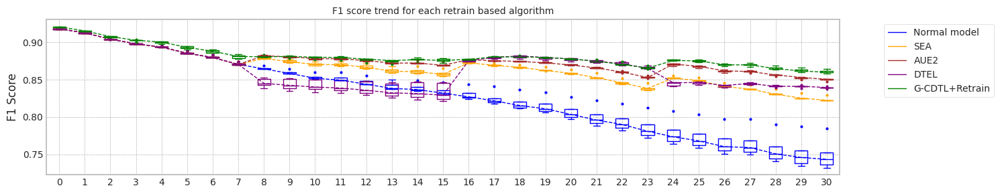

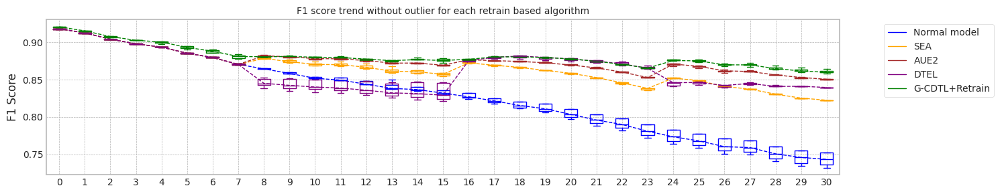

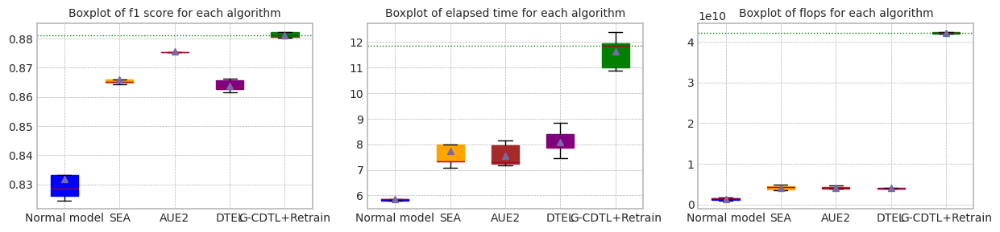

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.828425,0.743448,5.717602,1.111860e+09,121365000.0,1.233225e+09
1,1.0,0.917484,0.911968,0.826081,0.736690,5.806845,1.428975e+09,121365000.0,1.550340e+09
2,2.0,0.918611,0.913312,0.846309,0.784911,6.040478,1.652130e+09,121365000.0,1.773495e+09
3,3.0,0.917060,0.911745,0.824474,0.732351,5.860898,8.965350e+08,121365000.0,1.017900e+09
4,4.0,0.918281,0.912449,0.833232,0.752415,5.855595,1.397655e+09,121365000.0,1.519020e+09
5,median,0.918052,0.912449,0.828425,0.743448,5.855595,1.397655e+09,121365000.0,1.519020e+09
6,std,0.000623,0.000625,0.008807,0.020954,0.117926,2.950908e+08,0.0,2.950908e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920653,0.915697,0.840189,0.762458,5.850942,3.933000e+10,609615000.0,3.993962e+10
1,1.0,0.919311,0.913909,0.843570,0.762401,5.826736,3.933000e+10,609615000.0,3.993962e+10
2,2.0,0.919817,0.914225,0.820862,0.702603,5.903850,3.933000e+10,609615000.0,3.993962e+10
3,3.0,0.920799,0.915430,0.851497,0.775919,5.803441,3.933000e+10,609615000.0,3.993962e+10
4,4.0,0.920577,0.915182,0.833419,0.732372,5.857706,3.933000e+10,609615000.0,3.993962e+10
5,median,0.920577,0.915182,0.840189,0.762401,5.850942,3.933000e+10,609615000.0,3.993962e+10
6,std,0.000640,0.000780,0.011540,0.029569,0.037611,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.865146,0.822479,7.336276,1.795680e+09,1.932705e+09,3.728385e+09
1,1.0,0.917484,0.911968,0.864706,0.822333,7.981982,1.978380e+09,2.432520e+09,4.410900e+09
2,2.0,0.918611,0.913312,0.869425,0.829431,7.342927,1.816995e+09,2.494290e+09,4.311285e+09
3,3.0,0.917060,0.911745,0.864405,0.822682,7.087488,1.746525e+09,1.668225e+09,3.414750e+09
4,4.0,0.918281,0.912449,0.865832,0.822200,8.961934,2.258520e+09,2.681340e+09,4.939860e+09
5,median,0.918052,0.912449,0.865146,0.822479,7.342927,1.816995e+09,2.432520e+09,4.311285e+09
6,std,0.000623,0.000625,0.002041,0.003139,0.757972,2.086624e+08,4.236298e+08,5.991042e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.875200,0.850478,7.288096,1.810035e+09,2.068425e+09,3.878460e+09
1,1.0,0.917484,0.911968,0.875234,0.849727,7.174366,1.768710e+09,2.344215e+09,4.112925e+09
2,2.0,0.918611,0.913312,0.876800,0.850894,7.240680,1.787415e+09,2.586075e+09,4.373490e+09
3,3.0,0.917060,0.911745,0.875190,0.850580,7.962822,1.967070e+09,2.010135e+09,3.977205e+09
4,4.0,0.918281,0.912449,0.875036,0.847527,8.143232,2.053200e+09,2.597385e+09,4.650585e+09
5,median,0.918052,0.912449,0.875200,0.850478,7.288096,1.810035e+09,2.344215e+09,4.112925e+09
6,std,0.000623,0.000625,0.000735,0.001363,0.454703,1.258920e+08,2.773190e+08,3.137366e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.863223,0.841162,7.863339,1.985775e+09,1.920960e+09,3.906735e+09
1,1.0,0.917484,0.911968,0.862660,0.839593,7.907928,1.947060e+09,2.224155e+09,4.171215e+09
2,2.0,0.918611,0.913312,0.866217,0.837529,8.832463,2.227200e+09,2.426430e+09,4.653630e+09
3,3.0,0.917060,0.911745,0.861411,0.839506,8.402944,2.129760e+09,1.717815e+09,3.847575e+09
4,4.0,0.918281,0.912449,0.865790,0.839178,7.470310,1.853535e+09,2.121930e+09,3.975465e+09
5,median,0.918052,0.912449,0.863223,0.839506,7.907928,1.985775e+09,2.121930e+09,3.975465e+09
6,std,0.000623,0.000625,0.002069,0.001294,0.528579,1.490015e+08,2.734039e+08,3.269403e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920653,0.915697,0.882272,0.864247,11.947744,4.128994e+10,967140000.0,4.225708e+10
1,1.0,0.919311,0.913909,0.880160,0.858300,11.851939,4.126154e+10,967140000.0,4.222868e+10
2,2.0,0.919817,0.914225,0.881062,0.859619,12.398670,4.145819e+10,967140000.0,4.242533e+10
3,3.0,0.920799,0.915430,0.882065,0.861571,11.014001,4.096875e+10,967140000.0,4.193589e+10
4,4.0,0.920577,0.915182,0.880402,0.859798,10.888484,4.091412e+10,967140000.0,4.188126e+10
5,median,0.920577,0.915182,0.881062,0.859798,11.851939,4.126154e+10,967140000.0,4.222868e+10
6,std,0.000640,0.000780,0.000953,0.002296,0.646121,2.299083e+08,0.0,2.299083e+08


trial_count: 5
Lambda :  0.9
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-11-26 01:47:08,829] [INFO] [profiler.py:80:start_profile] Flops profiler started


 14%|█▍        | 283/2000 [00:00<00:04, 422.05it/s]

Early stop: 283
[2023-11-26 01:47:09,505] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1111860000
precision_recall_fscore: (array([0.90056135, 0.90853774]), array([0.87506494, 0.92776699]), array([0.88763009, 0.91805169]), array([3850, 5150]))
Test f1 score: 0.9180516860409261
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.41it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8284248581106691
inference_flops: 121365000
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:47:15,299] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:47:15,302] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:14<00:00, 134.74it/s]

[2023-11-26 01:47:30,153] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:47:30,154] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.90427807, 0.91102662]), array([0.87844156, 0.93048544]), array([0.8911726 , 0.92065322]), array([3850, 5150]))
Test f1 score: 0.9206532180595582
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.35it/s]

mean of drift:
x0    0.524520
x1    0.481047
x2    0.742315
x3    0.154043
z0    0.054039
dtype: float64
Mean F1 for all data: 0.8401892584244594
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-11-26 01:47:36,033] [INFO] [profiler.py:80:start_profile] Flops profiler started



 18%|█▊        | 364/2000 [00:00<00:03, 412.30it/s]

Early stop: 364
[2023-11-26 01:47:36,922] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1428975000
precision_recall_fscore: (array([0.89872068, 0.90891768]), array([0.87584416, 0.92621359]), array([0.88713496, 0.91748413]), array([3850, 5150]))
Test f1 score: 0.9174841315637622
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.35it/s]


mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8260808195328699
inference_flops: 121365000
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:47:42,780] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:47:42,782] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:14<00:00, 134.34it/s]

[2023-11-26 01:47:57,677] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:47:57,679] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89538542, 0.91612032]), array([0.88701299, 0.92252427]), array([0.89117954, 0.91931115]), array([3850, 5150]))
Test f1 score: 0.919311145510836
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.42it/s]


mean of drift:
x0    0.416523
x1    0.338885
x2    0.520057
x3    0.227215
z0    0.118667
dtype: float64
Mean F1 for all data: 0.8435698956849597
inference_flops: 609615000
Normal model median        : 0.8272528388217695
Drift tolerant model median: 0.8418795770547095
######################### Retrain 4 Trial 2 for Normal model ###########################
cuda:0
[2023-11-26 01:48:03,471] [INFO] [profiler.py:80:start_profile] Flops profiler started


 21%|██        | 421/2000 [00:00<00:03, 424.94it/s]

Early stop: 421
[2023-11-26 01:48:04,469] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1652130000
precision_recall_fscore: (array([0.89761905, 0.91245211]), array([0.8812987 , 0.92485437]), array([0.88938401, 0.91861138]), array([3850, 5150]))
Test f1 score: 0.9186113789778207
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.39it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8463085799286945
inference_flops: 121365000
######################### Retrain 4 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:48:10,272] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:48:10,274] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:15<00:00, 132.26it/s]

[2023-11-26 01:48:25,404] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:48:25,406] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89173789, 0.92080171]), array([0.89428571, 0.91883495]), array([0.89300999, 0.91981728]), array([3850, 5150]))
Test f1 score: 0.9198172805909224
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.35it/s]

mean of drift:
x0    0.357720
x1    0.529108
x2    0.783882
x3    0.354287
z0    0.033842
dtype: float64
Mean F1 for all data: 0.8208615825464842
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 4 Trial 3 for Normal model ###########################
cuda:0
[2023-11-26 01:48:31,266] [INFO] [profiler.py:80:start_profile] Flops profiler started



 11%|█▏        | 228/2000 [00:00<00:04, 404.06it/s]

Early stop: 228
[2023-11-26 01:48:31,838] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 896535000
precision_recall_fscore: (array([0.89652428, 0.90995985]), array([0.87766234, 0.92427184]), array([0.88699304, 0.91706001]), array([3850, 5150]))
Test f1 score: 0.9170600134861766
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.30it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8244743311043818
inference_flops: 121365000
######################### Retrain 4 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:48:37,747] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-26 01:48:37,750] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:14<00:00, 133.64it/s]

[2023-11-26 01:48:52,725] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:48:52,726] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89086229, 0.92394917]), array([0.89896104, 0.9176699 ]), array([0.89489334, 0.92079883]), array([3850, 5150]))
Test f1 score: 0.920798830979055
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.39it/s]

mean of drift:
x0    0.132810
x1    0.571502
x2    0.392459
x3    0.378072
z0    0.185287
dtype: float64
Mean F1 for all data: 0.851497482919537
inference_flops: 609615000
Normal model median        : 0.8272528388217695
Drift tolerant model median: 0.8418795770547095
######################### Retrain 4 Trial 4 for Normal model ###########################
cuda:0
[2023-11-26 01:48:58,555] [INFO] [profiler.py:80:start_profile] Flops profiler started



 18%|█▊        | 356/2000 [00:00<00:03, 421.37it/s]

Early stop: 356
[2023-11-26 01:48:59,408] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1397655000
precision_recall_fscore: (array([0.90252417, 0.90731615]), array([0.87298701, 0.92951456]), array([0.8875099 , 0.91828122]), array([3850, 5150]))
Test f1 score: 0.9182812200268559
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.30it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8332321922969802
inference_flops: 121365000
######################### Retrain 4 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:49:05,313] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-26 01:49:05,317] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:15<00:00, 126.78it/s]

[2023-11-26 01:49:21,100] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:49:21,102] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89719381, 0.91729323]), array([0.88857143, 0.9238835 ]), array([0.8928618 , 0.92057657]), array([3850, 5150]))
Test f1 score: 0.9205765696043339
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.88it/s]


mean of drift:
x0    0.132079
x1    0.427753
x2    0.407283
x3    0.144828
z0    0.053394
dtype: float64
Mean F1 for all data: 0.8334191606447507
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:04,  5.01it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:49:28,971] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:49:28,974] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:49:30,408] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:49:30,410] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:02<00:16,  1.49it/s]

G-CDTL train flops: 350000000 87000000 437000000


 42%|████▏     | 13/31 [00:04<00:04,  3.99it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:49:31,824] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:49:31,826] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:49:33,787] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:49:33,788] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:06<00:14,  1.20it/s]

G-CDTL train flops: 456750000 113535000 570285000


 65%|██████▍   | 20/31 [00:07<00:03,  3.59it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:49:35,225] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:49:35,227] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:49:37,140] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:49:37,141] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:09<00:08,  1.20it/s]

G-CDTL train flops: 441000000 109620000 550620000


 87%|████████▋ | 27/31 [00:10<00:01,  3.70it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:49:38,519] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:49:38,521] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:49:40,808] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:49:40,809] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:13<00:02,  1.07it/s]

G-CDTL train flops: 540750000 134415000 675165000


100%|██████████| 31/31 [00:13<00:00,  2.24it/s]


Early stop at  [199, 260, 251, 308]
Train flops  [437000000, 570285000, 550620000, 675165000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8827543066374353
G_CDTL+AUE median: 0.8827543066374353
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:01<00:06,  3.80it/s]

Ensemble_SEA train flops: 90045000


 48%|████▊     | 15/31 [00:03<00:05,  2.96it/s]

Ensemble_SEA train flops: 185310000


 71%|███████   | 22/31 [00:05<00:02,  3.61it/s]

Ensemble_SEA train flops: 94830000


 94%|█████████▎| 29/31 [00:07<00:00,  2.99it/s]

Ensemble_SEA train flops: 165300000


100%|██████████| 31/31 [00:07<00:00,  3.93it/s]


Early stop at  [206, 425, 217, 379]
Train flops  [90045000, 185310000, 94830000, 165300000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8661543494044331
SEA median: 0.8661543494044331
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:08,  2.96it/s]

Ensemble_SEA train flops: 120930000


 48%|████▊     | 15/31 [00:03<00:04,  3.43it/s]

Ensemble_SEA train flops: 115275000


 71%|███████   | 22/31 [00:05<00:03,  2.93it/s]

Ensemble_SEA train flops: 176610000


 94%|█████████▎| 29/31 [00:07<00:00,  2.58it/s]

Ensemble_SEA train flops: 237510000


100%|██████████| 31/31 [00:08<00:00,  3.72it/s]


Early stop at  [277, 264, 405, 545]
Train flops  [120930000, 115275000, 176610000, 237510000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8756476890514824
AUE median: 0.8756476890514824
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:07,  2.88it/s]

Ensemble_DTEL train flops: 185310000
Ensemble_DTEL train flops: 1305000


 42%|████▏     | 13/31 [00:03<00:03,  4.54it/s]

Ensemble_DTEL train flops: 111795000


 48%|████▊     | 15/31 [00:05<00:09,  1.64it/s]

Ensemble_DTEL train flops: 371925000


 71%|███████   | 22/31 [00:07<00:03,  2.52it/s]

Ensemble_DTEL train flops: 212280000
Ensemble_DTEL train flops: 1740000


 87%|████████▋ | 27/31 [00:08<00:00,  4.56it/s]

Ensemble_DTEL train flops: 228810000


 94%|█████████▎| 29/31 [00:10<00:00,  2.00it/s]

Ensemble_DTEL train flops: 140940000


100%|██████████| 31/31 [00:10<00:00,  2.90it/s]


Early stop at  [425, 2, 256, 854, 487, 3, 525, 323]
Train flops  [185310000, 1305000, 111795000, 371925000, 212280000, 1740000, 228810000, 140940000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8703342700949613
DTEL median: 0.8703342700949613
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:04,  5.28it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:50:09,875] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:50:09,878] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:50:10,849] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:50:10,850] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:02<00:09,  2.45it/s]

G-CDTL train flops: 236250000 58725000 294975000


 42%|████▏     | 13/31 [00:03<00:04,  4.43it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:50:12,198] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:50:12,200] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:50:13,752] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:50:13,753] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:05<00:11,  1.46it/s]

G-CDTL train flops: 374500000 93090000 467590000


 65%|██████▍   | 20/31 [00:06<00:02,  3.90it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:50:15,157] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:50:15,160] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:50:16,503] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:50:16,504] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:07<00:06,  1.55it/s]

G-CDTL train flops: 308000000 76560000 384560000


 87%|████████▋ | 27/31 [00:09<00:01,  3.91it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:50:17,941] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:50:17,943] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:50:20,096] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:50:20,098] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:11<00:02,  1.13it/s]

G-CDTL train flops: 512750000 127455000 640205000


100%|██████████| 31/31 [00:12<00:00,  2.55it/s]


Early stop at  [134, 213, 175, 292]
Train flops  [294975000, 467590000, 384560000, 640205000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8812810026216332
G_CDTL+AUE median: 0.8820176546295342
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:07,  3.26it/s]

Ensemble_SEA train flops: 130500000


 48%|████▊     | 15/31 [00:04<00:05,  2.73it/s]

Ensemble_SEA train flops: 205320000


 71%|███████   | 22/31 [00:06<00:03,  2.67it/s]

Ensemble_SEA train flops: 213150000


 94%|█████████▎| 29/31 [00:08<00:00,  3.07it/s]

Ensemble_SEA train flops: 144420000


100%|██████████| 31/31 [00:08<00:00,  3.60it/s]


Early stop at  [299, 471, 489, 331]
Train flops  [130500000, 205320000, 213150000, 144420000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.864753023625081
SEA median: 0.8654536865147571
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:01<00:06,  3.43it/s]

Ensemble_SEA train flops: 105705000


 48%|████▊     | 15/31 [00:03<00:04,  3.44it/s]

Ensemble_SEA train flops: 106575000


 71%|███████   | 22/31 [00:07<00:05,  1.55it/s]

Ensemble_SEA train flops: 543750000


 94%|█████████▎| 29/31 [00:09<00:00,  2.19it/s]

Ensemble_SEA train flops: 282750000


100%|██████████| 31/31 [00:10<00:00,  3.10it/s]


Early stop at  [242, 244, 1249, 649]
Train flops  [105705000, 106575000, 543750000, 282750000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8751617691570784
AUE median: 0.8754047291042804
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:01<00:06,  3.83it/s]

Ensemble_DTEL train flops: 85260000
Ensemble_DTEL train flops: 1740000


 42%|████▏     | 13/31 [00:02<00:03,  5.08it/s]

Ensemble_DTEL train flops: 165300000


 48%|████▊     | 15/31 [00:04<00:06,  2.30it/s]

Ensemble_DTEL train flops: 125280000


 68%|██████▊   | 21/31 [00:05<00:03,  2.94it/s]

Ensemble_DTEL train flops: 96135000
Ensemble_DTEL train flops: 1740000


 87%|████████▋ | 27/31 [00:06<00:00,  4.90it/s]

Ensemble_DTEL train flops: 377580000


 90%|█████████ | 28/31 [00:09<00:02,  1.24it/s]

Ensemble_DTEL train flops: 140505000


100%|██████████| 31/31 [00:09<00:00,  3.19it/s]


Early stop at  [195, 3, 379, 287, 220, 3, 867, 322]
Train flops  [85260000, 1740000, 165300000, 125280000, 96135000, 1740000, 377580000, 140505000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8694917872754399
DTEL median: 0.8699130286852006
######################### Retrain 4 Trial 2 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:04,  5.26it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:50:50,614] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:50:50,616] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:50:52,451] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:50:52,452] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:03<00:13,  1.66it/s]

G-CDTL train flops: 441000000 109620000 550620000


 42%|████▏     | 13/31 [00:04<00:04,  3.92it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:50:53,790] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:50:53,792] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:50:55,204] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:50:55,205] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 48%|████▊     | 15/31 [00:06<00:08,  1.92it/s]

G-CDTL train flops: 337750000 83955000 421705000


 65%|██████▍   | 20/31 [00:07<00:02,  3.94it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:50:56,604] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:50:56,607] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:50:58,921] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:50:58,923] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:09<00:09,  1.07it/s]

G-CDTL train flops: 537250000 133545000 670795000


 87%|████████▋ | 27/31 [00:10<00:01,  3.50it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:51:00,328] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:51:00,331] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:51:02,663] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:51:02,665] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:13<00:02,  1.04it/s]

G-CDTL train flops: 547750000 136155000 683905000


100%|██████████| 31/31 [00:14<00:00,  2.21it/s]


Early stop at  [251, 192, 306, 312]
Train flops  [550620000, 421705000, 670795000, 683905000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8815373005580767
G_CDTL+AUE median: 0.8815373005580767
######################### Retrain 4 Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:06,  3.30it/s]

Ensemble_SEA train flops: 134850000


 48%|████▊     | 15/31 [00:03<00:04,  3.21it/s]

Ensemble_SEA train flops: 137460000


 71%|███████   | 22/31 [00:06<00:03,  2.47it/s]

Ensemble_SEA train flops: 247515000


 94%|█████████▎| 29/31 [00:08<00:01,  1.91it/s]

Ensemble_SEA train flops: 370620000


100%|██████████| 31/31 [00:09<00:00,  3.31it/s]


Early stop at  [309, 315, 568, 851]
Train flops  [134850000, 137460000, 247515000, 370620000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8693933928198941
SEA median: 0.8661543494044331
######################### Retrain 4 Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:07,  2.89it/s]

Ensemble_SEA train flops: 173130000


 45%|████▌     | 14/31 [00:03<00:06,  2.68it/s]

Ensemble_SEA train flops: 139200000


 71%|███████   | 22/31 [00:06<00:03,  2.54it/s]

Ensemble_SEA train flops: 228375000


 94%|█████████▎| 29/31 [00:08<00:00,  3.09it/s]

Ensemble_SEA train flops: 141810000


100%|██████████| 31/31 [00:08<00:00,  3.59it/s]


Early stop at  [397, 319, 524, 325]
Train flops  [173130000, 139200000, 228375000, 141810000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8759176368832633
AUE median: 0.8756476890514824
######################### Retrain 4 Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:04,  5.08it/s]

Ensemble_DTEL train flops: 129195000


 26%|██▌       | 8/31 [00:02<00:10,  2.24it/s]

Ensemble_DTEL train flops: 148770000


 48%|████▊     | 15/31 [00:04<00:05,  2.98it/s]

Ensemble_DTEL train flops: 145290000
Ensemble_DTEL train flops: 1305000


 65%|██████▍   | 20/31 [00:05<00:02,  4.57it/s]

Ensemble_DTEL train flops: 137460000


 71%|███████   | 22/31 [00:07<00:04,  2.24it/s]

Ensemble_DTEL train flops: 154860000


 94%|█████████▎| 29/31 [00:08<00:00,  3.20it/s]

Ensemble_DTEL train flops: 124845000
Ensemble_DTEL train flops: 1305000


100%|██████████| 31/31 [00:09<00:00,  3.33it/s]


Early stop at  [296, 341, 333, 2, 315, 355, 286, 2]
Train flops  [129195000, 148770000, 145290000, 1305000, 137460000, 154860000, 124845000, 1305000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8707313666640776
DTEL median: 0.8703342700949613
######################### Retrain 4 Trial 3 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:04,  5.22it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:51:32,169] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:51:32,171] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:51:34,137] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:51:34,138] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:03<00:14,  1.59it/s]

G-CDTL train flops: 455000000 113100000 568100000


 42%|████▏     | 13/31 [00:04<00:04,  3.80it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:51:35,495] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:51:35,497] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:51:36,395] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:51:36,396] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 48%|████▊     | 15/31 [00:05<00:06,  2.39it/s]

G-CDTL train flops: 206500000 51330000 257830000


 65%|██████▍   | 20/31 [00:06<00:02,  4.33it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:51:37,760] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:51:37,762] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:51:40,280] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:51:40,281] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:09<00:09,  1.02it/s]

G-CDTL train flops: 591500000 147030000 738530000


 87%|████████▋ | 27/31 [00:10<00:01,  3.43it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:51:41,707] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:51:41,709] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:51:43,594] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:51:43,595] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:12<00:02,  1.20it/s]

G-CDTL train flops: 432250000 107445000 539695000


100%|██████████| 31/31 [00:13<00:00,  2.31it/s]


Early stop at  [259, 117, 337, 246]
Train flops  [568100000, 257830000, 738530000, 539695000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8814189326410937
G_CDTL+AUE median: 0.8814781165995852
######################### Retrain 4 Trial 3 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:01<00:06,  3.75it/s]

Ensemble_SEA train flops: 87435000


 48%|████▊     | 15/31 [00:03<00:04,  3.38it/s]

Ensemble_SEA train flops: 120930000


 71%|███████   | 22/31 [00:05<00:03,  2.87it/s]

Ensemble_SEA train flops: 173565000


 90%|█████████ | 28/31 [00:07<00:01,  2.34it/s]

Ensemble_SEA train flops: 179655000


100%|██████████| 31/31 [00:08<00:00,  3.79it/s]


Early stop at  [200, 277, 398, 412]
Train flops  [87435000, 120930000, 173565000, 179655000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8650918524944737
SEA median: 0.8656231009494535
######################### Retrain 4 Trial 3 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:08,  2.86it/s]

Ensemble_SEA train flops: 177915000


 48%|████▊     | 15/31 [00:04<00:04,  3.33it/s]

Ensemble_SEA train flops: 114405000


 71%|███████   | 22/31 [00:06<00:03,  2.48it/s]

Ensemble_SEA train flops: 241860000


 94%|█████████▎| 29/31 [00:08<00:00,  2.95it/s]

Ensemble_SEA train flops: 155730000


100%|██████████| 31/31 [00:08<00:00,  3.57it/s]


Early stop at  [408, 262, 555, 357]
Train flops  [177915000, 114405000, 241860000, 155730000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.875594115206274
AUE median: 0.8756209021288781
######################### Retrain 4 Trial 3 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:07,  2.98it/s]

Ensemble_DTEL train flops: 162690000
Ensemble_DTEL train flops: 1305000


 42%|████▏     | 13/31 [00:03<00:03,  4.77it/s]

Ensemble_DTEL train flops: 204450000


 48%|████▊     | 15/31 [00:04<00:07,  2.14it/s]

Ensemble_DTEL train flops: 108315000


 71%|███████   | 22/31 [00:06<00:03,  2.72it/s]

Ensemble_DTEL train flops: 178785000
Ensemble_DTEL train flops: 1740000


 87%|████████▋ | 27/31 [00:07<00:00,  4.57it/s]

Ensemble_DTEL train flops: 263610000


 94%|█████████▎| 29/31 [00:10<00:01,  1.54it/s]

Ensemble_DTEL train flops: 274485000


100%|██████████| 31/31 [00:10<00:00,  2.91it/s]


Early stop at  [373, 2, 469, 248, 410, 3, 605, 630]
Train flops  [162690000, 1305000, 204450000, 108315000, 178785000, 1740000, 263610000, 274485000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8683676130908787
DTEL median: 0.8699130286852006
######################### Retrain 4 Trial 4 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:04,  5.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:52:13,253] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:52:13,255] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:52:14,848] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:52:14,849] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:03<00:12,  1.82it/s]

G-CDTL train flops: 369250000 91785000 461035000


 42%|████▏     | 13/31 [00:04<00:04,  3.97it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:52:16,222] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:52:16,225] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:52:17,469] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:52:17,470] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 48%|████▊     | 15/31 [00:05<00:07,  2.05it/s]

G-CDTL train flops: 285250000 70905000 356155000


 65%|██████▍   | 20/31 [00:06<00:02,  4.09it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:52:18,846] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:52:18,848] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:52:20,737] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:52:20,738] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:08<00:08,  1.25it/s]

G-CDTL train flops: 427000000 106140000 533140000


 87%|████████▋ | 27/31 [00:10<00:01,  3.66it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:52:22,160] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:52:22,162] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:52:23,923] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:52:23,924] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 94%|█████████▎| 29/31 [00:12<00:01,  1.65it/s]

G-CDTL train flops: 383250000 95265000 478515000


100%|██████████| 31/31 [00:12<00:00,  2.46it/s]


Early stop at  [210, 162, 243, 218]
Train flops  [461035000, 356155000, 533140000, 478515000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8817391546523177
G_CDTL+AUE median: 0.8815373005580767
######################### Retrain 4 Trial 4 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:07,  2.97it/s]

Ensemble_SEA train flops: 170955000


 48%|████▊     | 15/31 [00:03<00:04,  3.30it/s]

Ensemble_SEA train flops: 127455000


 71%|███████   | 22/31 [00:06<00:03,  2.60it/s]

Ensemble_SEA train flops: 217935000


 94%|█████████▎| 29/31 [00:08<00:00,  2.27it/s]

Ensemble_SEA train flops: 268830000


100%|██████████| 31/31 [00:08<00:00,  3.45it/s]


Early stop at  [392, 292, 500, 617]
Train flops  [170955000, 127455000, 217935000, 268830000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8636307912028267
SEA median: 0.8650918524944737
######################### Retrain 4 Trial 4 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:07,  3.09it/s]

Ensemble_SEA train flops: 100920000


 48%|████▊     | 15/31 [00:04<00:07,  2.04it/s]

Ensemble_SEA train flops: 346260000


 71%|███████   | 22/31 [00:06<00:03,  2.85it/s]

Ensemble_SEA train flops: 163995000


 94%|█████████▎| 29/31 [00:08<00:00,  2.76it/s]

Ensemble_SEA train flops: 189660000


100%|██████████| 31/31 [00:09<00:00,  3.41it/s]


Early stop at  [231, 795, 376, 435]
Train flops  [100920000, 346260000, 163995000, 189660000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8761856486289996
AUE median: 0.8756476890514824
######################### Retrain 4 Trial 4 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:04,  5.23it/s]

Ensemble_DTEL train flops: 169215000


 26%|██▌       | 8/31 [00:02<00:11,  1.98it/s]

Ensemble_DTEL train flops: 180525000


 45%|████▌     | 14/31 [00:04<00:06,  2.50it/s]

Ensemble_DTEL train flops: 137025000
Ensemble_DTEL train flops: 1740000


 65%|██████▍   | 20/31 [00:05<00:02,  4.62it/s]

Ensemble_DTEL train flops: 177045000


 68%|██████▊   | 21/31 [00:07<00:05,  1.76it/s]

Ensemble_DTEL train flops: 113535000


 94%|█████████▎| 29/31 [00:09<00:00,  2.78it/s]

Ensemble_DTEL train flops: 181395000
Ensemble_DTEL train flops: 1305000


100%|██████████| 31/31 [00:09<00:00,  3.16it/s]


Early stop at  [388, 414, 314, 3, 406, 260, 416, 2]
Train flops  [169215000, 180525000, 137025000, 1740000, 177045000, 113535000, 181395000, 1305000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.872426612668316
DTEL median: 0.8703342700949613


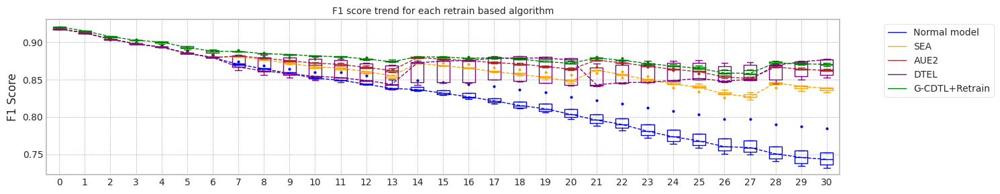

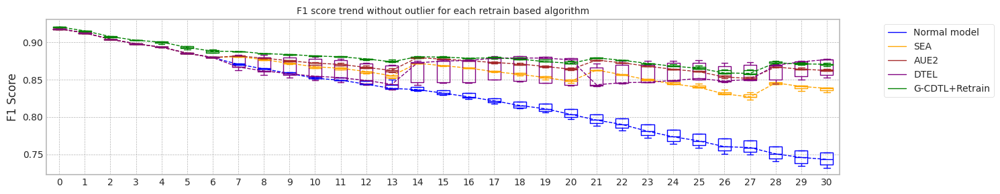

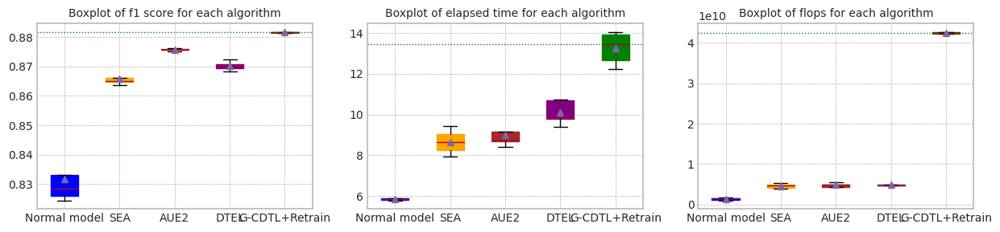

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.828425,0.743448,5.774693,1.111860e+09,121365000.0,1.233225e+09
1,1.0,0.917484,0.911968,0.826081,0.736690,5.841152,1.428975e+09,121365000.0,1.550340e+09
2,2.0,0.918611,0.913312,0.846309,0.784911,5.789739,1.652130e+09,121365000.0,1.773495e+09
3,3.0,0.917060,0.911745,0.824474,0.732351,5.894077,8.965350e+08,121365000.0,1.017900e+09
4,4.0,0.918281,0.912449,0.833232,0.752415,5.888140,1.397655e+09,121365000.0,1.519020e+09
5,median,0.918052,0.912449,0.828425,0.743448,5.841152,1.397655e+09,121365000.0,1.519020e+09
6,std,0.000623,0.000625,0.008807,0.020954,0.054783,2.950908e+08,0.0,2.950908e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920653,0.915697,0.840189,0.762458,5.856894,3.933000e+10,609615000.0,3.993962e+10
1,1.0,0.919311,0.913909,0.843570,0.762401,5.773434,3.933000e+10,609615000.0,3.993962e+10
2,2.0,0.919817,0.914225,0.820862,0.702603,5.840205,3.933000e+10,609615000.0,3.993962e+10
3,3.0,0.920799,0.915430,0.851497,0.775919,5.804105,3.933000e+10,609615000.0,3.993962e+10
4,4.0,0.920577,0.915182,0.833419,0.732372,6.396483,3.933000e+10,609615000.0,3.993962e+10
5,median,0.920577,0.915182,0.840189,0.762401,5.840205,3.933000e+10,609615000.0,3.993962e+10
6,std,0.000640,0.000780,0.011540,0.029569,0.260426,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.866154,0.838462,7.939928,1.933140e+09,2.105400e+09,4.038540e+09
1,1.0,0.917484,0.911968,0.864753,0.835844,8.652323,2.091045e+09,2.580420e+09,4.671465e+09
2,2.0,0.918611,0.913312,0.869393,0.839153,9.420368,2.288100e+09,3.000630e+09,5.288730e+09
3,3.0,0.917060,0.911745,0.865092,0.838993,8.245518,1.959240e+09,1.916175e+09,3.875415e+09
4,4.0,0.918281,0.912449,0.863631,0.833204,9.033708,2.182830e+09,2.640885e+09,4.823715e+09
5,median,0.918052,0.912449,0.865092,0.838462,8.652323,2.091045e+09,2.580420e+09,4.671465e+09
6,std,0.000623,0.000625,0.002199,0.002569,0.593330,1.496342e+08,4.359902e+08,5.812719e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.875648,0.863101,8.384369,2.047980e+09,2.341605e+09,4.389585e+09
1,1.0,0.917484,0.911968,0.875162,0.861900,10.082312,2.436435e+09,3.047175e+09,5.483610e+09
2,2.0,0.918611,0.913312,0.875918,0.862285,8.676874,2.080170e+09,2.914065e+09,4.994235e+09
3,3.0,0.917060,0.911745,0.875594,0.861386,8.729336,2.087565e+09,2.165865e+09,4.253430e+09
4,4.0,0.918281,0.912449,0.876186,0.864067,9.150204,2.198490e+09,2.777910e+09,4.976400e+09
5,median,0.918052,0.912449,0.875648,0.862285,8.729336,2.087565e+09,2.777910e+09,4.976400e+09
6,std,0.000623,0.000625,0.000383,0.001055,0.661537,1.593369e+08,3.785932e+08,5.003634e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.870334,0.877065,10.746774,2.651760e+09,2.345955e+09,4.997715e+09
1,1.0,0.917484,0.911968,0.869492,0.877950,9.783867,2.391195e+09,2.565195e+09,4.956390e+09
2,2.0,0.918611,0.913312,0.870731,0.852574,9.374237,2.240685e+09,2.572590e+09,4.813275e+09
3,3.0,0.917060,0.911745,0.868368,0.876750,10.678079,2.593035e+09,2.035365e+09,4.628400e+09
4,4.0,0.918281,0.912449,0.872427,0.856438,9.857333,2.359440e+09,2.365530e+09,4.724970e+09
5,median,0.918052,0.912449,0.870334,0.876750,9.857333,2.391195e+09,2.365530e+09,4.813275e+09
6,std,0.000623,0.000625,0.001508,0.012542,0.599445,1.707333e+08,2.187936e+08,1.548267e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920653,0.915697,0.882754,0.872179,13.908387,4.156307e+10,1.047735e+09,4.261080e+10
1,1.0,0.919311,0.913909,0.881281,0.870987,12.213544,4.111733e+10,1.047735e+09,4.216506e+10
2,2.0,0.919817,0.914225,0.881537,0.868035,14.057147,4.165702e+10,1.047735e+09,4.270476e+10
3,3.0,0.920799,0.915430,0.881419,0.870568,13.445207,4.143416e+10,1.047735e+09,4.248189e+10
4,4.0,0.920577,0.915182,0.881739,0.869401,12.651606,4.115884e+10,1.047735e+09,4.220658e+10
5,median,0.920577,0.915182,0.881537,0.870568,13.445207,4.143416e+10,1.047735e+09,4.248189e+10
6,std,0.000640,0.000780,0.000588,0.001580,0.799257,2.402656e+08,0.000000e+00,2.402656e+08


trial_count: 5
Lambda :  0.9
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-11-26 01:52:56,152] [INFO] [profiler.py:80:start_profile] Flops profiler started


 14%|█▍        | 283/2000 [00:00<00:04, 381.50it/s]

Early stop: 283
[2023-11-26 01:52:56,901] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1111860000
precision_recall_fscore: (array([0.90056135, 0.90853774]), array([0.87506494, 0.92776699]), array([0.88763009, 0.91805169]), array([3850, 5150]))
Test f1 score: 0.9180516860409261
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.32it/s]


mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8284248581106691
inference_flops: 121365000
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:53:02,798] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:53:02,802] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:16<00:00, 122.91it/s]

[2023-11-26 01:53:19,081] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:53:19,082] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.90427807, 0.91102662]), array([0.87844156, 0.93048544]), array([0.8911726 , 0.92065322]), array([3850, 5150]))
Test f1 score: 0.9206532180595582
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.32it/s]

mean of drift:
x0    0.524520
x1    0.481047
x2    0.742315
x3    0.154043
z0    0.054039
dtype: float64
Mean F1 for all data: 0.8401892584244594
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-11-26 01:53:24,968] [INFO] [profiler.py:80:start_profile] Flops profiler started



 18%|█▊        | 364/2000 [00:00<00:04, 378.26it/s]

Early stop: 364
[2023-11-26 01:53:25,936] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1428975000
precision_recall_fscore: (array([0.89872068, 0.90891768]), array([0.87584416, 0.92621359]), array([0.88713496, 0.91748413]), array([3850, 5150]))
Test f1 score: 0.9174841315637622
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.24it/s]


mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8260808195328699
inference_flops: 121365000
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:53:31,929] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:53:31,931] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:16<00:00, 121.79it/s]

[2023-11-26 01:53:48,361] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:53:48,362] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89538542, 0.91612032]), array([0.88701299, 0.92252427]), array([0.89117954, 0.91931115]), array([3850, 5150]))
Test f1 score: 0.919311145510836
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.22it/s]

mean of drift:
x0    0.416523
x1    0.338885
x2    0.520057
x3    0.227215
z0    0.118667
dtype: float64
Mean F1 for all data: 0.8435698956849597
inference_flops: 609615000
Normal model median        : 0.8272528388217695
Drift tolerant model median: 0.8418795770547095
######################### Retrain 5 Trial 2 for Normal model ###########################
cuda:0
[2023-11-26 01:53:54,367] [INFO] [profiler.py:80:start_profile] Flops profiler started



 21%|██        | 421/2000 [00:01<00:04, 373.96it/s]

Early stop: 421
[2023-11-26 01:53:55,499] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1652130000
precision_recall_fscore: (array([0.89761905, 0.91245211]), array([0.8812987 , 0.92485437]), array([0.88938401, 0.91861138]), array([3850, 5150]))
Test f1 score: 0.9186113789778207
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.16it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8463085799286945
inference_flops: 121365000
######################### Retrain 5 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:54:01,571] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:54:01,573] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:16<00:00, 120.33it/s]

[2023-11-26 01:54:18,202] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:54:18,203] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89173789, 0.92080171]), array([0.89428571, 0.91883495]), array([0.89300999, 0.91981728]), array([3850, 5150]))
Test f1 score: 0.9198172805909224
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.25it/s]


mean of drift:
x0    0.357720
x1    0.529108
x2    0.783882
x3    0.354287
z0    0.033842
dtype: float64
Mean F1 for all data: 0.8208615825464842
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 5 Trial 3 for Normal model ###########################
cuda:0
[2023-11-26 01:54:24,175] [INFO] [profiler.py:80:start_profile] Flops profiler started


 11%|█▏        | 228/2000 [00:00<00:05, 345.53it/s]

Early stop: 228
[2023-11-26 01:54:24,842] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 896535000
precision_recall_fscore: (array([0.89652428, 0.90995985]), array([0.87766234, 0.92427184]), array([0.88699304, 0.91706001]), array([3850, 5150]))
Test f1 score: 0.9170600134861766
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.24it/s]


mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8244743311043818
inference_flops: 121365000
######################### Retrain 5 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:54:30,821] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:54:30,823] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:16<00:00, 119.06it/s]

[2023-11-26 01:54:47,629] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:54:47,630] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89086229, 0.92394917]), array([0.89896104, 0.9176699 ]), array([0.89489334, 0.92079883]), array([3850, 5150]))
Test f1 score: 0.920798830979055
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.19it/s]


mean of drift:
x0    0.132810
x1    0.571502
x2    0.392459
x3    0.378072
z0    0.185287
dtype: float64
Mean F1 for all data: 0.851497482919537
inference_flops: 609615000
Normal model median        : 0.8272528388217695
Drift tolerant model median: 0.8418795770547095
######################### Retrain 5 Trial 4 for Normal model ###########################
cuda:0
[2023-11-26 01:54:53,682] [INFO] [profiler.py:80:start_profile] Flops profiler started


 18%|█▊        | 356/2000 [00:00<00:04, 363.43it/s]

Early stop: 356
[2023-11-26 01:54:54,667] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1397655000
precision_recall_fscore: (array([0.90252417, 0.90731615]), array([0.87298701, 0.92951456]), array([0.8875099 , 0.91828122]), array([3850, 5150]))
Test f1 score: 0.9182812200268559
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.32it/s]

mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8332321922969802
inference_flops: 121365000
######################### Retrain 5 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-26 01:55:00,557] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:55:00,559] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:16<00:00, 120.06it/s]

[2023-11-26 01:55:17,225] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:55:17,227] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7830000000 39330000000
precision_recall_fscore: (array([0.89719381, 0.91729323]), array([0.88857143, 0.9238835 ]), array([0.8928618 , 0.92057657]), array([3850, 5150]))
Test f1 score: 0.9205765696043339
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.13it/s]


mean of drift:
x0    0.132079
x1    0.427753
x2    0.407283
x3    0.144828
z0    0.053394
dtype: float64
Mean F1 for all data: 0.8334191606447507
inference_flops: 609615000
Normal model median        : 0.8284248581106691
Drift tolerant model median: 0.8401892584244594
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:00<00:05,  5.20it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:55:24,547] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:55:24,550] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:55:26,925] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:55:26,927] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:03<00:25,  1.00s/it]

G-CDTL train flops: 530250000 131805000 662055000


 35%|███▌      | 11/31 [00:04<00:06,  3.18it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:55:28,093] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:55:28,096] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:55:30,114] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:55:30,116] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 42%|████▏     | 13/31 [00:06<00:12,  1.47it/s]

G-CDTL train flops: 451500000 112230000 563730000


 55%|█████▍    | 17/31 [00:07<00:04,  3.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:55:31,288] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:55:31,291] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:55:33,630] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:55:33,631] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:10<00:12,  1.02it/s]

G-CDTL train flops: 511000000 127020000 638020000


 74%|███████▍  | 23/31 [00:11<00:02,  3.00it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:55:34,861] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:55:34,863] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:55:36,682] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:55:36,683] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:13<00:05,  1.19it/s]

G-CDTL train flops: 386750000 96135000 482885000


 94%|█████████▎| 29/31 [00:14<00:00,  3.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:55:37,976] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:55:37,978] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:55:41,613] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:55:41,614] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:18<00:01,  1.38s/it]

G-CDTL train flops: 799750000 198795000 998545000


100%|██████████| 31/31 [00:18<00:00,  1.68it/s]


Early stop at  [302, 257, 291, 220, 456]
Train flops  [662055000, 563730000, 638020000, 482885000, 998545000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8837433076094833
G_CDTL+AUE median: 0.8837433076094833
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:12,  1.94it/s]

Ensemble_SEA train flops: 337125000


 42%|████▏     | 13/31 [00:04<00:05,  3.10it/s]

Ensemble_SEA train flops: 110055000


 61%|██████▏   | 19/31 [00:06<00:03,  3.01it/s]

Ensemble_SEA train flops: 140940000


 81%|████████  | 25/31 [00:07<00:01,  3.02it/s]

Ensemble_SEA train flops: 132240000


100%|██████████| 31/31 [00:10<00:00,  2.92it/s]

Ensemble_SEA train flops: 371490000
Early stop at  [774, 252, 323, 303, 853]
Train flops  [337125000, 110055000, 140940000, 132240000, 371490000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8661643659987857


SEA median: 0.8661643659987857
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:07,  3.22it/s]

Ensemble_SEA train flops: 124410000


 42%|████▏     | 13/31 [00:03<00:05,  3.26it/s]

Ensemble_SEA train flops: 114840000


 61%|██████▏   | 19/31 [00:05<00:03,  3.03it/s]

Ensemble_SEA train flops: 145290000


 81%|████████  | 25/31 [00:08<00:03,  1.79it/s]

Ensemble_SEA train flops: 403245000


 97%|█████████▋| 30/31 [00:09<00:00,  1.85it/s]

Ensemble_SEA train flops: 220545000


100%|██████████| 31/31 [00:10<00:00,  3.04it/s]


Early stop at  [285, 263, 333, 926, 506]
Train flops  [124410000, 114840000, 145290000, 403245000, 220545000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8759383977462681
AUE median: 0.8759383977462681
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:08,  2.82it/s]

Ensemble_DTEL train flops: 107010000
Ensemble_DTEL train flops: 1740000


 35%|███▌      | 11/31 [00:02<00:04,  4.47it/s]

Ensemble_DTEL train flops: 98745000


 42%|████▏     | 13/31 [00:03<00:07,  2.50it/s]

Ensemble_DTEL train flops: 107880000


 61%|██████▏   | 19/31 [00:05<00:03,  3.16it/s]

Ensemble_DTEL train flops: 110490000
Ensemble_DTEL train flops: 1740000


 74%|███████▍  | 23/31 [00:06<00:01,  4.50it/s]

Ensemble_DTEL train flops: 334080000


 81%|████████  | 25/31 [00:09<00:04,  1.25it/s]

Ensemble_DTEL train flops: 343650000


100%|██████████| 31/31 [00:11<00:00,  2.68it/s]

Ensemble_DTEL train flops: 206190000
Ensemble_DTEL train flops: 1305000
Early stop at  [245, 3, 226, 247, 253, 3, 767, 789, 473, 2]
Train flops  [107010000, 1740000, 98745000, 107880000, 110490000, 1740000, 334080000, 343650000, 206190000, 1305000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8715901985248637
DTEL median: 0.8715901985248637
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 6


######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:00<00:05,  5.14it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:56:15,599] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:56:15,601] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:56:17,747] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:56:17,749] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:03<00:23,  1.08it/s]

G-CDTL train flops: 388500000 96570000 485070000


 35%|███▌      | 11/31 [00:04<00:06,  3.19it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:56:18,995] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:56:18,997] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:56:20,963] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:56:20,965] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:06<00:16,  1.13it/s]

G-CDTL train flops: 413000000 102660000 515660000


 55%|█████▍    | 17/31 [00:07<00:04,  3.17it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:56:22,186] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:56:22,190] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:56:24,382] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:56:24,383] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:09<00:12,  1.06it/s]

G-CDTL train flops: 462000000 114840000 576840000


 74%|███████▍  | 23/31 [00:10<00:02,  3.09it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:56:25,582] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:56:25,585] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:56:29,273] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:56:29,274] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:14<00:09,  1.40s/it]

G-CDTL train flops: 785750000 195315000 981065000


 94%|█████████▎| 29/31 [00:15<00:00,  2.45it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:56:30,537] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:56:30,539] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:56:33,106] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:56:33,107] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:18<00:01,  1.12s/it]

G-CDTL train flops: 525000000 130500000 655500000


100%|██████████| 31/31 [00:18<00:00,  1.64it/s]


Early stop at  [221, 235, 263, 448, 299]
Train flops  [485070000, 515660000, 576840000, 981065000, 655500000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8816351396260572
G_CDTL+AUE median: 0.8826892236177702
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:07,  3.11it/s]

Ensemble_SEA train flops: 123975000


 42%|████▏     | 13/31 [00:03<00:05,  3.35it/s]

Ensemble_SEA train flops: 98745000


 61%|██████▏   | 19/31 [00:05<00:04,  2.87it/s]

Ensemble_SEA train flops: 153555000


 81%|████████  | 25/31 [00:07<00:02,  2.74it/s]

Ensemble_SEA train flops: 167475000


100%|██████████| 31/31 [00:08<00:00,  3.45it/s]

Ensemble_SEA train flops: 126585000
Early stop at  [284, 226, 352, 384, 290]
Train flops  [123975000, 98745000, 153555000, 167475000, 126585000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8648696170649263
SEA median: 0.8655169915318559
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (39000, 6)


Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:06,  3.48it/s]

Ensemble_SEA train flops: 97875000


 42%|████▏     | 13/31 [00:03<00:06,  2.91it/s]

Ensemble_SEA train flops: 148770000


 61%|██████▏   | 19/31 [00:05<00:04,  2.76it/s]

Ensemble_SEA train flops: 157470000


 77%|███████▋  | 24/31 [00:07<00:03,  1.93it/s]

Ensemble_SEA train flops: 219675000


100%|██████████| 31/31 [00:10<00:00,  3.07it/s]

Ensemble_SEA train flops: 295365000


Early stop at  [224, 341, 361, 504, 678]
Train flops  [97875000, 148770000, 157470000, 219675000, 295365000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8758639932493842
AUE median: 0.8759011954978262
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:08,  2.80it/s]

Ensemble_DTEL train flops: 110490000
Ensemble_DTEL train flops: 1740000


 35%|███▌      | 11/31 [00:02<00:04,  4.63it/s]

Ensemble_DTEL train flops: 330600000


 42%|████▏     | 13/31 [00:04<00:10,  1.78it/s]

Ensemble_DTEL train flops: 62205000


 58%|█████▊    | 18/31 [00:06<00:06,  2.11it/s]

Ensemble_DTEL train flops: 162255000
Ensemble_DTEL train flops: 1740000


 74%|███████▍  | 23/31 [00:07<00:01,  4.16it/s]

Ensemble_DTEL train flops: 213150000


 81%|████████  | 25/31 [00:09<00:03,  1.73it/s]

Ensemble_DTEL train flops: 184875000


 94%|█████████▎| 29/31 [00:10<00:00,  3.45it/s]

Ensemble_DTEL train flops: 474150000


100%|██████████| 31/31 [00:13<00:00,  2.29it/s]

Ensemble_DTEL train flops: 192270000
Early stop at  [253, 3, 759, 142, 372, 3, 489, 424, 1089, 441]
Train flops  [110490000, 1740000, 330600000, 62205000, 162255000, 1740000, 213150000, 184875000, 474150000, 192270000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8726458980533809
DTEL median: 0.8721180482891223
######################### Retrain 5 Trial 2 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)


Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:00<00:05,  5.10it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:57:07,373] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:57:07,375] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:57:09,223] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:57:09,225] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:03<00:20,  1.21it/s]

G-CDTL train flops: 386750000 96135000 482885000


 35%|███▌      | 11/31 [00:04<00:05,  3.42it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:57:10,415] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:57:10,418] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:57:12,543] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:57:12,544] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:06<00:17,  1.10it/s]

G-CDTL train flops: 442750000 110055000 552805000


 55%|█████▍    | 17/31 [00:07<00:04,  3.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:57:13,779] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:57:13,781] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:57:15,472] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:57:15,473] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:09<00:10,  1.26it/s]

G-CDTL train flops: 341250000 84825000 426075000


 74%|███████▍  | 23/31 [00:10<00:02,  3.34it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:57:16,682] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:57:16,685] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:57:18,728] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:57:18,730] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:12<00:06,  1.13it/s]

G-CDTL train flops: 423500000 105270000 528770000


 94%|█████████▎| 29/31 [00:13<00:00,  3.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:57:19,989] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:57:19,991] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:57:23,252] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:57:23,253] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:17<00:01,  1.27s/it]

G-CDTL train flops: 673750000 167475000 841225000


100%|██████████| 31/31 [00:17<00:00,  1.79it/s]


Early stop at  [220, 252, 194, 241, 384]
Train flops  [482885000, 552805000, 426075000, 528770000, 841225000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8819355929150595
G_CDTL+AUE median: 0.8819355929150595
######################### Retrain 5 Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:07,  3.36it/s]

Ensemble_SEA train flops: 108750000


 39%|███▊      | 12/31 [00:03<00:07,  2.68it/s]

Ensemble_SEA train flops: 119625000


 58%|█████▊    | 18/31 [00:04<00:04,  2.78it/s]

Ensemble_SEA train flops: 108315000


 81%|████████  | 25/31 [00:07<00:02,  2.66it/s]

Ensemble_SEA train flops: 183570000


100%|██████████| 31/31 [00:08<00:00,  3.46it/s]

Ensemble_SEA train flops: 144855000
Early stop at  [249, 274, 248, 421, 332]
Train flops  [108750000, 119625000, 108315000, 183570000, 144855000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8685075387721671


SEA median: 0.8661643659987857
######################### Retrain 5 Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:07,  3.25it/s]

Ensemble_SEA train flops: 113535000


 42%|████▏     | 13/31 [00:04<00:10,  1.78it/s]

Ensemble_SEA train flops: 391935000


 61%|██████▏   | 19/31 [00:06<00:04,  2.72it/s]

Ensemble_SEA train flops: 144420000


 81%|████████  | 25/31 [00:09<00:03,  1.61it/s]

Ensemble_SEA train flops: 433260000


100%|██████████| 31/31 [00:11<00:00,  2.71it/s]

Ensemble_SEA train flops: 157035000
Early stop at  [260, 900, 331, 995, 360]
Train flops  

[113535000, 391935000, 144420000, 433260000, 157035000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8764633894939793
AUE median: 0.8759383977462681
######################### Retrain 5 Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:10,  2.37it/s]

Ensemble_DTEL train flops: 235770000
Ensemble_DTEL train flops: 1305000


 35%|███▌      | 11/31 [00:03<00:04,  4.15it/s]

Ensemble_DTEL train flops: 311895000


 42%|████▏     | 13/31 [00:05<00:11,  1.62it/s]

Ensemble_DTEL train flops: 121800000


 58%|█████▊    | 18/31 [00:06<00:05,  2.20it/s]

Ensemble_DTEL train flops: 148335000
Ensemble_DTEL train flops: 1305000


 74%|███████▍  | 23/31 [00:07<00:01,  4.32it/s]

Ensemble_DTEL train flops: 146160000


 81%|████████  | 25/31 [00:09<00:02,  2.38it/s]

Ensemble_DTEL train flops: 80910000


 97%|█████████▋| 30/31 [00:11<00:00,  1.88it/s]

Ensemble_DTEL train flops: 228810000
Ensemble_DTEL train flops: 1305000


100%|██████████| 31/31 [00:11<00:00,  2.70it/s]


Early stop at  [541, 2, 716, 279, 340, 2, 335, 185, 525, 2]
Train flops  [235770000, 1305000, 311895000, 121800000, 148335000, 1305000, 146160000, 80910000, 228810000, 1305000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8731202071344216
DTEL median: 0.8726458980533809
######################### Retrain 5 Trial 3 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:00<00:05,  5.16it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:57:56,753] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:57:56,756] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:57:58,833] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:57:58,834] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:03<00:16,  1.48it/s]

G-CDTL train flops: 427000000 106140000 533140000


 35%|███▌      | 11/31 [00:04<00:06,  3.30it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:58:00,011] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:58:00,014] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:58:01,798] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:58:01,799] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:06<00:15,  1.22it/s]

G-CDTL train flops: 369250000 91785000 461035000


 55%|█████▍    | 17/31 [00:07<00:04,  3.30it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:58:03,023] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:58:03,026] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:58:05,059] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:58:05,060] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:09<00:11,  1.13it/s]

G-CDTL train flops: 413000000 102660000 515660000


 74%|███████▍  | 23/31 [00:10<00:02,  3.19it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:58:06,254] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:58:06,256] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:58:08,764] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:58:08,766] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:13<00:07,  1.04s/it]

G-CDTL train flops: 504000000 125280000 629280000


 94%|█████████▎| 29/31 [00:14<00:00,  2.88it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:58:10,027] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:58:10,030] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:58:11,346] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:58:11,348] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:15<00:00,  1.42it/s]

G-CDTL train flops: 262500000 65250000 327750000


100%|██████████| 31/31 [00:15<00:00,  1.94it/s]


Early stop at  [243, 210, 235, 287, 149]
Train flops  [533140000, 461035000, 515660000, 629280000, 327750000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8827656505904491
G_CDTL+AUE median: 0.8823506217527544
######################### Retrain 5 Trial 3 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:02<00:20,  1.22it/s]

Ensemble_SEA train flops: 411945000


 39%|███▊      | 12/31 [00:04<00:08,  2.32it/s]

Ensemble_SEA train flops: 126585000


 61%|██████▏   | 19/31 [00:06<00:03,  3.46it/s]

Ensemble_SEA train flops: 77430000


 81%|████████  | 25/31 [00:08<00:02,  2.88it/s]

Ensemble_SEA train flops: 153555000


100%|██████████| 31/31 [00:10<00:00,  3.06it/s]

Ensemble_SEA train flops: 153555000
Early stop at  [946, 290, 177, 352, 352]
Train flops  [411945000, 126585000, 77430000, 153555000, 153555000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8637990880123536


SEA median: 0.8655169915318559
######################### Retrain 5 Trial 3 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:09,  2.65it/s]

Ensemble_SEA train flops: 114840000


 42%|████▏     | 13/31 [00:04<00:09,  1.95it/s]

Ensemble_SEA train flops: 315810000


 61%|██████▏   | 19/31 [00:06<00:04,  2.59it/s]

Ensemble_SEA train flops: 160080000


 77%|███████▋  | 24/31 [00:08<00:02,  2.41it/s]

Ensemble_SEA train flops: 143115000


100%|██████████| 31/31 [00:10<00:00,  3.09it/s]

Ensemble_SEA train flops: 130500000
Early stop at  [263, 725, 367, 328, 299]
Train flops  [114840000, 315810000, 160080000, 143115000, 130500000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64


Mean F1 for all data: 0.8764935716258498
AUE median: 0.8762008936201238
######################### Retrain 5 Trial 3 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:07,  3.05it/s]

Ensemble_DTEL train flops: 130500000
Ensemble_DTEL train flops: 1305000


 35%|███▌      | 11/31 [00:02<00:04,  4.48it/s]

Ensemble_DTEL train flops: 141810000


 42%|████▏     | 13/31 [00:04<00:09,  1.93it/s]

Ensemble_DTEL train flops: 187485000


 58%|█████▊    | 18/31 [00:06<00:05,  2.43it/s]

Ensemble_DTEL train flops: 117450000
Ensemble_DTEL train flops: 1305000


 74%|███████▍  | 23/31 [00:07<00:01,  4.30it/s]

Ensemble_DTEL train flops: 251865000


 77%|███████▋  | 24/31 [00:09<00:06,  1.16it/s]

Ensemble_DTEL train flops: 224025000


 97%|█████████▋| 30/31 [00:11<00:00,  1.61it/s]

Ensemble_DTEL train flops: 264045000
Ensemble_DTEL train flops: 1305000


100%|██████████| 31/31 [00:11<00:00,  2.60it/s]


Early stop at  [299, 2, 325, 430, 269, 2, 578, 514, 606, 2]
Train flops  [130500000, 1305000, 141810000, 187485000, 117450000, 1305000, 251865000, 224025000, 264045000, 1305000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8692983315692691
DTEL median: 0.8721180482891223
######################### Retrain 5 Trial 4 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:00<00:05,  4.92it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:58:45,077] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:58:45,080] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:58:46,329] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:58:46,331] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:02<00:15,  1.60it/s]

G-CDTL train flops: 248500000 61770000 310270000


 35%|███▌      | 11/31 [00:03<00:05,  3.82it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:58:47,528] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:58:47,532] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:58:49,472] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:58:49,474] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:05<00:15,  1.19it/s]

G-CDTL train flops: 395500000 98310000 493810000


 55%|█████▍    | 17/31 [00:06<00:04,  3.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:58:50,707] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:58:50,709] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:58:52,743] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:58:52,745] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:08<00:11,  1.12it/s]

G-CDTL train flops: 399000000 99180000 498180000


 74%|███████▍  | 23/31 [00:09<00:02,  3.10it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:58:53,998] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:58:54,000] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:58:56,118] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:58:56,119] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:12<00:06,  1.08it/s]

G-CDTL train flops: 430500000 107010000 537510000


 94%|█████████▎| 29/31 [00:13<00:00,  3.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-26 01:58:57,372] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 01:58:57,374] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 01:59:02,769] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 01:59:02,770] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:18<00:01,  1.91s/it]

G-CDTL train flops: 1076250000 267525000 1343775000


100%|██████████| 31/31 [00:19<00:00,  1.62it/s]


Early stop at  [141, 225, 227, 245, 614]
Train flops  [310270000, 493810000, 498180000, 537510000, 1343775000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.882132067643857
G_CDTL+AUE median: 0.882132067643857
######################### Retrain 5 Trial 4 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:09,  2.57it/s]

Ensemble_SEA train flops: 184440000


 39%|███▊      | 12/31 [00:03<00:07,  2.59it/s]

Ensemble_SEA train flops: 111360000


 61%|██████▏   | 19/31 [00:05<00:04,  2.90it/s]

Ensemble_SEA train flops: 147030000


 81%|████████  | 25/31 [00:07<00:02,  2.81it/s]

Ensemble_SEA train flops: 153990000


 97%|█████████▋| 30/31 [00:09<00:00,  2.04it/s]

Ensemble_SEA train flops: 200100000


100%|██████████| 31/31 [00:09<00:00,  3.21it/s]


Early stop at  [423, 255, 337, 353, 459]
Train flops  [184440000, 111360000, 147030000, 153990000, 200100000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8655815348410477
SEA median: 0.8655815348410477
######################### Retrain 5 Trial 4 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:09,  2.59it/s]

Ensemble_SEA train flops: 121800000


 42%|████▏     | 13/31 [00:03<00:05,  3.32it/s]

Ensemble_SEA train flops: 100485000


 61%|██████▏   | 19/31 [00:05<00:03,  3.04it/s]

Ensemble_SEA train flops: 126150000


 77%|███████▋  | 24/31 [00:07<00:04,  1.63it/s]

Ensemble_SEA train flops: 287100000


100%|██████████| 31/31 [00:09<00:00,  3.11it/s]

Ensemble_SEA train flops: 217500000
Early stop at  [279, 230, 289, 659, 499]
Train flops  [121800000, 100485000, 126150000, 287100000, 217500000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8765656671042833
AUE median: 0.8764633894939793
######################### Retrain 5 Trial 4 for DTEL ###########################


X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:06,  3.78it/s]

Ensemble_DTEL train flops: 73950000
Ensemble_DTEL train flops: 1740000


 35%|███▌      | 11/31 [00:02<00:04,  4.94it/s]

Ensemble_DTEL train flops: 91350000


 42%|████▏     | 13/31 [00:03<00:06,  2.71it/s]

Ensemble_DTEL train flops: 92655000


 61%|██████▏   | 19/31 [00:06<00:05,  2.05it/s]

Ensemble_DTEL train flops: 292320000
Ensemble_DTEL train flops: 1305000


 74%|███████▍  | 23/31 [00:06<00:02,  3.82it/s]

Ensemble_DTEL train flops: 147900000


 77%|███████▋  | 24/31 [00:08<00:04,  1.64it/s]

Ensemble_DTEL train flops: 118320000


 97%|█████████▋| 30/31 [00:10<00:00,  1.94it/s]

Ensemble_DTEL train flops: 196620000
Ensemble_DTEL train flops: 1305000


100%|██████████| 31/31 [00:10<00:00,  2.95it/s]


Early stop at  [169, 3, 209, 212, 671, 2, 339, 271, 451, 2]
Train flops  [73950000, 1740000, 91350000, 92655000, 292320000, 1305000, 147900000, 118320000, 196620000, 1305000]
Mean of drift:
x0    0.010828
x1    0.426663
x2    0.204455
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8729665644423481
DTEL median: 0.8726458980533809


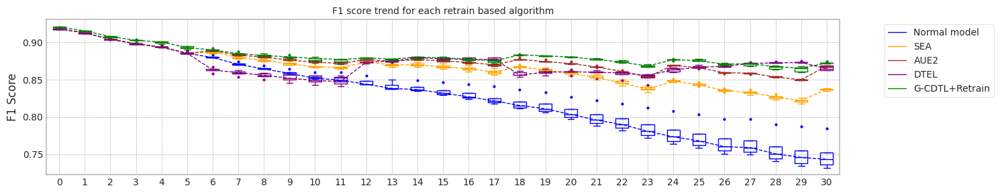

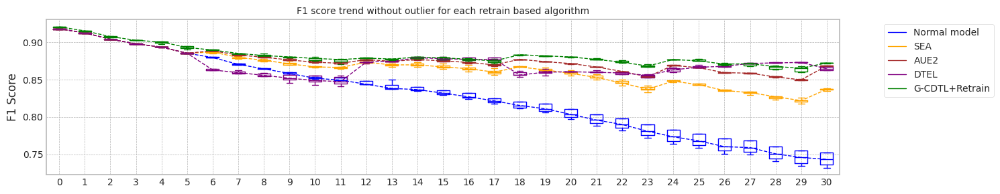

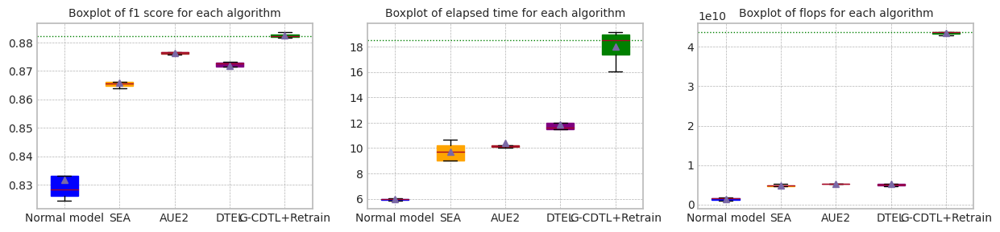

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.828425,0.743448,5.881542,1.111860e+09,121365000.0,1.233225e+09
1,1.0,0.917484,0.911968,0.826081,0.736690,5.977332,1.428975e+09,121365000.0,1.550340e+09
2,2.0,0.918611,0.913312,0.846309,0.784911,6.055723,1.652130e+09,121365000.0,1.773495e+09
3,3.0,0.917060,0.911745,0.824474,0.732351,5.959329,8.965350e+08,121365000.0,1.017900e+09
4,4.0,0.918281,0.912449,0.833232,0.752415,5.871610,1.397655e+09,121365000.0,1.519020e+09
5,median,0.918052,0.912449,0.828425,0.743448,5.959329,1.397655e+09,121365000.0,1.519020e+09
6,std,0.000623,0.000625,0.008807,0.020954,0.075563,2.950908e+08,0.0,2.950908e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920653,0.915697,0.840189,0.762458,5.864946,3.933000e+10,609615000.0,3.993962e+10
1,1.0,0.919311,0.913909,0.843570,0.762401,5.982949,3.933000e+10,609615000.0,3.993962e+10
2,2.0,0.919817,0.914225,0.820862,0.702603,5.949826,3.933000e+10,609615000.0,3.993962e+10
3,3.0,0.920799,0.915430,0.851497,0.775919,6.028911,3.933000e+10,609615000.0,3.993962e+10
4,4.0,0.920577,0.915182,0.833419,0.732372,6.089810,3.933000e+10,609615000.0,3.993962e+10
5,median,0.920577,0.915182,0.840189,0.762401,5.982949,3.933000e+10,609615000.0,3.993962e+10
6,std,0.000640,0.000780,0.011540,0.029569,0.084488,0.000000e+00,0.0,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.866164,0.837126,10.682393,2.489505e+09,2.704830e+09,5.194335e+09
1,1.0,0.917484,0.911968,0.864870,0.837324,9.025331,2.067990e+09,2.600430e+09,4.668420e+09
2,2.0,0.918611,0.913312,0.868508,0.838746,9.012567,2.062770e+09,2.818365e+09,4.881135e+09
3,3.0,0.917060,0.911745,0.863799,0.836307,10.194692,2.320725e+09,2.320725e+09,4.641450e+09
4,4.0,0.918281,0.912449,0.865582,0.835128,9.711193,2.194575e+09,2.695695e+09,4.890270e+09
5,median,0.918052,0.912449,0.865582,0.837126,9.711193,2.194575e+09,2.695695e+09,4.881135e+09
6,std,0.000623,0.000625,0.001759,0.001335,0.730497,1.809698e+08,1.883496e+08,2.221997e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.875938,0.868467,10.238401,2.405985e+09,2.742675e+09,5.148660e+09
1,1.0,0.917484,0.911968,0.875864,0.868803,10.170711,2.316810e+09,2.970615e+09,5.287425e+09
2,2.0,0.918611,0.913312,0.876463,0.868519,11.511691,2.637840e+09,3.514800e+09,6.152640e+09
3,3.0,0.917060,0.911745,0.876494,0.868172,10.099240,2.262000e+09,2.383365e+09,4.645365e+09
4,4.0,0.918281,0.912449,0.876566,0.867633,10.014195,2.250690e+09,2.873175e+09,5.123865e+09
5,median,0.918052,0.912449,0.876463,0.868467,10.170711,2.316810e+09,2.873175e+09,5.148660e+09
6,std,0.000623,0.000625,0.000335,0.000444,0.623220,1.594149e+08,4.108834e+08,5.489973e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918052,0.912752,0.871590,0.862847,11.614368,2.710485e+09,2.263740e+09,4.974225e+09
1,1.0,0.917484,0.911968,0.872646,0.874413,13.595795,3.131130e+09,2.835330e+09,5.966460e+09
2,2.0,0.918611,0.913312,0.873120,0.864476,11.511449,2.675250e+09,2.576940e+09,5.252190e+09
3,3.0,0.917060,0.911745,0.869298,0.862580,11.965907,2.718750e+09,2.065380e+09,4.784130e+09
4,4.0,0.918281,0.912449,0.872967,0.867417,10.570600,2.415120e+09,2.298975e+09,4.714095e+09
5,median,0.918052,0.912449,0.872646,0.864476,11.614368,2.710485e+09,2.298975e+09,4.974225e+09
6,std,0.000623,0.000625,0.001585,0.004902,1.103203,2.566903e+08,3.005152e+08,5.077221e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920653,0.915697,0.883743,0.874259,18.497555,4.267524e+10,1.146240e+09,4.382148e+10
1,1.0,0.919311,0.913909,0.881635,0.872285,18.973357,4.254414e+10,1.146240e+09,4.369038e+10
2,2.0,0.919817,0.914225,0.881936,0.872093,17.342699,4.216176e+10,1.146240e+09,4.330800e+10
3,3.0,0.920799,0.915430,0.882766,0.872714,16.040082,4.179686e+10,1.146240e+09,4.294310e+10
4,4.0,0.920577,0.915182,0.882132,0.871628,19.165689,4.251354e+10,1.146240e+09,4.365978e+10
5,median,0.920577,0.915182,0.882132,0.872285,18.497555,4.251354e+10,1.146240e+09,4.365978e+10
6,std,0.000640,0.000780,0.000837,0.001008,1.306433,3.573941e+08,0.000000e+00,3.573941e+08


In [ ]:

org_df_rt = {}
gcd_df_rt = {}
sea_df_rt = {}
aue_df_rt = {}
dte_df_rt = {}
gea_df_rt = {}


orgf_df_rt = {}
gcdf_df_rt = {}
seaf_df_rt = {}
auef_df_rt = {}
dtef_df_rt = {}
geaf_df_rt = {}

test_f1_score = []

for RT in range(1,6):
    org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case5',X1, Y1,train_size, test_size,avaible_range = 600,
                                                                lambda_f2=0.9,trial_count=5,lr_g=0.004,
                                                                retrain_count=RT,weight_init=True)
    test_f1_score = org_df['Testset F1']
    org_df_rt[f'{RT}'] = org_df['Mean F1']
    gcd_df_rt[f'{RT}'] = gcd_df['Mean F1']
    sea_df_rt[f'{RT}'] = sea_df['Mean F1']
    aue_df_rt[f'{RT}'] = aue_df['Mean F1']
    dte_df_rt[f'{RT}'] = dte_df['Mean F1']
    gea_df_rt[f'{RT}'] = gea_df['Mean F1']

    orgf_df_rt[f'{RT}'] = org_df['flops']
    gcdf_df_rt[f'{RT}'] = gcd_df['flops']
    seaf_df_rt[f'{RT}'] = sea_df['flops']
    auef_df_rt[f'{RT}'] = aue_df['flops']
    dtef_df_rt[f'{RT}'] = dte_df['flops']
    geaf_df_rt[f'{RT}'] = gea_df['flops']


Test F1 Score: 0.9178976860191084
Test F1 Score (95%): 0.8720028017181529


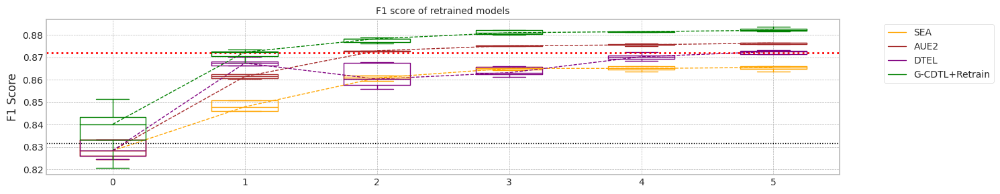

In [ ]:
org_df1 = pd.DataFrame(org_df_rt)
gcd_df1 = pd.DataFrame(gcd_df_rt)

sea_df1 = pd.DataFrame(sea_df_rt)
aue_df1 = pd.DataFrame(aue_df_rt)
dte_df1 = pd.DataFrame(dte_df_rt)
gea_df1 = pd.DataFrame(gea_df_rt)

sea_df1.insert(0, "0", org_df1['1'], True)
aue_df1.insert(0, "0", org_df1['1'], True)
dte_df1.insert(0, "0", org_df1['1'], True)
gea_df1.insert(0, "0", gcd_df1['1'], True)

fig, ax = plt.subplots(figsize=main_figsize)
lg = draw_chart2(ax,None,'SEA',sea_df1,'orange',showfliers=False)
lg = draw_chart2(ax,lg,'AUE2',aue_df1,'brown',showfliers=False)
lg = draw_chart2(ax,lg,'DTEL',dte_df1,'purple',showfliers=False)
lg = draw_chart2(ax,lg,'G-CDTL+Retrain',gea_df1,'green',showfliers=False)
#lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)

ax.axhline(y = np.mean(org_df1['1'][0:org_df1.shape[0]-2]), color = 'black', linewidth=1, linestyle = ':')

tf1 = np.mean(test_f1_score[0:org_df1.shape[0]-2])

print('Test F1 Score:',tf1)
print('Test F1 Score (95%):',tf1*0.95)

ax.axhline(y = tf1*0.95, color = 'red', linewidth=2, linestyle = ':')

set_legend2(ax,lg,'F1 score of retrained models')
plt.tight_layout()
plt.show()


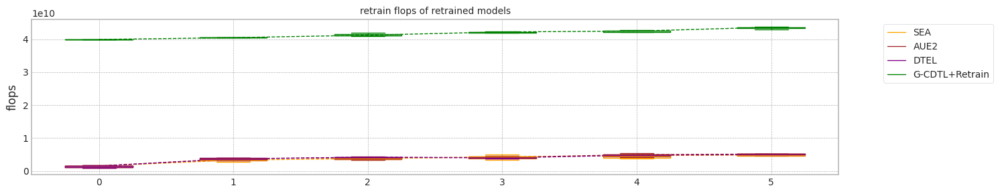

In [ ]:
org_df2 = pd.DataFrame(orgf_df_rt)
gcd_df2 = pd.DataFrame(gcdf_df_rt)

sea_df2 = pd.DataFrame(seaf_df_rt)
aue_df2 = pd.DataFrame(auef_df_rt)
dte_df2 = pd.DataFrame(dtef_df_rt)
gea_df2 = pd.DataFrame(geaf_df_rt)

sea_df2.insert(0, "0", org_df2['1'], True)
aue_df2.insert(0, "0", org_df2['1'], True)
dte_df2.insert(0, "0", org_df2['1'], True)
gea_df2.insert(0, "0", gcd_df2['1'], True)

fig, ax = plt.subplots(figsize=main_figsize)
lg = draw_chart3(ax,None,'SEA',sea_df2,'orange',showfliers=False)
lg = draw_chart3(ax,lg,'AUE2',aue_df2,'brown',showfliers=False)
lg = draw_chart3(ax,lg,'DTEL',dte_df2,'purple',showfliers=False)
lg = draw_chart3(ax,lg,'G-CDTL+Retrain',gea_df2,'green',showfliers=False)
#lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)

set_legend2(ax,lg,'retrain flops of retrained models')
plt.tight_layout()
plt.show()

# Real-world data 의 실험

In [75]:

if True:
    from google.colab import drive
    drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [76]:
from more_itertools import locate
from tqdm import tqdm
from sklearn.preprocessing import MinMaxScaler, StandardScaler

plt.style.use('bmh')
plt.rcParams['axes.facecolor'] = 'white'

def find_indices(list_to_check, item_to_find):
    indices = locate(list_to_check, lambda x: x == item_to_find)
    return list(indices)

def check_mi_drift(X:pd.DataFrame,Y:np.array,train_size:int,test_size:int,scaling=True):

    columns = X.columns
    is_Has_bucket = False
    # 'b' 즉, bucket count 가 있으며, 'b'를 제외 시킨다.
    if 'b' in columns:
        print('Dataset has buckets!')
        columns = columns[0:-1]
        buckets = list(X['b'])
        X = X[columns]
        is_Has_bucket = True

    mi_scores = make_mi_scores(X, Y, discrete_features="auto")
    #print(mi_scores)
    print(f'MI Analysis MI Max {np.max(mi_scores):.5f}, Min {np.min(mi_scores):.5f}, Mean {np.mean(mi_scores):.5f}, Std {np.std(mi_scores):.5f}')

    if scaling:
        scaler_c1 = MinMaxScaler()
        # trainset을 가지고 Scaler를 fit하고, testset을 포함한 그 이후의 Data를 모두 transform 한다.
        X = pd.DataFrame(np.concatenate((scaler_c1.fit_transform(X[0:train_size]), scaler_c1.transform(X[train_size:])),axis=0), columns=columns)
    else:
        X = pd.DataFrame(np.concatenate((X[0:train_size], X[train_size:]),axis=0), columns=columns)

    X_train = X[:train_size]
    Y_train = Y[:train_size]

    X_test = X[test_size:train_size+test_size]
    Y_test = Y[test_size:train_size+test_size]

    X_live = X[test_size:]
    Y_live = Y[test_size:]

    print('Dataset structure X_train,',X_train.shape,'X_test,',X_test.shape,'X_live',X_live.shape)
    X_live_set = []
    Y_live_set = []
    truncate_count = 0
    if is_Has_bucket:
        b_min = min(buckets[-X_live.shape[0]:])
        b_max = max(buckets[-X_live.shape[0]:])
        print(f'bucket range in live set {b_min}~{b_max}')
        for i in range(b_min,b_max+1):
            s = find_indices(buckets,i)
            if len(s) > 0:
                xl = X.iloc[s]
                yl = Y[s]
                X_live_set.append(xl)
                Y_live_set.append(yl)
    else:
        for i in range(int(X_live.shape[0]/test_size)):
            xl = X_live[i*test_size:i*test_size+train_size]
            yl = Y_live[i*test_size:i*test_size+train_size]

            if len(xl) ==  train_size:
                X_live_set.append(xl)
                Y_live_set.append(yl)
            else:
                #print(xl.shape)
                truncate_count = xl.shape[0] #truncate_count + len(xl)
                break

    print(f'Truncate {truncate_count} rows from live_set {X_live.shape}')
    X_live_set = np.asarray(X_live_set)
    Y_live_set = np.asarray(Y_live_set)

    MIS = {}
    DRF = {}
    for col in columns:
        MIS[col] = []
        DRF[col] = []

    print('Search MI & Drift...for X_live_set',X_live_set.shape)
    for X_live_unit,Y_live_unit in zip(tqdm(X_live_set),Y_live_set):
        X_live_unit = pd.DataFrame(X_live_unit,columns = columns)
        mi_scores = make_mi_scores(X_live_unit, Y_live_unit, discrete_features="auto")
        ks = __ks_drift(X_train.values,X_live_unit.values)
        for ix,col in enumerate(columns):
            MIS[col].append(mi_scores[col])
            DRF[col].append(ks[:,0][ix])

    df_mis = pd.DataFrame(MIS)
    df_drf = pd.DataFrame(DRF)

    for c_name in df_mis.columns:
        fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
        df_mis[c_name].plot(ax=ax[0],linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',legend=None)
        ax[0].set_title(f'Mutual Information of {c_name}',fontdict={'fontsize':10})

        df_drf[c_name].plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})')
        ax[1].set_title(f'Drift (KS-test) of {c_name}',fontdict={'fontsize':10})
        ax[1].legend(bbox_to_anchor=(1.0, 1.0))
        plt.show()

    fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
    df_mis.plot(ax=ax[0],linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',legend=None)
    ax[0].set_title(f'Mutual Information',fontdict={'fontsize':10})

    df_drf.plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})')
    ax[1].set_title(f'Drift (KS-test)',fontdict={'fontsize':10})
    ax[1].legend(bbox_to_anchor=(1.0, 1.0))
    plt.show()

    if is_Has_bucket:
        X['b'] = buckets
    return X,Y

## Loan data 실험

### Dataset 준비

#### Data load

In [77]:

df_accepted = pd.read_csv("/content/drive/MyDrive/Drift/accepted_2007_to_2018Q4.csv")

print(df_accepted.shape)

(2260701, 151)


#### Data 정제

In [78]:
# for the sake of simplicity, let's consider only Fully Paid and Charged Off values:
df_accepted = df_accepted[df_accepted.loan_status.isin(['Fully Paid', 'Charged Off'])]
print(df_accepted.shape)

cols_to_drop = df_accepted.isnull().sum().sort_values(ascending=False).head(50).index
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)

# maybe we can go further, and eliminate columns up to title:
cols_to_drop = df_accepted.isnull().sum().sort_values(ascending=False).head(45).index
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)

# Remaining columns have missing data points, but they account for less than 0.2% of the total data. Let's remove the rows that are missing those values in those columns with dropna():
df_accepted = df_accepted.dropna()
print(df_accepted.shape)

# These are constant columns. We can drop it either.
cols_to_drop = ['out_prncp', 'out_prncp_inv', 'policy_code']
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)

# It seems we have many "duplicated" information. Let's drop some columns, based on visual inspection at corr_pairs dataframe:
cols_to_drop = ['fico_range_low', 'funded_amnt_inv', 'funded_amnt', 'total_pymnt_inv', 'total_pymnt', 'installment', 'collection_recovery_fee', 'total_rec_prncp', 'last_fico_range_low']
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)

values = df_accepted.loan_status.unique()
encode = [1,0]
d = dict(zip(values, encode))
df_accepted['loan_paid'] = df_accepted['loan_status'].map(d)
df_accepted = df_accepted.drop(columns=['loan_status'])

df_accepted

(1345310, 151)
(1345310, 101)
(1345310, 56)
(1341026, 56)
(1341026, 53)
(1341026, 44)


,id,loan_amnt,term,int_rate,grade,sub_grade,home_ownership,annual_inc,verification_status,issue_d,...,application_type,acc_now_delinq,chargeoff_within_12_mths,delinq_amnt,pub_rec_bankruptcies,tax_liens,hardship_flag,disbursement_method,debt_settlement_flag,loan_paid
0,68407277,3600.0,36 months,13.99,C,C4,MORTGAGE,55000.0,Not Verified,Dec-2015,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
1,68355089,24700.0,36 months,11.99,C,C1,MORTGAGE,65000.0,Not Verified,Dec-2015,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
2,68341763,20000.0,60 months,10.78,B,B4,MORTGAGE,63000.0,Not Verified,Dec-2015,...,Joint App,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
4,68476807,10400.0,60 months,22.45,F,F1,MORTGAGE,104433.0,Source Verified,Dec-2015,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
5,68426831,11950.0,36 months,13.44,C,C3,RENT,34000.0,Source Verified,Dec-2015,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2260688,89905081,18000.0,60 months,9.49,B,B2,OWN,130000.0,Not Verified,Oct-2016,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
2260690,88948836,29400.0,60 months,13.99,C,C3,MORTGAGE,180792.0,Not Verified,Oct-2016,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
2260691,89996426,32000.0,60 months,14.49,C,C4,MORTGAGE,157000.0,Source Verified,Oct-2016,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,0
2260692,90006534,16000.0,60 months,12.79,C,C1,RENT,150000.0,Not Verified,Oct-2016,...,Individual,0.0,0.0,0.0,3.0,0.0,N,Cash,N,1


In [79]:
# droping constant columns
print(df_accepted.pymnt_plan.value_counts())
print(df_accepted.hardship_flag.value_counts())
cols_to_drop = ['id', 'pymnt_plan', 'hardship_flag']
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)
cat_cols = df_accepted.select_dtypes(include=['object']).columns
print(cat_cols)

print(df_accepted.term.value_counts())

# convert term into either a 36 or 60 integer numeric data type

l1 = df_accepted.term.unique()
l2 = [36, 60]
d = dict(zip(l1, l2))

df_accepted['term'] = df_accepted['term'].map(d)

# as grade is part of sub_grade, so let's just drop the grade feature.

df_accepted = df_accepted.drop(columns='grade')

df_accepted = pd.get_dummies(df_accepted, columns = ['sub_grade'], prefix='', prefix_sep='', drop_first=True)

cat_cols = df_accepted.select_dtypes(include=['object']).columns
print(cat_cols)

# for these columns, let's just create dummy variables, concatenate them with the original dataframe and drop original columns.

df_accepted = pd.get_dummies(df_accepted, columns = ['verification_status'], prefix='', prefix_sep='', drop_first=True)
df_accepted = pd.get_dummies(df_accepted, columns = ['application_type'], prefix='', prefix_sep='', drop_first=True)
df_accepted = pd.get_dummies(df_accepted, columns = ['initial_list_status'], prefix='', prefix_sep='', drop_first=True)
df_accepted = pd.get_dummies(df_accepted, columns = ['purpose'], prefix='', prefix_sep='', drop_first=True)
print(df_accepted.shape)

df_accepted['home_ownership'] = df_accepted.home_ownership.replace('NONE', 'ANY')
df_accepted = pd.get_dummies(df_accepted, columns = ['home_ownership'], prefix='', prefix_sep='', drop_first=True)
df_accepted = df_accepted.drop(columns=[ 'url', 'last_pymnt_d', 'last_credit_pull_d'])
df_accepted = df_accepted.drop(columns=['zip_code', 'addr_state'])
df_accepted = pd.get_dummies(df_accepted, columns = ['disbursement_method'], prefix='', prefix_sep='', drop_first=True)
df_accepted = pd.get_dummies(df_accepted, columns = ['debt_settlement_flag'], prefix='', prefix_sep='', drop_first=True)
df_accepted = df_accepted.drop(columns=['earliest_cr_line'])
print(df_accepted.shape)


df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Jan','01')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Feb','02')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Mar','03')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Apr','04')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('May','05')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Jun','06')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Jul','07')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Aug','08')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Sep','09')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Oct','10')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Dec','11')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Nov','12')

def reorder_issue_d(dt):
    a = dt.split('-')
    return a[1]+a[0]

reorder_issue_d('01-2009')

df_accepted['issue_d'] = df_accepted['issue_d'].apply(reorder_issue_d)
df_accepted = df_accepted.sort_values(by='issue_d')
df_accepted.reset_index(drop=True, inplace=True)

df_accepted.info()

n    1341026
Name: pymnt_plan, dtype: int64
N    1341026
Name: hardship_flag, dtype: int64
(1341026, 41)
Index(['term', 'grade', 'sub_grade', 'home_ownership', 'verification_status',
       'issue_d', 'url', 'purpose', 'zip_code', 'addr_state',
       'earliest_cr_line', 'initial_list_status', 'last_pymnt_d',
       'last_credit_pull_d', 'application_type', 'disbursement_method',
       'debt_settlement_flag'],
      dtype='object')
 36 months    1017398
 60 months     323628
Name: term, dtype: int64
Index(['home_ownership', 'verification_status', 'issue_d', 'url', 'purpose',
       'zip_code', 'addr_state', 'earliest_cr_line', 'initial_list_status',
       'last_pymnt_d', 'last_credit_pull_d', 'application_type',
       'disbursement_method', 'debt_settlement_flag'],
      dtype='object')
(1341026, 86)
(1341026, 83)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1341026 entries, 0 to 1341025
Data columns (total 83 columns):
 #   Column                      Non-Null Count    Dtype  

#### Dataset 만들기

In [80]:
X = {}
Y = {}

df = df_accepted[df_accepted['issue_d'].str.startswith('2007') + df_accepted['issue_d'].str.startswith('2008') + df_accepted['issue_d'].str.startswith('2009')].copy()
df = df.drop(columns=['issue_d'])


X[2009] = df.loc[:, df.columns != 'loan_paid'].values
Y[2009] = df.loan_paid.values


for year in range(2010,2019):
    print(year)
    df = df_accepted[df_accepted['issue_d'].str.startswith(str(year))].copy()
    df = df.drop(columns=['issue_d'])
    X[year] = df.loc[:, df.columns != 'loan_paid'].values
    Y[year] = df.loan_paid.values

2010
2011
2012
2013
2014
2015
2016
2017
2018


In [81]:

X[2010].shape

(11497, 81)

In [82]:
COLUMNS = df.loc[:, df.columns != 'loan_paid'].columns
COLUMNS

Index(['loan_amnt', 'term', 'int_rate', 'annual_inc', 'dti', 'delinq_2yrs',
       'fico_range_high', 'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal',
       'revol_util', 'total_acc', 'total_rec_int', 'total_rec_late_fee',
       'recoveries', 'last_pymnt_amnt', 'last_fico_range_high',
       'collections_12_mths_ex_med', 'acc_now_delinq',
       'chargeoff_within_12_mths', 'delinq_amnt', 'pub_rec_bankruptcies',
       'tax_liens', 'A2', 'A3', 'A4', 'A5', 'B1', 'B2', 'B3', 'B4', 'B5', 'C1',
       'C2', 'C3', 'C4', 'C5', 'D1', 'D2', 'D3', 'D4', 'D5', 'E1', 'E2', 'E3',
       'E4', 'E5', 'F1', 'F2', 'F3', 'F4', 'F5', 'G1', 'G2', 'G3', 'G4', 'G5',
       'Source Verified', 'Verified', 'Joint App', 'w', 'credit_card',
       'debt_consolidation', 'educational', 'home_improvement', 'house',
       'major_purchase', 'medical', 'moving', 'other', 'renewable_energy',
       'small_business', 'vacation', 'wedding', 'MORTGAGE', 'OTHER', 'OWN',
       'RENT', 'DirectPay', 'Y'],
      dtype

In [83]:
seed_everything(12)

X_df = pd.DataFrame(X[2010],columns=COLUMNS)
mi_scores = make_mi_scores(X_df, Y[2010], discrete_features="auto")
print(mi_scores)

recoveries                  0.375327
last_fico_range_high        0.090427
last_pymnt_amnt             0.085496
total_rec_late_fee          0.038954
int_rate                    0.016850
                              ...   
F2                          0.000000
chargeoff_within_12_mths    0.000000
G1                          0.000000
G3                          0.000000
D3                          0.000000
Name: MI Scores, Length: 81, dtype: float64


In [84]:
# MI Top 5, columns
top_columns = list(mi_scores[1:6].index)
top_columns

['last_fico_range_high',
 'last_pymnt_amnt',
 'total_rec_late_fee',
 'int_rate',
 'term']

### #1 고정 size로 bucket 만들기

In [85]:
# 1/10 로 사이즈 줄이기...
seed_everything()

X2 = np.concatenate((X[2010],X[2011],X[2012],X[2013],X[2014],X[2015],X[2016],X[2017]))
Y2 = np.concatenate((Y[2010],Y[2011],Y[2012],Y[2013],Y[2014],Y[2015],Y[2016],Y[2017]))
s = np.sort(np.random.choice(X2.shape[0],int(X2.shape[0]/10),replace= False))
#print(s.shape)
X3 = pd.DataFrame(X2[s],columns=COLUMNS)
Y3 = Y2[s]

##### do

columns: ['last_pymnt_amnt', 'total_rec_late_fee', 'inq_last_6mths', 'total_rec_int', 'Y']
MI Analysis MI Max 0.27267, Min 0.00456, Mean 0.07066, Std 0.10189
Dataset structure X_train, (20000, 5) X_test, (20000, 5) X_live (123968, 5)
Truncate 19968 rows from live_set (123968, 5)
Search MI & Drift...for X_live_set (26, 20000, 5)


100%|██████████| 26/26 [00:11<00:00,  2.35it/s]


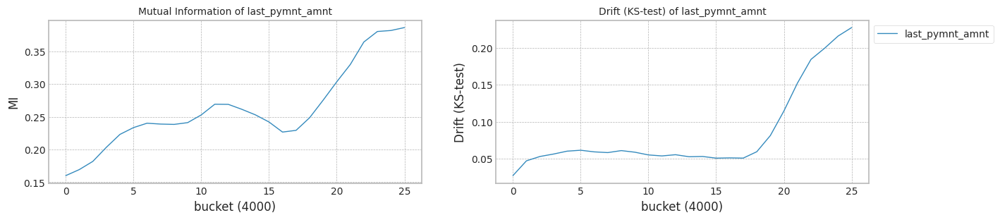

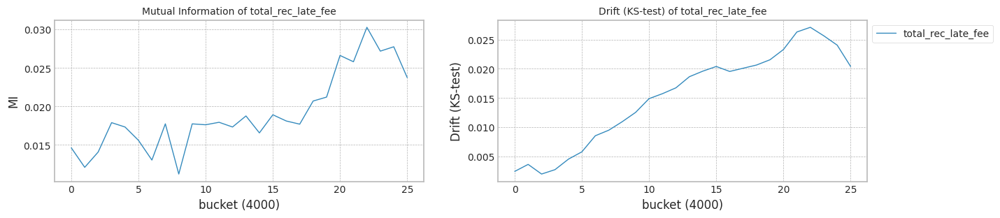

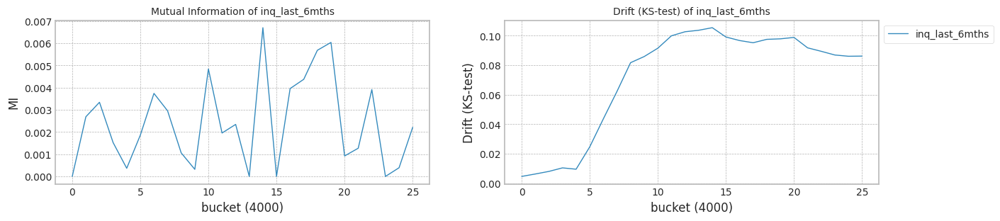

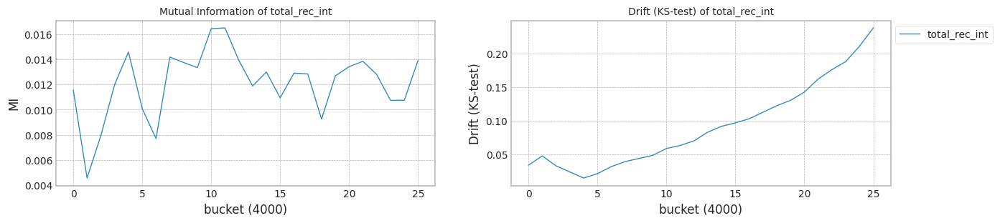

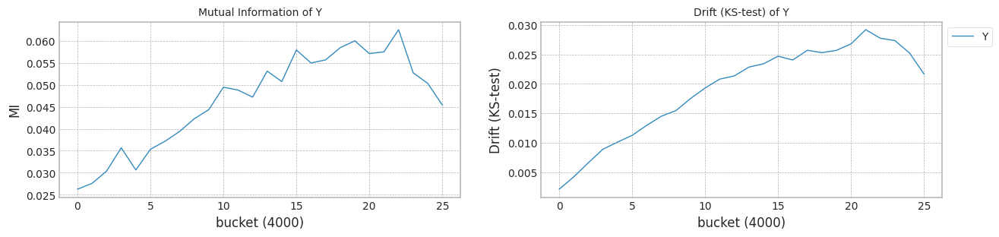

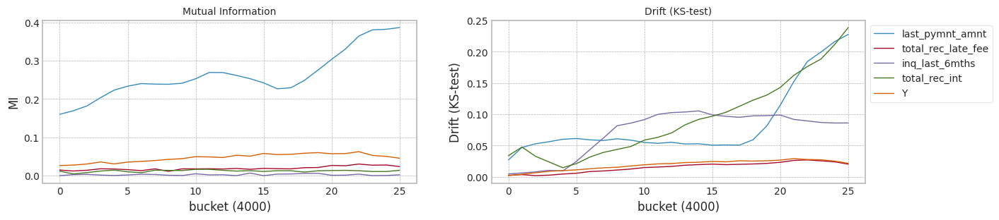

In [86]:
seed_everything()

#s = np.sort(np.random.choice(len(COLUMNS),2,replace= False))
top_columns = list(mi_scores[0:15].index)
top_columns = ['last_pymnt_amnt', 'total_rec_late_fee', 'inq_last_6mths', 'total_rec_int', 'Y']
print('columns:',top_columns)
#print(s.shape)
X4 = X3[top_columns]

train_size = 10000*2
test_size = 2000*2

X1,Y1 = check_mi_drift(X4, Y3, train_size, test_size)

bucket_size = 500*2
X1['b'] = [int(b/bucket_size) for b in X1.index.values]


In [101]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]

trial_count: 1
Lambda :  0.9
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-27 12:56:07,204] [INFO] [profiler.py:80:start_profile] Flops profiler started


 40%|████      | 808/2000 [00:02<00:03, 339.22it/s]

Early stop: 808
[2023-11-27 12:56:09,592] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 7038300000
precision_recall_fscore: (array([0.75324675, 0.85296967]), array([0.09136736, 0.99435398]), array([0.16296713, 0.91825142]), array([ 3174, 16826]))
Test f1 score: 0.9182514201037292
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.37it/s]

mean of drift:
last_pymnt_amnt       0.084537
total_rec_late_fee    0.021850
inq_last_6mths        0.210100
total_rec_int         0.091921
Y                     0.019027
dtype: float64
Mean F1 for all data: 0.9013939150966132
inference_flops: 226200000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-11-27 12:56:20,658] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:56:20,660] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 28%|██▊       | 561/2000 [00:04<00:12, 117.03it/s]

[2023-11-27 12:56:29,241] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:56:29,244] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 21805000000 19670000000 4889400000 46364400000
precision_recall_fscore: (array([0.78015564, 0.8576927 ]), array([0.126339 , 0.9932842]), array([0.21746204, 0.92052214]), array([ 3174, 16826]))
Test f1 score: 0.9205221414408461
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.40it/s]


mean of drift:
last_pymnt_amnt       0.401129
total_rec_late_fee    0.985538
inq_last_6mths        0.543554
total_rec_int         0.595648
Y                     0.842925
dtype: float64
Mean F1 for all data: 0.9014660908374865
inference_flops: 1136200000
Normal model median        : 0.9013939150966132
Drift tolerant model median: 0.9014660908374865
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 14
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.37it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-27 12:56:46,033] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 12:56:46,035] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 12:57:00,571] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 12:57:00,572] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:20<00:57,  4.82s/it]

G-CDTL train flops: 14000000000 3472000000 863040000 18335040000


100%|██████████| 26/26 [00:25<00:00,  1.01it/s]


Early stop at  [495]
Train flops  [18335040000]
Mean of drift:
last_pymnt_amnt       0.084537
total_rec_late_fee    0.021850
inq_last_6mths        0.210100
total_rec_int         0.091921
Y                     0.019027
dtype: float64
Mean F1 for all data: 0.8901921193982308
G_CDTL+AUE median: 0.8901921193982308
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:08<00:14,  1.19s/it]

Ensemble_SEA train flops: 2152380000


100%|██████████| 26/26 [00:13<00:00,  1.86it/s]


Early stop at  [1236]
Train flops  [2152380000]
Mean of drift:
last_pymnt_amnt       0.084537
total_rec_late_fee    0.021850
inq_last_6mths        0.210100
total_rec_int         0.091921
Y                     0.019027
dtype: float64
Mean F1 for all data: 0.9017504256009694
SEA median: 0.9017504256009694
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:12<00:28,  2.39s/it]

Ensemble_SEA train flops: 3020640000


100%|██████████| 26/26 [00:18<00:00,  1.43it/s]


Early stop at  [1735]
Train flops  [3020640000]
Mean of drift:
last_pymnt_amnt       0.084537
total_rec_late_fee    0.021850
inq_last_6mths        0.210100
total_rec_int         0.091921
Y                     0.019027
dtype: float64
Mean F1 for all data: 0.9020292166109656
AUE median: 0.9020292166109656
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:09<00:18,  1.52s/it]

Ensemble_DTEL train flops: 2949300000
Ensemble_DTEL train flops: 8700000


100%|██████████| 26/26 [00:14<00:00,  1.74it/s]


Early stop at  [1694, 4]
Train flops  [2949300000, 8700000]
Mean of drift:
last_pymnt_amnt       0.084537
total_rec_late_fee    0.021850
inq_last_6mths        0.210100
total_rec_int         0.091921
Y                     0.019027
dtype: float64
Mean F1 for all data: 0.9004837430281006
DTEL median: 0.9004837430281006


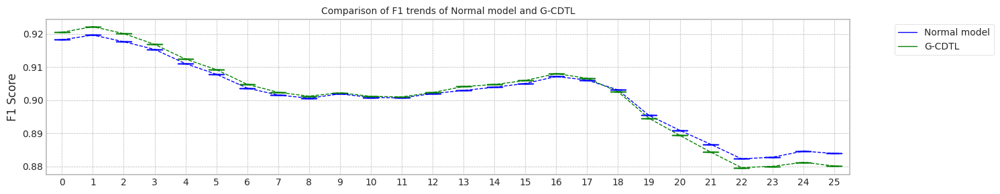

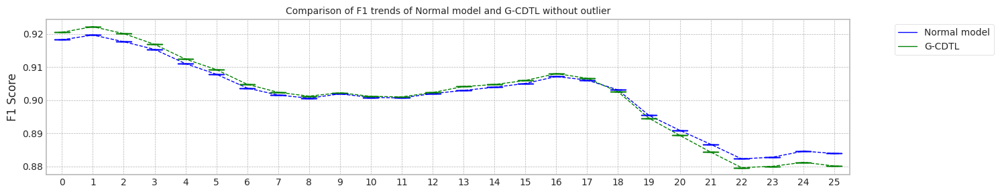

max_mean_trial= 0


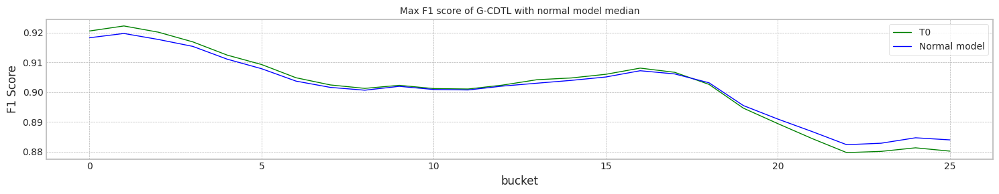

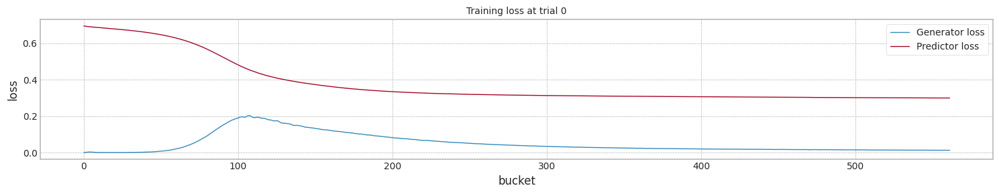

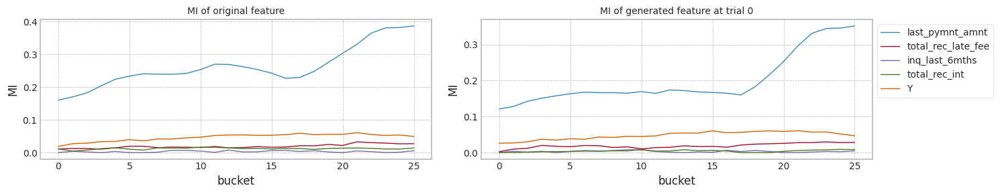

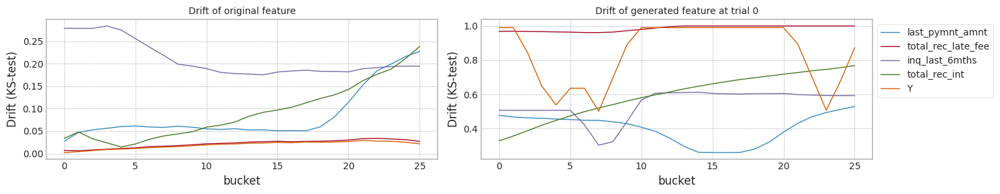

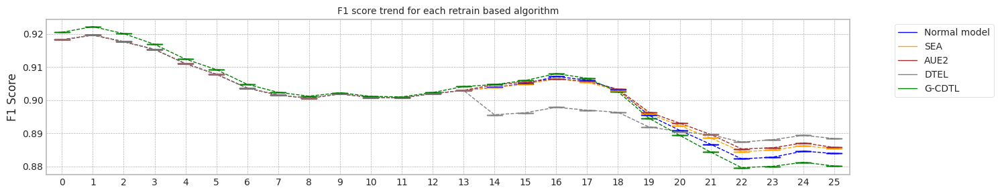

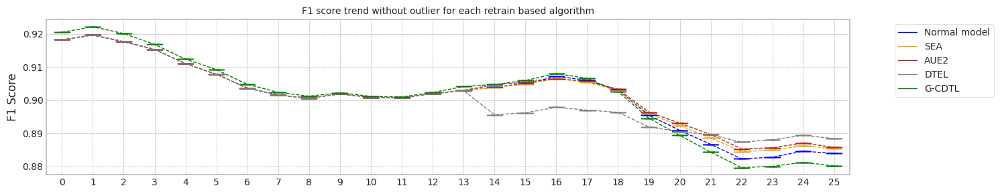

Base elapsed time (inference elapsed time of normal model, median (ms)): 11.042159795761108
Base flops (inference flops of normal model, median): 226200000.0


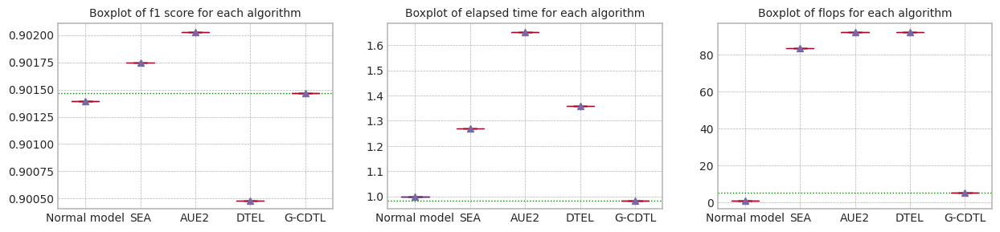

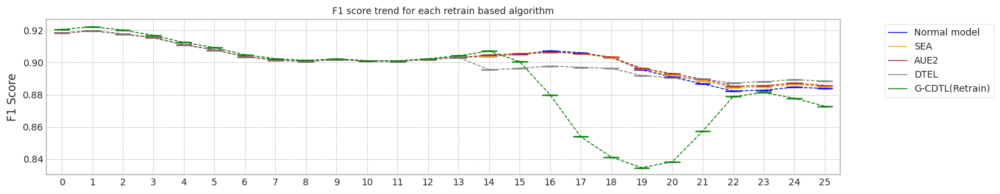

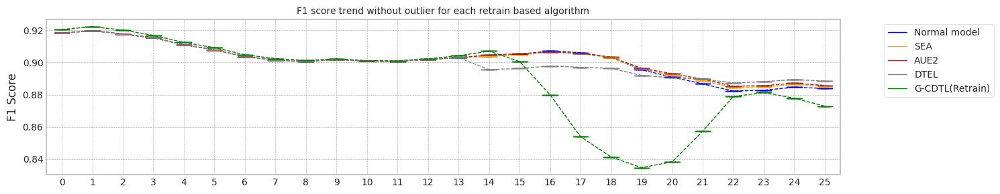

Base elapsed time (inference elapsed time of normal model, median (ms)): 11.042159795761108
Base flops (train + inference flops of normal model, median): 7264500000.0


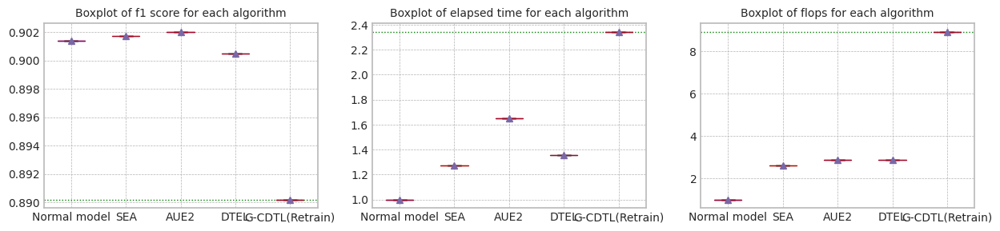

Base elapsed time (inference elapsed time of normal model, median (ms)): 11.042159795761108


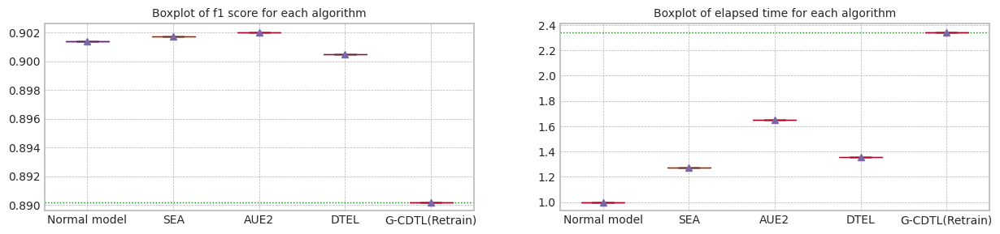

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918251,0.919688,0.901394,0.883918,11.04216,7.038300e+09,226200000.0,7.264500e+09
1,median,0.918251,0.919688,0.901394,0.883918,11.04216,7.038300e+09,226200000.0,7.264500e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920522,0.922217,0.901466,0.880141,10.869247,4.636440e+10,1.136200e+09,4.750060e+10
1,median,0.920522,0.922217,0.901466,0.880141,10.869247,4.636440e+10,1.136200e+09,4.750060e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918251,0.919688,0.90175,0.885321,14.019948,9.190680e+09,9.756180e+09,1.894686e+10
1,median,0.918251,0.919688,0.90175,0.885321,14.019948,9.190680e+09,9.756180e+09,1.894686e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918251,0.919688,0.902029,0.885747,18.244996,1.005894e+10,1.085064e+10,2.090958e+10
1,median,0.918251,0.919688,0.902029,0.885747,18.244996,1.005894e+10,1.085064e+10,2.090958e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918251,0.919688,0.900484,0.888422,14.993389,9.996300e+09,1.090980e+10,2.090610e+10
1,median,0.918251,0.919688,0.900484,0.888422,14.993389,9.996300e+09,1.090980e+10,2.090610e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920522,0.922217,0.890192,0.8729,25.88161,6.469944e+10,238800000.0,6.493824e+10
1,median,0.920522,0.922217,0.890192,0.8729,25.88161,6.469944e+10,238800000.0,6.493824e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [103]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'LC_A',X1, Y1,train_size, test_size,avaible_range = 300,
                                                            lambda_f2=0.9,trial_count=1,lr_g=0.002,
                                                            retrain_count=1,weight_init=True)

trial_count: 20
lambda_f2 0.8
######################### Trial 0 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 824.19it/s]


precision_recall_fscore: (array([0.    , 0.8413]), array([0., 1.]), array([0.        , 0.91381089]), array([ 3174, 16826]))
Test f1 score: 0.9138108944767285
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.10it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867796026890064
######################### Trial 0 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 232.23it/s]


precision_recall_fscore: (array([1.        , 0.88791557]), array([0.33081285, 1.        ]), array([0.49715909, 0.94063059]), array([ 3174, 16826]))
Test f1 score: 0.9406305903398926
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.05it/s]


mean of drift:
recoveries              0.841225
last_fico_range_high    0.347154
last_pymnt_amnt         0.490915
total_rec_late_fee      0.920042
int_rate                0.152225
dtype: float64
Mean F1 for all data: 0.9206478624704398
Normal model median        : 0.8867796026890064
Drift tolerant model median: 0.9206478624704398
######################### Trial 1 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 796.94it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.08it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8868058824094563
######################### Trial 1 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 235.70it/s]


precision_recall_fscore: (array([1.        , 0.90185989]), array([0.42312539, 1.        ]), array([0.59464246, 0.94839782]), array([ 3174, 16826]))
Test f1 score: 0.9483978243102331
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.12it/s]


mean of drift:
recoveries              0.856183
last_fico_range_high    0.445502
last_pymnt_amnt         0.347467
total_rec_late_fee      0.966137
int_rate                0.123500
dtype: float64
Mean F1 for all data: 0.9090284719288496
Normal model median        : 0.8867927425492313
Drift tolerant model median: 0.9148381671996447
######################### Trial 2 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 848.58it/s]


precision_recall_fscore: (array([0.    , 0.8413]), array([0., 1.]), array([0.        , 0.91381089]), array([ 3174, 16826]))
Test f1 score: 0.9138108944767285
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.12it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867807649556808
######################### Trial 2 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 236.61it/s]


precision_recall_fscore: (array([1.        , 0.85281298]), array([0.08506616, 1.        ]), array([0.15679443, 0.92056024]), array([ 3174, 16826]))
Test f1 score: 0.9205602363497101
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.13it/s]


mean of drift:
recoveries              0.825440
last_fico_range_high    0.198187
last_pymnt_amnt         0.523052
total_rec_late_fee      0.967523
int_rate                0.553154
dtype: float64
Mean F1 for all data: 0.8903642163170178
Normal model median        : 0.8867807649556808
Drift tolerant model median: 0.9090284719288496
######################### Trial 3 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 804.77it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.08it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867861910860791
######################### Trial 3 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 232.04it/s]


precision_recall_fscore: (array([1.        , 0.86996536]), array([0.20762445, 1.        ]), array([0.34385599, 0.93046147]), array([ 3174, 16826]))
Test f1 score: 0.9304614704011945
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.10it/s]


mean of drift:
recoveries              0.835263
last_fico_range_high    0.313650
last_pymnt_amnt         0.492958
total_rec_late_fee      0.867046
int_rate                0.269581
dtype: float64
Mean F1 for all data: 0.90326029739122
Normal model median        : 0.88678347802088
Drift tolerant model median: 0.9061443846600348
######################### Trial 4 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 796.60it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.06it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.886784854031226
######################### Trial 4 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 236.87it/s]


precision_recall_fscore: (array([1.        , 0.87859642]), array([0.26748582, 1.        ]), array([0.42207308, 0.93537538]), array([ 3174, 16826]))
Test f1 score: 0.9353753787141785
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.13it/s]


mean of drift:
recoveries              0.861004
last_fico_range_high    0.344687
last_pymnt_amnt         0.527025
total_rec_late_fee      0.966488
int_rate                0.240369
dtype: float64
Mean F1 for all data: 0.91758194578029
Normal model median        : 0.886784854031226
Drift tolerant model median: 0.9090284719288496
######################### Trial 5 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 820.73it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.05it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867861910860791
######################### Trial 5 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 236.23it/s]


precision_recall_fscore: (array([1.        , 0.86799071]), array([0.19376181, 1.        ]), array([0.32462391, 0.92933087]), array([ 3174, 16826]))
Test f1 score: 0.9293308663113419
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.10it/s]


mean of drift:
recoveries              0.857058
last_fico_range_high    0.259265
last_pymnt_amnt         0.374685
total_rec_late_fee      0.936950
int_rate                0.392975
dtype: float64
Mean F1 for all data: 0.9402007124154911
Normal model median        : 0.8867855225586525
Drift tolerant model median: 0.9133052088545698
######################### Trial 6 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 806.51it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.01it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867786117691027
######################### Trial 6 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 234.01it/s]


precision_recall_fscore: (array([1.        , 0.87868818]), array([0.26811594, 1.        ]), array([0.42285714, 0.93542738]), array([ 3174, 16826]))
Test f1 score: 0.9354273801250869
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.10it/s]


mean of drift:
recoveries              0.846146
last_fico_range_high    0.371567
last_pymnt_amnt         0.484277
total_rec_late_fee      0.954515
int_rate                0.199246
dtype: float64
Mean F1 for all data: 0.9032010310670172
Normal model median        : 0.886784854031226
Drift tolerant model median: 0.9090284719288496
######################### Trial 7 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 785.87it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.03it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8868011438966228
######################### Trial 7 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 231.14it/s]


precision_recall_fscore: (array([1.        , 0.89906492]), array([0.40485192, 1.        ]), array([0.57636241, 0.94685012]), array([ 3174, 16826]))
Test f1 score: 0.9468501167665513
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.09it/s]


mean of drift:
recoveries              0.853127
last_fico_range_high    0.446237
last_pymnt_amnt         0.451069
total_rec_late_fee      0.852865
int_rate                0.185412
dtype: float64
Mean F1 for all data: 0.9239163190162529
Normal model median        : 0.8867855225586525
Drift tolerant model median: 0.9133052088545698
######################### Trial 8 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 771.51it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.04it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867895997648609
######################### Trial 8 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 226.53it/s]


precision_recall_fscore: (array([1.        , 0.85974145]), array([0.13516068, 1.        ]), array([0.23813489, 0.9245817 ]), array([ 3174, 16826]))
Test f1 score: 0.9245816962936505
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.07it/s]


mean of drift:
recoveries              0.845519
last_fico_range_high    0.264865
last_pymnt_amnt         0.455987
total_rec_late_fee      0.968412
int_rate                0.269888
dtype: float64
Mean F1 for all data: 0.891313259395962
Normal model median        : 0.8867861910860791
Drift tolerant model median: 0.9090284719288496
######################### Trial 9 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 744.56it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.01it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867754020036018
######################### Trial 9 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 226.37it/s]


precision_recall_fscore: (array([1.       , 0.9376428]), array([0.64744802, 1.        ]), array([0.78600115, 0.96781801]), array([ 3174, 16826]))
Test f1 score: 0.9678180092605908
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.08it/s]


mean of drift:
recoveries              0.861237
last_fico_range_high    0.347075
last_pymnt_amnt         0.489787
total_rec_late_fee      0.953802
int_rate                0.109481
dtype: float64
Mean F1 for all data: 0.9540626754464031
Normal model median        : 0.8867855225586525
Drift tolerant model median: 0.9133052088545698
######################### Trial 10 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 783.03it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.04it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867786726059038
######################### Trial 10 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 228.78it/s]


precision_recall_fscore: (array([1.        , 0.86495656]), array([0.17233774, 1.        ]), array([0.29400699, 0.92758896]), array([ 3174, 16826]))
Test f1 score: 0.9275889633121089
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.08it/s]


mean of drift:
recoveries              0.831679
last_fico_range_high    0.184571
last_pymnt_amnt         0.504933
total_rec_late_fee      0.921235
int_rate                0.492740
dtype: float64
Mean F1 for all data: 0.8999985523090415
Normal model median        : 0.886784854031226
Drift tolerant model median: 0.9090284719288496
######################### Trial 11 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 772.05it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.04it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867834016373002
######################### Trial 11 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 233.95it/s]


precision_recall_fscore: (array([1.        , 0.88875977]), array([0.33648393, 1.        ]), array([0.50353607, 0.94110409]), array([ 3174, 16826]))
Test f1 score: 0.941104088595559
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.12it/s]


mean of drift:
recoveries              0.843748
last_fico_range_high    0.328108
last_pymnt_amnt         0.526538
total_rec_late_fee      0.923485
int_rate                0.367077
dtype: float64
Mean F1 for all data: 0.9433048343591127
Normal model median        : 0.8867841278342631
Drift tolerant model median: 0.9133052088545698
######################### Trial 12 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 817.25it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.07it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.88677671444041
######################### Trial 12 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 235.16it/s]


precision_recall_fscore: (array([1.        , 0.91905178]), array([0.53308129, 1.        ]), array([0.69543773, 0.95781864]), array([ 3174, 16826]))
Test f1 score: 0.9578186372175101
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.12it/s]


mean of drift:
recoveries              0.849660
last_fico_range_high    0.390948
last_pymnt_amnt         0.504362
total_rec_late_fee      0.954475
int_rate                0.315600
dtype: float64
Mean F1 for all data: 0.9362629554733252
Normal model median        : 0.8867834016373002
Drift tolerant model median: 0.91758194578029
######################### Trial 13 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 773.71it/s]


precision_recall_fscore: (array([0.    , 0.8413]), array([0., 1.]), array([0.        , 0.91381089]), array([ 3174, 16826]))
Test f1 score: 0.9138108944767285
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.07it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867855442132868
######################### Trial 13 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 234.17it/s]


precision_recall_fscore: (array([1.        , 0.90642676]), array([0.45274102, 1.        ]), array([0.62329213, 0.95091695]), array([ 3174, 16826]))
Test f1 score: 0.9509169515951283
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.12it/s]


mean of drift:
recoveries              0.861277
last_fico_range_high    0.374588
last_pymnt_amnt         0.508663
total_rec_late_fee      0.898817
int_rate                0.143008
dtype: float64
Mean F1 for all data: 0.9505253248563446
Normal model median        : 0.8867841278342631
Drift tolerant model median: 0.9191149041253649
######################### Trial 14 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 790.69it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.06it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867861910860791
######################### Trial 14 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 235.04it/s]


precision_recall_fscore: (array([1.        , 0.93105356]), array([0.60743541, 1.        ]), array([0.75578205, 0.96429595]), array([ 3174, 16826]))
Test f1 score: 0.9642959481918734
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.11it/s]


mean of drift:
recoveries              0.858067
last_fico_range_high    0.314831
last_pymnt_amnt         0.346844
total_rec_late_fee      0.972694
int_rate                0.346935
dtype: float64
Mean F1 for all data: 0.933827250504141
Normal model median        : 0.886784854031226
Drift tolerant model median: 0.9206478624704398
######################### Trial 15 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 785.50it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.07it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8868071041269603
######################### Trial 15 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 236.01it/s]


precision_recall_fscore: (array([1.        , 0.91035005]), array([0.47794581, 1.        ]), array([0.64677041, 0.95307145]), array([ 3174, 16826]))
Test f1 score: 0.9530714548698632
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.12it/s]


mean of drift:
recoveries              0.861123
last_fico_range_high    0.341837
last_pymnt_amnt         0.519623
total_rec_late_fee      0.895123
int_rate                0.341340
dtype: float64
Mean F1 for all data: 0.9512326632848241
Normal model median        : 0.8867851991222564
Drift tolerant model median: 0.9222820907433464
######################### Trial 16 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 803.96it/s]


precision_recall_fscore: (array([0.    , 0.8413]), array([0., 1.]), array([0.        , 0.91381089]), array([ 3174, 16826]))
Test f1 score: 0.9138108944767285
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.06it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867902729342192
######################### Trial 16 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 236.58it/s]


precision_recall_fscore: (array([1.        , 0.86951579]), array([0.20447385, 1.        ]), array([0.33952393, 0.93020427]), array([ 3174, 16826]))
Test f1 score: 0.930204273433397
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.14it/s]


mean of drift:
recoveries              0.861123
last_fico_range_high    0.254379
last_pymnt_amnt         0.472546
total_rec_late_fee      0.977633
int_rate                0.249965
dtype: float64
Mean F1 for all data: 0.8952638618057308
Normal model median        : 0.8867855442132868
Drift tolerant model median: 0.9206478624704398
######################### Trial 17 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 810.48it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.08it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867881500305259
######################### Trial 17 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.09it/s]


precision_recall_fscore: (array([1.        , 0.86996536]), array([0.20762445, 1.        ]), array([0.34385599, 0.93046147]), array([ 3174, 16826]))
Test f1 score: 0.9304614704011945
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.12it/s]


mean of drift:
recoveries              0.841308
last_fico_range_high    0.328954
last_pymnt_amnt         0.470383
total_rec_late_fee      0.953802
int_rate                0.222977
dtype: float64
Mean F1 for all data: 0.9014639785678307
Normal model median        : 0.8867858676496829
Drift tolerant model median: 0.9191149041253649
######################### Trial 18 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 793.03it/s]


precision_recall_fscore: (array([0.    , 0.8413]), array([0., 1.]), array([0.        , 0.91381089]), array([ 3174, 16826]))
Test f1 score: 0.9138108944767285
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.08it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867807649556808
######################### Trial 18 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 238.94it/s]


precision_recall_fscore: (array([0.99908341, 0.88978793]), array([0.34341525, 0.99994057]), array([0.51113716, 0.94165384]), array([ 3174, 16826]))
Test f1 score: 0.941653840772352
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.14it/s]


mean of drift:
recoveries              0.848004
last_fico_range_high    0.354413
last_pymnt_amnt         0.518235
total_rec_late_fee      0.968510
int_rate                0.175631
dtype: float64
Mean F1 for all data: 0.9313877960433784
Normal model median        : 0.8867855442132868
Drift tolerant model median: 0.9206478624704398
######################### Trial 19 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 791.69it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.10it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867786117691027
######################### Trial 19 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.96it/s]


precision_recall_fscore: (array([1.        , 0.90074946]), array([0.41587902, 1.        ]), array([0.58744993, 0.94778347]), array([ 3174, 16826]))
Test f1 score: 0.9477834732157945
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.14it/s]


mean of drift:
recoveries              0.850475
last_fico_range_high    0.372606
last_pymnt_amnt         0.519292
total_rec_late_fee      0.864425
int_rate                0.192704
dtype: float64
Mean F1 for all data: 0.9480642645723194
Normal model median        : 0.8867851991222564
Drift tolerant model median: 0.9222820907433464
######################### Trial 0 for Normal model ###########################
retrain_interval: 14
######################### Trial 0 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.63it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8877796775359938
SEA median: 0.8877796775359938
######################### Trial 0 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869213340489015
AUE median: 0.8869213340489015
######################### Trial 0 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.33it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.901544511287731
DTEL median: 0.901544511287731
######################### Trial 1 for Normal model ###########################
retrain_interval: 14
######################### Trial 1 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.60it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8881917954573137
SEA median: 0.8879857364966538
######################### Trial 1 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.61it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870343322136438
AUE median: 0.8869778331312727
######################### Trial 1 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.32it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9018391545486701
DTEL median: 0.9016918329182007
######################### Trial 2 for Normal model ###########################
retrain_interval: 14
######################### Trial 2 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.60it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8878394447878842
SEA median: 0.8878394447878842
######################### Trial 2 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.58it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869208801364654
AUE median: 0.8869213340489015
######################### Trial 2 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.31it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9020620457071234
DTEL median: 0.9018391545486701
######################### Trial 3 for Normal model ###########################
retrain_interval: 14
######################### Trial 3 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.61it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8882072955006675
SEA median: 0.888015620122599
######################### Trial 3 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.58it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870027248186564
AUE median: 0.886962029433779
######################### Trial 3 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.31it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9030431432797903
DTEL median: 0.9019506001278967
######################### Trial 4 for Normal model ###########################
retrain_interval: 14
######################### Trial 4 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.60it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8876683111928477
SEA median: 0.8878394447878842
######################### Trial 4 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870555672593636
AUE median: 0.8870027248186564
######################### Trial 4 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.33it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9014747738599213
DTEL median: 0.9018391545486701
######################### Trial 5 for Normal model ###########################
retrain_interval: 14
######################### Trial 5 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.61it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.888502232650745
SEA median: 0.888015620122599
######################### Trial 5 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.61it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870071823755408
AUE median: 0.8870049535970985
######################### Trial 5 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.33it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9024883878250023
DTEL median: 0.9019506001278967
######################### Trial 6 for Normal model ###########################
retrain_interval: 14
######################### Trial 6 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8877792410318618
SEA median: 0.8878394447878842
######################### Trial 6 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8868823148335099
AUE median: 0.8870027248186564
######################### Trial 6 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.33it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.902749341023045
DTEL median: 0.9020620457071234
######################### Trial 7 for Normal model ###########################
retrain_interval: 14
######################### Trial 7 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8886379505800316
SEA median: 0.888015620122599
######################### Trial 7 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870528049811727
AUE median: 0.8870049535970985
######################### Trial 7 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.34it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9019069707902982
DTEL median: 0.9019845082487108
######################### Trial 8 for Normal model ###########################
retrain_interval: 14
######################### Trial 8 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.61it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8876393063630398
SEA median: 0.8878394447878842
######################### Trial 8 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.60it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869269843509049
AUE median: 0.8870027248186564
######################### Trial 8 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.31it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9016969558221182
DTEL median: 0.9019069707902982
######################### Trial 9 for Normal model ###########################
retrain_interval: 14
######################### Trial 9 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.59it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8876242295719875
SEA median: 0.887809561161939
######################### Trial 9 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.60it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869311190991772
AUE median: 0.8869669219589168
######################### Trial 9 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.34it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9020445484999328
DTEL median: 0.9019757596451154
######################### Trial 10 for Normal model ###########################
retrain_interval: 14
######################### Trial 10 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.887727224074966
SEA median: 0.8877796775359938
######################### Trial 10 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869557244762414
AUE median: 0.8869557244762414
######################### Trial 10 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.33it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9019731893613425
DTEL median: 0.9019731893613425
######################### Trial 11 for Normal model ###########################
retrain_interval: 14
######################### Trial 11 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8879719528310519
SEA median: 0.887809561161939
######################### Trial 11 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.63it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870113894214848
AUE median: 0.8869792246474488
######################### Trial 11 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9007546433853827
DTEL median: 0.9019400800758204
######################### Trial 12 for Normal model ###########################
retrain_interval: 14
######################### Trial 12 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8878306261020655
SEA median: 0.8878306261020655
######################### Trial 12 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869386963286101
AUE median: 0.8869557244762414
######################### Trial 12 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9015808712265615
DTEL median: 0.9019069707902982
######################### Trial 13 for Normal model ###########################
retrain_interval: 14
######################### Trial 13 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8886360141914923
SEA median: 0.8878350354449749
######################### Trial 13 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.886977680239975
AUE median: 0.8869667023581083
######################### Trial 13 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9030315289882327
DTEL median: 0.9019400800758204
######################### Trial 14 for Normal model ###########################
retrain_interval: 14
######################### Trial 14 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.887898722559926
SEA median: 0.8878394447878842
######################### Trial 14 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870055983565284
AUE median: 0.886977680239975
######################### Trial 14 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.32it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9017967621230538
DTEL median: 0.9019069707902982
######################### Trial 15 for Normal model ###########################
retrain_interval: 14
######################### Trial 15 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.888809514714343
SEA median: 0.8878690836739052
######################### Trial 15 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870979132281713
AUE median: 0.8869902025293157
######################### Trial 15 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.36it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9017748222422666
DTEL median: 0.9018730626694842
######################### Trial 16 for Normal model ###########################
retrain_interval: 14
######################### Trial 16 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.63it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8881594713022717
SEA median: 0.887898722559926
######################### Trial 16 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.61it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869672951565589
AUE median: 0.886977680239975
######################### Trial 16 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.32it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.902458839012908
DTEL median: 0.9019069707902982
######################### Trial 17 for Normal model ###########################
retrain_interval: 14
######################### Trial 17 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8883014570051061
SEA median: 0.8879353376954889
######################### Trial 17 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.63it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870777279480062
AUE median: 0.8869902025293157
######################### Trial 17 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9006433590694426
DTEL median: 0.9018730626694842
######################### Trial 18 for Normal model ###########################
retrain_interval: 14
######################### Trial 18 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.67it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8874392314924844
SEA median: 0.887898722559926
######################### Trial 18 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.68it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8868395109226799
AUE median: 0.886977680239975
######################### Trial 18 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:18<00:00,  1.38it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9021386337388919
DTEL median: 0.9019069707902982
######################### Trial 19 for Normal model ###########################
retrain_interval: 14
######################### Trial 19 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.67it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8884057731210054
SEA median: 0.8879353376954889
######################### Trial 19 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869866728575115
AUE median: 0.8869821765487433
######################### Trial 19 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:18<00:00,  1.38it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9024913343605073
DTEL median: 0.9019400800758204


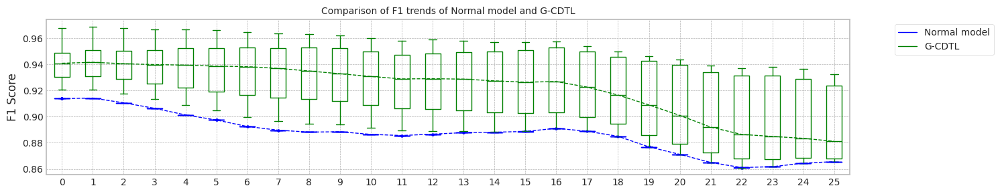

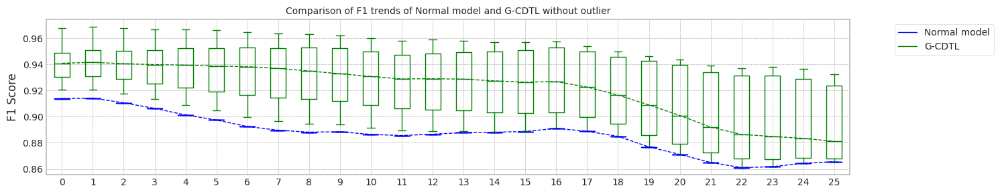

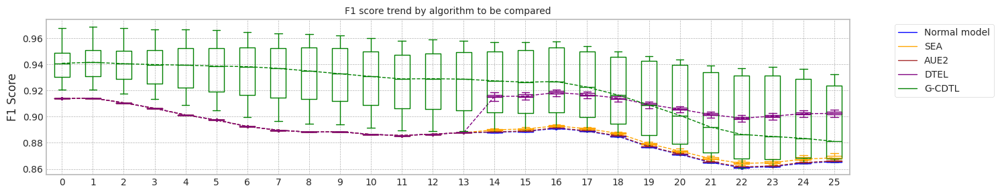

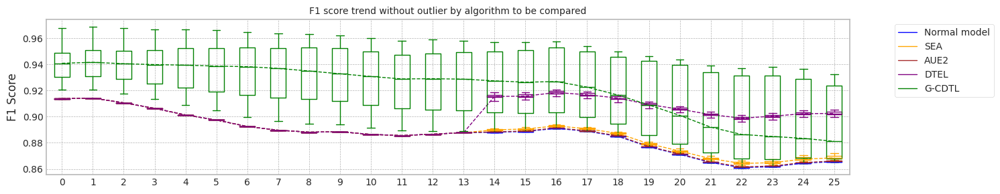

max_mean_trial= 9


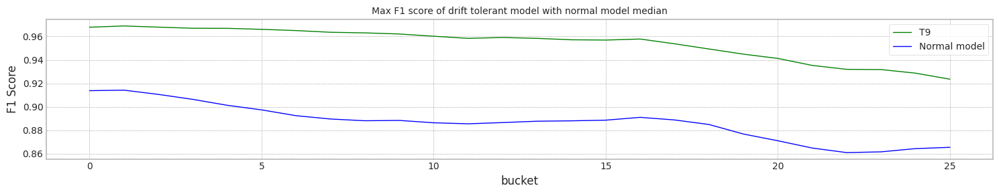

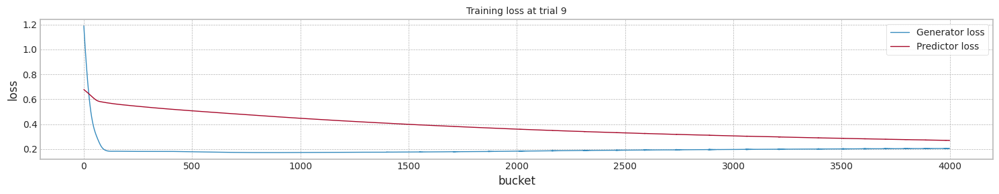

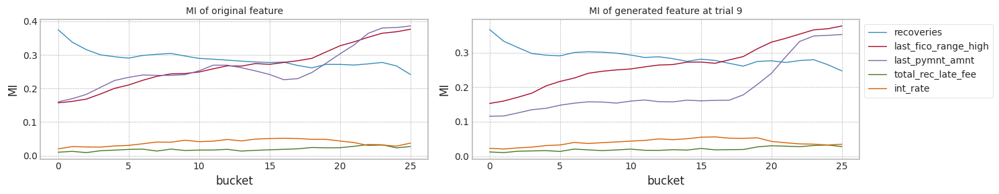

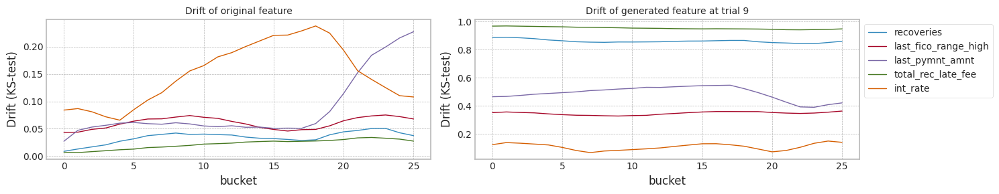

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913811,0.914253,0.886780,0.865530,12.431451
1,1.0,0.913781,0.914224,0.886806,0.865579,12.560030
2,2.0,0.913811,0.914253,0.886781,0.865538,12.312283
3,3.0,0.913781,0.914224,0.886786,0.865555,12.510426
4,4.0,0.913781,0.914224,0.886785,0.865555,12.622650
5,5.0,0.913781,0.914224,0.886786,0.865555,12.713731
6,6.0,0.913781,0.914224,0.886779,0.865530,12.951437
7,7.0,0.913781,0.914224,0.886801,0.865579,12.860854
8,8.0,0.913781,0.914224,0.886790,0.865555,12.783993
9,9.0,0.913781,0.914224,0.886775,0.865555,12.956068


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913811,0.914253,0.887780,0.868169,15.986910
1,1.0,0.913781,0.914224,0.888192,0.869374,16.261284
2,2.0,0.913811,0.914253,0.887839,0.868367,16.269277
3,3.0,0.913781,0.914224,0.888207,0.870051,16.138654
4,4.0,0.913781,0.914224,0.887668,0.867767,16.300297
5,5.0,0.913781,0.914224,0.888502,0.871194,16.146134
6,6.0,0.913781,0.914224,0.887779,0.868120,15.826242
7,7.0,0.913781,0.914224,0.888638,0.871685,15.825403
8,8.0,0.913781,0.914224,0.887639,0.867693,16.144972
9,9.0,0.913781,0.914224,0.887624,0.867626,16.357098


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913811,0.914253,0.886921,0.865908,16.119529
1,1.0,0.913781,0.914224,0.887034,0.866212,16.195912
2,2.0,0.913811,0.914253,0.886921,0.865842,16.462799
3,3.0,0.913781,0.914224,0.887003,0.866211,16.528657
4,4.0,0.913781,0.914224,0.887056,0.866309,16.086814
5,5.0,0.913781,0.914224,0.887007,0.866235,16.137364
6,6.0,0.913781,0.914224,0.886882,0.865761,15.918563
7,7.0,0.913781,0.914224,0.887053,0.866311,15.859974
8,8.0,0.913781,0.914224,0.886927,0.865933,16.324810
9,9.0,0.913781,0.914224,0.886931,0.865950,16.254127


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913811,0.914253,0.901545,0.901569,19.604799
1,1.0,0.913781,0.914224,0.901839,0.902168,19.659170
2,2.0,0.913811,0.914253,0.902062,0.902828,19.870819
3,3.0,0.913781,0.914224,0.903043,0.905330,19.874404
4,4.0,0.913781,0.914224,0.901475,0.901737,19.545136
5,5.0,0.913781,0.914224,0.902488,0.903858,19.602668
6,6.0,0.913781,0.914224,0.902749,0.904621,19.648706
7,7.0,0.913781,0.914224,0.901907,0.902433,19.466405
8,8.0,0.913781,0.914224,0.901697,0.902192,19.945555
9,9.0,0.913781,0.914224,0.902045,0.902818,19.456614


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.940631,0.940785,0.920648,0.891687,12.696167
1,1.0,0.948398,0.948976,0.909028,0.865562,12.290117
2,2.0,0.920560,0.920751,0.890364,0.865587,12.233184
3,3.0,0.930461,0.930211,0.903260,0.868247,12.434235
4,4.0,0.935375,0.936600,0.917582,0.884144,12.253472
5,5.0,0.929331,0.931317,0.940201,0.924312,12.418374
6,6.0,0.935427,0.935351,0.903201,0.868444,12.420944
7,7.0,0.946850,0.947934,0.923916,0.878089,12.495809
8,8.0,0.924582,0.924035,0.891313,0.865562,12.613283
9,9.0,0.967818,0.968876,0.954063,0.923556,12.539150


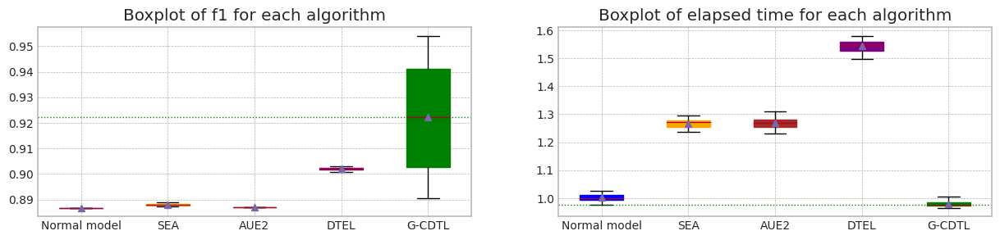

In [ ]:
_,_,_,_,_,_ = drift_tolerant2('LC_A',X1, Y1,train_size, test_size,avaible_range = 2000,lambda_f2=0.8,trial_count=20,lr_g=0.0002,weight_init= True)

### #2 날짜 단위로 bucket 만들기

#### data 정제

In [ ]:
X = {}
Y = {}

df = df_accepted[df_accepted['issue_d'].str.startswith('2007') + df_accepted['issue_d'].str.startswith('2008') + df_accepted['issue_d'].str.startswith('2009')].copy()
#df = df.drop(columns=['issue_d'])


X[2009] = df.loc[:, df.columns != 'loan_paid'].values
Y[2009] = df.loan_paid.values


for year in range(2010,2019):
    print(year)
    df = df_accepted[df_accepted['issue_d'].str.startswith(str(year))].copy()
    #df = df.drop(columns=['issue_d'])
    X[year] = df.loc[:, df.columns != 'loan_paid'].values
    Y[year] = df.loan_paid.values


2010
2011
2012
2013
2014
2015
2016
2017
2018


In [ ]:
COLUMNS = df.loc[:, df.columns != 'loan_paid'].columns
COLUMNS

Index(['loan_amnt', 'term', 'int_rate', 'annual_inc', 'issue_d', 'dti',
       'delinq_2yrs', 'fico_range_high', 'inq_last_6mths', 'open_acc',
       'pub_rec', 'revol_bal', 'revol_util', 'total_acc', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'last_pymnt_amnt',
       'last_fico_range_high', 'collections_12_mths_ex_med', 'acc_now_delinq',
       'chargeoff_within_12_mths', 'delinq_amnt', 'pub_rec_bankruptcies',
       'tax_liens', 'A2', 'A3', 'A4', 'A5', 'B1', 'B2', 'B3', 'B4', 'B5', 'C1',
       'C2', 'C3', 'C4', 'C5', 'D1', 'D2', 'D3', 'D4', 'D5', 'E1', 'E2', 'E3',
       'E4', 'E5', 'F1', 'F2', 'F3', 'F4', 'F5', 'G1', 'G2', 'G3', 'G4', 'G5',
       'Source Verified', 'Verified', 'Joint App', 'w', 'credit_card',
       'debt_consolidation', 'educational', 'home_improvement', 'house',
       'major_purchase', 'medical', 'moving', 'other', 'renewable_energy',
       'small_business', 'vacation', 'wedding', 'MORTGAGE', 'OTHER', 'OWN',
       'RENT', 'DirectPay', 'Y'],


In [ ]:
X2 = np.concatenate((X[2010],X[2011],X[2012],X[2013],X[2014],X[2015],X[2016],X[2017]))
Y2 = np.concatenate((Y[2010],Y[2011],Y[2012],Y[2013],Y[2014],Y[2015],Y[2016],Y[2017]))
X2 = pd.DataFrame(X2,columns = list(COLUMNS))#[top_columns+['issue_d']]

In [ ]:
X2

,loan_amnt,term,int_rate,annual_inc,issue_d,dti,delinq_2yrs,fico_range_high,inq_last_6mths,open_acc,...,renewable_energy,small_business,vacation,wedding,MORTGAGE,OTHER,OWN,RENT,DirectPay,Y
0,12000.0,36,13.57,42000.0,201001,21.77,0.0,684.0,2.0,10.0,...,0,0,0,0,0,0,0,1,0,0
1,7500.0,36,12.18,26000.0,201001,0.0,0.0,764.0,3.0,5.0,...,0,0,0,0,0,0,0,1,0,0
2,10000.0,36,14.61,62400.0,201001,8.46,0.0,714.0,1.0,7.0,...,0,0,0,0,1,0,0,0,0,0
3,15000.0,36,16.0,96000.0,201001,11.13,2.0,664.0,2.0,13.0,...,0,0,0,0,0,0,0,1,0,0
4,20000.0,36,11.83,105000.0,201001,13.87,0.0,759.0,0.0,9.0,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1279675,4800.0,36,9.93,90000.0,201712,20.81,0.0,704.0,0.0,11.0,...,0,0,0,0,0,0,0,1,0,0
1279676,15000.0,36,9.93,150000.0,201712,10.16,0.0,739.0,0.0,6.0,...,0,0,0,0,1,0,0,0,0,0
1279677,9600.0,36,7.97,40500.0,201712,13.75,0.0,709.0,1.0,21.0,...,0,0,0,0,0,0,0,1,0,0
1279678,32000.0,36,5.32,45000.0,201712,28.96,0.0,779.0,0.0,17.0,...,0,0,0,0,1,0,0,0,0,0


In [ ]:
from datetime import date
from datetime import datetime

def date_bucket_num(d,start_day='20100101'):
    date1 = datetime.strptime(start_day, '%Y%m%d')
    date2 = datetime.strptime(str(d)+'01', '%Y%m%d')
    delta = date2 - date1
    return int(delta.days/30)

In [ ]:
X2['b'] = [date_bucket_num(d) for d in X2['issue_d']]

In [ ]:
b_cnt = X2.groupby(['b'])['b'].count()

In [ ]:
# 1/10 로 사이즈 줄이기...
seed_everything()
s = np.sort(np.random.choice(X2.shape[0],int(X2.shape[0]/10),replace= False))
#print(s.shape)
X3 = X2.iloc[s,:]
Y3 = Y2[s]

In [ ]:
b_cnt2 = X3.groupby(['b'])['b'].count()

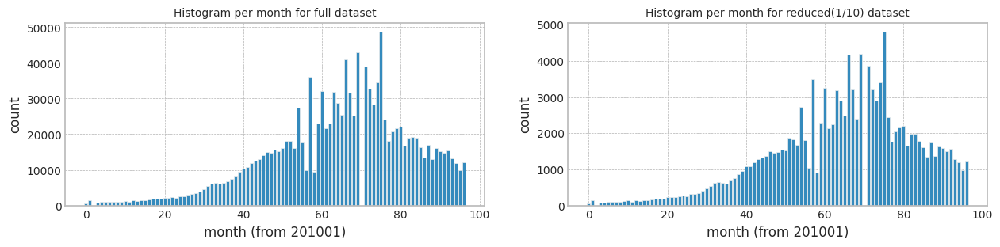

In [ ]:
fig, ax = plt.subplots(figsize=main_figsize, nrows=1, ncols=2)
ax[0].bar(b_cnt.index,b_cnt.values)
ax[0].set_ylabel('count')
ax[0].set_xlabel('month (from 201001)')
ax[0].set_title(f'Histogram per month for full dataset',fontdict={'fontsize':10})

ax[1].bar(b_cnt2.index,b_cnt2.values)
ax[1].set_ylabel('count')
ax[1].set_xlabel('month (from 201001)')
ax[1].set_title(f'Histogram per month for reduced(1/10) dataset',fontdict={'fontsize':10})

plt.show()

In [ ]:
X3.drop(columns=['issue_d'],inplace=True)

In [ ]:
X3

,loan_amnt,term,int_rate,annual_inc,dti,delinq_2yrs,fico_range_high,inq_last_6mths,open_acc,pub_rec,...,small_business,vacation,wedding,MORTGAGE,OTHER,OWN,RENT,DirectPay,Y,b
8,9000.0,36,8.94,44000.0,8.97,0.0,749.0,1.0,14.0,0.0,...,0,0,0,0,0,0,1,0,0,0
19,21125.0,36,13.92,87000.0,18.33,0.0,704.0,1.0,9.0,0.0,...,0,0,0,1,0,0,0,0,0,0
41,24250.0,36,12.53,287000.0,13.89,0.0,729.0,2.0,15.0,0.0,...,0,0,0,0,0,0,1,0,0,0
43,5000.0,36,13.92,38000.0,5.68,0.0,689.0,1.0,5.0,0.0,...,0,0,0,0,0,0,1,0,0,0
52,13000.0,36,8.59,100000.0,18.35,0.0,784.0,2.0,18.0,0.0,...,0,0,0,1,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1279596,8000.0,36,7.35,27000.0,22.36,0.0,719.0,0.0,14.0,0.0,...,0,0,0,0,0,0,1,0,0,96
1279609,29375.0,60,30.75,90000.0,44.94,0.0,689.0,1.0,20.0,0.0,...,0,0,0,0,0,0,1,0,0,96
1279627,2500.0,36,10.42,48000.0,25.23,0.0,794.0,1.0,9.0,0.0,...,0,0,0,0,0,0,1,0,0,96
1279639,18500.0,36,13.59,45000.0,35.71,1.0,709.0,0.0,14.0,0.0,...,0,0,0,1,0,0,0,0,0,96


#### Drift tolerant 학습

train_size 19361
Dataset has buckets!
MI Analysis MI Max 0.27250, Min 0.00322, Mean 0.07070, Std 0.10188
Dataset structure X_train, (19361, 5) X_test, (19361, 5) X_live (123968, 5)
bucket range in live set 26~96
Truncate 0 rows from live_set (123968, 5)
Search MI & Drift...for X_live_set (70,)


100%|██████████| 70/70 [00:03<00:00, 20.61it/s]


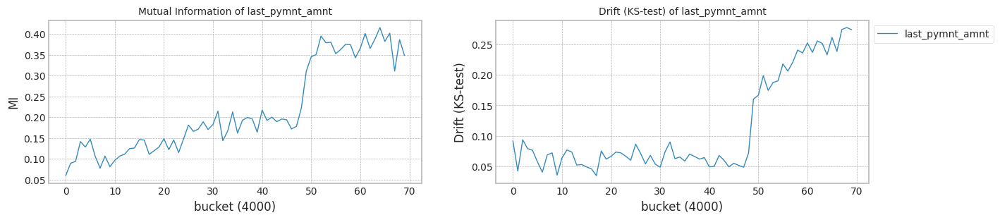

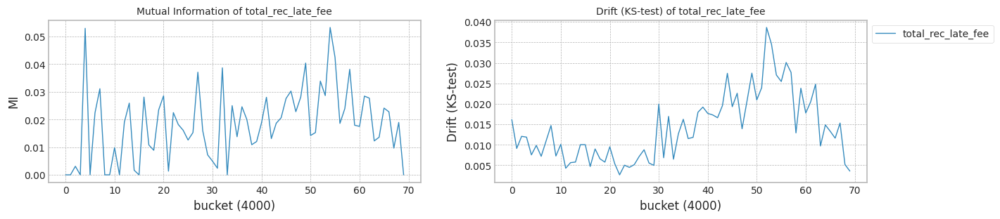

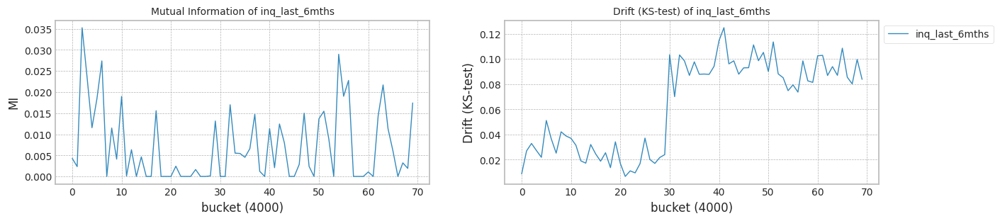

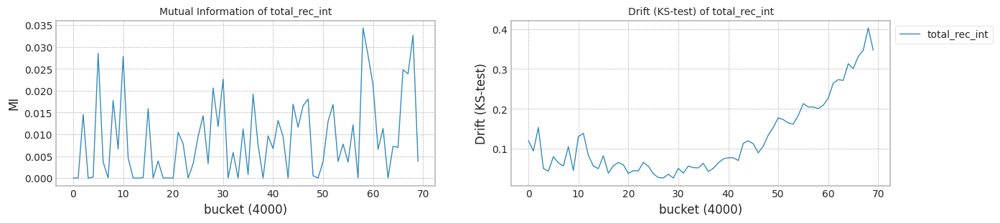

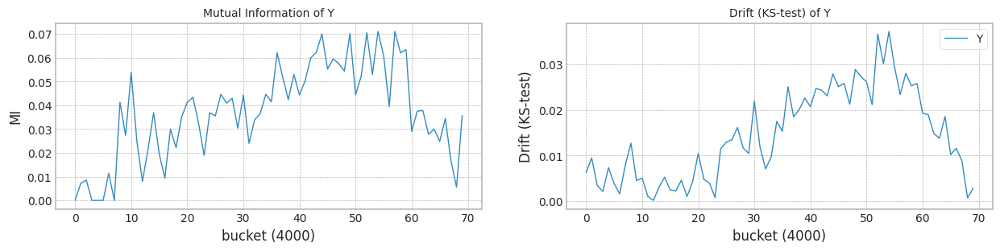

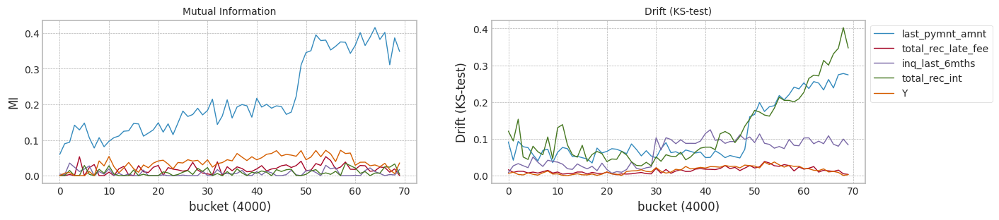

In [ ]:
top_columns = list(mi_scores[0:5].index)
top_columns = ['last_pymnt_amnt', 'total_rec_late_fee', 'inq_last_6mths', 'total_rec_int', 'Y']

train_size = X3[X3['b'] < 46].shape[0] # 2010년 1월에서 39개월 (약 3년6개월간의 data)
print('train_size',train_size)
test_size = 4000

X1,Y1 = check_mi_drift(X3[top_columns+['b']], Y3, train_size, test_size)

trial_count: 2
Lambda :  0.9
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-11-26 05:19:11,361] [INFO] [profiler.py:80:start_profile] Flops profiler started


 15%|█▌        | 309/2000 [00:01<00:05, 303.45it/s]

Early stop: 309
[2023-11-26 05:19:12,387] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2610830850
precision_recall_fscore: (array([0.77118644, 0.85300153]), array([0.08901206, 0.99502884]), array([0.15960246, 0.91855755]), array([ 3067, 16294]))
Test f1 score: 0.9185575479448175
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (27, 19361, 6)


100%|██████████| 27/27 [00:12<00:00,  2.18it/s]

mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9010941580623708
inference_flops: 227394945
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19361, 6])
[2023-11-26 05:19:24,824] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 05:19:24,826] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:19<00:00, 104.23it/s]

[2023-11-26 05:19:44,022] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 05:19:44,024] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 67763500000 16844070000 84607570000
precision_recall_fscore: (array([0.73263889, 0.85919617]), array([0.13759374, 0.99054867]), array([0.23167719, 0.92020867]), array([ 3067, 16294]))
Test f1 score: 0.9202086718549559
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (27, 19361, 6)


100%|██████████| 27/27 [00:12<00:00,  2.23it/s]

mean of drift:
last_pymnt_amnt       0.356995
total_rec_late_fee    0.949993
inq_last_6mths        0.577520
total_rec_int         0.197432
Y                     0.947420
dtype: float64
Mean F1 for all data: 0.9041493459467652
inference_flops: 1142202195
Normal model median        : 0.9010941580623708
Drift tolerant model median: 0.9041493459467652
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-11-26 05:19:56,212] [INFO] [profiler.py:80:start_profile] Flops profiler started



 17%|█▋        | 348/2000 [00:01<00:04, 338.49it/s]

Early stop: 348
[2023-11-26 05:19:57,247] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2939290215
precision_recall_fscore: (array([0.70146138, 0.8553649 ]), array([0.10955331, 0.99122376]), array([0.18950931, 0.91829657]), array([ 3067, 16294]))
Test f1 score: 0.9182965658403458
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (27, 19361, 6)


100%|██████████| 27/27 [00:12<00:00,  2.23it/s]

mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9014380423933416
inference_flops: 227394945
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19361, 6])
[2023-11-26 05:20:09,386] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 05:20:09,389] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:19<00:00, 101.41it/s]

[2023-11-26 05:20:29,119] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 05:20:29,121] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 67763500000 16844070000 84607570000
precision_recall_fscore: (array([0.7295082 , 0.86016746]), array([0.14509292, 0.98987357]), array([0.24204515, 0.92047368]), array([ 3067, 16294]))
Test f1 score: 0.9204736767013839
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (27, 19361, 6)


100%|██████████| 27/27 [00:11<00:00,  2.27it/s]


mean of drift:
last_pymnt_amnt       0.616151
total_rec_late_fee    0.953800
inq_last_6mths        0.577520
total_rec_int         0.261953
Y                     0.961783
dtype: float64
Mean F1 for all data: 0.9047541291242297
inference_flops: 1142202195
Normal model median        : 0.9012661002278561
Drift tolerant model median: 0.9044517375354975
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 7
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 22%|██▏       | 6/27 [00:02<00:09,  2.20it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-26 05:20:44,266] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 05:20:44,270] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 05:20:58,441] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 05:20:58,442] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 7/27 [00:17<01:41,  5.10s/it]

G-CDTL train flops: 10983000000 2730060000 13713060000


 48%|████▊     | 13/27 [00:20<00:13,  1.05it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-26 05:21:01,544] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 05:21:01,547] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 05:21:11,142] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 05:21:11,143] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 14/27 [00:30<00:48,  3.70s/it]

G-CDTL train flops: 7504000000 1865280000 9369280000


 74%|███████▍  | 20/27 [00:32<00:05,  1.19it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-26 05:21:14,354] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 05:21:14,357] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 05:21:32,475] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 05:21:32,476] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 21/27 [00:51<00:37,  6.17s/it]

G-CDTL train flops: 14000000000 3480000000 17480000000


100%|██████████| 27/27 [00:54<00:00,  2.00s/it]


Early stop at  [1568, 1071, 1999]
Train flops  [13713060000, 9369280000, 17480000000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9232515768455216
G_CDTL+AUE median: 0.9232515768455216
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 26%|██▌       | 7/27 [00:04<00:15,  1.29it/s]

Ensemble_SEA train flops: 756900000


 52%|█████▏    | 14/27 [00:12<00:25,  1.96s/it]

Ensemble_SEA train flops: 737760000


 78%|███████▊  | 21/27 [00:16<00:05,  1.19it/s]

Ensemble_SEA train flops: 649020000


100%|██████████| 27/27 [00:19<00:00,  1.41it/s]


Early stop at  [434, 423, 372]
Train flops  [756900000, 737760000, 649020000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9025847429195847
SEA median: 0.9025847429195847
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 26%|██▌       | 7/27 [00:04<00:14,  1.36it/s]

Ensemble_SEA train flops: 708180000


 52%|█████▏    | 14/27 [00:07<00:09,  1.44it/s]

Ensemble_SEA train flops: 617700000


 78%|███████▊  | 21/27 [00:12<00:05,  1.07it/s]

Ensemble_SEA train flops: 1162320000


100%|██████████| 27/27 [00:15<00:00,  1.76it/s]


Early stop at  [406, 354, 667]
Train flops  [708180000, 617700000, 1162320000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9053137739638236
AUE median: 0.9053137739638236
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 26%|██▌       | 7/27 [00:03<00:14,  1.37it/s]

Ensemble_DTEL train flops: 666420000
Ensemble_DTEL train flops: 6960000


 52%|█████▏    | 14/27 [00:09<00:17,  1.31s/it]

Ensemble_DTEL train flops: 2115840000
Ensemble_DTEL train flops: 5220000


 78%|███████▊  | 21/27 [00:14<00:04,  1.25it/s]

Ensemble_DTEL train flops: 659460000
Ensemble_DTEL train flops: 10440000


100%|██████████| 27/27 [00:16<00:00,  1.61it/s]


Early stop at  [382, 3, 1215, 2, 378, 5]
Train flops  [666420000, 6960000, 2115840000, 5220000, 659460000, 10440000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9088818521409854
DTEL median: 0.9088818521409854
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 7
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 22%|██▏       | 6/27 [00:02<00:09,  2.24it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-26 05:22:29,738] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 05:22:29,740] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 05:22:47,924] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 05:22:47,925] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 7/27 [00:21<02:07,  6.40s/it]

G-CDTL train flops: 14000000000 3480000000 17480000000


 48%|████▊     | 13/27 [00:24<00:15,  1.10s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-26 05:22:51,121] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 05:22:51,123] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 05:23:09,441] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 05:23:09,442] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 14/27 [00:42<01:23,  6.44s/it]

G-CDTL train flops: 14000000000 3480000000 17480000000


 74%|███████▍  | 20/27 [00:45<00:08,  1.15s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-26 05:23:12,589] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-26 05:23:12,592] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-26 05:23:30,864] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-26 05:23:30,865] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 21/27 [01:04<00:38,  6.43s/it]

G-CDTL train flops: 14000000000 3480000000 17480000000


100%|██████████| 27/27 [01:07<00:00,  2.48s/it]


Early stop at  [1999, 1999, 1999]
Train flops  [17480000000, 17480000000, 17480000000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9220071105673797
G_CDTL+AUE median: 0.9226293437064507
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 26%|██▌       | 7/27 [00:04<00:18,  1.08it/s]

Ensemble_SEA train flops: 1150140000


 52%|█████▏    | 14/27 [00:09<00:13,  1.02s/it]

Ensemble_SEA train flops: 1345020000


 78%|███████▊  | 21/27 [00:13<00:04,  1.36it/s]

Ensemble_SEA train flops: 544620000


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  [660, 772, 312]
Train flops  [1150140000, 1345020000, 544620000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9023321681251119
SEA median: 0.9024584555223483
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 26%|██▌       | 7/27 [00:04<00:18,  1.09it/s]

Ensemble_SEA train flops: 1094460000


 52%|█████▏    | 14/27 [00:08<00:09,  1.41it/s]

Ensemble_SEA train flops: 584640000


 78%|███████▊  | 21/27 [00:12<00:04,  1.28it/s]

Ensemble_SEA train flops: 772560000


100%|██████████| 27/27 [00:15<00:00,  1.76it/s]


Early stop at  [628, 335, 443]
Train flops  [1094460000, 584640000, 772560000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9050634143425738
AUE median: 0.9051885941531987
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 26%|██▌       | 7/27 [00:04<00:16,  1.18it/s]

Ensemble_DTEL train flops: 969180000
Ensemble_DTEL train flops: 5220000


 52%|█████▏    | 14/27 [00:08<00:10,  1.24it/s]

Ensemble_DTEL train flops: 826500000
Ensemble_DTEL train flops: 5220000


 78%|███████▊  | 21/27 [00:18<00:14,  2.42s/it]

Ensemble_DTEL train flops: 1494660000
Ensemble_DTEL train flops: 10440000


100%|██████████| 27/27 [00:20<00:00,  1.29it/s]


Early stop at  [556, 2, 474, 2, 858, 5]
Train flops  [969180000, 5220000, 826500000, 5220000, 1494660000, 10440000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9098993499614605
DTEL median: 0.9093906010512229


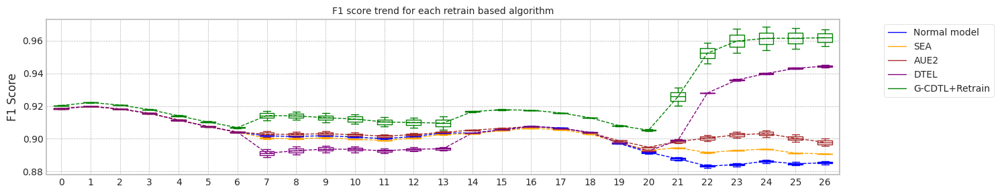

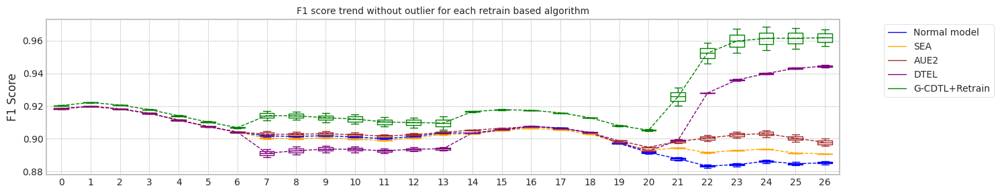

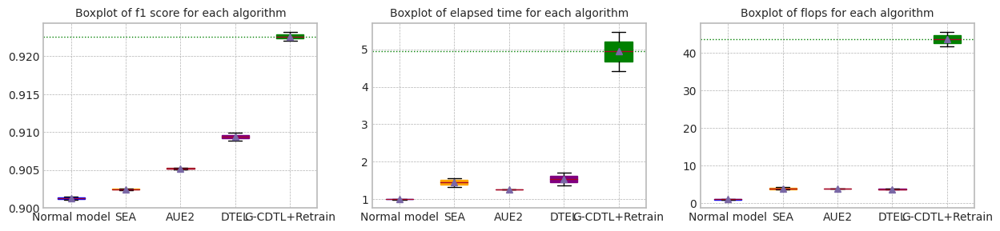

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918558,0.919906,0.901094,0.884462,12.410951,2.610831e+09,227394945.0,2.838226e+09
1,1.0,0.918297,0.919734,0.901438,0.886180,12.114796,2.939290e+09,227394945.0,3.166685e+09
2,median,0.918427,0.919820,0.901266,0.885321,12.262873,2.775061e+09,227394945.0,3.002455e+09
3,std,0.000185,0.000122,0.000243,0.001215,0.209413,2.322558e+08,0.0,2.322558e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920209,0.922041,0.904149,0.892509,12.161269,8.460757e+10,1.142202e+09,8.574977e+10
1,1.0,0.920474,0.922264,0.904754,0.893243,11.911936,8.460757e+10,1.142202e+09,8.574977e+10
2,median,0.920341,0.922152,0.904452,0.892876,12.036602,8.460757e+10,1.142202e+09,8.574977e+10
3,std,0.000187,0.000158,0.000428,0.000519,0.176305,0.000000e+00,0.000000e+00,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918558,0.919906,0.902585,0.890927,19.158440,5.082970e+09,5.546182e+09,1.062915e+10
1,1.0,0.918297,0.919734,0.902332,0.890732,16.298090,5.979070e+09,6.770742e+09,1.274981e+10
2,median,0.918427,0.919820,0.902458,0.890829,17.728265,5.531020e+09,6.158462e+09,1.168948e+10
3,std,0.000185,0.000122,0.000179,0.000138,2.022573,6.336384e+08,8.658942e+08,1.499533e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918558,0.919906,0.905314,0.900078,15.386397,5.427490e+09,6.118097e+09,1.154559e+10
1,1.0,0.918297,0.919734,0.905063,0.895574,15.409422,5.390950e+09,6.410016e+09,1.180097e+10
2,median,0.918427,0.919820,0.905189,0.897826,15.397910,5.409220e+09,6.264057e+09,1.167328e+10
3,std,0.000185,0.000122,0.000177,0.003185,0.016281,2.583768e+07,2.064182e+08,1.805805e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918558,0.919906,0.908882,0.943637,16.811747,6.403630e+09,4.210913e+09,1.061454e+10
1,1.0,0.918297,0.919734,0.909899,0.945072,20.905958,6.250510e+09,5.372832e+09,1.162334e+10
2,median,0.918427,0.919820,0.909391,0.944355,18.858853,6.327070e+09,4.791872e+09,1.111894e+10
3,std,0.000185,0.000122,0.000719,0.001014,2.895045,1.082722e+08,8.216011e+08,7.133289e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920209,0.922041,0.923252,0.966862,54.161551,1.251699e+11,115585170.0,1.252855e+11
1,1.0,0.920474,0.922264,0.922007,0.956504,67.080838,1.370476e+11,115585170.0,1.371632e+11
2,median,0.920341,0.922152,0.922629,0.961683,60.621194,1.311087e+11,115585170.0,1.312243e+11
3,std,0.000187,0.000158,0.000880,0.007324,9.135316,8.398774e+09,0.0,8.398774e+09


In [ ]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'LC_B',X1, Y1,train_size, test_size,avaible_range = 2000,
                                                            lambda_f2=0.9,trial_count=2,lr_g=0.004,
                                                            retrain_count=3,weight_init=True)

trial_count: 20
lambda_f2 0.8
######################### Trial 0 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 774.61it/s]


precision_recall_fscore: (array([0.        , 0.84158876]), array([0., 1.]), array([0.        , 0.91398121]), array([ 3067, 16294]))
Test f1 score: 0.913981208806619
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.21it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863458257161829
######################### Trial 0 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 240.37it/s]


precision_recall_fscore: (array([1.        , 0.88945903]), array([0.33974568, 1.        ]), array([0.50717936, 0.94149597]), array([ 3067, 16294]))
Test f1 score: 0.9414959697223586
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.20it/s]


mean of drift:
recoveries              0.853313
last_fico_range_high    0.356255
last_pymnt_amnt         0.492372
total_rec_late_fee      0.923060
int_rate                0.127467
dtype: float64
Mean F1 for all data: 0.9281967667585215
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9281967667585215
######################### Trial 1 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 798.01it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.17it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863578217676831
######################### Trial 1 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 243.20it/s]


precision_recall_fscore: (array([1.        , 0.90051951]), array([0.41310727, 1.        ]), array([0.58467928, 0.94765616]), array([ 3067, 16294]))
Test f1 score: 0.9476561591252762
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.19it/s]


mean of drift:
recoveries              0.857225
last_fico_range_high    0.414801
last_pymnt_amnt         0.310714
total_rec_late_fee      0.924621
int_rate                0.123337
dtype: float64
Mean F1 for all data: 0.9338725399638771
Normal model median        : 0.886351823741933
Drift tolerant model median: 0.9310346533611993
######################### Trial 2 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 798.10it/s]


precision_recall_fscore: (array([0.        , 0.84158876]), array([0., 1.]), array([0.        , 0.91398121]), array([ 3067, 16294]))
Test f1 score: 0.913981208806619
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.17it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863401150175781
######################### Trial 2 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 241.09it/s]


precision_recall_fscore: (array([1.        , 0.85313367]), array([0.0854255, 1.       ]), array([0.15740463, 0.92074704]), array([ 3067, 16294]))
Test f1 score: 0.9207470403752154
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.22it/s]


mean of drift:
recoveries              0.853983
last_fico_range_high    0.212611
last_pymnt_amnt         0.489395
total_rec_late_fee      0.940497
int_rate                0.416584
dtype: float64
Mean F1 for all data: 0.8974220349316648
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9281967667585215
######################### Trial 3 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 793.93it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.13it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863464726130549
######################### Trial 3 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.10it/s]


precision_recall_fscore: (array([1.        , 0.87040598]), array([0.20899902, 1.        ]), array([0.34573894, 0.93071343]), array([ 3067, 16294]))
Test f1 score: 0.9307134289141487
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.21it/s]


mean of drift:
recoveries              0.853531
last_fico_range_high    0.336191
last_pymnt_amnt         0.492458
total_rec_late_fee      0.946230
int_rate                0.194465
dtype: float64
Mean F1 for all data: 0.9134861554900527
Normal model median        : 0.886346149164619
Drift tolerant model median: 0.9208414611242871
######################### Trial 4 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 815.97it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.17it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863427159629517
######################### Trial 4 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.45it/s]


precision_recall_fscore: (array([1.        , 0.87899876]), array([0.26866645, 1.        ]), array([0.42354151, 0.93560334]), array([ 3067, 16294]))
Test f1 score: 0.9356033418506503
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.19it/s]


mean of drift:
recoveries              0.861499
last_fico_range_high    0.349661
last_pymnt_amnt         0.476521
total_rec_late_fee      0.935028
int_rate                0.183630
dtype: float64
Mean F1 for all data: 0.928461248906517
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9281967667585215
######################### Trial 5 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 801.30it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.17it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863464726130549
######################### Trial 5 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 241.18it/s]


precision_recall_fscore: (array([1.       , 0.8673942]), array([0.18780567, 1.        ]), array([0.31622289, 0.92898885]), array([ 3067, 16294]))
Test f1 score: 0.9289888537301519
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.23it/s]


mean of drift:
recoveries              0.858434
last_fico_range_high    0.248101
last_pymnt_amnt         0.331803
total_rec_late_fee      0.936707
int_rate                0.297781
dtype: float64
Mean F1 for all data: 0.9241493170128591
Normal model median        : 0.886346149164619
Drift tolerant model median: 0.9261730418856903
######################### Trial 6 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 806.86it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.21it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863379927039984
######################### Trial 6 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 244.34it/s]


precision_recall_fscore: (array([1.        , 0.88061395]), array([0.2797522, 1.       ]), array([0.43719745, 0.93651752]), array([ 3067, 16294]))
Test f1 score: 0.9365175158778055
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:11<00:00,  2.26it/s]


mean of drift:
recoveries              0.855180
last_fico_range_high    0.399319
last_pymnt_amnt         0.488558
total_rec_late_fee      0.953817
int_rate                0.154859
dtype: float64
Mean F1 for all data: 0.9193328890787023
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9241493170128591
######################### Trial 7 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 801.99it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.14it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.886367278510997
######################### Trial 7 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 241.96it/s]


precision_recall_fscore: (array([1.      , 0.895078]), array([0.3772416, 1.       ]), array([0.54782197, 0.94463447]), array([ 3067, 16294]))
Test f1 score: 0.944634471563569
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.23it/s]


mean of drift:
recoveries              0.857155
last_fico_range_high    0.414418
last_pymnt_amnt         0.465981
total_rec_late_fee      0.924788
int_rate                0.147699
dtype: float64
Mean F1 for all data: 0.9380314918041862
Normal model median        : 0.886346149164619
Drift tolerant model median: 0.9261730418856903
######################### Trial 8 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 807.19it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.21it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863451492716822
######################### Trial 8 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 242.27it/s]


precision_recall_fscore: (array([1.        , 0.86120507]), array([0.14378872, 1.        ]), array([0.25142531, 0.92542739]), array([ 3067, 16294]))
Test f1 score: 0.9254273868347815
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.25it/s]


mean of drift:
recoveries              0.856345
last_fico_range_high    0.280111
last_pymnt_amnt         0.486474
total_rec_late_fee      0.935259
int_rate                0.207062
dtype: float64
Mean F1 for all data: 0.9036356961632586
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9241493170128591
######################### Trial 9 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 802.71it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.24it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863366899611954
######################### Trial 9 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 247.64it/s]


precision_recall_fscore: (array([1.        , 0.93729867]), array([0.64460385, 1.        ]), array([0.78390167, 0.96763466]), array([ 3067, 16294]))
Test f1 score: 0.9676346576400023
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.23it/s]


mean of drift:
recoveries              0.861872
last_fico_range_high    0.350843
last_pymnt_amnt         0.478032
total_rec_late_fee      0.953800
int_rate                0.122857
dtype: float64
Mean F1 for all data: 0.9569288176689028
Normal model median        : 0.8863454874939325
Drift tolerant model median: 0.9261730418856903
######################### Trial 10 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 789.35it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.20it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863461101438772
######################### Trial 10 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.84it/s]


precision_recall_fscore: (array([1.        , 0.86605719]), array([0.17835018, 1.        ]), array([0.30271168, 0.92822149]), array([ 3067, 16294]))
Test f1 score: 0.9282214879799476
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.18it/s]


mean of drift:
recoveries              0.855180
last_fico_range_high    0.199188
last_pymnt_amnt         0.490901
total_rec_late_fee      0.922946
int_rate                0.362470
dtype: float64
Mean F1 for all data: 0.9088735062676576
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9241493170128591
######################### Trial 11 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 766.30it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.13it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863498708141287
######################### Trial 11 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 234.78it/s]


precision_recall_fscore: (array([1.        , 0.88921633]), array([0.33811542, 1.        ]), array([0.50536062, 0.94135999]), array([ 3067, 16294]))
Test f1 score: 0.9413599861343809
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.19it/s]


mean of drift:
recoveries              0.855414
last_fico_range_high    0.374860
last_pymnt_amnt         0.475350
total_rec_late_fee      0.923089
int_rate                0.247560
dtype: float64
Mean F1 for all data: 0.9349914641993967
Normal model median        : 0.8863459679300301
Drift tolerant model median: 0.9261730418856903
######################### Trial 12 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 771.44it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.17it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863342322838098
######################### Trial 12 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.21it/s]


precision_recall_fscore: (array([1.        , 0.91999322]), array([0.537985, 1.      ]), array([0.6995972 , 0.95832966]), array([ 3067, 16294]))
Test f1 score: 0.9583296574033231
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.17it/s]


mean of drift:
recoveries              0.856743
last_fico_range_high    0.473460
last_pymnt_amnt         0.483997
total_rec_late_fee      0.953800
int_rate                0.220152
dtype: float64
Mean F1 for all data: 0.9475308512334829
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9281967667585215
######################### Trial 13 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 778.61it/s]


precision_recall_fscore: (array([0.        , 0.84158876]), array([0., 1.]), array([0.        , 0.91398121]), array([ 3067, 16294]))
Test f1 score: 0.913981208806619
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.17it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863458257161829
######################### Trial 13 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 235.65it/s]


precision_recall_fscore: (array([1.        , 0.90769316]), array([0.45973264, 1.        ]), array([0.62988608, 0.95161337]), array([ 3067, 16294]))
Test f1 score: 0.951613374215214
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.21it/s]


mean of drift:
recoveries              0.861855
last_fico_range_high    0.368348
last_pymnt_amnt         0.463392
total_rec_late_fee      0.924941
int_rate                0.119708
dtype: float64
Mean F1 for all data: 0.9467901550543234
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9283290078325193
######################### Trial 14 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 759.33it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.18it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863417493541016
######################### Trial 14 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.73it/s]


precision_recall_fscore: (array([1.        , 0.93140505]), array([0.60873818, 1.        ]), array([0.75678962, 0.96448443]), array([ 3067, 16294]))
Test f1 score: 0.9644844323428436
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.23it/s]


mean of drift:
recoveries              0.858867
last_fico_range_high    0.300960
last_pymnt_amnt         0.313869
total_rec_late_fee      0.953802
int_rate                0.236246
dtype: float64
Mean F1 for all data: 0.9526430646135106
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.928461248906517
######################### Trial 15 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 788.31it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.22it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863757760311738
######################### Trial 15 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 240.17it/s]


precision_recall_fscore: (array([1.        , 0.91145047]), array([0.48386045, 1.        ]), array([0.65216436, 0.95367417]), array([ 3067, 16294]))
Test f1 score: 0.9536741681542829
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.21it/s]


mean of drift:
recoveries              0.861828
last_fico_range_high    0.363736
last_pymnt_amnt         0.480896
total_rec_late_fee      0.923592
int_rate                0.251213
dtype: float64
Mean F1 for all data: 0.9455453568686125
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9311668944351971
######################### Trial 16 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 782.63it/s]


precision_recall_fscore: (array([0.        , 0.84158876]), array([0., 1.]), array([0.        , 0.91398121]), array([ 3067, 16294]))
Test f1 score: 0.913981208806619
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.18it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863495861363716
######################### Trial 16 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 238.49it/s]


precision_recall_fscore: (array([1.        , 0.87022004]), array([0.20769482, 1.        ]), array([0.34395248, 0.93060712]), array([ 3067, 16294]))
Test f1 score: 0.9306071163401679
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:11<00:00,  2.27it/s]


mean of drift:
recoveries              0.861809
last_fico_range_high    0.256715
last_pymnt_amnt         0.484512
total_rec_late_fee      0.953800
int_rate                0.209637
dtype: float64
Mean F1 for all data: 0.9187865588486569
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.928461248906517
######################### Trial 17 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 818.35it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.24it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863472409167413
######################### Trial 17 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 244.01it/s]


precision_recall_fscore: (array([1.        , 0.87003417]), array([0.20639061, 1.        ]), array([0.34216216, 0.93050083]), array([ 3067, 16294]))
Test f1 score: 0.9305008280509394
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.25it/s]


mean of drift:
recoveries              0.854983
last_fico_range_high    0.345136
last_pymnt_amnt         0.487305
total_rec_late_fee      0.953800
int_rate                0.166769
dtype: float64
Mean F1 for all data: 0.9115785064728756
Normal model median        : 0.8863459679300301
Drift tolerant model median: 0.9283290078325193
######################### Trial 18 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 726.82it/s]


precision_recall_fscore: (array([0.        , 0.84158876]), array([0., 1.]), array([0.        , 0.91398121]), array([ 3067, 16294]))
Test f1 score: 0.913981208806619
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.16it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863401150175781
######################### Trial 18 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.28it/s]


precision_recall_fscore: (array([0.99906015, 0.89047385]), array([0.34659276, 0.99993863]), array([0.51464536, 0.94203695]), array([ 3067, 16294]))
Test f1 score: 0.9420369460264231
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.23it/s]


mean of drift:
recoveries              0.855879
last_fico_range_high    0.355857
last_pymnt_amnt         0.471054
total_rec_late_fee      0.953802
int_rate                0.137466
dtype: float64
Mean F1 for all data: 0.934165828504094
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.928461248906517
######################### Trial 19 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 786.60it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.21it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863379927039984
######################### Trial 19 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 243.06it/s]


precision_recall_fscore: (array([1.        , 0.89982328]), array([0.40854255, 1.        ]), array([0.58009259, 0.94727051]), array([ 3067, 16294]))
Test f1 score: 0.9472705075286321
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.22it/s]


mean of drift:
recoveries              0.856776
last_fico_range_high    0.402388
last_pymnt_amnt         0.483896
total_rec_late_fee      0.953800
int_rate                0.149843
dtype: float64
Mean F1 for all data: 0.9409450942512926
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9311668944351971
######################### Trial 0 for Normal model ###########################
retrain_interval: 14
######################### Trial 0 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8872067431560512
SEA median: 0.8872067431560512
######################### Trial 0 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.67it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8864938893954694
AUE median: 0.8864938893954694
######################### Trial 0 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9004244143872702
DTEL median: 0.9004244143872702
######################### Trial 1 for Normal model ###########################
retrain_interval: 14
######################### Trial 1 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.67it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.887566274283023
SEA median: 0.8873865087195372
######################### Trial 1 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:15<00:00,  1.69it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8866054872743562
AUE median: 0.8865496883349128
######################### Trial 1 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.38it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9006291467464546
DTEL median: 0.9005267805668624
######################### Trial 2 for Normal model ###########################
retrain_interval: 14
######################### Trial 2 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.68it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8872592834377194
SEA median: 0.8872592834377194
######################### Trial 2 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:15<00:00,  1.70it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8864832994576994
AUE median: 0.8864938893954694
######################### Trial 2 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.40it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9010312112682071
DTEL median: 0.9006291467464546
######################### Trial 3 for Normal model ###########################
retrain_interval: 14
######################### Trial 3 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:15<00:00,  1.69it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.887563170189329
SEA median: 0.8874112268135241
######################### Trial 3 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.68it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865797663219493
AUE median: 0.8865368278587094
######################### Trial 3 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.37it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9020523092685833
DTEL median: 0.9008301790073308
######################### Trial 4 for Normal model ###########################
retrain_interval: 14
######################### Trial 4 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8871392646005852
SEA median: 0.8872592834377194
######################### Trial 4 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8866389276476523
AUE median: 0.8865797663219493
######################### Trial 4 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9001805032270576
DTEL median: 0.9006291467464546
######################### Trial 5 for Normal model ###########################
retrain_interval: 14
######################### Trial 5 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.63it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8878665141239444
SEA median: 0.8874112268135241
######################### Trial 5 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865860875684342
AUE median: 0.8865829269451917
######################### Trial 5 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.33it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9013482677900797
DTEL median: 0.9008301790073308
######################### Trial 6 for Normal model ###########################
retrain_interval: 14
######################### Trial 6 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8872355644699482
SEA median: 0.8872592834377194
######################### Trial 6 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8864484157453479
AUE median: 0.8865797663219493
######################### Trial 6 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.36it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9017226946983696
DTEL median: 0.9010312112682071
######################### Trial 7 for Normal model ###########################
retrain_interval: 14
######################### Trial 7 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8880273718334044
SEA median: 0.8874112268135241
######################### Trial 7 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8866252389104681
AUE median: 0.8865829269451917
######################### Trial 7 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.37it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9008586416152231
DTEL median: 0.9009449264417151
######################### Trial 8 for Normal model ###########################
retrain_interval: 14
######################### Trial 8 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.67it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8871387524845692
SEA median: 0.8872592834377194
######################### Trial 8 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8864918920598387
AUE median: 0.8865797663219493
######################### Trial 8 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9006078222246747
DTEL median: 0.9008586416152231
######################### Trial 9 for Normal model ###########################
retrain_interval: 14
######################### Trial 9 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8871023377172974
SEA median: 0.8872474239538338
######################### Trial 9 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8864995051849129
AUE median: 0.8865396357534312
######################### Trial 9 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.37it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9009426877664618
DTEL median: 0.9009006646908424
######################### Trial 10 for Normal model ###########################
retrain_interval: 14
######################### Trial 10 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.68it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.887169154039046
SEA median: 0.8872355644699482
######################### Trial 10 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.68it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865230488415677
AUE median: 0.8865230488415677
######################### Trial 10 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.40it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.900952307508486
DTEL median: 0.9009426877664618
######################### Trial 11 for Normal model ###########################
retrain_interval: 14
######################### Trial 11 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.68it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8873446500561296
SEA median: 0.8872474239538338
######################### Trial 11 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:15<00:00,  1.70it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865809997131474
AUE median: 0.8865514075817585
######################### Trial 11 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.34it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.899470517834214
DTEL median: 0.9009006646908424
######################### Trial 12 for Normal model ###########################
retrain_interval: 14
######################### Trial 12 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8872716035993874
SEA median: 0.8872592834377194
######################### Trial 12 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865089288897282
AUE median: 0.8865230488415677
######################### Trial 12 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.34it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9005245622364378
DTEL median: 0.9008586416152231
######################### Trial 13 for Normal model ###########################
retrain_interval: 14
######################### Trial 13 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8879575303595
SEA median: 0.8872654435185534
######################### Trial 13 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865473043414035
AUE median: 0.8865351765914856
######################### Trial 13 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.36it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9019446671242634
DTEL median: 0.9009006646908424
######################### Trial 14 for Normal model ###########################
retrain_interval: 14
######################### Trial 14 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.67it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8873227466721522
SEA median: 0.8872716035993874
######################### Trial 14 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865873308798471
AUE median: 0.8865473043414035
######################### Trial 14 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.39it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9006906172879163
DTEL median: 0.9008586416152231
######################### Trial 15 for Normal model ###########################
retrain_interval: 14
######################### Trial 15 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.67it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8881294550119541
SEA median: 0.8872971751357698
######################### Trial 15 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8866799538928811
AUE median: 0.8865635353316764
######################### Trial 15 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.37it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.90058983003913
DTEL median: 0.9007746294515697
######################### Trial 16 for Normal model ###########################
retrain_interval: 14
######################### Trial 16 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8875442259392707
SEA median: 0.8873227466721522
######################### Trial 16 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865303844037361
AUE median: 0.8865473043414035
######################### Trial 16 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.34it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9014981978260761
DTEL median: 0.9008586416152231
######################### Trial 17 for Normal model ###########################
retrain_interval: 14
######################### Trial 17 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8876497942194399
SEA median: 0.8873336983641409
######################### Trial 17 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.63it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8866726583261945
AUE median: 0.8865635353316764
######################### Trial 17 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.32it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8994344336331029
DTEL median: 0.9007746294515697
######################### Trial 18 for Normal model ###########################
retrain_interval: 14
######################### Trial 18 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.886925311756782
SEA median: 0.8873227466721522
######################### Trial 18 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8864051821090717
AUE median: 0.8865473043414035
######################### Trial 18 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.34it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9010324016886614
DTEL median: 0.9008586416152231
######################### Trial 19 for Normal model ###########################
retrain_interval: 14
######################### Trial 19 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8877906463164313
SEA median: 0.8873336983641409
######################### Trial 19 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865722754693434
AUE median: 0.8865597899053734
######################### Trial 19 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9013758553317418
DTEL median: 0.9009006646908424


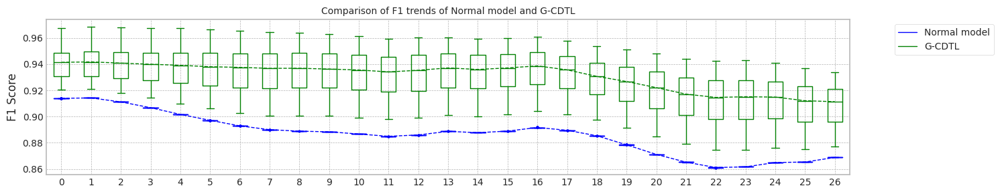

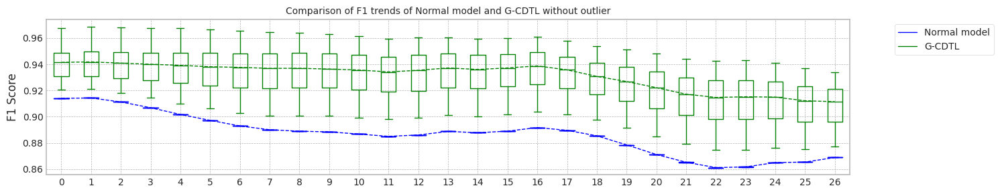

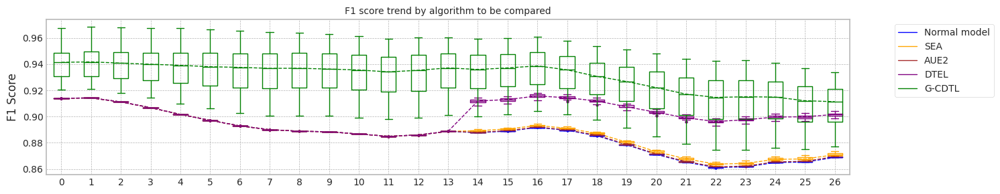

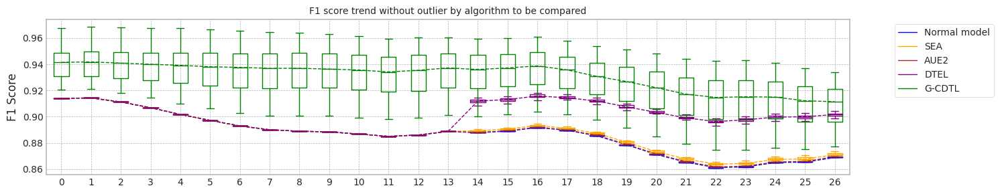

max_mean_trial= 9


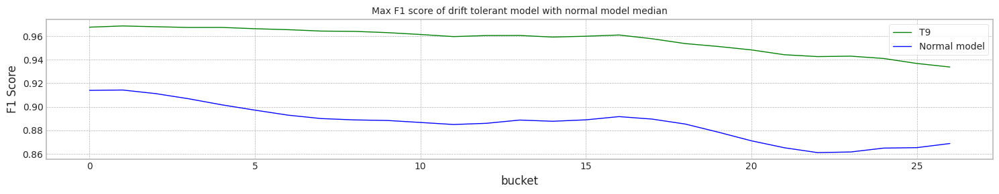

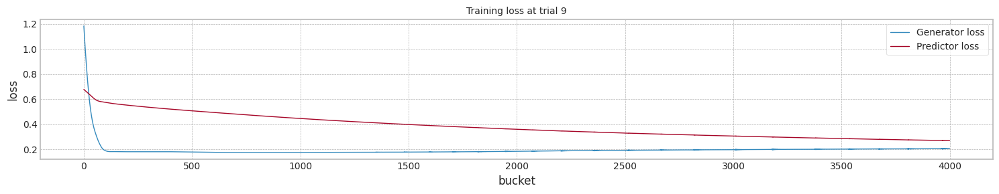

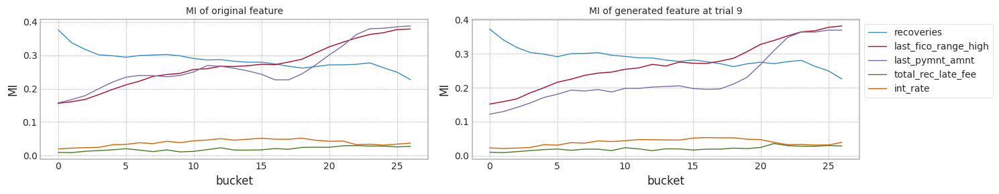

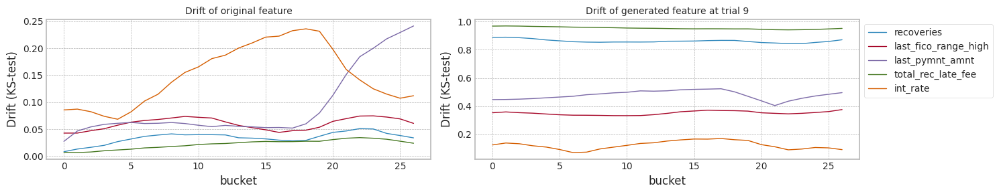

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913981,0.914286,0.886346,0.868795,12.245021
1,1.0,0.913951,0.914255,0.886358,0.868821,12.472594
2,2.0,0.913981,0.914286,0.886340,0.868803,12.471803
3,3.0,0.913951,0.914255,0.886346,0.868821,12.691585
4,4.0,0.913951,0.914255,0.886343,0.868795,12.474317
5,5.0,0.913951,0.914255,0.886346,0.868821,12.444462
6,6.0,0.913951,0.914255,0.886338,0.868795,12.264839
7,7.0,0.913951,0.914255,0.886367,0.868821,12.648617
8,8.0,0.913951,0.914255,0.886345,0.868821,12.270430
9,9.0,0.913951,0.914255,0.886337,0.868821,12.078146


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913981,0.914286,0.887207,0.870665,16.261974
1,1.0,0.913951,0.914255,0.887566,0.871442,16.184603
2,2.0,0.913981,0.914286,0.887259,0.870767,16.073094
3,3.0,0.913951,0.914255,0.887563,0.871679,16.010936
4,4.0,0.913951,0.914255,0.887139,0.870352,16.521270
5,5.0,0.913951,0.914255,0.887867,0.872985,16.642728
6,6.0,0.913951,0.914255,0.887236,0.870640,16.430265
7,7.0,0.913951,0.914255,0.888027,0.873439,16.457694
8,8.0,0.913951,0.914255,0.887139,0.870403,16.188048
9,9.0,0.913951,0.914255,0.887102,0.870334,16.451280


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913981,0.914286,0.886494,0.869186,16.250835
1,1.0,0.913951,0.914255,0.886605,0.869509,15.987074
2,2.0,0.913981,0.914286,0.886483,0.869126,15.894400
3,3.0,0.913951,0.914255,0.886580,0.869558,16.077277
4,4.0,0.913951,0.914255,0.886639,0.869659,16.505480
5,5.0,0.913951,0.914255,0.886586,0.869583,16.259275
6,6.0,0.913951,0.914255,0.886448,0.869093,16.255456
7,7.0,0.913951,0.914255,0.886625,0.869586,16.324625
8,8.0,0.913951,0.914255,0.886492,0.869220,16.479846
9,9.0,0.913951,0.914255,0.886500,0.869263,16.352654


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913981,0.914286,0.900424,0.900382,19.993799
1,1.0,0.913951,0.914255,0.900629,0.901046,19.541845
2,2.0,0.913981,0.914286,0.901031,0.901998,19.383046
3,3.0,0.913951,0.914255,0.902052,0.904042,19.791451
4,4.0,0.913951,0.914255,0.900181,0.900128,19.994394
5,5.0,0.913951,0.914255,0.901348,0.902708,20.270854
6,6.0,0.913951,0.914255,0.901723,0.903475,19.870533
7,7.0,0.913951,0.914255,0.900859,0.901716,19.709673
8,8.0,0.913951,0.914255,0.900608,0.901116,20.039375
9,9.0,0.913951,0.914255,0.900943,0.901526,19.813398


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.941496,0.941503,0.928197,0.906210,12.291449
1,1.0,0.947656,0.947907,0.933873,0.909864,12.398816
2,2.0,0.920747,0.920896,0.897422,0.877053,12.214325
3,3.0,0.930713,0.930700,0.913486,0.892771,12.245619
4,4.0,0.935603,0.936877,0.928461,0.912298,12.358444
5,5.0,0.928989,0.930063,0.924149,0.910455,12.160676
6,6.0,0.936518,0.936178,0.919333,0.896945,12.001160
7,7.0,0.944634,0.945543,0.938031,0.918071,12.162978
8,8.0,0.925427,0.924709,0.903636,0.881107,12.035777
9,9.0,0.967635,0.968660,0.956929,0.933781,12.161832


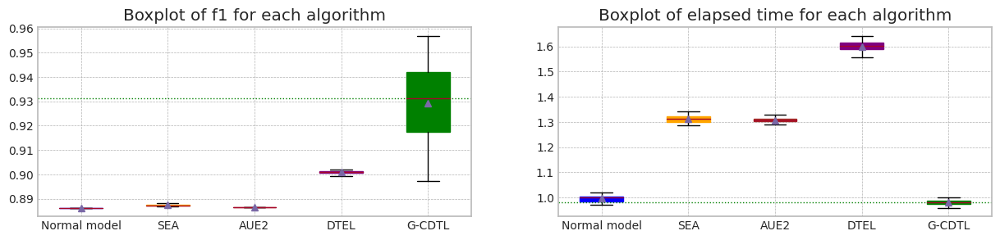

In [ ]:
_,_,_,_,_,_ = drift_tolerant2('LC_B',X1, Y1,train_size, test_size,avaible_range = 2000,lambda_f2=0.8,trial_count=20,lr_g=0.0002,weight_init=True)

## credit card transactions data 실험

### Dataset 준비

In [ ]:

df_cc = pd.read_csv("/content/drive/MyDrive/Drift/CC.csv",index_col=0)

print(df_cc.shape)

(284807, 31)


In [ ]:
df_cc.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
1,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
2,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
3,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
4,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
5,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [ ]:
seed_everything()

mi_scores = make_mi_scores(df_cc.drop(columns=['Time','Class']), df_cc['Class'], discrete_features="auto")
print(mi_scores)

V17       0.008258
V14       0.008136
V12       0.007601
V10       0.007530
V11       0.006831
V16       0.006144
V4        0.004976
V3        0.004952
V18       0.004317
V9        0.004277
V7        0.003951
V2        0.003228
V21       0.002452
V27       0.002444
V5        0.002391
V6        0.002388
V1        0.002127
V8        0.001898
V28       0.001871
V19       0.001472
Amount    0.001445
V20       0.001207
V23       0.000762
V24       0.000642
V26       0.000500
V25       0.000500
V13       0.000408
V22       0.000353
V15       0.000315
Name: MI Scores, dtype: float64


In [ ]:
# MI Top 5, columns
top_columns = list(mi_scores[0:5].index)
top_columns

['V17', 'V14', 'V12', 'V10', 'V11']

### 고정 bucket 크기

columns: ['V11', 'V16', 'V4', 'V3', 'V18']
MI Analysis MI Max 0.00683, Min 0.00432, Mean 0.00544, Std 0.00091
Dataset structure X_train, (40000, 5) X_test, (40000, 5) X_live (274807, 5)
Truncate 34807 rows from live_set (274807, 5)
Search MI & Drift...for X_live_set (24, 40000, 5)


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


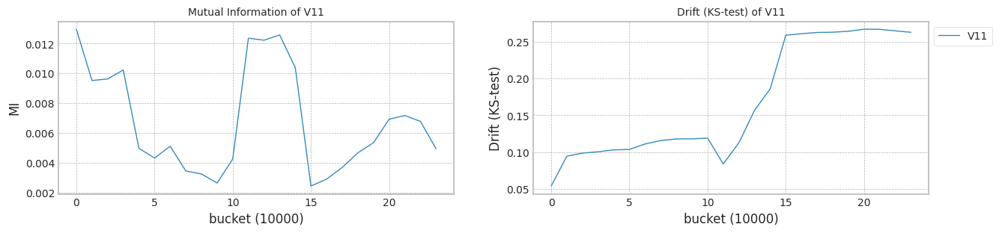

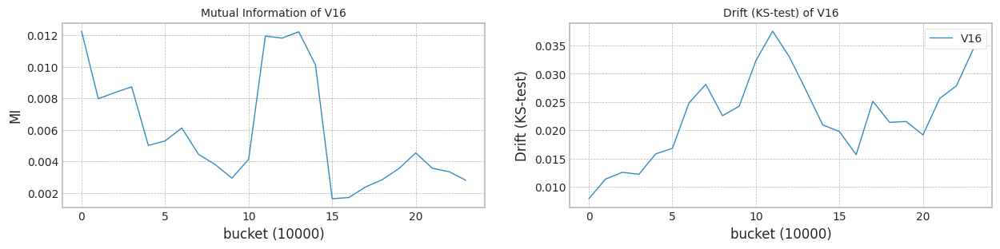

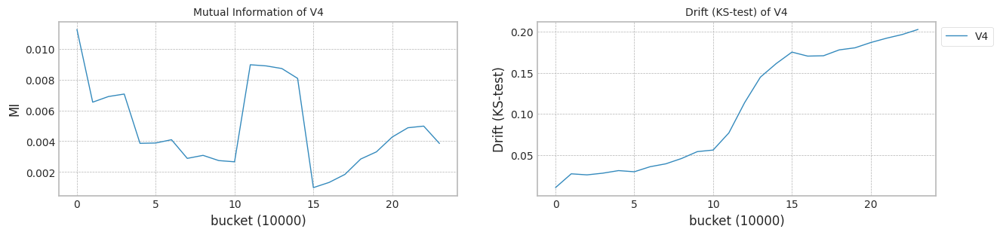

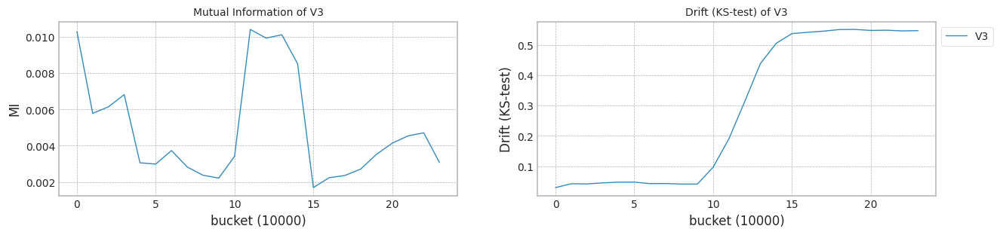

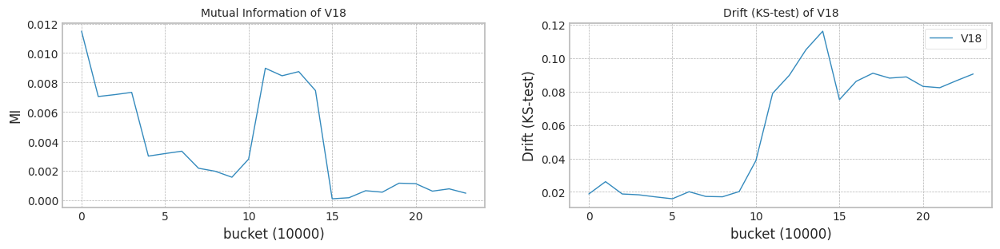

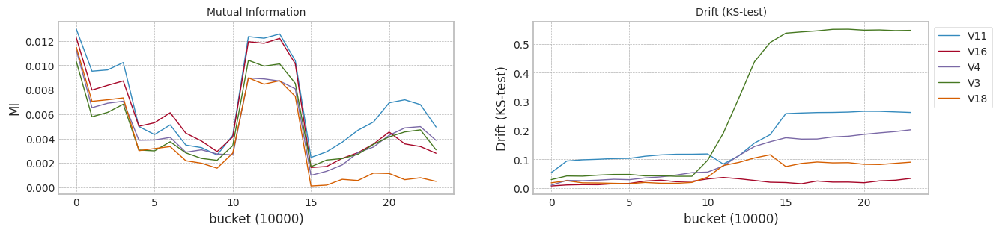

class 1 %: 0.26
(284807, 6)
(284807,)
(286783, 6)
(286783,)
class 1 %: 5.1975
trial_count: 20
lambda_f2 0.8
######################### Trial 0 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:09<00:00, 412.91it/s]


precision_recall_fscore: (array([0.99525174, 0.94555645]), array([0.99823994, 0.86520147]), array([0.9967436 , 0.90359602]), array([38635,  1365]))
Test f1 score: 0.9035960214231064
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.07it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.532758360959969
######################### Trial 0 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 209.92it/s]


precision_recall_fscore: (array([0.99679711, 0.96575875]), array([0.99886114, 0.90915751]), array([0.99782805, 0.93660377]), array([38635,  1365]))
Test f1 score: 0.9366037735849057
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.07it/s]


mean of drift:
V11    0.197428
V16    0.040625
V4     0.140023
V3     0.261000
V18    0.069360
dtype: float64
Mean F1 for all data: 0.5520900489112718
Normal model median        : 0.532758360959969
Drift tolerant model median: 0.5520900489112718
######################### Trial 1 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 563.11it/s]


precision_recall_fscore: (array([0.99780333, 0.98084291]), array([0.99935292, 0.93772894]), array([0.99857752, 0.9588015 ]), array([38635,  1365]))
Test f1 score: 0.9588014981273407
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.45198324787296024
######################### Trial 1 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 209.42it/s]


precision_recall_fscore: (array([0.99834523, 0.9826284 ]), array([0.99940468, 0.95311355]), array([0.99887468, 0.96764597]), array([38635,  1365]))
Test f1 score: 0.9676459650427668
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.194511
V16    0.043009
V4     0.135504
V3     0.263365
V18    0.066730
dtype: float64
Mean F1 for all data: 0.49313380975882753
Normal model median        : 0.49237080441646464
Drift tolerant model median: 0.5226119293350496
######################### Trial 2 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 581.67it/s]


precision_recall_fscore: (array([0.99576501, 0.94196078]), array([0.99808464, 0.87985348]), array([0.99692347, 0.90984848]), array([38635,  1365]))
Test f1 score: 0.9098484848484849
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5240713644918757
######################### Trial 2 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 212.78it/s]


precision_recall_fscore: (array([0.99520804, 0.99493671]), array([0.9998447 , 0.86373626]), array([0.99752098, 0.92470588]), array([38635,  1365]))
Test f1 score: 0.9247058823529412
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.193366
V16    0.045243
V4     0.137480
V3     0.261866
V18    0.068884
dtype: float64
Mean F1 for all data: 0.5843256398523163
Normal model median        : 0.5240713644918757
Drift tolerant model median: 0.5520900489112718
######################### Trial 3 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 572.88it/s]


precision_recall_fscore: (array([0.99772563, 0.97629969]), array([0.99919762, 0.93553114]), array([0.99846108, 0.95548073]), array([38635,  1365]))
Test f1 score: 0.955480733258511
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.4789423734830458
######################### Trial 3 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 207.71it/s]


precision_recall_fscore: (array([0.99713134, 0.96018377]), array([0.99865407, 0.91868132]), array([0.99789212, 0.93897417]), array([38635,  1365]))
Test f1 score: 0.9389741669786597
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.193399
V16    0.039601
V4     0.137697
V3     0.263059
V18    0.059841
dtype: float64
Mean F1 for all data: 0.474114145534587
Normal model median        : 0.5015068689874608
Drift tolerant model median: 0.5226119293350496
######################### Trial 4 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 573.33it/s]


precision_recall_fscore: (array([0.99579398, 0.964687  ]), array([0.99886114, 0.88058608]), array([0.9973252 , 0.92072003]), array([38635,  1365]))
Test f1 score: 0.9207200306396017
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5671577287813395
######################### Trial 4 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 211.53it/s]


precision_recall_fscore: (array([0.99837087, 0.97968397]), array([0.99930115, 0.95384615]), array([0.9988358 , 0.96659243]), array([38635,  1365]))
Test f1 score: 0.9665924276169265
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.196920
V16    0.045241
V4     0.136122
V3     0.258830
V18    0.063159
dtype: float64
Mean F1 for all data: 0.5022816982914677
Normal model median        : 0.5240713644918757
Drift tolerant model median: 0.5022816982914677
######################### Trial 5 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 586.24it/s]


precision_recall_fscore: (array([0.99510347, 0.98162072]), array([0.99943057, 0.86080586]), array([0.99726233, 0.91725215]), array([38635,  1365]))
Test f1 score: 0.9172521467603435
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:21<00:00,  1.09it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6035587959986726
######################### Trial 5 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 211.34it/s]


precision_recall_fscore: (array([0.9962784 , 0.93420046]), array([0.99777404, 0.89450549]), array([0.99702566, 0.91392216]), array([38635,  1365]))
Test f1 score: 0.9139221556886227
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.199030
V16    0.042197
V4     0.136181
V3     0.260129
V18    0.072449
dtype: float64
Mean F1 for all data: 0.4902171609333528
Normal model median        : 0.5284148627259224
Drift tolerant model median: 0.49770775402514766
######################### Trial 6 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 592.50it/s]


precision_recall_fscore: (array([0.99628128, 0.95614722]), array([0.99855054, 0.89450549]), array([0.99741462, 0.92429977]), array([38635,  1365]))
Test f1 score: 0.9242997728993188
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.09it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5308562146366033
######################### Trial 6 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 214.58it/s]


precision_recall_fscore: (array([0.99886158, 0.97851852]), array([0.99924939, 0.96776557]), array([0.99905544, 0.97311234]), array([38635,  1365]))
Test f1 score: 0.9731123388581951
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.195775
V16    0.041999
V4     0.141149
V3     0.260336
V18    0.064879
dtype: float64
Mean F1 for all data: 0.44800789326442797
Normal model median        : 0.5308562146366033
Drift tolerant model median: 0.49313380975882753
######################### Trial 7 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 592.04it/s]


precision_recall_fscore: (array([0.99633369, 0.96375099]), array([0.99880937, 0.8959707 ]), array([0.99756999, 0.92862566]), array([38635,  1365]))
Test f1 score: 0.9286256643887623
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:21<00:00,  1.09it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5180142779039042
######################### Trial 7 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 212.02it/s]


precision_recall_fscore: (array([0.99824162, 0.97665663]), array([0.99919762, 0.95018315]), array([0.99871939, 0.96323802]), array([38635,  1365]))
Test f1 score: 0.9632380245079837
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:21<00:00,  1.09it/s]


mean of drift:
V11    0.194233
V16    0.041168
V4     0.136360
V3     0.262089
V18    0.070614
dtype: float64
Mean F1 for all data: 0.5380283175695796
Normal model median        : 0.5274637895642396
Drift tolerant model median: 0.49770775402514766
######################### Trial 8 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 583.68it/s]


precision_recall_fscore: (array([0.99674486, 0.95897833]), array([0.99862819, 0.90769231]), array([0.99768563, 0.93263079]), array([38635,  1365]))
Test f1 score: 0.9326307866014301
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.09it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5024153711346581
######################### Trial 8 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 211.31it/s]


precision_recall_fscore: (array([0.9973396 , 0.98286604]), array([0.99943057, 0.92454212]), array([0.99838399, 0.95281238]), array([38635,  1365]))
Test f1 score: 0.9528123820309552
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.09it/s]


mean of drift:
V11    0.195939
V16    0.041831
V4     0.139088
V3     0.259484
V18    0.070163
dtype: float64
Mean F1 for all data: 0.5960151695253991
Normal model median        : 0.5240713644918757
Drift tolerant model median: 0.5022816982914677
######################### Trial 9 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 569.95it/s]


precision_recall_fscore: (array([0.99919776, 0.98232695]), array([0.9993788 , 0.97728938]), array([0.99928827, 0.97980169]), array([38635,  1365]))
Test f1 score: 0.9798016893132574
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.05it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.4177171429409127
######################### Trial 9 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 205.99it/s]


precision_recall_fscore: (array([0.99630787, 0.96296296]), array([0.99878349, 0.8952381 ]), array([0.99754414, 0.92786636]), array([38635,  1365]))
Test f1 score: 0.9278663629460896
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.197429
V16    0.043591
V4     0.134673
V3     0.260246
V18    0.072718
dtype: float64
Mean F1 for all data: 0.602271613502359
Normal model median        : 0.5210428211978899
Drift tolerant model median: 0.5201550079305237
######################### Trial 10 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 551.07it/s]


precision_recall_fscore: (array([0.99813925, 0.99004594]), array([0.99966352, 0.94725275]), array([0.9989008 , 0.96817671]), array([38635,  1365]))
Test f1 score: 0.9681767128416323
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:23<00:00,  1.04it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.43964944742512824
######################### Trial 10 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 204.34it/s]


precision_recall_fscore: (array([0.99653881, 0.95797665]), array([0.9986023, 0.9018315]), array([0.99756949, 0.9290566 ]), array([38635,  1365]))
Test f1 score: 0.9290566037735849
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.04it/s]


mean of drift:
V11    0.197244
V16    0.045017
V4     0.134741
V3     0.261410
V18    0.074856
dtype: float64
Mean F1 for all data: 0.45872006810033755
Normal model median        : 0.5180142779039042
Drift tolerant model median: 0.5022816982914677
######################### Trial 11 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 565.32it/s]


precision_recall_fscore: (array([0.99733926, 0.97905353]), array([0.99930115, 0.92454212]), array([0.99831924, 0.95101733]), array([38635,  1365]))
Test f1 score: 0.9510173323285607
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.04it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5352095169567376
######################### Trial 11 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 205.85it/s]


precision_recall_fscore: (array([0.99837037, 0.97091723]), array([0.99899055, 0.95384615]), array([0.99868036, 0.96230599]), array([38635,  1365]))
Test f1 score: 0.9623059866962306
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.05it/s]


mean of drift:
V11    0.195828
V16    0.038910
V4     0.135635
V3     0.261032
V18    0.061904
dtype: float64
Mean F1 for all data: 0.5038161341778603
Normal model median        : 0.5210428211978899
Drift tolerant model median: 0.5030489162346641
######################### Trial 12 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 551.78it/s]


precision_recall_fscore: (array([0.99628147, 0.95764706]), array([0.9986023 , 0.89450549]), array([0.99744054, 0.925     ]), array([38635,  1365]))
Test f1 score: 0.9249999999999999
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:23<00:00,  1.02it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5444095144942068
######################### Trial 12 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 205.69it/s]


precision_recall_fscore: (array([0.99726119, 0.97070162]), array([0.99901644, 0.92234432]), array([0.99813804, 0.94590533]), array([38635,  1365]))
Test f1 score: 0.9459053343350864
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.199619
V16    0.040914
V4     0.132203
V3     0.260784
V18    0.071576
dtype: float64
Mean F1 for all data: 0.48766114717168235
Normal model median        : 0.5240713644918757
Drift tolerant model median: 0.5022816982914677
######################### Trial 13 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 567.62it/s]


precision_recall_fscore: (array([0.99633331, 0.9607227 ]), array([0.99870584, 0.8959707 ]), array([0.99751816, 0.92721759]), array([38635,  1365]))
Test f1 score: 0.9272175890826384
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.05it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5618829105599521
######################### Trial 13 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 206.64it/s]


precision_recall_fscore: (array([0.99726034, 0.9618029 ]), array([0.99870584, 0.92234432]), array([0.99798257, 0.94166043]), array([38635,  1365]))
Test f1 score: 0.9416604338070306
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.04it/s]


mean of drift:
V11    0.195336
V16    0.044296
V4     0.135944
V3     0.260959
V18    0.075574
dtype: float64
Mean F1 for all data: 0.6033273034960055
Normal model median        : 0.5274637895642396
Drift tolerant model median: 0.5030489162346641
######################### Trial 14 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 545.45it/s]


precision_recall_fscore: (array([0.99782867, 0.97488584]), array([0.99914585, 0.93846154]), array([0.99848683, 0.95632699]), array([38635,  1365]))
Test f1 score: 0.9563269876819709
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.54024349856902
######################### Trial 14 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 206.27it/s]


precision_recall_fscore: (array([0.9957661 , 0.94940711]), array([0.99834347, 0.87985348]), array([0.99705312, 0.91330798]), array([38635,  1365]))
Test f1 score: 0.9133079847908745
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.197183
V16    0.044035
V4     0.137020
V3     0.260385
V18    0.073438
dtype: float64
Mean F1 for all data: 0.6161297272313061
Normal model median        : 0.5308562146366033
Drift tolerant model median: 0.5038161341778603
######################### Trial 15 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 554.48it/s]


precision_recall_fscore: (array([0.99674629, 0.97176471]), array([0.9990682 , 0.90769231]), array([0.99790589, 0.93863636]), array([38635,  1365]))
Test f1 score: 0.9386363636363637
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.05it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5619983865419826
######################### Trial 15 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 205.61it/s]


precision_recall_fscore: (array([0.99731322, 0.97600619]), array([0.99919762, 0.92380952]), array([0.99825453, 0.94919082]), array([38635,  1365]))
Test f1 score: 0.9491908167105758
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.05it/s]


mean of drift:
V11    0.196875
V16    0.043693
V4     0.135924
V3     0.262376
V18    0.067175
dtype: float64
Mean F1 for all data: 0.47835789292054837
Normal model median        : 0.5318072877982861
Drift tolerant model median: 0.5030489162346641
######################### Trial 16 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 562.67it/s]


precision_recall_fscore: (array([0.99684885, 0.96806854]), array([0.99893879, 0.91062271]), array([0.99789272, 0.93846735]), array([38635,  1365]))
Test f1 score: 0.9384673461683654
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.46310852049992013
######################### Trial 16 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 205.35it/s]


precision_recall_fscore: (array([0.99782918, 0.9816092 ]), array([0.9993788 , 0.93846154]), array([0.99860339, 0.95955056]), array([38635,  1365]))
Test f1 score: 0.9595505617977529
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.201782
V16    0.040190
V4     0.140521
V3     0.260480
V18    0.066190
dtype: float64
Mean F1 for all data: 0.5263367419929069
Normal model median        : 0.5308562146366033
Drift tolerant model median: 0.5038161341778603
######################### Trial 17 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 552.21it/s]


precision_recall_fscore: (array([0.99769943, 0.97108067]), array([0.99901644, 0.93479853]), array([0.9983575 , 0.95259425]), array([38635,  1365]))
Test f1 score: 0.9525942515864128
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.05it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5114789860377323
######################### Trial 17 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 204.81it/s]


precision_recall_fscore: (array([0.9973137 , 0.98132296]), array([0.9993788 , 0.92380952]), array([0.99834518, 0.95169811]), array([38635,  1365]))
Test f1 score: 0.9516981132075472
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.198973
V16    0.041964
V4     0.140053
V3     0.259972
V18    0.070621
dtype: float64
Mean F1 for all data: 0.4858455191799787
Normal model median        : 0.5274637895642396
Drift tolerant model median: 0.5030489162346641
######################### Trial 18 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 566.05it/s]


precision_recall_fscore: (array([0.99816457, 0.98253607]), array([0.99940468, 0.94798535]), array([0.99878424, 0.96495153]), array([38635,  1365]))
Test f1 score: 0.9649515287099181
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.07it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.4185946582488142
######################### Trial 18 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 208.85it/s]


precision_recall_fscore: (array([0.99829347, 0.98037736]), array([0.99932704, 0.95164835]), array([0.99880999, 0.96579926]), array([38635,  1365]))
Test f1 score: 0.9657992565055762
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.197908
V16    0.041027
V4     0.137950
V3     0.260875
V18    0.067716
dtype: float64
Mean F1 for all data: 0.5663808400159335
Normal model median        : 0.5240713644918757
Drift tolerant model median: 0.5038161341778603
######################### Trial 19 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 559.56it/s]


precision_recall_fscore: (array([0.99664369, 0.97474349]), array([0.99917174, 0.9047619 ]), array([0.99790611, 0.93844985]), array([38635,  1365]))
Test f1 score: 0.9384498480243161
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.07it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5203053893305997
######################### Trial 19 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 205.48it/s]


precision_recall_fscore: (array([0.99782918, 0.9816092 ]), array([0.9993788 , 0.93846154]), array([0.99860339, 0.95955056]), array([38635,  1365]))
Test f1 score: 0.9595505617977529
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.191964
V16    0.041752
V4     0.133827
V3     0.262796
V18    0.062902
dtype: float64
Mean F1 for all data: 0.4933691286852933
Normal model median        : 0.5221883769112377
Drift tolerant model median: 0.5030489162346641
######################### Trial 0 for Normal model ###########################
retrain_interval: 13
######################### Trial 0 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.15s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5544883322857022
SEA median: 0.5544883322857022
######################### Trial 0 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.16s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6046955946781541
AUE median: 0.6046955946781541
######################### Trial 0 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.28s/it]


Early stop at  2954.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.4968341274778754
DTEL median: 0.4968341274778754
######################### Trial 1 for Normal model ###########################
retrain_interval: 13
######################### Trial 1 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6076210367343412
SEA median: 0.5810546845100217
######################### Trial 1 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.05s/it]


Early stop at  2011.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5001779740134524
AUE median: 0.5524367843458033
######################### Trial 1 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  3491.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5447616306909707
DTEL median: 0.5207978790844231
######################### Trial 2 for Normal model ###########################
retrain_interval: 13
######################### Trial 2 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5814730801057258
SEA median: 0.5814730801057258
######################### Trial 2 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.15s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6736839953094672
AUE median: 0.6046955946781541
######################### Trial 2 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.26s/it]


Early stop at  2780.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.4592763468314402
DTEL median: 0.4968341274778754
######################### Trial 3 for Normal model ###########################
retrain_interval: 13
######################### Trial 3 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6628609731192134
SEA median: 0.5945470584200335
######################### Trial 3 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.15s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5479324236694857
AUE median: 0.5763140091738199
######################### Trial 3 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:28<00:00,  1.19s/it]


Early stop at  2061.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.572594342187803
DTEL median: 0.5207978790844231
######################### Trial 4 for Normal model ###########################
retrain_interval: 13
######################### Trial 4 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:23<00:00,  1.02it/s]


Early stop at  1587.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6297119714706197
SEA median: 0.6076210367343412
######################### Trial 4 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.7145379570554692
AUE median: 0.6046955946781541
######################### Trial 4 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.26s/it]


Early stop at  3234.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5754809626378885
DTEL median: 0.5447616306909707
######################### Trial 5 for Normal model ###########################
retrain_interval: 13
######################### Trial 5 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.09s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.703875232195467
SEA median: 0.6186665041024805
######################### Trial 5 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.7286722093629608
AUE median: 0.6391897949938107
######################### Trial 5 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:29<00:00,  1.25s/it]


Early stop at  2863.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6239922664613804
DTEL median: 0.5586779864393869
######################### Trial 6 for Normal model ###########################
retrain_interval: 13
######################### Trial 6 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.09s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6134819147642012
SEA median: 0.6134819147642012
######################### Trial 6 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.06s/it]


Early stop at  2885.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6679858722668371
AUE median: 0.6679858722668371
######################### Trial 6 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:29<00:00,  1.23s/it]


Early stop at  2770.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5502400889814728
DTEL median: 0.5502400889814728
######################### Trial 7 for Normal model ###########################
retrain_interval: 13
######################### Trial 7 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.05s/it]


Early stop at  2832.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5317261654353196
SEA median: 0.6105514757492712
######################### Trial 7 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6616562713189549
AUE median: 0.664821071792896
######################### Trial 7 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.27s/it]


Early stop at  3345.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6168847045177938
DTEL median: 0.561417215584638
######################### Trial 8 for Normal model ###########################
retrain_interval: 13
######################### Trial 8 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6097143842119539
SEA median: 0.6097143842119539
######################### Trial 8 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6742232024221746
AUE median: 0.6679858722668371
######################### Trial 8 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.25s/it]


Early stop at  3234.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5811746506147512
DTEL median: 0.572594342187803
######################### Trial 9 for Normal model ###########################
retrain_interval: 13
######################### Trial 9 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5888262741582504
SEA median: 0.6086677104731475
######################### Trial 9 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6574389586755064
AUE median: 0.664821071792896
######################### Trial 9 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:31<00:00,  1.31s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6049977827162228
DTEL median: 0.5740376524128458
######################### Trial 10 for Normal model ###########################
retrain_interval: 13
######################### Trial 10 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:24<00:00,  1.01s/it]


Early stop at  1965.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5592479341466894
SEA median: 0.6076210367343412
######################### Trial 10 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6473217631517151
AUE median: 0.6616562713189549
######################### Trial 10 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:31<00:00,  1.29s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5640396727114305
DTEL median: 0.572594342187803
######################### Trial 11 for Normal model ###########################
retrain_interval: 13
######################### Trial 11 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.07s/it]


Early stop at  3393.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6471776889061
SEA median: 0.6086677104731475
######################### Trial 11 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.05s/it]


Early stop at  2553.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6878308012542593
AUE median: 0.664821071792896
######################### Trial 11 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:29<00:00,  1.22s/it]


Early stop at  2394.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6318671620593203
DTEL median: 0.5740376524128458
######################### Trial 12 for Normal model ###########################
retrain_interval: 13
######################### Trial 12 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.05s/it]


Early stop at  3036.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.48474160857472987
SEA median: 0.6076210367343412
######################### Trial 12 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6993752256981779
AUE median: 0.6679858722668371
######################### Trial 12 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:29<00:00,  1.23s/it]


Early stop at  2935.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5849874853754754
DTEL median: 0.5754809626378885
######################### Trial 13 for Normal model ###########################
retrain_interval: 13
######################### Trial 13 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.04s/it]


Early stop at  2882.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6068184238112891
SEA median: 0.6072197302728152
######################### Trial 13 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6976291897131107
AUE median: 0.6708349337881522
######################### Trial 13 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.27s/it]


Early stop at  3598.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6069379235489591
DTEL median: 0.5783278066263198
######################### Trial 14 for Normal model ###########################
retrain_interval: 13
######################### Trial 14 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.04s/it]


Early stop at  2847.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6513188704046257
SEA median: 0.6076210367343412
######################### Trial 14 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.07s/it]


Early stop at  3087.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6817691627941594
AUE median: 0.6736839953094672
######################### Trial 14 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.26s/it]


Early stop at  2898.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6182580170785441
DTEL median: 0.5811746506147512
######################### Trial 15 for Normal model ###########################
retrain_interval: 13
######################### Trial 15 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.593516264988165
SEA median: 0.6072197302728152
######################### Trial 15 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.16s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.7077875214246734
AUE median: 0.673953598865821
######################### Trial 15 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:31<00:00,  1.32s/it]


Early stop at  3526.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6430978376653995
DTEL median: 0.5830810679951133
######################### Trial 16 for Normal model ###########################
retrain_interval: 13
######################### Trial 16 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.639071912453777
SEA median: 0.6076210367343412
######################### Trial 16 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.06s/it]


Early stop at  2549.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6133225266852281
AUE median: 0.6736839953094672
######################### Trial 16 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.26s/it]


Early stop at  2765.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5376685924574329
DTEL median: 0.5811746506147512
######################### Trial 17 for Normal model ###########################
retrain_interval: 13
######################### Trial 17 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6607225812964498
SEA median: 0.6086677104731475
######################### Trial 17 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.16s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.690399587445833
AUE median: 0.673953598865821
######################### Trial 17 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:31<00:00,  1.33s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5999437028827116
DTEL median: 0.5830810679951133
######################### Trial 18 for Normal model ###########################
retrain_interval: 13
######################### Trial 18 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6276909233819631
SEA median: 0.6097143842119539
######################### Trial 18 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.14s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6644438232112444
AUE median: 0.6736839953094672
######################### Trial 18 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.28s/it]


Early stop at  3105.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.522703937739516
DTEL median: 0.5811746506147512
######################### Trial 19 for Normal model ###########################
retrain_interval: 13
######################### Trial 19 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6626154791201322
SEA median: 0.6115981494880776
######################### Trial 19 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.17s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6738022456122557
AUE median: 0.6737431204608615
######################### Trial 19 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:29<00:00,  1.25s/it]


Early stop at  2583.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.4764699703478492
DTEL median: 0.5783278066263198


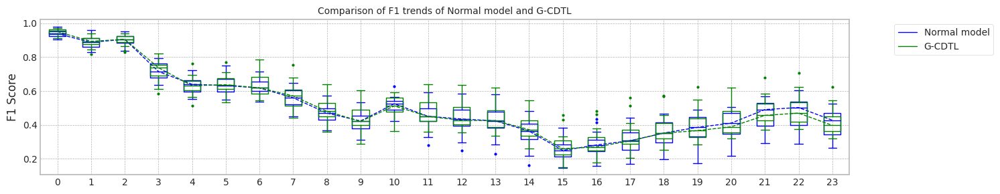

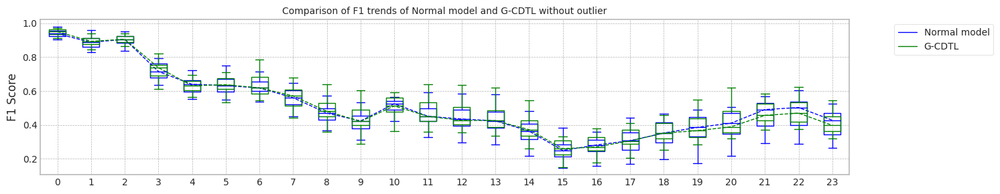

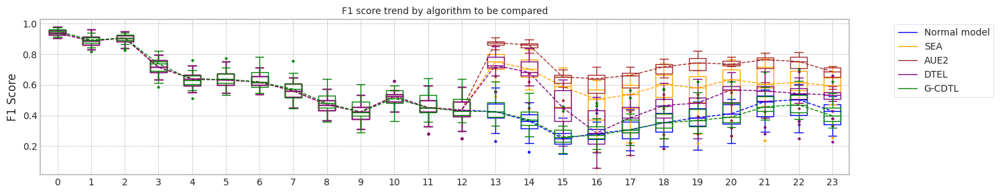

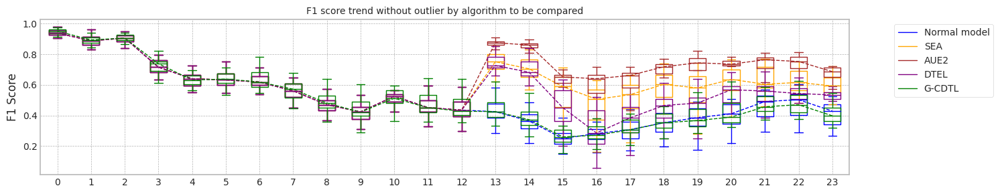

max_mean_trial= 14


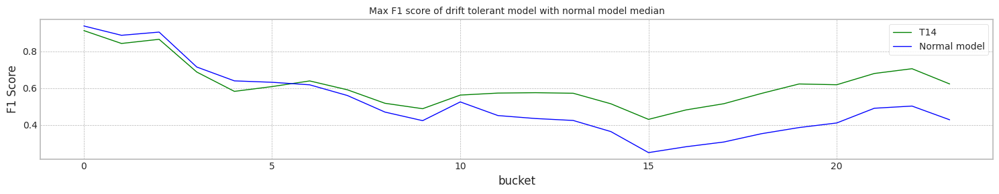

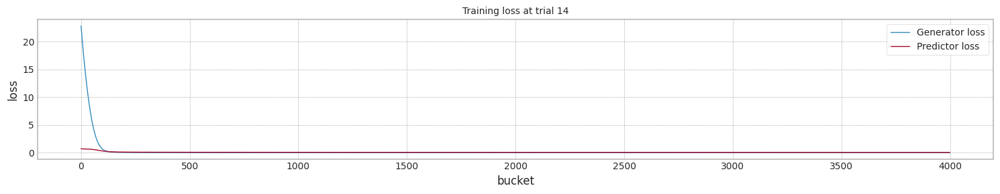

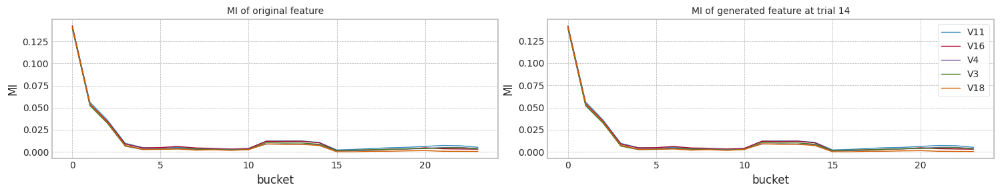

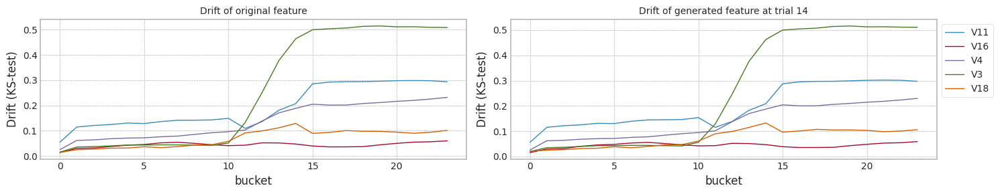

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.903596,0.833133,0.532758,0.500000,22.604949
1,1.0,0.958801,0.920333,0.451983,0.279570,22.301902
2,2.0,0.909848,0.830144,0.524071,0.516556,22.392032
3,3.0,0.955481,0.903073,0.478942,0.361446,22.393171
4,4.0,0.920720,0.866005,0.567158,0.465409,22.264989
5,5.0,0.917252,0.891358,0.603559,0.524272,22.038476
6,6.0,0.924300,0.848411,0.530856,0.493333,22.101784
7,7.0,0.928626,0.861009,0.518014,0.443114,22.067680
8,8.0,0.932631,0.870392,0.502415,0.349650,22.113849
9,9.0,0.979802,0.961098,0.417717,0.288557,22.823255


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.903596,0.833133,0.554488,0.533333,27.767516
1,1.0,0.958801,0.920333,0.607621,0.626506,27.228899
2,2.0,0.909848,0.830144,0.581473,0.589744,27.255702
3,3.0,0.955481,0.903073,0.662861,0.720930,27.066133
4,4.0,0.920720,0.866005,0.629712,0.513514,23.558422
5,5.0,0.917252,0.891358,0.703875,0.690476,26.308509
6,6.0,0.924300,0.848411,0.613482,0.571429,26.289440
7,7.0,0.928626,0.861009,0.531726,0.472222,25.187308
8,8.0,0.932631,0.870392,0.609714,0.589744,26.411865
9,9.0,0.979802,0.961098,0.588826,0.589744,26.533179


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.903596,0.833133,0.604696,0.571429,27.821007
1,1.0,0.958801,0.920333,0.500178,0.382353,25.296751
2,2.0,0.909848,0.830144,0.673684,0.712644,27.562958
3,3.0,0.955481,0.903073,0.547932,0.428571,27.656562
4,4.0,0.920720,0.866005,0.714538,0.697674,27.020303
5,5.0,0.917252,0.891358,0.728672,0.712644,26.940949
6,6.0,0.924300,0.848411,0.667986,0.720930,25.431475
7,7.0,0.928626,0.861009,0.661656,0.674699,26.897139
8,8.0,0.932631,0.870392,0.674223,0.666667,27.224512
9,9.0,0.979802,0.961098,0.657439,0.705882,27.092041


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.903596,0.833133,0.496834,0.382353,30.685280
1,1.0,0.958801,0.920333,0.544762,0.513514,31.166950
2,2.0,0.909848,0.830144,0.459276,0.225806,30.278729
3,3.0,0.955481,0.903073,0.572594,0.552632,28.498610
4,4.0,0.920720,0.866005,0.575481,0.533333,30.270837
5,5.0,0.917252,0.891358,0.623992,0.571429,29.981498
6,6.0,0.924300,0.848411,0.550240,0.533333,29.571269
7,7.0,0.928626,0.861009,0.616885,0.552632,30.517630
8,8.0,0.932631,0.870392,0.581175,0.533333,30.079707
9,9.0,0.979802,0.961098,0.604998,0.658537,31.507156


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.936604,0.892944,0.552090,0.437870,22.401973
1,1.0,0.967646,0.921429,0.493134,0.337349,22.624408
2,2.0,0.924706,0.875635,0.584326,0.543210,22.680193
3,3.0,0.938974,0.898585,0.474114,0.328358,22.617796
4,4.0,0.966592,0.912075,0.502282,0.383721,22.375201
5,5.0,0.913922,0.819362,0.490217,0.445714,21.684527
6,6.0,0.973112,0.905041,0.448008,0.320000,21.947330
7,7.0,0.963238,0.941725,0.538028,0.380368,22.034639
8,8.0,0.952812,0.902200,0.596015,0.462687,22.155315
9,9.0,0.927866,0.863861,0.602272,0.545455,22.729316


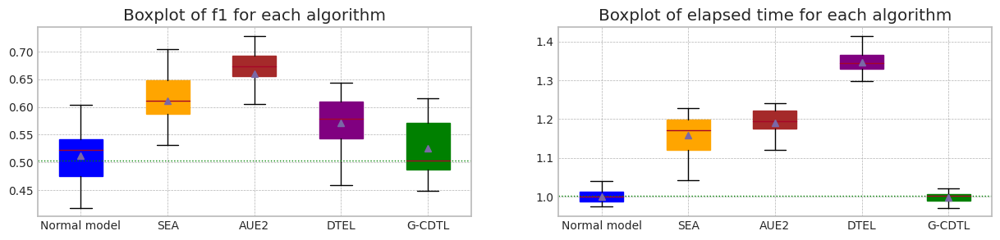

In [ ]:
seed_everything()

#s = np.sort(np.random.choice(len(COLUMNS),2,replace= False))
#top_columns = list(mi_scores[0:5].index)
top_columns = ['V11','V16','V4','V3','V18']
print('columns:',top_columns)
#print(s.shape)
X4 = df_cc[top_columns]
Y4 = df_cc['Class'].values
train_size = 40000
test_size = 10000

X1,Y1 = check_mi_drift(X4, Y4, train_size, test_size,scaling=False)

bucket_size = 5000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]

print('class 1 %:',np.sum(Y1[0:train_size])/train_size * 100)

# class 1이 너무 숫자가 적어서 (unbalanced data) X 20으로 증가 시킨다.
print(X1.shape)
print(Y1.shape)

X2 = X1[0:train_size]
Y2 = Y1[0:train_size]

for idx,(row,yv) in enumerate(zip(X1[0:train_size].values,Y1[0:train_size])):
    if yv == 1:
        #print(idx)
        for j in range(19):
            X2 = pd.concat([X2[0:idx],pd.DataFrame([row],columns=X2.columns), X2[idx:]])
            Y2 = np.insert(Y2,idx,yv)
X1 = pd.concat([X2, X1[train_size:]])
Y1 = np.concatenate((Y2,Y1[train_size:]))

print(X1.shape)
print(Y1.shape)

print('class 1 %:',np.sum(Y1[0:train_size])/train_size * 100)

_,_,_,_,_,_ = drift_tolerant2('CC_A',X1, Y1,train_size, test_size,avaible_range = 1600,lambda_f2=0.8,trial_count=20,lr_g=0.001,weight_init= False)

### Time에 따른 bucket

In [ ]:
bucket_unit = 2000
df_cc['b'] = [int(b/bucket_unit) for b in df_cc['Time'].values]

df_cc

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V22,V23,V24,V25,V26,V27,V28,Amount,Class,b
1,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0,0
2,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0,0
3,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0,0
4,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0,0
5,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284803,172786.0,-11.881118,10.071785,-9.834783,-2.066656,-5.364473,-2.606837,-4.918215,7.305334,1.914428,...,0.111864,1.014480,-0.509348,1.436807,0.250034,0.943651,0.823731,0.77,0,86
284804,172787.0,-0.732789,-0.055080,2.035030,-0.738589,0.868229,1.058415,0.024330,0.294869,0.584800,...,0.924384,0.012463,-1.016226,-0.606624,-0.395255,0.068472,-0.053527,24.79,0,86
284805,172788.0,1.919565,-0.301254,-3.249640,-0.557828,2.630515,3.031260,-0.296827,0.708417,0.432454,...,0.578229,-0.037501,0.640134,0.265745,-0.087371,0.004455,-0.026561,67.88,0,86
284806,172788.0,-0.240440,0.530483,0.702510,0.689799,-0.377961,0.623708,-0.686180,0.679145,0.392087,...,0.800049,-0.163298,0.123205,-0.569159,0.546668,0.108821,0.104533,10.00,0,86


In [ ]:
b_cnt = df_cc.groupby(['b'])['b'].count()

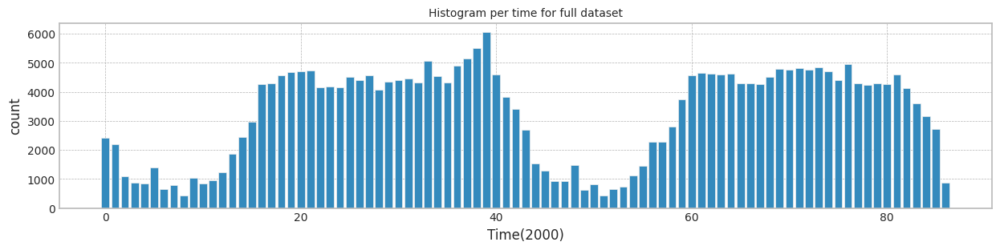

In [ ]:
plt.figure(figsize=main_figsize)
plt.bar(b_cnt.index,b_cnt.values)
plt.ylabel('count')
plt.xlabel('Time(2000)')
plt.title(f'Histogram per time for full dataset',fontdict={'fontsize':10})

plt.show()

In [ ]:
df_cc[df_cc['b'] < 20].shape[0]

39869

columns: ['V11', 'V16', 'V4', 'V3', 'V18']
Dataset has buckets!
MI Analysis MI Max 0.00683, Min 0.00432, Mean 0.00544, Std 0.00091
Dataset structure X_train, (39869, 5) X_test, (39869, 5) X_live (274807, 5)
bucket range in live set 7~86
Truncate 0 rows from live_set (274807, 5)
Search MI & Drift...for X_live_set (80,)


100%|██████████| 80/80 [00:07<00:00, 10.35it/s]


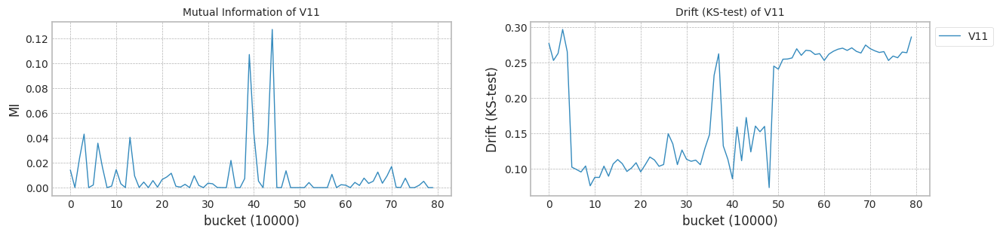

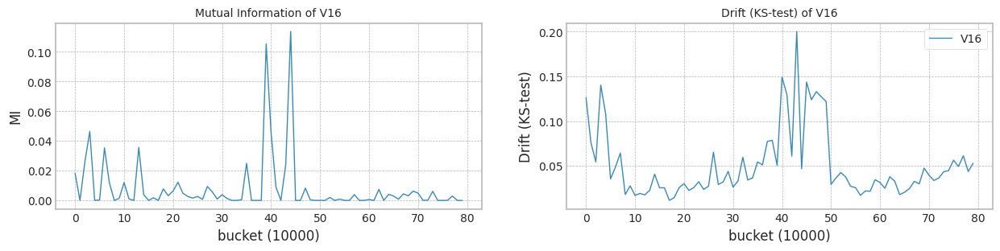

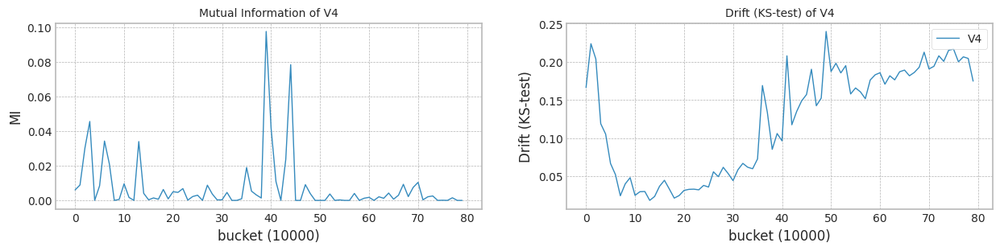

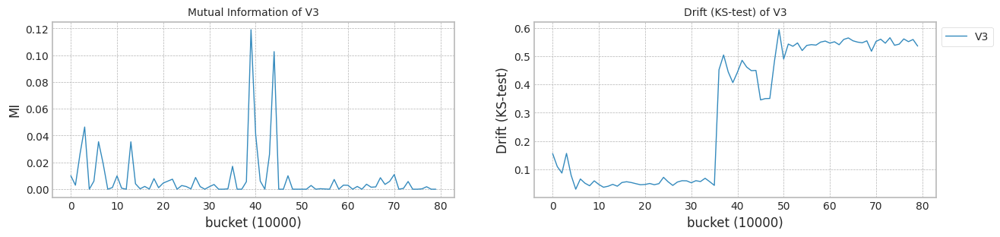

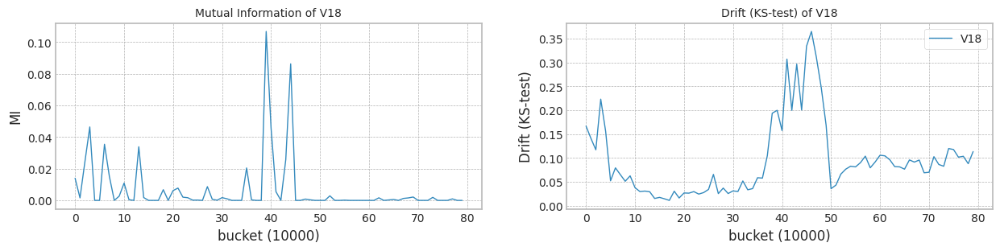

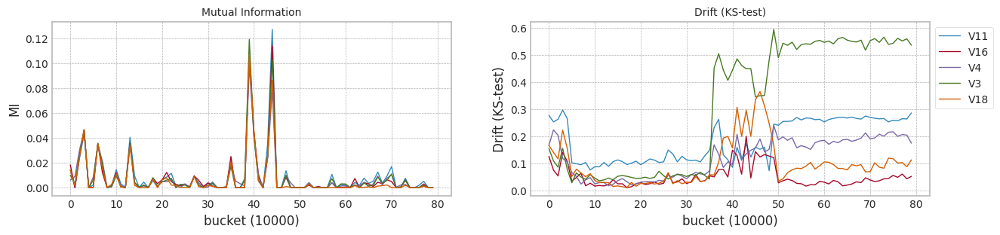

In [ ]:
seed_everything()

#s = np.sort(np.random.choice(len(COLUMNS),2,replace= False))
#top_columns = list(mi_scores[0:10].index)
top_columns = ['V11','V16','V4','V3','V18']
print('columns:',top_columns)
#print(s.shape)
X4 = df_cc[top_columns+['b']]
Y4 = df_cc['Class'].values
train_size = df_cc[df_cc['b'] < 20].shape[0]
test_size = 10000

X1,Y1 = check_mi_drift(X4, Y4, train_size, test_size)

class 1 %: 0.2608542978253781
(284807, 6)
(284807,)
(286783, 6)
(286783,)
class 1 %: 5.214577742105395
trial_count: 20
lambda_f2 0.8
######################### Trial 0 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:10<00:00, 399.26it/s]


precision_recall_fscore: (array([0.99476914, 0.92891374]), array([0.99768855, 0.85201465]), array([0.99622671, 0.88880397]), array([38504,  1365]))
Test f1 score: 0.8888039740160488
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.4787726838313226
######################### Trial 0 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 215.82it/s]


precision_recall_fscore: (array([0.99528888, 0.956346  ]), array([0.99859755, 0.86666667]), array([0.99694047, 0.90930054]), array([38504,  1365]))
Test f1 score: 0.9093005380476556
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.126478
V16    0.442816
V4     0.629313
V3     0.469794
V18    0.085505
dtype: float64
Mean F1 for all data: 0.23525024380990414
Normal model median        : 0.4787726838313226
Drift tolerant model median: 0.23525024380990414
######################### Trial 1 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 595.89it/s]


precision_recall_fscore: (array([0.9942557 , 0.93535188]), array([0.99794827, 0.83736264]), array([0.99609856, 0.88364901]), array([38504,  1365]))
Test f1 score: 0.8836490143022807
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:22<00:00,  1.09it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5444237395703128
######################### Trial 1 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 213.32it/s]


precision_recall_fscore: (array([0.99531428, 0.9540693 ]), array([0.99851963, 0.86739927]), array([0.99691438, 0.90867229]), array([38504,  1365]))
Test f1 score: 0.908672294704528
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.153201
V16    0.561932
V4     0.329702
V3     0.538752
V18    0.105970
dtype: float64
Mean F1 for all data: 0.3015784856452673
Normal model median        : 0.5115982117008177
Drift tolerant model median: 0.26841436472758573
######################### Trial 2 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 589.83it/s]


precision_recall_fscore: (array([0.99425466, 0.93002441]), array([0.99776647, 0.83736264]), array([0.99600747, 0.88126446]), array([38504,  1365]))
Test f1 score: 0.8812644564379336
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5014796235479714
######################### Trial 2 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 213.40it/s]


precision_recall_fscore: (array([0.99477374, 0.95484401]), array([0.99857158, 0.85201465]), array([0.99666904, 0.90050329]), array([38504,  1365]))
Test f1 score: 0.9005032907471933
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.09it/s]


mean of drift:
V11    0.111757
V16    0.403896
V4     0.290956
V3     0.374742
V18    0.081789
dtype: float64
Mean F1 for all data: 0.73661577829712
Normal model median        : 0.5014796235479714
Drift tolerant model median: 0.3015784856452673
######################### Trial 3 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 589.16it/s]


precision_recall_fscore: (array([0.99423191, 0.94536424]), array([0.99828589, 0.83663004]), array([0.99625478, 0.88767975]), array([38504,  1365]))
Test f1 score: 0.887679751263117
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.588224721366451
######################### Trial 3 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 212.29it/s]


precision_recall_fscore: (array([0.99528961, 0.96100731]), array([0.99875338, 0.86666667]), array([0.99701849, 0.91140216]), array([38504,  1365]))
Test f1 score: 0.911402157164869
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.357797
V16    0.207724
V4     0.391749
V3     0.226418
V18    0.038010
dtype: float64
Mean F1 for all data: 0.6676377059709543
Normal model median        : 0.5229516815591421
Drift tolerant model median: 0.4846080958081108
######################### Trial 4 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 597.12it/s]


precision_recall_fscore: (array([0.99474774, 0.95324036]), array([0.99851963, 0.85128205]), array([0.99663012, 0.8993808 ]), array([38504,  1365]))
Test f1 score: 0.8993808049535604
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6082246397721268
######################### Trial 4 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 212.18it/s]


precision_recall_fscore: (array([0.99529022, 0.96492659]), array([0.99888323, 0.86666667]), array([0.99708349, 0.91316094]), array([38504,  1365]))
Test f1 score: 0.9131609417213431
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.180493
V16    0.405048
V4     0.101466
V3     0.254991
V18    0.111243
dtype: float64
Mean F1 for all data: 0.5475566421733374
Normal model median        : 0.5444237395703128
Drift tolerant model median: 0.5475566421733374
######################### Trial 5 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 591.85it/s]


precision_recall_fscore: (array([0.99476914, 0.92891374]), array([0.99768855, 0.85201465]), array([0.99622671, 0.88880397]), array([38504,  1365]))
Test f1 score: 0.8888039740160488
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.4967732233692998
######################### Trial 5 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 213.68it/s]


precision_recall_fscore: (array([0.99531404, 0.95253419]), array([0.99846769, 0.86739927]), array([0.99688837, 0.90797546]), array([38504,  1365]))
Test f1 score: 0.9079754601226994
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.075597
V16    0.300187
V4     0.120535
V3     0.387739
V18    0.082947
dtype: float64
Mean F1 for all data: 0.639704870280655
Normal model median        : 0.5229516815591421
Drift tolerant model median: 0.5936307562269962
######################### Trial 6 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 598.71it/s]


precision_recall_fscore: (array([0.9942554 , 0.93382353]), array([0.99789632, 0.83736264]), array([0.99607253, 0.8829664 ]), array([38504,  1365]))
Test f1 score: 0.8829663962920047
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5274612156087862
######################### Trial 6 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 213.48it/s]


precision_recall_fscore: (array([0.99474787, 0.95402299]), array([0.99854561, 0.85128205]), array([0.99664312, 0.899729  ]), array([38504,  1365]))
Test f1 score: 0.8997289972899728
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.090469
V16    0.080743
V4     0.413102
V3     0.473168
V18    0.074439
dtype: float64
Mean F1 for all data: 0.48576356004169
Normal model median        : 0.5274612156087862
Drift tolerant model median: 0.5475566421733374
######################### Trial 7 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 602.10it/s]


precision_recall_fscore: (array([0.99528522, 0.93370166]), array([0.99781841, 0.86666667]), array([0.9965502 , 0.89893617]), array([38504,  1365]))
Test f1 score: 0.898936170212766
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5363141141570084
######################### Trial 7 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 211.98it/s]


precision_recall_fscore: (array([0.99580322, 0.94873817]), array([0.99831186, 0.88131868]), array([0.99705596, 0.91378656]), array([38504,  1365]))
Test f1 score: 0.9137865552601594
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:22<00:00,  1.09it/s]


mean of drift:
V11    0.323062
V16    0.269125
V4     0.365350
V3     0.700648
V18    0.312496
dtype: float64
Mean F1 for all data: 0.5491948700709962
Normal model median        : 0.5318876648828973
Drift tolerant model median: 0.5483757561221668
######################### Trial 8 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 597.65it/s]


precision_recall_fscore: (array([0.9942551 , 0.93230016]), array([0.99784438, 0.83736264]), array([0.99604651, 0.88228483]), array([38504,  1365]))
Test f1 score: 0.882284832111154
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5474954018047594
######################### Trial 8 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 211.18it/s]


precision_recall_fscore: (array([0.99528815, 0.95172969]), array([0.99844172, 0.86666667]), array([0.99686244, 0.90720859]), array([38504,  1365]))
Test f1 score: 0.9072085889570554
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.157721
V16    0.326413
V4     0.117824
V3     0.337013
V18    0.083418
dtype: float64
Mean F1 for all data: 0.6739589543890494
Normal model median        : 0.5363141141570084
Drift tolerant model median: 0.5491948700709962
######################### Trial 9 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 611.91it/s]


precision_recall_fscore: (array([0.99476901, 0.92817239]), array([0.99766258, 0.85201465]), array([0.99621369, 0.88846448]), array([38504,  1365]))
Test f1 score: 0.8884644766997709
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.47618142093697563
######################### Trial 9 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 212.86it/s]


precision_recall_fscore: (array([0.99477361, 0.95406071]), array([0.99854561, 0.85201465]), array([0.99665604, 0.9001548 ]), array([38504,  1365]))
Test f1 score: 0.90015479876161
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.193856
V16    0.410265
V4     0.258524
V3     0.490354
V18    0.071942
dtype: float64
Mean F1 for all data: 0.38278063917075594
Normal model median        : 0.5318876648828973
Drift tolerant model median: 0.5483757561221668
######################### Trial 10 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 593.70it/s]


precision_recall_fscore: (array([0.99425555, 0.93458708]), array([0.99792229, 0.83736264]), array([0.99608555, 0.88330757]), array([38504,  1365]))
Test f1 score: 0.8833075734157652
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5126807167720516
######################### Trial 10 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 210.42it/s]


precision_recall_fscore: (array([0.99526214, 0.95016077]), array([0.99838978, 0.86593407]), array([0.9968235 , 0.90609429]), array([38504,  1365]))
Test f1 score: 0.9060942889996169
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.660118
V16    0.214123
V4     0.310200
V3     0.343106
V18    0.131238
dtype: float64
Mean F1 for all data: 0.7278349653240905
Normal model median        : 0.5274612156087862
Drift tolerant model median: 0.5491948700709962
######################### Trial 11 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 608.36it/s]


precision_recall_fscore: (array([0.99528729, 0.9464    ]), array([0.99825992, 0.86666667]), array([0.99677139, 0.90478011]), array([38504,  1365]))
Test f1 score: 0.9047801147227533
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6160996239255615
######################### Trial 11 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 214.78it/s]


precision_recall_fscore: (array([0.99474814, 0.95559211]), array([0.99859755, 0.85128205]), array([0.99666913, 0.90042619]), array([38504,  1365]))
Test f1 score: 0.9004261913986827
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.071678
V16    0.084016
V4     0.330439
V3     0.411859
V18    0.037065
dtype: float64
Mean F1 for all data: 0.7130673553900646
Normal model median        : 0.5318876648828973
Drift tolerant model median: 0.5944498701758256
######################### Trial 12 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 586.30it/s]


precision_recall_fscore: (array([0.99474733, 0.95090016]), array([0.99844172, 0.85128205]), array([0.9965911 , 0.89833784]), array([38504,  1365]))
Test f1 score: 0.8983378430614611
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.653055442415536
######################### Trial 12 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 212.46it/s]


precision_recall_fscore: (array([0.99528912, 0.95789474]), array([0.99864949, 0.86666667]), array([0.99696648, 0.91      ]), array([38504,  1365]))
Test f1 score: 0.91
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.541723
V16    0.436332
V4     0.178568
V3     0.539144
V18    0.037504
dtype: float64
Mean F1 for all data: 0.7430321613981216
Normal model median        : 0.5363141141570084
Drift tolerant model median: 0.639704870280655
######################### Trial 13 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 590.24it/s]


precision_recall_fscore: (array([0.99477117, 0.94017785]), array([0.99807812, 0.85201465]), array([0.9964219 , 0.89392775]), array([38504,  1365]))
Test f1 score: 0.8939277478862413
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5562852270676721
######################### Trial 13 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 213.01it/s]


precision_recall_fscore: (array([0.99477347, 0.95327869]), array([0.99851963, 0.85201465]), array([0.99664303, 0.89980658]), array([38504,  1365]))
Test f1 score: 0.8998065764023211
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.083157
V16    0.519531
V4     0.245338
V3     0.433662
V18    0.100006
dtype: float64
Mean F1 for all data: 0.660242558569755
Normal model median        : 0.5403689268636606
Drift tolerant model median: 0.649973714425205
######################### Trial 14 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 594.11it/s]


precision_recall_fscore: (array([0.99476928, 0.92965627]), array([0.99771452, 0.85201465]), array([0.99623972, 0.88914373]), array([38504,  1365]))
Test f1 score: 0.8891437308868502
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.4632507515178362
######################### Trial 14 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 202.60it/s]


precision_recall_fscore: (array([0.99418289, 0.95798319]), array([0.99870143, 0.83516484]), array([0.99643704, 0.89236791]), array([38504,  1365]))
Test f1 score: 0.8923679060665363
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.283402
V16    0.242521
V4     0.675271
V3     0.439212
V18    0.060931
dtype: float64
Mean F1 for all data: 0.30406642316629
Normal model median        : 0.5363141141570084
Drift tolerant model median: 0.639704870280655
######################### Trial 15 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 593.03it/s]


precision_recall_fscore: (array([0.99425496, 0.93154034]), array([0.99781841, 0.83736264]), array([0.99603349, 0.88194444]), array([38504,  1365]))
Test f1 score: 0.8819444444444444
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5211110996797381
######################### Trial 15 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 211.51it/s]


precision_recall_fscore: (array([0.96576287, 0.        ]), array([1., 0.]), array([0.98258329, 0.        ]), array([38504,  1365]))
Test f1 score: 0.0
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.193219
V16    0.044831
V4     0.137939
V3     0.245748
V18    0.068301
dtype: float64
Mean F1 for all data: 0.0
Normal model median        : 0.5318876648828973
Drift tolerant model median: 0.5944498701758256
######################### Trial 16 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 596.33it/s]


precision_recall_fscore: (array([0.99315316, 0.94420601]), array([0.99831186, 0.80586081]), array([0.99572583, 0.86956522]), array([38504,  1365]))
Test f1 score: 0.8695652173913043
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5616057962839334
######################### Trial 16 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 208.27it/s]


precision_recall_fscore: (array([0.99528864, 0.95480226]), array([0.99854561, 0.86666667]), array([0.99691446, 0.90860215]), array([38504,  1365]))
Test f1 score: 0.9086021505376345
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.079633
V16    0.578713
V4     0.375323
V3     0.456093
V18    0.077425
dtype: float64
Mean F1 for all data: 0.3420626265755921
Normal model median        : 0.5363141141570084
Drift tolerant model median: 0.5491948700709962
######################### Trial 17 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 590.13it/s]


precision_recall_fscore: (array([0.99425466, 0.93002441]), array([0.99776647, 0.83736264]), array([0.99600747, 0.88126446]), array([38504,  1365]))
Test f1 score: 0.8812644564379336
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5072328869769297
######################### Trial 17 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 210.91it/s]


precision_recall_fscore: (array([0.99526679, 0.9800995 ]), array([0.99937669, 0.86593407]), array([0.99731751, 0.91948658]), array([38504,  1365]))
Test f1 score: 0.9194865810968494
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.183100
V16    0.271472
V4     0.097573
V3     0.263971
V18    0.102241
dtype: float64
Mean F1 for all data: 0.7584358727734267
Normal model median        : 0.5318876648828973
Drift tolerant model median: 0.5944498701758256
######################### Trial 18 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 597.51it/s]


precision_recall_fscore: (array([0.99425585, 0.93611794]), array([0.99797424, 0.83736264]), array([0.99611157, 0.88399072]), array([38504,  1365]))
Test f1 score: 0.8839907192575407
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5505055921082221
######################### Trial 18 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 212.69it/s]


precision_recall_fscore: (array([0.99474787, 0.95402299]), array([0.99854561, 0.85128205]), array([0.99664312, 0.899729  ]), array([38504,  1365]))
Test f1 score: 0.8997289972899728
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.099727
V16    0.130703
V4     0.263276
V3     0.517618
V18    0.034033
dtype: float64
Mean F1 for all data: 0.6960290202218683
Normal model median        : 0.5363141141570084
Drift tolerant model median: 0.639704870280655
######################### Trial 19 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 603.70it/s]


precision_recall_fscore: (array([0.99474719, 0.95012265]), array([0.99841575, 0.85128205]), array([0.99657809, 0.89799073]), array([38504,  1365]))
Test f1 score: 0.8979907264296755
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5989636104002379
######################### Trial 19 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 210.66it/s]


precision_recall_fscore: (array([0.99531295, 0.9456869 ]), array([0.99823395, 0.86739927]), array([0.99677131, 0.90485288]), array([38504,  1365]))
Test f1 score: 0.9048528849828048
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.353475
V16    0.229488
V4     0.360345
V3     0.266763
V18    0.057526
dtype: float64
Mean F1 for all data: 0.733900584825911
Normal model median        : 0.5403689268636606
Drift tolerant model median: 0.649973714425205
######################### Trial 0 for Normal model ###########################
retrain_interval: 13
######################### Trial 0 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:24<00:00,  1.03s/it]


Early stop at  2451.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6228721303751991
SEA median: 0.6228721303751991
######################### Trial 0 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6215886239851872
AUE median: 0.6215886239851872
######################### Trial 0 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.3750145103144398
DTEL median: 0.3750145103144398
######################### Trial 1 for Normal model ###########################
retrain_interval: 13
######################### Trial 1 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  3721.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6312059079969287
SEA median: 0.6270390191860639
######################### Trial 1 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  3814.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.658410405019562
AUE median: 0.6399995145023747
######################### Trial 1 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:30<00:00,  1.29s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.4296491926926982
DTEL median: 0.402331851503569
######################### Trial 2 for Normal model ###########################
retrain_interval: 13
######################### Trial 2 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.3204418762820782
SEA median: 0.6228721303751991
######################### Trial 2 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.14s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6303940418488618
AUE median: 0.6303940418488618
######################### Trial 2 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.32s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6255419689217221
DTEL median: 0.4296491926926982
######################### Trial 3 for Normal model ###########################
retrain_interval: 13
######################### Trial 3 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6593388779295698
SEA median: 0.6270390191860639
######################### Trial 3 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  3444.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.687734388088647
AUE median: 0.6444022234342119
######################### Trial 3 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6665026880358226
DTEL median: 0.5275955808072101
######################### Trial 4 for Normal model ###########################
retrain_interval: 13
######################### Trial 4 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:25<00:00,  1.07s/it]


Early stop at  3359.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6750859612962373
SEA median: 0.6312059079969287
######################### Trial 4 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.14s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6911115937664721
AUE median: 0.658410405019562
######################### Trial 4 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6230513261581296
DTEL median: 0.6230513261581296
######################### Trial 5 for Normal model ###########################
retrain_interval: 13
######################### Trial 5 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6269856320723485
SEA median: 0.6290957700346386
######################### Trial 5 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.627360858290796
AUE median: 0.6444022234342119
######################### Trial 5 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.31s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6378489783531642
DTEL median: 0.6242966475399259
######################### Trial 6 for Normal model ###########################
retrain_interval: 13
######################### Trial 6 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.3330555407485235
SEA median: 0.6269856320723485
######################### Trial 6 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5275628407829165
AUE median: 0.6303940418488618
######################### Trial 6 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.31s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.647220419993375
DTEL median: 0.6255419689217221
######################### Trial 7 for Normal model ###########################
retrain_interval: 13
######################### Trial 7 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6209951581924383
SEA median: 0.6249288812237738
######################### Trial 7 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.535308424422526
AUE median: 0.6288774500698289
######################### Trial 7 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.40464674501137265
DTEL median: 0.6242966475399259
######################### Trial 8 for Normal model ###########################
retrain_interval: 13
######################### Trial 8 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.3651293167898437
SEA median: 0.6228721303751991
######################### Trial 8 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  3388.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6571358413644757
AUE median: 0.6303940418488618
######################### Trial 8 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6343913405374465
DTEL median: 0.6255419689217221
######################### Trial 9 for Normal model ###########################
retrain_interval: 13
######################### Trial 9 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.31213748056185214
SEA median: 0.6219336442838187
######################### Trial 9 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.627198710470026
AUE median: 0.6288774500698289
######################### Trial 9 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5674449721589903
DTEL median: 0.6242966475399259
######################### Trial 10 for Normal model ###########################
retrain_interval: 13
######################### Trial 10 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6263128024227679
SEA median: 0.6228721303751991
######################### Trial 10 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  3579.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6349629660686333
AUE median: 0.6303940418488618
######################### Trial 10 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6310172000298006
DTEL median: 0.6255419689217221
######################### Trial 11 for Normal model ###########################
retrain_interval: 13
######################### Trial 11 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.37141338722523826
SEA median: 0.6219336442838187
######################### Trial 11 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6964749530504607
AUE median: 0.6326785039587476
######################### Trial 11 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6220455718816155
DTEL median: 0.6242966475399259
######################### Trial 12 for Normal model ###########################
retrain_interval: 13
######################### Trial 12 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.38332673886372953
SEA median: 0.6209951581924383
######################### Trial 12 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6608517418632327
AUE median: 0.6349629660686333
######################### Trial 12 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:30<00:00,  1.27s/it]


Early stop at  3363.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.7061430586413463
DTEL median: 0.6255419689217221
######################### Trial 13 for Normal model ###########################
retrain_interval: 13
######################### Trial 13 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:25<00:00,  1.06s/it]


Early stop at  3162.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6409343096008545
SEA median: 0.6219336442838187
######################### Trial 13 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.09s/it]


Early stop at  3080.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6641536055813483
AUE median: 0.6460494037165545
######################### Trial 13 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:30<00:00,  1.29s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6747063211773309
DTEL median: 0.6282795844757614
######################### Trial 14 for Normal model ###########################
retrain_interval: 13
######################### Trial 14 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.3514912291334462
SEA median: 0.6209951581924383
######################### Trial 14 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:25<00:00,  1.07s/it]


Early stop at  3011.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.627764837138365
AUE median: 0.6349629660686333
######################### Trial 14 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6289307439793028
DTEL median: 0.6289307439793028
######################### Trial 15 for Normal model ###########################
retrain_interval: 13
######################### Trial 15 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.32891964743844926
SEA median: 0.5021609485280839
######################### Trial 15 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6435211503551841
AUE median: 0.6392420582119087
######################### Trial 15 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.31s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6522378384999784
DTEL median: 0.6299739720045516
######################### Trial 16 for Normal model ###########################
retrain_interval: 13
######################### Trial 16 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.630304499359687
SEA median: 0.6209951581924383
######################### Trial 16 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  3359.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6476446443367351
AUE median: 0.6435211503551841
######################### Trial 16 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:29<00:00,  1.23s/it]


Early stop at  2647.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6351088303835772
DTEL median: 0.6310172000298006
######################### Trial 17 for Normal model ###########################
retrain_interval: 13
######################### Trial 17 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6176768194255638
SEA median: 0.6193359888090011
######################### Trial 17 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6594918224994396
AUE median: 0.6455828973459596
######################### Trial 17 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:30<00:00,  1.29s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6343401518142744
DTEL median: 0.6326786759220375
######################### Trial 18 for Normal model ###########################
retrain_interval: 13
######################### Trial 18 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  3881.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.64179785547746
SEA median: 0.6209951581924383
######################### Trial 18 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6761711604811603
AUE median: 0.6476446443367351
######################### Trial 18 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:30<00:00,  1.29s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6362481595609869
DTEL median: 0.6343401518142744
######################### Trial 19 for Normal model ###########################
retrain_interval: 13
######################### Trial 19 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  3788.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6180044336548649
SEA median: 0.6194997959236517
######################### Trial 19 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:25<00:00,  1.06s/it]


Early stop at  2880.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6939668209156152
AUE median: 0.6523902428506054
######################### Trial 19 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6968639107783933
DTEL median: 0.6343657461758605


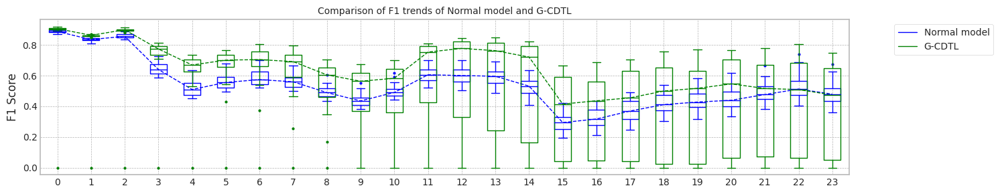

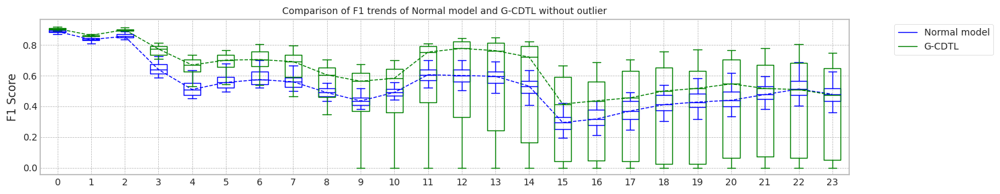

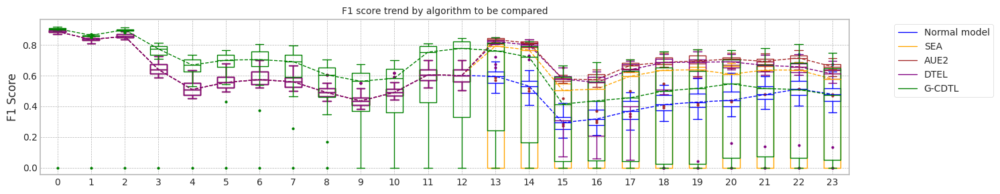

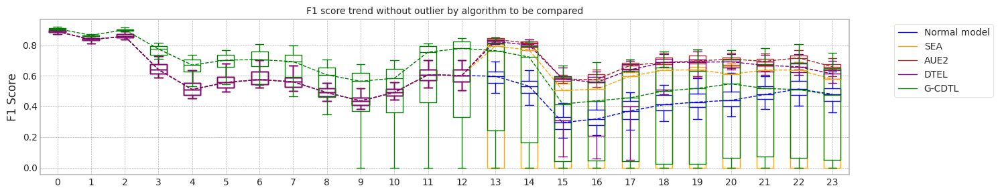

max_mean_trial= 17


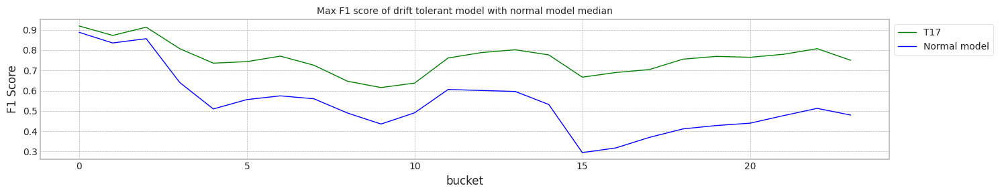

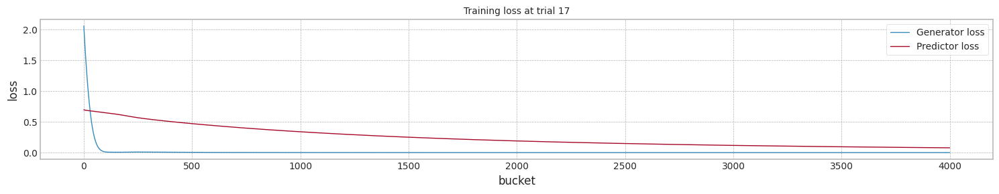

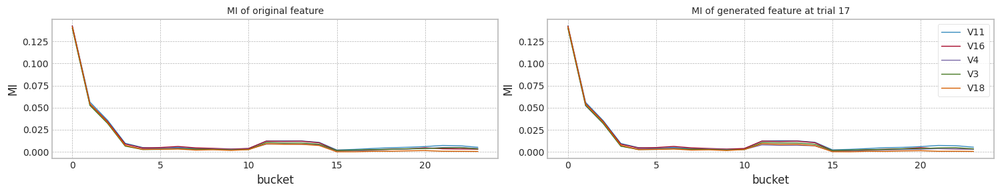

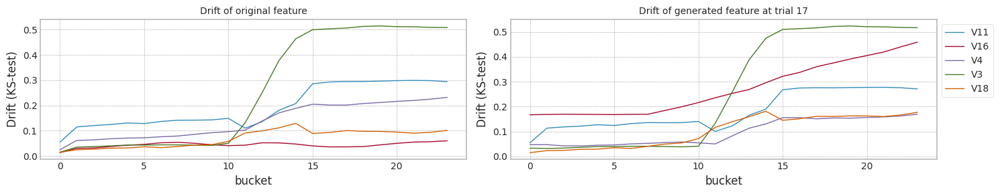

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.888804,0.827995,0.478773,0.402235,21.990515
1,1.0,0.883649,0.836538,0.544424,0.492754,22.072859
2,2.0,0.881264,0.829559,0.501480,0.433735,21.695993
3,3.0,0.887680,0.848411,0.588225,0.545455,21.621090
4,4.0,0.899381,0.856442,0.608225,0.600000,21.699365
5,5.0,0.888804,0.828979,0.496773,0.404624,21.619682
6,6.0,0.882966,0.836538,0.527461,0.480000,21.788623
7,7.0,0.898936,0.834327,0.536314,0.469799,21.891496
8,8.0,0.882285,0.834532,0.547495,0.478873,21.772674
9,9.0,0.888464,0.827995,0.476181,0.402235,21.553158


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.888804,0.827995,0.622872,0.602151,24.796597
1,1.0,0.883649,0.836538,0.631206,0.613861,26.366068
2,2.0,0.881264,0.829559,0.320442,0.000000,26.883158
3,3.0,0.887680,0.848411,0.659339,0.622222,26.727025
4,4.0,0.899381,0.856442,0.675086,0.645833,25.724761
5,5.0,0.888804,0.828979,0.626986,0.640000,26.491176
6,6.0,0.882966,0.836538,0.333056,0.000000,26.589833
7,7.0,0.898936,0.834327,0.620995,0.568807,26.790983
8,8.0,0.882285,0.834532,0.365129,0.000000,26.388638
9,9.0,0.888464,0.827995,0.312137,0.000000,26.442418


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.888804,0.827995,0.621589,0.630435,27.190527
1,1.0,0.883649,0.836538,0.658410,0.658824,26.792875
2,2.0,0.881264,0.829559,0.630394,0.642857,27.400304
3,3.0,0.887680,0.848411,0.687734,0.689655,26.668115
4,4.0,0.899381,0.856442,0.691112,0.674419,27.357188
5,5.0,0.888804,0.828979,0.627361,0.630435,27.024213
6,6.0,0.882966,0.836538,0.527563,0.480000,26.956413
7,7.0,0.898936,0.834327,0.535308,0.469799,27.240072
8,8.0,0.882285,0.834532,0.657136,0.674419,26.443192
9,9.0,0.888464,0.827995,0.627199,0.637363,27.024749


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.888804,0.827995,0.375015,0.000000,31.212564
1,1.0,0.883649,0.836538,0.429649,0.135593,31.043606
2,2.0,0.881264,0.829559,0.625542,0.602151,31.822471
3,3.0,0.887680,0.848411,0.666503,0.652174,31.292453
4,4.0,0.899381,0.856442,0.623051,0.600000,31.191338
5,5.0,0.888804,0.828979,0.637849,0.636364,31.477988
6,6.0,0.882966,0.836538,0.647220,0.615385,31.386991
7,7.0,0.898936,0.834327,0.404647,0.000000,31.260353
8,8.0,0.882285,0.834532,0.634391,0.577778,31.172172
9,9.0,0.888464,0.827995,0.567445,0.575000,31.188970


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.909301,0.864865,0.235250,0.004341,21.922944
1,1.0,0.908672,0.857837,0.301578,0.022349,21.950316
2,2.0,0.900503,0.864198,0.736616,0.697674,21.987438
3,3.0,0.911402,0.869136,0.667638,0.565657,21.558578
4,4.0,0.913161,0.859585,0.547557,0.390000,21.492231
5,5.0,0.907975,0.861689,0.639705,0.562963,21.682738
6,6.0,0.899729,0.856089,0.485764,0.135593,21.852888
7,7.0,0.913787,0.849879,0.549195,0.406977,22.093802
8,8.0,0.907209,0.865598,0.673959,0.644068,21.680247
9,9.0,0.900155,0.863469,0.382781,0.061493,21.667892


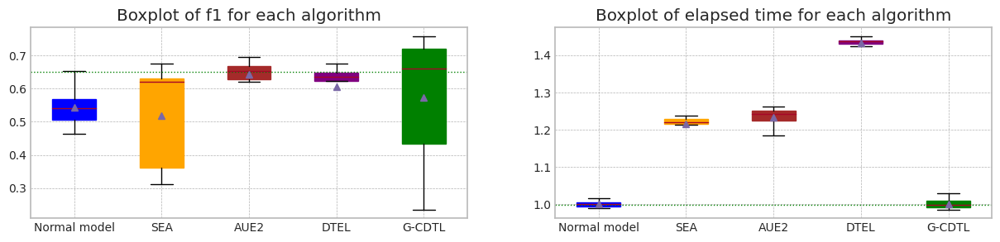

In [ ]:
print('class 1 %:',np.sum(Y1[0:train_size])/train_size * 100)

# class 1이 너무 숫자가 적어서 (unbalanced data) X 20으로 증가 시킨다.
print(X1.shape)
print(Y1.shape)

X2 = X1[0:train_size]
Y2 = Y1[0:train_size]

for idx,(row,yv) in enumerate(zip(X1[0:train_size].values,Y1[0:train_size])):
    if yv == 1:
        #print(idx)
        for j in range(19):
            X2 = pd.concat([X2[0:idx],pd.DataFrame([row],columns=X2.columns), X2[idx:]])
            Y2 = np.insert(Y2,idx,yv)
X1 = pd.concat([X2, X1[train_size:]])
Y1 = np.concatenate((Y2,Y1[train_size:]))

print(X1.shape)
print(Y1.shape)

print('class 1 %:',np.sum(Y1[0:train_size])/train_size * 100)

_,_,_,_,_,_ = drift_tolerant2('CC_B',X1, Y1,train_size, test_size,avaible_range = 1600,lambda_f2=0.8,trial_count=20,lr_g=0.001,weight_init= True)